# Loading halos and subhalos, Making tables

In [1]:
'''
import illustris_python as il
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import numpy as np
import astropy.stats as astats
import time as time
import corner
t0 = time.time()
plt.rcParams['figure.facecolor'] = 'w'


basePath = '/Users/TaraD/TNG-300_1/output' #Folder with snapshots and group catalogs
snapshot_ind = 66

# Loading header file
header = il.groupcat.loadHeader(basePath, snapshot_ind)
#halo_grp = il.groupcat.loadHalos(basePath, snapshot_ind)
print("Header File Keys: ")
print('\n'.join(list(header.keys())))

# Loading halo group quantities 
halo_grp = il.groupcat.loadHalos(basePath, snapshot_ind)
halo_keys = (list(halo_grp.keys()))
print("\nHalo Group File Keys: ")
print('\n'.join(halo_keys))

subhalo_grp = il.groupcat.loadSubhalos(basePath, snapshot_ind)
subhalo_keys = (list(subhalo_grp.keys()))
print("\nSubHalo Group File Keys: ")
print('\n'.join(subhalo_keys))
print(time.time()-t0)
'''

'\nimport illustris_python as il\nimport matplotlib.pyplot as plt\nimport matplotlib.colors as colors\nimport numpy as np\nimport astropy.stats as astats\nimport time as time\nimport corner\nt0 = time.time()\nplt.rcParams[\'figure.facecolor\'] = \'w\'\n\n\nbasePath = \'/Users/TaraD/TNG-300_1/output\' #Folder with snapshots and group catalogs\nsnapshot_ind = 66\n\n# Loading header file\nheader = il.groupcat.loadHeader(basePath, snapshot_ind)\n#halo_grp = il.groupcat.loadHalos(basePath, snapshot_ind)\nprint("Header File Keys: ")\nprint(\'\n\'.join(list(header.keys())))\n\n# Loading halo group quantities \nhalo_grp = il.groupcat.loadHalos(basePath, snapshot_ind)\nhalo_keys = (list(halo_grp.keys()))\nprint("\nHalo Group File Keys: ")\nprint(\'\n\'.join(halo_keys))\n\nsubhalo_grp = il.groupcat.loadSubhalos(basePath, snapshot_ind)\nsubhalo_keys = (list(subhalo_grp.keys()))\nprint("\nSubHalo Group File Keys: ")\nprint(\'\n\'.join(subhalo_keys))\nprint(time.time()-t0)\n'

In [4]:
import time as time
t0 = time.time()
from astropy.table import Table,join
# I REMOVED COLUMN PART FROM ALL SINCE UPDATED ASTROPY, IF DOESN'T WORK, PUT IT BACK IN

useless_keys_subhalo = ['count','SubhaloBHMdot',
                'SubhaloIDMostbound', 'SubhaloSFRinHalfRad','SubhaloSFRinMaxRad', 'SubhaloSFRinRad',
               'SubhaloStarMetalFractionsHalfRad','SubhaloStarMetalFractionsMaxRad']
print(subhalo_keys)
for i in range(0, len(useless_keys_subhalo)):
    if useless_keys_subhalo[i] not in subhalo_keys:
        print(useless_keys_subhalo[i])
    else:
        subhalo_keys.remove(useless_keys_subhalo[i])
print(type(subhalo_grp))
print(subhalo_grp.keys())
[subhalo_grp.pop(key) for key in useless_keys_subhalo] 

 

subhalo_keys = (list(subhalo_grp.keys()))
halo_keys = (list(halo_grp.keys()))

subhalo_table = Table(list(subhalo_grp.values()), names=(subhalo_keys))

subhalo_table.add_column(([x for x in range(len(subhalo_table))]), name='Index' ,index=0)

subhalo_table.add_column(subhalo_table["SubhaloMassInHalfRadType"][:,4], name=str("StellarMassHalfRad"))
subhalo_table.add_column(subhalo_table["SubhaloMassType"][:,4], name=str("StellarMass"))

useless_keys_halo = ['count','GroupBHMdot','GroupGasMetalFractions', 'GroupStarMetalFractions']   
for i in range(0, len(useless_keys_halo)):
    halo_keys.remove(useless_keys_halo[i])

[halo_grp.pop(key) for key in useless_keys_halo]
halo_table = Table(list(halo_grp.values()), names=(halo_keys))

halo_table.add_column(([x for x in range(len(halo_table))]), name='SubhaloGrNr' ,index=0)

subhalo_table = join(subhalo_table, halo_table, keys='SubhaloGrNr', join_type='left')

subhalo_table.add_column((subhalo_table['GroupFirstSub'] == subhalo_table['Index']),name=str("IsCentral"))
print(len(subhalo_table))


print(time.time()-t0)
print('\n'.join(subhalo_table.colnames))


['count', 'SubhaloBHMass', 'SubhaloBHMdot', 'SubhaloCM', 'SubhaloFlag', 'SubhaloGasMetalFractions', 'SubhaloGasMetalFractionsHalfRad', 'SubhaloGasMetalFractionsMaxRad', 'SubhaloGasMetalFractionsSfr', 'SubhaloGasMetalFractionsSfrWeighted', 'SubhaloGasMetallicity', 'SubhaloGasMetallicityHalfRad', 'SubhaloGasMetallicityMaxRad', 'SubhaloGasMetallicitySfr', 'SubhaloGasMetallicitySfrWeighted', 'SubhaloGrNr', 'SubhaloHalfmassRad', 'SubhaloHalfmassRadType', 'SubhaloIDMostbound', 'SubhaloLen', 'SubhaloLenType', 'SubhaloMass', 'SubhaloMassInHalfRad', 'SubhaloMassInHalfRadType', 'SubhaloMassInMaxRad', 'SubhaloMassInMaxRadType', 'SubhaloMassInRad', 'SubhaloMassInRadType', 'SubhaloMassType', 'SubhaloParent', 'SubhaloPos', 'SubhaloSFR', 'SubhaloSFRinHalfRad', 'SubhaloSFRinMaxRad', 'SubhaloSFRinRad', 'SubhaloSpin', 'SubhaloStarMetalFractions', 'SubhaloStarMetalFractionsHalfRad', 'SubhaloStarMetalFractionsMaxRad', 'SubhaloStarMetallicity', 'SubhaloStarMetallicityHalfRad', 'SubhaloStarMetallicityMaxRad

In [47]:
#import astropy.io.fits as fits
from astropy.table import Table
halo_table1 = Table.read('snap99/Halo_GM200_13_7_snapshot99.fits')
subhalo_table1 = Table.read('snap99/SH_stellar8_GM200_13_7_snapshot99.fits')

In [49]:
print(np.shape(halo_table1))

(683,)


In [177]:
#Run this after the "Halo array, table masking, initializing lists" cell:

boxsize = header['BoxSize'] #kpc/h
print(len(subhalo_table_m))
Nsubs = len(subhalo_table_m)
rho_g = Nsubs/(boxsize*.001)**3
print('rho_g=',rho_g)

Nsubs_b = len((subhalo_table_m)[((subhalo_table_m['SubhaloStellarPhotometrics'][:,4]-subhalo_table_m['SubhaloStellarPhotometrics'][:,5]) < 0.50)])
rho_g_b = Nsubs_b/(boxsize*.001)**3
print('rho_g_b=',rho_g_b)
Nsubs_r = len((subhalo_table_m)[(np.log10(subhalo_table_m['StellarMass']*1e10)>=10.2) & ((subhalo_table_m['SubhaloStellarPhotometrics'][:,4]-subhalo_table_m['SubhaloStellarPhotometrics'][:,5]) > 0.50)])
rho_g_r = Nsubs_r/(boxsize*.001)**3
print('rho_g_r=',rho_g_r)
Nsubs_g = len((subhalo_table_m)[(np.log10(subhalo_table_m['StellarMass']*1e10)<10.2) & ((subhalo_table_m['SubhaloStellarPhotometrics'][:,4]-subhalo_table_m['SubhaloStellarPhotometrics'][:,5]) > 0.50)])
rho_g_g = Nsubs_g/(boxsize*.001)**3
print('rho_g_g=',rho_g_g)

Nsubs_b1 = len((subhalo_table_m)[((subhalo_table_m['SubhaloStellarPhotometrics'][:,4]-subhalo_table_m['SubhaloStellarPhotometrics'][:,5]) < 0.25)])
rho_g_b1 = Nsubs_b1/(boxsize*.001)**3
print('rho_g_b1=',rho_g_b1)
Nsubs_b2 = len((subhalo_table_m)[((subhalo_table_m['SubhaloStellarPhotometrics'][:,4]-subhalo_table_m['SubhaloStellarPhotometrics'][:,5]) >= 0.25) & ((subhalo_table_m['SubhaloStellarPhotometrics'][:,4]-subhalo_table_m['SubhaloStellarPhotometrics'][:,5]) < 0.50)])
rho_g_b2 = Nsubs_b2/(boxsize*.001)**3
print('rho_g_b2=',rho_g_b2)
rho_g_listB = [rho_g, rho_g_b, rho_g_b1, rho_g_b2]
'''
Nsubs_old = len((subhalo_table_ib))
rho_g_old = Nsubs_old/(boxsize*.001)**3
Nsubs_oldb = len((subhalo_table_ib)[((subhalo_table_ib['SubhaloStellarPhotometrics'][:,4]-subhalo_table_ib['SubhaloStellarPhotometrics'][:,5]) < 0.35)])
rho_g_oldb = Nsubs_oldb/(boxsize*.001)**3
print('rho_g_oldb=',rho_g_oldb)
Nsubs_oldg = len((subhalo_table_ib)[((subhalo_table_ib['SubhaloStellarPhotometrics'][:,4]-subhalo_table_ib['SubhaloStellarPhotometrics'][:,5]) > .35) & ((subhalo_table_ib['SubhaloStellarPhotometrics'][:,4]-subhalo_table_ib['SubhaloStellarPhotometrics'][:,5]) < 0.55)])
rho_g_oldg = Nsubs_oldg/(boxsize*.001)**3
print('rho_g_oldg=',rho_g_oldg)
Nsubs_oldr = len((subhalo_table_ib)[((subhalo_table_ib['SubhaloStellarPhotometrics'][:,4]-subhalo_table_ib['SubhaloStellarPhotometrics'][:,5]) > 0.55)])
rho_g_oldr = Nsubs_oldr/(boxsize*.001)**3
print('rho_g_oldr=',rho_g_oldr)
rho_g_list_old = [rho_g_old, rho_g_oldb, rho_g_oldr, rho_g_oldg]

#with stellarmass
sm = np.log10(subhalo_table_m['StellarMass']*1e10)
massmask1 = (sm>(8))#&(sm<(9))
massmask2 = (sm>(9))#&(sm<(10))
massmask3 = (sm>(10))#&(sm<(11))
#massmask4 = (sm>=(11))#&(sm<(12))
'''
'''
#with vcmax
v = (subhalo_table_m['SubhaloVmax']) #km/s
massmask1 = (v>135)
massmask2 = (v>178)
massmask3 = (v>280)
'''
#with subs3
s3 = np.log10(subhalo_table_m['SubhaloMass']*1e10)
massmask1 = (s3>9.4)
massmask2 = (s3>10.4)
massmask3 = (s3>11.4)

Nsubs_m1 = len((subhalo_table_m)[massmask1])
Nsubs_m2 = len((subhalo_table_m)[massmask2])
Nsubs_m3 = len((subhalo_table_m)[massmask3])
#Nsubs_m4 = len((subhalo_table_m)[massmask4])


rho_g_list_s3 = [Nsubs_m1/(boxsize*.001)**3, Nsubs_m2/(boxsize*.001)**3, Nsubs_m3/(boxsize*.001)**3]#, Nsubs_m4/(boxsize*.001)**3]

i_b = (subhalo_table_m['SubhaloStellarPhotometrics'])[:,6]
massmask1 = (i_b<-16)
massmask1_5 = (i_b<-20)
massmask2 = (i_b<-19)
massmask3 = (i_b<-20)

Nsubs_m1 = len((subhalo_table_m)[massmask1])
Nsubs_m1_5 = len((subhalo_table_m)[massmask1_5])
Nsubs_m2 = len((subhalo_table_m)[massmask2])
Nsubs_m3 = len((subhalo_table_m)[massmask3])
#Nsubs_m4 = len((subhalo_table_m)[massmask4])

#sm before, v
rho_g_list_i = [Nsubs_m1/(boxsize*.001)**3,Nsubs_m2/(boxsize*.001)**3, Nsubs_m3/(boxsize*.001)**3]#, Nsubs_m4/(boxsize*.001)**3]

'''
subm = np.log10(subhalo_tableS['SubhaloMass']*1e10)
mean = np.mean(subm)
submask1 = (subm <= mean)
submask2 = (subm > mean)
Nsubs_S1 = len((subhalo_tableS)[submask1])
Nsubs_S2 = len((subhalo_tableS)[submask2])
rho_g_listS = [Nsubs_S1/(boxsize*.001)**3, Nsubs_S2/(boxsize*.001)**3]

subm = np.log10(subhalo_tableS['SubhaloMass']*1e10)
submask1 = (subm >= 9)
submask2 = (subm >= 10)
submask3 = (subm >= 11)
Nsubs_S1 = len((subhalo_tableS)[submask1])
Nsubs_S2 = len((subhalo_tableS)[submask2])
Nsubs_S3 = len((subhalo_tableS)[submask3])
rho_g_listS = [Nsubs_S1/(boxsize*.001)**3, Nsubs_S2/(boxsize*.001)**3, Nsubs_S3/(boxsize*.001)**3]

Nsubs_a = len((subhalo_table_m)[~((np.log10(subhalo_table_m['StellarMass']*1e10)>=10.2) & ((subhalo_table_m['SubhaloStellarPhotometrics'][:,4]-subhalo_table_m['SubhaloStellarPhotometrics'][:,5]) > 0.55))])
rho_g_a = Nsubs_a/(boxsize*.001)**3
rho_g_list_a = [rho_g, rho_g_a]


subm = np.log10(subhalo_tableS['SubhaloMass']*1e10)
#magS = subhalo_tableS['SubhaloStellarPhotometrics']
#gmr = magS[:,4]-magS[:,5]
#r1 = 0.50#.6#.735
#r2 = 1.#1.

#notred_mask_subs = ~((gmr>r1)&(gmr<1.5))#&(gmr>((slope*sm)+intercept))#(gmr>=0.6)#(gmr>0.59)#
mean = 11.1 #np.mean(subm)
submaskall1 = (subm <= mean)#&(notred_mask_subs)
submaskall2 = (subm > mean)#&(notred_mask_subs)
Nsubs_subm11 = len((subhalo_tableS[submaskall1]))
Nsubs_subm12 = len((subhalo_tableS[submaskall2]))
rho_g_listS = [Nsubs_subm11/(boxsize*.001)**3, Nsubs_subm12/(boxsize*.001)**3,Nsubs_subm11/(boxsize*.001)**3, Nsubs_subm12/(boxsize*.001)**3]



notred_mask_subs = ~((gmr>r1)&(gmr<1.5))#&(gmr>((slope*sm)+intercept))#(gmr>=0.6)#(gmr>0.59)#
mean = np.mean(subm)
submask1 = (subm <= mean)&(notred_mask_subs)
submask2 = (subm > mean)&(notred_mask_subs)
Nsubs_subm21 = len((subhalo_tableS[submask1]))
Nsubs_subm22 = len((subhalo_tableS[submask2]))
rho_g_listS2 = [Nsubs_subm21/(boxsize*.001)**3, Nsubs_subm22/(boxsize*.001)**3,Nsubs_subm21/(boxsize*.001)**3, Nsubs_subm22/(boxsize*.001)**3]
'''

566208
rho_g= 0.06572255190725614
rho_g_b= 0.0509141771013189
rho_g_r= 0.003255901684537369
rho_g_g= 0.011552473121399863
rho_g_b1= 0.018872390127827512
rho_g_b2= 0.03204178697349139


NameError: name 'subhalo_tableS' is not defined

In [ ]:
print(len(subhalo_table_m))

# Defining Functions

## Profile Functions

In [160]:
'''
def basic_sub_cuts(subhalos, field):
    
    #subhalos = subhalos[field][subhalos['SubhaloFlag']]
    #subhalos = subhalos[subhalos['SubhaloMass']!=0]
    #subhalos = subhalos[subhalos['SubhaloMassType'][:,4]!=0]
    mask1 = subhalos['SubhaloStellarPhotometrics']<8e+36
    photo_mask = mask1[:,0]
    for i in range (1,8):
        photo_mask = photo_mask & mask1[:,i]
    #subhalos = subhalos[photo_mask]
    mask = (subhalos['SubhaloFlag'])&(subhalos['SubhaloMass']!=0)&(subhalos['SubhaloMassType'][:,4]!=0)&(photo_mask)
    return subhalos[field][mask]
'''
def Bootstrap_Covariance(NDensity_list, Nb, R):
    halo_array3 = np.arange(0,len(NDensity_list))
    halo_boot = astats.bootstrap(halo_array3, bootnum=Nb, samples=None)
    resampled_list = []
    for b in range(0,Nb):
        mask_b = (np.array(halo_boot[b].astype(int)))
        resampled_profile = np.mean((np.array(NDensity_list))[mask_b], axis=0)
        resampled_list.append(resampled_profile)
    resampled_array = np.array(resampled_list)
    Yi = resampled_array
    #Yi_avg = np.mean(Yi, axis=0)
    Yi_avg = np.mean(NDensity_list, axis = 0)
    Yi_avg_array = np.tile(Yi_avg, (Nb,1))
    minus_array = Yi - Yi_avg_array
    Yi_cov = np.zeros((R,R))
    for i in range(R):
        for j in range(R):
            Yi_cov[i,j] = (1./(Nb-1.))*(np.sum(minus_array[:,i]*minus_array[:,j]))
    boot_err = np.sqrt(np.diag(Yi_cov))
    return Yi_avg, Yi_cov, boot_err

#SAVITSKY GOLAY LOG DERIVATIVE:
#Functions to get log slope
import scipy.signal as signal
import scipy.interpolate as interpolate
w = 9
p = 5
def get_slope_sg(xx, yy, num_output,w,p):
    # Savitsky-Golay smoothing                                                                                                                                        
    window_size = w#7#9
    poly_order = p#5#5
    yy_filtered = signal.savgol_filter(np.log(yy), window_size, poly_order)
    # fit spline                                                                                                                                                      
    yy_spline = interpolate.interp1d(np.log(xx), yy_filtered, kind = 'cubic')
    #Evaluate spline on very fine grid                                                                                                                                
    numsmooth = 1000
    lnxx_fine = np.linspace(np.log(np.min(xx)), np.log(np.max(xx)), num = numsmooth)
    lnyy_fine = yy_spline(lnxx_fine)
    yy_fine = np.exp(lnyy_fine)
    #Calculate derivative using finite differences                                                                                                                    
    dlny_dlnx_fine = (lnyy_fine[1:] - lnyy_fine[:-1])/(lnxx_fine[1:] - lnxx_fine[:-1])
    #Interpolate derivative onto desired array                                                                                                                        
    interp_func = interpolate.interp1d(lnxx_fine[:-1], dlny_dlnx_fine)
    lnxx_out = np.linspace(np.min(lnxx_fine[:-1]), np.max(lnxx_fine[:-1]), num = num_output)
    dlny_dlnx_out = interp_func(lnxx_out)
    return np.exp(lnxx_out), dlny_dlnx_out, yy_fine, np.exp(lnxx_fine)

# NEW DEFS
#CUTS
def Cuts(cut,subhalo_table_m,subhalo_table_hi,color_cut,red_mass_cut):
    for f in [0]: #arbitrary, because of indent
        if cut == 'color':
            mag = subhalo_table_hi['SubhaloStellarPhotometrics']
            gmr = mag[:,4]-mag[:,5]
            
            b1 = -.2#.2
            b2 = 0.50#.59#.734
            r1 = 0.50#.6#.735
            r2 = 1.#1.

            if color_cut == 'basic':
                blue_mask_subs = (gmr<0.50)#(gmr<0.53)

                if red_mass_cut == 'stellarmass':
                    sm = np.log10(subhalo_table_hi['StellarMass']*1e10)
                    sm1 = 10.2
                    red_mask_subs = (gmr>r1)&(sm>=sm1)#&(gmr>((slope*sm)+intercept))#(gmr>=0.6)#(gmr>0.59)#
                    green_mask_subs = (gmr>r1)&(sm<sm1)#&(gmr<((slope*sm)+intercept))
                    color_title = 'Stellar Mass Basic [%s,%s]' %(r1,sm1)#'[%s,%s,%s,%s,%s]' %(b2,r1,sm1,slope,intercept)
                elif red_mass_cut == 'subhalomass':
                    subm = np.log10(subhalo_table_hi['SubhaloMass']*1e10)
                    subm1 = 11.1
                    red_mask_subs = (gmr>r1)&(subm>=subm1)#&(gmr>((slope*sm)+intercept))#(gmr>=0.6)#(gmr>0.59)#
                    green_mask_subs = (gmr>r1)&(subm<subm1)#&(gmr<((slope*sm)+intercept))
                    color_title = 'Subhalomass Basic [%s,%s]' %(r1,subm1)#'[%s,%s,%s,%s,%s]' %(b2,r1,sm1,slope,intercept)
            elif color_cut == 'refined':
                sm = np.log10(subhalo_table_hi['StellarMass']*1e10)
                sm1 = 10.2
                slope = -0.4
                intercept = 4.8
                blue_mask_subs = (gmr<b2)&(gmr<((slope*sm)+intercept))#(gmr<0.6)#(gmr<0.53)#
                red_mask_subs = (gmr>r1)&(sm>=sm1)&(gmr>((slope*sm)+intercept))#(gmr>=0.6)#(gmr>0.59)#
                green_mask_subs = (gmr>r1)&(sm<sm1)&(gmr<((slope*sm)+intercept))
                color_title = 'Stellar Mass Refined [%s,%s,%s,%s,%s]' %(b2,r1,sm1,slope,intercept)
            title = color_title
            mask_list = [(gmr>-100),blue_mask_subs,red_mask_subs,green_mask_subs]
            plot_color_list = ['slategrey', 'steelblue','firebrick','#fa5f1b']
            label_list = ['All', 'Blue', 'Red1 (High Mass)', 'Red2 (Low Mass)']
        elif cut == 'color_old':
            i_band = subhalo_table_hi['SubhaloStellarPhotometrics'][:,6]
            mag = subhalo_table_hi['SubhaloStellarPhotometrics']#[i_band < -19.87]
            gmr = mag[:,4]-mag[:,5]
            #rmz = mag[:,5]-mag[:,7]
            b1 = -.2#.2
            b2 = 0.35#.59#.734
            r1 = 0.55#.6#.735
            r2 = 1.#1.
            sm = np.log10(subhalo_table_hi['StellarMass']*1e10)
            #sm1 = 10.2
            red_mask_subs = (gmr>r1)
            green_mask_subs = (gmr>.35)&(gmr<.50)
            blue_mask_subs = (gmr<0.35)
            color_title = 'Colors Old  [%s,%s]' %(b1,r1)
            title = color_title
            mask_list = [(gmr>-100),blue_mask_subs,red_mask_subs,green_mask_subs]
            plot_color_list = ['slategrey', 'steelblue','crimson','forestgreen']
            label_list = ['All', 'Blue', 'Red','Green']
        elif cut == 'blues':
            mag = subhalo_table_hi['SubhaloStellarPhotometrics']
            gmr = mag[:,4]-mag[:,5]
            #rmz = mag[:,5]-mag[:,7]
            r1 = .50
            blue_mask_subs = (gmr<r1)#(gmr<0.53)
            blue_mask_subs2 = (gmr<r1)&(gmr>=0.25)#(gmr<0.53)
            blue_mask_subs1 = (gmr<0.25)&(gmr>-.2)#(gmr<0.53)
            mask_list = [(gmr>-100),blue_mask_subs, blue_mask_subs1, blue_mask_subs2]
            plot_color_list = ['slategrey', 'steelblue','blue','teal' ]
            label_list = ['All', 'Blue', 'Blue1 (More Blue)', 'Blue2 (Less Blue)']
            title = 'Blues'
        #DYN FRICTION SPLITS
        elif cut == 'sm':
            sm = np.log10(subhalo_table_hi['StellarMass']*1e10)
            #sm = np.log10(subhalo_table_hi['SubhaloMass']*1e10)
            #sm = (subhalo_table_hi['StellarMass']) #km/s
            #v2 = #np.median(sm)
            #v1 = np.median(sm[sm<v2])
            #v3 = np.median(sm[sm>v2])
            #massmask1 = (sm<v1)
            #massmask2 = (sm<v2)#(sm>=v1)&
            #massmask3 = (sm<v3)#(sm>=v2)&
            #massmask4 = (sm<=np.max(sm))#(sm>=v3)
            massmask1 = (sm>(8))#&(sm<(9))
            massmask2 = (sm>(9))#&(sm<(10))
            massmask3 = (sm>(10))#&(sm<(11))
            #massmask4 = (sm>=(11))&(sm<(12))
            #massmask1 = (sm>=(9))&(sm<(10))
            #massmask2 = (sm>=(10))&(sm<(11))
            #massmask3 = (sm>=(11))&(sm<(12))
            #massmask4 = (sm>=(12))#&(sm<(13))
            mask_list = [massmask1, massmask2, massmask3]#, massmask4]
            plot_color_list = ['lightpink', 'palevioletred','darkmagenta']#,'rebeccapurple' ]
            label_list = ['sm $>$ 8', 'sm $>$ 9', 'sm $>$ 10']#, 'all'] #vcmax
            #label_list = ['10^8-10^9', '10^9-10^10', '10^10-10^11', '10^11-10^12'] #original
            #label_list = ['10^9-10^10', '10^10-10^11', '10^11-10^12', '>10^12] #subhalomass
            #label_list = ['10^8-10^9', '10^9-10^10', '10^10-10^11', '>10^11'] # >11

            title = 'Stellar Mass Split Galaxies'
            #title = 'Subhalomass Split Galaxies'
            #title = 'Vcmax Split Galaxies'
        elif cut == 'vcmax':
            v = (subhalo_table_hi['SubhaloVmax']) #km/s
            massmask1 = (v>135)
            massmask2 = (v>178)
            massmask3 = (v>280)
            
            mask_list = [massmask1, massmask2, massmask3]
            plot_color_list = ['lightpink', 'palevioletred','darkmagenta']
            label_list = ['v $>$ 135', 'v $>$ 178', 'v $>$ 280'] #vcmax
            title = 'Vcmax Split Galaxies'
        elif cut == 'i-band':
            imag = (subhalo_table_hi['SubhaloStellarPhotometrics'])[:,6]
            massmask1 = (imag<-16)
            #massmask1_5 = (imag<-20)
            massmask2 = (imag<-19)
            massmask3 = (imag<-20)
            
            mask_list = [massmask1,massmask2, massmask3]
            plot_color_list = ['lightpink','palevioletred','darkmagenta']
            label_list = ['i$<$-16', 'i$<$-19','i$<$-20'] 
            title = 'i Magnitude Split Galaxies'
        elif cut == 'subs3':
            subm = np.log10(subhalo_table_hi['SubhaloMass']*1e10)
            submask1 = (subm > 9.4)
            submask2 = (subm > 10.4)
            submask3 = (subm > 11.4)
            
            mask_list = [submask1, submask2, submask3]
            plot_color_list = ['lightpink', 'palevioletred','darkmagenta']
            label_list = ['>9', '>10','>11']
            title = 'SubhaloMass Split Galaxies'
        elif cut == 'subs':
            subm0 = np.log10(subhalo_table_m['SubhaloMass']*1e10)
            mean = 11.6#11.885#np.median(subm0)#11.1
            subm = np.log10(subhalo_table_hi['SubhaloMass']*1e10)

            print('mean subm0=',mean)
            submask1 = (subm <= mean)
            submask2 = (subm > mean)
            mask_list = [submask1, submask2]
            plot_color_list = ['greenyellow', 'forestgreen']
            label_list = ['lower mass subhalos', 'higher mass subhalos']
            title = 'Subhalos in 2 subhalomass bins'
        
        #elif cut == 'subs2':
        #    subm = np.log10(subhalo_table_m['SubhaloMass']*1e10)
        #    mean = np.mean(subm)
        #    submask1 = (subm <= mean)&(notred_mask_subs)
        #    submask2 = (subm > mean)&(notred_mask_subs)
        #    mask_list = [submask1, submask2]
        #    plot_color_list = ['mediumaquamarine', 'teal']
        #    label_list = ['lower mass subhalos', 'higher mass subhalos']
        #    title = 'Subhalos in 2 subhalomass bins (WITHOUT REDS)'
        elif cut == 'ibsubm':
            
            ib = (subhalo_table_m['SubhaloStellarPhotometrics'])[:,6]
            samp = subhalo_table_m[ib < -19]
            subm = np.log10(samp['SubhaloMass']*1e10)
            ib_hi = (subhalo_table_hi['SubhaloStellarPhotometrics'])[:,6]
            #samp_hi = subhalo_table_hi[ib_hi < -19]
            subm_hi = np.log10(subhalo_table_hi['SubhaloMass']*1e10)

            median = np.median(subm)
            submask1 = (ib_hi <-19)&(subm_hi < median)
            submask2 = (ib_hi <-19)
            mask_list = [submask1, submask2]
            plot_color_list = ['greenyellow', 'forestgreen']
            label_list = ['i<-19, subm < median', 'i<-19']
            title = 'Subhalos in 2 bins (i<-19)'
        
        #elif cut == 'all-red1':
        #    mag = subhalo_table_hi['SubhaloStellarPhotometrics']
        #    gmr = mag[:,4]-mag[:,5]
        #    r1 = 0.50#.6#.735
        #    r2 = 1.#1.
        #    sm = np.log10(subhalo_table_hi['StellarMass']*1e10)
        #    sm1 = 10.2
        #    notred_mask_subs = ~((gmr>r1)&(sm>=sm1))#&(gmr>((slope*sm)+intercept))#(gmr>=0.6)#(gmr>0.59)#
        #    mask_list = [(gmr>-100), notred_mask_subs]
        #    plot_color_list = ['dimgrey', 'silver']
        #    label_list = ['All', 'All w/o Red1']
        #    title = 'All galaxies except Red1'
        return mask_list, label_list, plot_color_list, title
        

def DensityProfileMulti(RScale,Rmin,Rmax,bins,r_subhalo,mask_list):    
    # MAKING PROFILE
    bin_edge = RScale*np.logspace(np.log10(Rmin), np.log10(Rmax), num=bins+1) #3.5 earlier
    bin_min = bin_edge[:-1]
    bin_max = bin_edge[1:]

    ND = np.zeros((len(mask_list), bins))
    
    GALAXIES = np.zeros((len(mask_list), bins))
    
    
    # LOOPING THROUGH RADII, CALCULATING NUMBER DENSITY
    for i in range(0,bins):
        mask_sep = (r_subhalo >=bin_min[i])&(r_subhalo < bin_max[i])
        delta_r = bin_max[i] - bin_min[i]
        volume = (4/3)*np.pi*(((bin_max[i])**3) - ((bin_min[i])**3))
        
        for j in range(0,len(mask_list)):
            mask = mask_list[j]
            number_j = len(r_subhalo[mask_sep & mask])
            density_j = number_j/volume
            ND[j,i] = (density_j)
            GALAXIES[j,i] = (number_j)
            
    return ND, GALAXIES

def MultiProfiles(cut, N, subhalo_table_m, CM_coords, Halo_Array,color_cut,red_mass_cut):
    w = 9
    p=5
    bins = 20
    Rmin = .1
    Rmax = 7#5.5 # for R200c
    
    redshift = header['Redshift']
    boxsize = header['BoxSize'] #kpc/h
    box_bounds = boxsize*np.ones(3)#*conv_fac
    
    ND_LIST = []
    ND_BOOT = []
    RSCALE_LIST = []
    for h_i in Halo_Array:
        R200m = .001*scale_factor*halo_grp['Group_R_Mean200'][h_i] #Mpc/h
        RScale = R200m
        RSCALE_LIST.append(RScale)
    R_avg = np.mean(RSCALE_LIST) #Mpc/h
    print("R_avg:", R_avg)
   
    for h_i1 in Halo_Array:
        #print("\nHalo:", h_i1)
        #print("Halo Mass:", halo_grp['GroupMass'][h_i1])
        N_subhalos = halo_grp['GroupNsubs'][h_i1]
        #print("N Subhalos from Illustris Algorithm:",N_subhalos, time.time()-t0)

        # TAKING TABLE WITH CLEAN SUBS AFTER MASS CUT AND GETTING FOR DISTANCE
        
        #R200m = .001*scale_factor*halo_grp['Group_R_Mean200'][h_i1] # Mpc/h
        
        #print("R200m:", R200m)
        #RScale = R200m
        #RSCALE_LIST.append(RScale)
        #print('Rscale',RScale)
        CM_halo = halo_grp['GroupPos'][h_i1]
        dev = np.array(CM_coords-CM_halo) #has all subhalos > mass cut
        for ind, q in enumerate(dev.T):
            q = np.where(np.abs(q) > 0.5 * box_bounds[ind], box_bounds[ind]-np.abs(q), q)
            dev.T[ind] = q
        r_subhalo_all = np.linalg.norm(dev, axis=1)*.001*scale_factor #Mpc/h #has all subhalos > mass cut
        #print(len(CM_coords),len(r_subhalo_all), 'time', time.time()-t0)
        
        # TAKING SUBS IN DISTANCE OF HALO CENTER
        rmax = Rmax*R_avg #(Rmax*R200m)
        r_subhalo_hi = r_subhalo_all[r_subhalo_all<=(rmax)]
        subhalo_table_hi = subhalo_table_m[r_subhalo_all<=(rmax)]
        #print("N Subhalos within %s*R200m:" %(Halo_Rmax), len(r_subhalo_hi), time.time()-t0)
        
            
        mask_list, label_list, plot_color_list, title = Cuts(cut,subhalo_table_m,subhalo_table_hi,color_cut,red_mass_cut)
        ND, GAL = DensityProfileMulti(R_avg, Rmin,Rmax,bins,r_subhalo_hi,mask_list)     #R_avg was Rscale
        #for k in range(0,N):
            #print("galaxies", k, GAL[k])
    

        #print("sum of galaxies:", sum(galaxies))
        ND_LIST.append(ND)
        
    # RADIAL BINS, R_AVG, ETC
    R_avg = np.mean(RSCALE_LIST) #Mpc/h
    print("R_avg:", R_avg)
    bin_divided = np.logspace(np.log10(Rmin), np.log10(Rmax), num=bins+1)
    bin_stack = R_avg*(bin_divided[1:]+bin_divided[:-1])/2

    Yi_avg_list = []
    cov_list = []
    jack_err_list = []
    plt.figure(figsize=(10,10))
    #plt.figure(figsize=(10,13))#(10,13)#(20,28))
    ax0 = plt.subplot(2,1,1)
    ax1 = plt.subplot(2,1,2)
    plt.tight_layout()
    N_halo = len(Halo_Array)
    for i in range(0,N):
        #JACKKNIFE ERROR (INSTEAD OF BOOTSTRAP):
        
        rho_mat = np.array(ND_LIST)[:,i,:]
        # Compute mean density profile
        averaged_rho = np.nanmean(rho_mat, axis=0)
        # Compute JK Covariance Matrix
        cov = np.zeros((bins, bins))
        for k in range(N_halo):
            rho_k = rho_mat[k]
            for l in range(bins):
                for j in range(bins):
                    cov[l][j] += (rho_k[l]-averaged_rho[l])*(rho_k[j]-averaged_rho[j])
        cov /= N_halo*(N_halo-1)
        jack_err = np.sqrt(np.diag(cov))
        
        #Yi_avg, cov, boot_err = Bootstrap_Covariance(np.array(ND_LIST)[:,i,:], 1000000, bins)
        
        Yi_avg = averaged_rho
        Yi_avg_list.append(Yi_avg)
        cov_list.append(cov)
        jack_err_list.append(jack_err)
        dlog_data_SG_x1, dlog_data_SG_y1, yy_fine1, xx_fine1 = get_slope_sg(bin_stack, (Yi_avg), 1000,w,p)  
        ax0.errorbar(bin_stack, Yi_avg, yerr = jack_err, c = plot_color_list[i], ecolor = plot_color_list[i], elinewidth = 3, capsize=3, label = label_list[i])
        ax0.set_xscale('log')
        ax0.set_yscale('log')
        ax0.set_xlabel('R (Mpc/h)')
        ax0.set_ylabel('Galaxy Number Density')# (scaled by M200m)
        #ax0.set_title('300-1 Stacked Profile of %s Clusters (ALL SUBHALOS IN DIST)\n (%s Bins)(Stellar Mass > 10^%s, Color: %s)' %(Number_of_halos, bins, M, title), fontweight = 'bold', wrap=True)
        ax0.legend()
        ax1.plot(dlog_data_SG_x1, dlog_data_SG_y1, c = plot_color_list[i])
        ax1.set_xscale('log')
        ax1.set_xlabel('R (Mpc/h)')
        ax1.set_ylabel('dlog of Number Density')
    plt.show()
    
    return ND_LIST, bin_stack, Yi_avg_list, cov_list, jack_err_list, R_avg, title

def PhaseSpace(subhalo_table_m, CM_coords, Halo_Array): 
    w = 9
    p=5
    bins = 20#30#15
    Rmin = .1
    Rmax = 7#5.5 # for R200c#7
    Halo_Rmax = 7
    redshift = header['Redshift']
    boxsize = header['BoxSize'] #kpc/h
    box_bounds = boxsize*np.ones(3)#*conv_fac
    
    
    VR_LIST = []
    DIST_LIST_r200m = []
    DIST_LIST_mpc = []
    
   
    for h_i1 in Halo_Array:
        #print("\nHalo:", h_i1)
        #print("Halo Mass:", halo_grp['GroupMass'][h_i1])
        N_subhalos = halo_grp['GroupNsubs'][h_i1]
        #print("N Subhalos from Illustris Algorithm:",N_subhalos, time.time()-t0)

        # TAKING TABLE WITH CLEAN SUBS AFTER MASS CUT AND GETTING FOR DISTANCE
        
        R200m = .001*scale_factor*halo_grp['Group_R_Mean200'][h_i1]
        
        RScale = R200m
       
        
        CM_halo = halo_grp['GroupPos'][h_i1]
        dev = np.array(CM_coords-CM_halo) #has all subhalos > mass cut
        
        for ind, q in enumerate(dev.T):
            q = np.where(np.abs(q) > 0.5 * box_bounds[ind], box_bounds[ind]-np.abs(q), q)
            dev.T[ind] = q
        r_subhalo_all = np.linalg.norm(dev, axis=1)*.001*scale_factor #Mpc/h #has all subhalos > mass cut
        
        # TAKING SUBS IN DISTANCE OF HALO CENTER
        dev_hi = dev[r_subhalo_all<=(Halo_Rmax*R200m)]
        r_subhalo_hi = r_subhalo_all[r_subhalo_all<=(Halo_Rmax*R200m)]
        subhalo_table_hi = subhalo_table_m[r_subhalo_all<=(Halo_Rmax*R200m)]
        r = np.linalg.norm(dev, axis=1)[r_subhalo_all<=(Halo_Rmax*R200m)]
        V_halo = halo_grp['GroupVel'][h_i1] * (1/scale_factor)
        V = V_halo - subhalo_table_hi['SubhaloVel']
        print('V',np.shape(V))
        
        R_hat = dev_hi/(np.tile(r, (3,1)).T)
        print('R_hat',np.shape(R_hat))
        VR_list = []
        for k in range(len(V)):
            dot = np.dot(V[k,:],R_hat[k,:])
            #np.linalg.norm(V[k,:])
            #vr = np.sqrt(dot)
            VR_list.append(dot)
            
        #VR = np.linalg.multi_dot(V,R_hat)
        #print('VR',np.shape(VR))
        #VR_mag = np.linalg.norm(VR,1)
        print('VR_list',np.shape(VR_list))
        VR_LIST.extend(VR_list)
        DIST_LIST_r200m.extend(r_subhalo_hi/R200m)
        DIST_LIST_mpc.extend(r_subhalo_hi)

    
    return VR_LIST, DIST_LIST_r200m, DIST_LIST_mpc
def AngMom(subhalo_table_m, CM_coords, Halo_Array): 
    w = 9
    p=5
    bins = 20#30#15
    Rmin = .1
    Rmax = 7#5.5 # for R200c#7
    Halo_Rmax = 7
    redshift = header['Redshift']
    boxsize = header['BoxSize'] #kpc/h
    box_bounds = boxsize*np.ones(3)#*conv_fac
    
    
    VR_LIST = []
    DIST_LIST_r200m = []
    DIST_LIST_mpc = []
    
   
    for h_i1 in Halo_Array:
        #print("\nHalo:", h_i1)
        #print("Halo Mass:", halo_grp['GroupMass'][h_i1])
        N_subhalos = halo_grp['GroupNsubs'][h_i1]
        #print("N Subhalos from Illustris Algorithm:",N_subhalos, time.time()-t0)

        # TAKING TABLE WITH CLEAN SUBS AFTER MASS CUT AND GETTING FOR DISTANCE
        
        R200m = .001*scale_factor*halo_grp['Group_R_Mean200'][h_i1]
        
        RScale = R200m
       
        
        CM_halo = halo_grp['GroupPos'][h_i1]
        dev = np.array(CM_coords-CM_halo) #has all subhalos > mass cut
        
        for ind, q in enumerate(dev.T):
            q = np.where(np.abs(q) > 0.5 * box_bounds[ind], box_bounds[ind]-np.abs(q), q)
            dev.T[ind] = q
        r_subhalo_all = np.linalg.norm(dev, axis=1)*.001*scale_factor #Mpc/h #has all subhalos > mass cut
        
        # TAKING SUBS IN DISTANCE OF HALO CENTER
        dev_hi = dev[r_subhalo_all<=(Halo_Rmax*R200m)]
        r_subhalo_hi = r_subhalo_all[r_subhalo_all<=(Halo_Rmax*R200m)]
        subhalo_table_hi = subhalo_table_m[r_subhalo_all<=(Halo_Rmax*R200m)]
        r = np.linalg.norm(dev, axis=1)[r_subhalo_all<=(Halo_Rmax*R200m)]
        V_halo = halo_grp['GroupVel'][h_i1] * (1/scale_factor)
        V = V_halo - subhalo_table_hi['SubhaloVel']
        print('V',np.shape(V))
        
        R_hat = dev_hi/(np.tile(r, (3,1)).T)
        print('R_hat',np.shape(R_hat))
        VR_list = []
        for k in range(len(V)):
            cross = np.cross(V[k,:],dev_hi[k,:])
            #np.linalg.norm(V[k,:])
            #vr = np.sqrt(dot)
            m = (subhalo_table_hi['SubhaloMass']*1e10)[k]
            L = m*np.linalg.norm(cross)
            VR_list.append(L)
            
        #VR = np.linalg.multi_dot(V,R_hat)
        #print('VR',np.shape(VR))
        #VR_mag = np.linalg.norm(VR,1)
        print('VR_list',np.shape(VR_list))
        VR_LIST.extend(VR_list)
        DIST_LIST_r200m.extend(r_subhalo_hi/R200m)
        DIST_LIST_mpc.extend(r_subhalo_hi)

    
    return VR_LIST, DIST_LIST_r200m, DIST_LIST_mpc
def VelDisp(subhalo_table_m, CM_coords, Halo_Array): 
    w = 9
    p=5
    bins = 20#30#15
    Rmin = .1
    Rmax = 7#5.5 # for R200c#7
    Halo_Rmax = 7
    redshift = header['Redshift']
    boxsize = header['BoxSize'] #kpc/h
    box_bounds = boxsize*np.ones(3)#*conv_fac
    
    
    VD_LIST = []
    DIST_LIST_r200m = []
    DIST_LIST_mpc = []
    
   
    for h_i1 in Halo_Array:
        #print("\nHalo:", h_i1)
        #print("Halo Mass:", halo_grp['GroupMass'][h_i1])
        N_subhalos = halo_grp['GroupNsubs'][h_i1]
        #print("N Subhalos from Illustris Algorithm:",N_subhalos, time.time()-t0)
        # TAKING TABLE WITH CLEAN SUBS AFTER MASS CUT AND GETTING FOR DISTANCE
        R200m = .001*scale_factor*halo_grp['Group_R_Mean200'][h_i1]
        RScale = R200m
        CM_halo = halo_grp['GroupPos'][h_i1]
        dev = np.array(CM_coords-CM_halo) #has all subhalos > mass cut
        
        for ind, q in enumerate(dev.T):
            q = np.where(np.abs(q) > 0.5 * box_bounds[ind], box_bounds[ind]-np.abs(q), q)
            dev.T[ind] = q
        r_subhalo_all = np.linalg.norm(dev, axis=1)*.001*scale_factor #Mpc/h #has all subhalos > mass cut
        
        # TAKING SUBS IN DISTANCE OF HALO CENTER
        dev_hi = dev[r_subhalo_all<=(Halo_Rmax*R200m)]
        r_subhalo_hi = r_subhalo_all[r_subhalo_all<=(Halo_Rmax*R200m)]
        subhalo_table_hi = subhalo_table_m[r_subhalo_all<=(Halo_Rmax*R200m)]
        #r = np.linalg.norm(dev, axis=1)[r_subhalo_all<=(Halo_Rmax*R200m)]
        #V_halo = halo_grp['GroupVel'][h_i1] * (1/scale_factor)
        #V = V_halo - subhalo_table_hi['SubhaloVel']
        #print('V',np.shape(V))
        
        #R_hat = dev_hi/(np.tile(r, (3,1)).T)
        
        VD_list = list(subhalo_table_hi['SubhaloVelDisp'])
            
        
        VD_LIST.extend(VD_list)
        DIST_LIST_r200m.extend(r_subhalo_hi/R200m)
        DIST_LIST_mpc.extend(r_subhalo_hi)

    
    return VD_LIST, DIST_LIST_r200m, DIST_LIST_mpc
def RotE(subhalo_table_m, CM_coords, Halo_Array): 
    w = 9
    p=5
    bins = 20#30#15
    Rmin = .1
    Rmax = 7#5.5 # for R200c#7
    Halo_Rmax = 7
    redshift = header['Redshift']
    boxsize = header['BoxSize'] #kpc/h
    box_bounds = boxsize*np.ones(3)#*conv_fac
    
    
    E_LIST = []
    DIST_LIST_r200m = []
    DIST_LIST_mpc = []
    
   
    for h_i1 in Halo_Array:
        #print("\nHalo:", h_i1)
        #print("Halo Mass:", halo_grp['GroupMass'][h_i1])
        N_subhalos = halo_grp['GroupNsubs'][h_i1]
        #print("N Subhalos from Illustris Algorithm:",N_subhalos, time.time()-t0)

        # TAKING TABLE WITH CLEAN SUBS AFTER MASS CUT AND GETTING FOR DISTANCE
        
        R200m = .001*scale_factor*halo_grp['Group_R_Mean200'][h_i1]
        
        RScale = R200m
       
        
        CM_halo = halo_grp['GroupPos'][h_i1]
        dev = np.array(CM_coords-CM_halo) #has all subhalos > mass cut
        
        for ind, q in enumerate(dev.T):
            q = np.where(np.abs(q) > 0.5 * box_bounds[ind], box_bounds[ind]-np.abs(q), q)
            dev.T[ind] = q
        r_subhalo_all = np.linalg.norm(dev, axis=1)*.001*scale_factor #Mpc/h #has all subhalos > mass cut
        
        # TAKING SUBS IN DISTANCE OF HALO CENTER
        dev_hi = dev[r_subhalo_all<=(Halo_Rmax*R200m)]
        r_subhalo_hi = r_subhalo_all[r_subhalo_all<=(Halo_Rmax*R200m)]
        subhalo_table_hi = subhalo_table_m[r_subhalo_all<=(Halo_Rmax*R200m)]
        r = np.linalg.norm(dev, axis=1)[r_subhalo_all<=(Halo_Rmax*R200m)]
        V_halo = halo_grp['GroupVel'][h_i1] * (1/scale_factor)
        V = V_halo - subhalo_table_hi['SubhaloVel']
        #print('V',np.shape(V))
        
        R_hat = dev_hi/(np.tile(r, (3,1)).T)
        #print('R_hat',np.shape(R_hat))
        E_list = []
        for k in range(len(V)):
            v_theta = np.linalg.norm(np.cross(V[k,:],R_hat[k,:])) #km/s 
            w = v_theta/r_subhalo_hi[k] # (km/s)/(Mpc/h)
            #np.linalg.norm(V[k,:])
            #vr = np.sqrt(dot)
            m = (subhalo_table_hi['SubhaloMass']*1e10)[k]
            E = (1/2)*(m*(r_subhalo_hi[k]**2))*(w**2)
            E_list.append(E)
            
        #VR = np.linalg.multi_dot(V,R_hat)
        #print('VR',np.shape(VR))
        #VR_mag = np.linalg.norm(VR,1)
        #print('VR_list',np.shape(VR_list))
        E_LIST.extend(E_list)
        DIST_LIST_r200m.extend(r_subhalo_hi/R200m)
        DIST_LIST_mpc.extend(r_subhalo_hi)

    
    return E_LIST, DIST_LIST_r200m, DIST_LIST_mpc

In [6]:
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Palatino"],})

## MCMC Functions

In [202]:


# PROFILE FITTING FUNCTIONS
import emcee
import scipy

r_0 = 1.5 # Fix r_0 to 1.5 Mpc/h
#rho_g= 0.027543187127290668 #(Mpc/h)^-3
#rho_g= 0.026943079757983778
#rho_g_b= 0.021698698509888134
#rho_g_r= 0.0029584016482639545
#rho_g_g= 0.0022859795998316913
# Define halo profile model

def rho_DK14(theta, r, rho_g_i):
    """
    Definition of halo profile model from Diemer Kravstov 2014
    r_s, r_t, r must all be in units of kpc/h
    """
    
    lg_alpha, lg_beta, lg_gamma, lg_r_s, lg_r_t, lg_rho_s, lg_rho_0, s_e = theta
    alpha = 10.**lg_alpha
    beta = 10.**lg_beta
    gamma = 10.**lg_gamma
    r_s = 10.**lg_r_s
    r_t = 10.**lg_r_t
    rho_s = 10**lg_rho_s
    rho_0 = 10**lg_rho_0
    
   
    def rho_inner(r):
        exp_arg = -2/alpha*(((r/r_s)**alpha)-1)
        return rho_s*np.exp(exp_arg)

    def rho_outer(r):
        #return rho_0*((r/r_0)**(-s_e)) + rho_g_i
        Tau = 20
        return rho_0*(((1/Tau)+((r/r_0)**(s_e)))**(-1)) + rho_g_i

    def f_trans(r):
        return (1+(r/r_t)**beta)**(-gamma/beta)
    
    return rho_inner(r)*f_trans(r)+rho_outer(r)

    
def ln_like3d(theta,  r_data, rho_data, cov, rho_g_i,blue):
    """
    Definition of log-likelihood using DK14 model
    """
    
    rho_thr = rho_DK14(theta, r_data, rho_g_i)
    diff = rho_data-rho_thr
    
    likelihood = -1/2 * np.dot(diff, np.linalg.solve(cov, diff))
    
    if (np.isnan(likelihood)==True):
        return -np.inf

    return likelihood


def ln_prior(theta,blue):
    """
    Definition of parameter priors
    """

    lg_alpha, lg_beta, lg_gamma, lg_r_s, lg_r_t, lg_rho_s, lg_rho_0, s_e = theta
    alpha = 10.**lg_alpha
    beta = 10.**lg_beta
    gamma = 10.**lg_gamma
    r_s = 10.**lg_r_s
    r_t = 10.**lg_r_t
    rho_s = 10**lg_rho_s
    rho_0 = 10**lg_rho_0
    
    
    # Top hat prior on r_s, r_t, s_e
    if blue==True:
        r_s_check = (r_s > 1) & (r_s < 10000) #FOR BLUES PROFILES
        #print('BLUE PRIOR PASSED')
    else:
        #r_s_check = (r_s > 0.01) & (r_s < 5)#(r_s > 0.1) & (r_s < 5000) #Blues #most stuff before Blues run with .01
        r_s_check = (r_s > 0.1) & (r_s < 5)
    #r_t_check = (r_t > 0.1) & (r_t < 5)
    r_t_check = (r_t > 0.1) & (r_t < 5)
    s_e_check = (s_e > .1) & (s_e < 10)
    #s_e_check = (s_e > .3) & (s_e < 5)

    #rho_s_check =(rho_s >= 0.00000001) & (rho_s < 50000000)
    rho_s_check = True
    rho_0_check = True
    #rho_0_check = (rho_0 >= 0.00000001) & (rho_0 < 50000000)

    flat_prior_check = r_s_check & r_t_check & s_e_check & rho_s_check & rho_0_check 
    
    if not flat_prior_check:
        return -np.inf

    return  -0.5*(lg_alpha - np.log10(0.22))**2/0.6**2 - 0.5*(lg_beta - np.log10(6.0))**2/0.2**2 - 0.5*(lg_gamma - np.log10(4.0))**2/0.2**2
    

def ln_prob3d(theta, r, rho, cov, rho_g_i,blue):
    """
    Total probability definition (likelihood+prior)
    """
    lp = ln_prior(theta,blue)
    
    if not np.isfinite(lp):
        return -np.inf

    return lp+ln_like3d(theta, r, rho, cov, rho_g_i,blue)


def main(p0,n_walkers,n_iter,n_dim,n_burn,ln_prob, data):
    sampler = emcee.EnsembleSampler(n_walkers, n_dim, ln_prob, args=data)

    print("Running burn-in...")
    p0, _, _ = sampler.run_mcmc(p0, n_burn, progress=True)
    sampler.reset()

    print("Running production...")
    pos, prob, state = sampler.run_mcmc(p0, n_iter, progress=True)

    return sampler, pos, prob, state

def MCMC(averaged_r_tot, profiles, covs,rho_g_list,blue_list,init_theta_list, bounds, n_burn, n_walkers, n_iter):
    labels = [r'$\log(\alpha)$', r'$\log(\beta)$', r'$\log(\gamma)$', r'$\log(r_s)$', r'$\log(r_t)$', r'$\log(\rho_s)$', r'$\log(\rho_0)$', r'$s_e$']
    best_fit_mcmc_list = []#[best_fit_mcmc, best_fit_mcmc_blue, best_fit_mcmc_red, best_fit_mcmc_green]
    samples_list = []
    sampler_list = []
    #rho_g_list = [0.026943079757983778, 0.021698698509888134, 0.0029584016482639545, 0.0022859795998316913]
    for i in range(len(profiles)):#(1,2):#
        averaged_r_tot = averaged_r_tot #in Mpc/h
        averaged_rho_tot = profiles[i] #- rho_g_list[i]#Yi_avg1
        rho_g_i = rho_g_list[i]
        cov = covs[i]
        init_theta = init_theta_list[i]
        if blue_list[i] == True:
            blue = True
        else:
            blue = False
        # Fit TNG_300-1 Profiles
        data = [averaged_r_tot, averaged_rho_tot, cov,rho_g_i,blue]
        args = (averaged_r_tot, averaged_rho_tot, cov,rho_g_i,blue)
        # Set initial guess and boundaries and use minimization to determine start position of MCMC chain
        #lg_alpha, lg_beta, lg_gamma, lg_r_s, lg_r_t, lg_rho_s, lg_rho_0, s_e = theta
        #init_theta = np.array([-0.50257944, 0.58536, 0.90564052,  -0.5, 0.35784823, 13.8549328, 8.051313892 , 1.30773031])
        #init_theta = np.array([-.92, 0.78, 0.60, -0.61, 0.34, 2.7, -.3 , 1.66])
        ndim = 8 #number of free parameters
        neg_ll3d = lambda *args: -ln_like3d(*args)

        res = scipy.optimize.minimize(neg_ll3d, init_theta, args=args, method='SLSQP', options = {'maxiter':500}, bounds=bounds)

        # Run MCMC
        n_burn = n_burn#10000#500?? or 1000
        n_dim, n_walkers = 8, n_walkers#128#128 #increasing walkers from 500 to 1000 seemed to help, maybe return n_iter and n_burn to lower values
        n_iter = n_iter#5000
        # WORKED with 5000,8,200,10000. pretty good with 1000 for burn. 
        # BEST is 10000,8,128,5000 takes 280 seconds for main part 
        p0 = [res.x + 1e-3*np.random.randn(n_dim) for i in range(n_walkers)]
        sampler, pos, prob, state = main(p0, n_walkers, n_iter, n_dim, n_burn,ln_prob3d, data)
        samples = sampler.flatchain
        corner.corner(samples, labels=labels,quantiles=[0.16, 0.5, 0.84], show_titles=True);
        samples_list.append(samples)
        best_fit_mcmc_list.append(samples[np.argmax(sampler.flatlnprobability)])
        sampler_list.append(sampler)

    print('done MCMC')
    return best_fit_mcmc_list, samples_list, sampler_list

def FittedPlots(best_fit_mcmc_list_DF, profiles, averaged_r_tot,Ravg,covs,rho_g_list,sigs,labels, colors, ls_list):
    '''
    fig, ax = plt.subplots(3,1,figsize=(10,17))
    ax0 = ax[0]
    ax1 = ax[1]
    ax2 = ax[2]
    '''
    plt.figure(figsize=(9,11))#(10,13))#(10,13)#(20,28))
    #ax0 = plt.subplot(3,1,1)
    #ax1 = plt.subplot(3,1,2)
    #ax2 = plt.subplot(3,1,3)
    #ax0 = plt.subplot(3,1,1)
    ax1 = plt.subplot(2,1,1)
    ax2 = plt.subplot(2,1,2)
    
    #ax3 = ax2.twiny()
    plt.tight_layout()
    halo_masses = []
    for h_i in halo_array_masked:
        halo_masses.append(halo_grp['GroupMass'][h_i]*1e10)
    r_sp_list = []
    r_sp_r200_list = []
    bins = 20
    for i in range(len(colors)):#(1,2):#
        best_fit_mcmc = best_fit_mcmc_list_DF[i]
        averaged_rho_tot = profiles[i]
        r_thr = np.logspace(np.log10(np.min(averaged_r_tot)), np.log10(np.max(averaged_r_tot)), 3000)
        fit = rho_DK14(best_fit_mcmc,r_thr, rho_g_list[i]) - rho_g_list[i]
        log_deriv_mcmc = r_thr/fit*np.gradient(fit, r_thr)

        r_sp = r_thr[np.argmin(log_deriv_mcmc)]
        r_sp_r200 = r_sp/Ravg
        r_sp_list.append(r_sp)
        r_sp_r200_list.append(r_sp_r200)
        #plt.subplot(3,1,1)
        '''
        bins0 = np.logspace(np.min(np.log10(halo_masses)), 
                           np.max(np.log10(halo_masses)), 30)

        ax0.hist(halo_masses, bins=bins0, color = 'cadetblue')
        title_str = r"Mass Distribution of %s Clusters ($\overline{m}$= " % (Number_of_halos)
        title_str += ("{:.3E} $M\odot$)").format(np.mean(halo_masses))
        ax0.set_title(title_str+' (Minimum = 5*10$^{13}$)', fontweight="bold")
        ax0.set_xlabel(r"Cluster Mass ($M_{\odot}$)")
        ax0.set_ylabel("Count")
        ax0.set_xscale("log")
        ax0.set_yscale("log")

        '''
        Min = min(averaged_r_tot)/Ravg
        Max = max(averaged_r_tot)/Ravg
        ax1.plot(r_thr/Ravg, fit, color=colors[i], linestyle=ls_list[i] 
                 , label="Model Fit %s" %(labels[i]))
        #ax1.plot(r_thr, fit, color=colors[i], linestyle=ls_list[i] 
        #         , label="Model Fit %s" %(labels[i]))
        
        ax1.errorbar(averaged_r_tot/Ravg, averaged_rho_tot - rho_g_list[i], 
                     yerr=np.sqrt(np.diag(covs[i])), 
                     marker = '.', color = colors[i], linestyle = "none",
                     markersize = 5, ecolor = colors[i], elinewidth = 1, capsize=2, 
                     markeredgewidth=1, label="Data %s" %(labels[i]))
        #ax1.errorbar(averaged_r_tot, averaged_rho_tot, 
        #             yerr=np.sqrt(np.diag(covs[i])), 
        #             marker = '.', color = colors[i], linestyle = "none",
        #             markersize = 5, ecolor = colors[i], elinewidth = 1, capsize=2, 
        #             markeredgewidth=1, label="Data %s" %(labels[i]))
        
        ax1.axvline(r_sp_r200, linestyle=ls_list[i], color=colors[i])
        #ax1.axvline(r_sp, linestyle=ls_list[i], color=colors[i])

        ax1.legend(frameon=False, loc="upper right")
        #ax1.set_title("300-1 Galaxy Number Density Profiles (Subhalos > 10$^{%s}$, Bins = %s)" %(M,bins), fontweight="bold")
        ax1.set_xlabel('r/$R200_{m}$', fontsize=15)#(r"$r$ [h$^{-1}$Mpc]")
        #ax1.set_xlabel('r $[h^{-1}$Mpc]', fontsize=15)#(r"$r$ [h$^{-1}$Mpc]")

        ax1.set_ylabel('$\Sigma_g$', fontsize=15)#(r"$\rho$ [$M_{\odot}h^3$Mpc$^{-3}$]", fontsize=15)
        ax1.set_xscale("log")
        ax1.set_yscale("log")
        ax1.set_xlim(Min,Max)#(0.08, 3) #2


        #plt.subplot(3,1,3)
        ax2.plot(r_thr/Ravg, log_deriv_mcmc, label='Rsp = %s , %s (Mpc/h)' %("{:.5f}".format(r_sp_r200),"{:.5f}".format(r_sp)), color=colors[i], linestyle=ls_list[i])
        #ax2.plot(r_thr, log_deriv_mcmc, label='Rsp = %s , %s ($h^{-1}$Mpc)' %("{:.5f}".format(r_sp_r200),"{:.5f}".format(r_sp)), color=colors[i], linestyle=ls_list[i])

        ax2.axvline(r_sp_r200, linestyle=ls_list[i], color=colors[i])
        ax2.errorbar(r_sp_r200,np.min(log_deriv_mcmc),xerr = sigs[i],color = colors[i], fmt = 'o', elinewidth = 4,capsize = 5, alpha = .5)
        #ax2.axvline(r_sp, linestyle=ls_list[i], color=colors[i])
        #ax2.errorbar(r_sp,np.min(log_deriv_mcmc),xerr = sigs[i]*Ravg,color = colors[i], fmt = 'o', elinewidth = 4,capsize = 5, alpha = .5)
        
        ax2.set_xscale("log")
        #ax2.set_title("Log Derivatives of Model Fits", fontweight="bold", color="k")
        ax2.set_xlabel('r/$R200_{m}$', fontsize=15)#(r"$r$ [h$^{-1}$Mpc]")
        #ax2.set_xlabel('r [$h^{-1}$Mpc]', fontsize=15)#(r"$r$ [h$^{-1}$Mpc]")

        ax2.set_ylabel(r"$d\log \rho / d \log r$", fontsize=15)
        ax2.set_xlim(Min,Max)#(0.08, 3) #2
        ax2.set_ylim(-5.5, -0.5)
        ax2.legend(frameon=False, loc="lower right")
        
        '''
        ax3 = ax2.twiny()
        #ax3.set_xticks(np.array([.1,1,2])*Ravg)#(ax2.get_xticks()))#
        newlabel = [.1,.5,1.,2.]
        func = lambda x: np.log10(x*Ravg)
        newpos = [func(x) for x in newlabel]
        ax3.set_xticks(newpos)
        ax3.set_xticklabels(newlabel)
        #ax3.set_xticks([.2,2,4])#(ax2.get_xticks()))#

        #ax3.set_xticklabels(np.array([.1,1,2]))
        #ax3.set_xticklabels(float(ax1.get_xticklabels())/Ravg)
        #ax3.set_xscale(ax2.get_xscale())
        ax3.set_xlim(ax2.get_xlim())
        #secax = ax.secondary_xaxis('top')
        '''
    plt.tight_layout()
    plt.show()
    print("R_avg=",Ravg)
    return r_sp_list, r_sp_r200_list

import sys
def progress_bar(cur_val, final_val):
    """ 
    Function to keep track of progress during computations by displaying
    a progress bar

    Parameters:
    cur_val (int/float): current iteration/value calculation is on
    final_val (int/float): final iteration/value that calculation will take
    """

    bar_length = 20
    percent = float(cur_val) / final_val
    arrow = '-' * int(round(percent * bar_length)-1) + '>'
    spaces = ' ' * (bar_length - len(arrow))

    sys.stdout.write("\rProgress: [{0}]"
                     " {1}%".format(arrow + spaces, int(round(percent * 100))))
    sys.stdout.flush()
def get_rsp(r_thr,model_params,rho_g_list):
    log_deriv_mcmc = r_thr/rho_DK14(model_params,r_thr, rho_g_list[0])*np.gradient(rho_DK14(model_params,r_thr, rho_g_list[0]), r_thr)
    return r_thr[np.argmin(log_deriv_mcmc)]
def rsp_samp(sample_list, sampler_list,averaged_r_tot,colors,labels, rho_g_list):
    plt.figure(figsize=(10,8))
    rsp_samps_list = []
    r_thr = np.logspace(np.log10(np.min(averaged_r_tot)), np.log10(np.max(averaged_r_tot)), 3000)

    plt.figure(figsize=(9,5))
    for j in range(len(sampler_list)):
        indices = np.random.choice(sample_list[j].shape[0], 10000, replace=False)
        samp_list = sample_list[j][indices]
        r_sp_samps = np.zeros_like(samp_list[:,0])#(sampler_list[j].flatlnprobability)
        count = 0
        count_all = 0
        for i, sample in enumerate(samp_list):
            progress_bar(i, len(samp_list))
            r_spi= get_rsp(r_thr,sample, rho_g_list)
            r_sp_samps[i] = r_spi
            if r_spi <=.3:
                #print('yes')
                plt.plot(r_thr, rho_DK14(sample, r_thr, rho_g_list[j]), color=colors[j], label="Model Fit")
                plt.xscale('log')
                plt.yscale('log')
                #print('rthr values=', (r_thr[:5]))
                count+=1
                #print(sample)
                #print(r_spi)
            count_all += 1
            progress_bar(i+1, len(samp_list))
        print('count %s = %s, count total = %s' %(j,count, count_all))
        mean = np.mean(r_sp_samps)
        variance = np.var(r_sp_samps)
        sigma = np.std(r_sp_samps)#np.sqrt(variance)
        x = np.linspace(min(r_sp_samps), max(r_sp_samps), 100)
        rsp_samps_list.append(r_sp_samps)
        
    plt.show()
    return rsp_samps_list

def rsp_dist(rsp_samps_list, colors, R_avg,k):
    alpha_list = [.7,.7,.7,.7]
    plt.figure(figsize=(12,8))
    means_colors = []
    sigs_colors = []
    for j in range(len(rsp_samps_list)):#(2,3):#
        r_sp_samps = rsp_samps_list[j]/R_avg
        print(j,np.mean(r_sp_samps), np.std(r_sp_samps))
        r_sp_samps = r_sp_samps[(r_sp_samps>k) & (r_sp_samps <2)] #.4
        mean = np.mean(r_sp_samps)
        variance = np.var(r_sp_samps)
        sigma = np.std(r_sp_samps)
        means_colors.append(mean)
        sigs_colors.append(sigma)

        #mu,std = scipy.stats.norm.fit(r_sp_samps)
        x = np.linspace(0,1.5,100)#(min(r_sp_samps), max(r_sp_samps), 100)#
        res = plt.hist(r_sp_samps, bins=300, alpha=alpha_list[j], color = colors[j],label=labels[j], range=[0,1.5])#
        dx = res[1][1] - res[1][0]
        scale = len(r_sp_samps)*dx
        #rsp_samps_list.append(r_sp_samps)
        plt.plot((1)*x, scipy.stats.norm.pdf(x, mean, sigma)*scale, color=colors[j], linestyle="--")
        plt.title(r"$R_{sp}$ Posterior ", fontsize=16)
        plt.legend(frameon=False)
        plt.xlabel('r/r200')#r"$r$ [h$^{-1}$Mpc]")#
        plt.ylabel("Counts")
        plt.ylim(0,600)
    plt.show()
    print(means_colors,sigs_colors)
    return means_colors,sigs_colors
    


# New Table + All subhalo Color Split Profiles

## Halo array, table masking, initializing lists

In [8]:
t0 = time.time()
from astropy.cosmology import Planck15 as cosmo
plt.rcParams['figure.facecolor'] = 'w'
#R_list = np.array(Rmax_list)
scale_factor = header['Time']

#mass_param = 'GroupMass'
mass_param = 'Group_M_Mean200'
#mass_param = 'Group_M_Crit500'

if mass_param == 'GroupMass':
    mcut = 5*(10**3)
elif mass_param == 'Group_M_Mean200':
    mcut = 10**4#10**3.7#5*(10**3)#10**3.5
elif mass_param == 'Group_M_Crit500':
    mcut = 10**3.5#10**3.5 #use 13.4? gives 367 clusters

mask_halomass = ((halo_grp[mass_param])>=((mcut)))#&(halo_grp['GroupNsubs']>=5) #1e10 Msun/h
Number_of_halos = len(halo_grp[mass_param][mask_halomass])
print("Number of halos with mass > %s:" %(mcut*1e10), Number_of_halos)

halo_array = np.arange(0,len(halo_grp[mass_param]))
halo_array_masked = halo_array[mask_halomass]#[R_list>5.]
print(halo_array_masked)

subhalo_table_clean = subhalo_table[(subhalo_table['SubhaloFlag'])&(subhalo_table['SubhaloMass']!=0)&(subhalo_table['SubhaloMassType'][:,4]!=0)]
# MAKING TABLE AFTER MASS CUT
M = 8
subhalo_table_m = subhalo_table_clean[np.array(np.log10(subhalo_table_clean['StellarMass']*(1e10)))>M]
CM_coords = subhalo_table_m['SubhaloPos'] #length of subhalo_table_m. so all subhalos greater than cutoff mass

print(time.time()-t0)


Number of halos with mass > 100000000000000.0: 89
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  30  31  32  33  35  36  37
  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55
  56  57  60  61  62  64  65  66  67  69  70  71  72  73  74  75  76  79
  80  83  85  86  87  88  91  93  95  97  98 100 106 110 111 115 120]
26.293299913406372


In [9]:
print(np.mean(halo_grp[mass_param][mask_halomass]))

18334.562


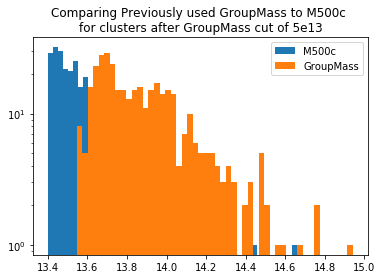

271 367
5345.2324 3883.3948
9226.109 6692.8516
9358.314 6886.1846


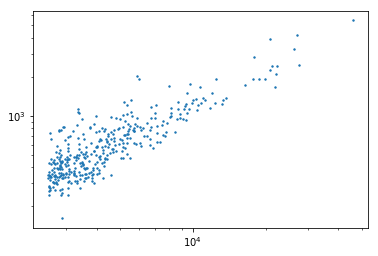

In [48]:
# COMPARING M200m to GROUPMASS

GroupMass_list = []
M200_list = []
M500c_list = []
Nsub_list = []
c = 0
count = 0
for h in halo_array_masked:
    GroupMass_list.append(halo_grp['GroupMass'][h])
    M200_list.append(halo_grp['Group_M_Mean200'][h])
    M500c_list.append(halo_grp['Group_M_Crit500'][h])
    Nsub_list.append(halo_grp['GroupNsubs'][h])
    if halo_grp['GroupMass'][h] >(5*10**3):#halo_grp['Group_M_Mean200'][h]:
        count+=1
    c +=1
plt.figure()
#plt.scatter(GroupMass_list, M200_list)
#plt.hist(np.log10(M200_list)+10, bins = 50, log=True, label = 'M200m')
plt.hist(np.log10(M500c_list)+10, bins = 50, log=True, label = 'M500c')
plt.hist(np.log10(GroupMass_list)+10, bins = 50, log=True, label = 'GroupMass')
plt.title('Comparing Previously used GroupMass to M500c \nfor clusters after GroupMass cut of 5e13')
plt.legend()
plt.show()
print(count, c)
print(np.mean(M500c_list), np.median(M500c_list))
print(np.mean(M200_list), np.median(M200_list))
print(np.mean(GroupMass_list), np.median(GroupMass_list))
plt.figure()
#plt.hist(Nsub_list, bins = 50)
plt.scatter(M500c_list, Nsub_list, s = 2)
plt.xscale('log')
plt.yscale('log')

# so use 13.5 cut on M200m

## New Color Split Profiles


Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 594689.2071130276
R500c, R200c, R200m: 0.7612624597816122 1.24644093717065 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 594689.2518899441
566208 566208 time 594689.279570818
N Subhalos within 7*R200m: 4517 594690.5774698257
galaxies [8, 21, 28, 34, 31, 59, 71, 83, 122, 129, 103, 76, 84, 53, 118, 236, 519, 628, 738, 1347]
blue galaxies counted [0, 0, 1, 2, 2, 10, 9, 7, 6, 13, 13, 13, 35, 33, 79, 113, 153, 260, 509, 810]
red galaxies counted [2, 3, 5, 3, 8, 8, 5, 5, 14, 12, 10, 8, 5, 2, 4, 18, 54, 47, 43, 97]
red galaxies counted [6, 18, 22, 29, 21, 41, 57, 71, 102, 104, 80, 55, 44, 18, 35, 105, 312, 321, 186, 440]
sum of galaxies: 4488

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 594690.6022789478
R500c, R200c, R200m: 0.5860514830407864 0.916949635434108 1.1697442162737657
Rscale 1.1697442162737657
before dev loop: 594690.6132421494
566208 566208 time 594690.6332809925
N S

N Subhalos within 7*R200m: 976 594691.8690919876
galaxies [5, 1, 6, 10, 17, 21, 24, 30, 32, 34, 50, 26, 12, 21, 18, 32, 93, 109, 168, 259]
blue galaxies counted [0, 0, 0, 1, 0, 2, 1, 5, 5, 2, 9, 1, 6, 19, 13, 21, 44, 84, 150, 194]
red galaxies counted [1, 0, 2, 3, 2, 2, 4, 4, 3, 4, 2, 2, 0, 0, 1, 1, 6, 5, 7, 16]
red galaxies counted [4, 1, 4, 6, 15, 17, 19, 21, 24, 28, 39, 23, 6, 2, 4, 10, 43, 20, 11, 49]
sum of galaxies: 968

Halo: 13
Halo Mass: 27343.611
N Subhalos from Illustris Algorithm: 1930 594691.8722770214
R500c, R200c, R200m: 0.493707176709387 0.7360678987552932 0.9043717716298794
Rscale 0.9043717716298794
before dev loop: 594691.8820137978
566208 566208 time 594691.9036347866
N Subhalos within 7*R200m: 903 594691.9529678822
galaxies [3, 5, 2, 13, 10, 21, 24, 17, 26, 25, 39, 37, 48, 37, 49, 52, 69, 97, 141, 178]
blue galaxies counted [1, 0, 0, 1, 2, 4, 5, 6, 7, 8, 12, 8, 14, 16, 38, 42, 56, 81, 128, 156]
red galaxies counted [1, 1, 0, 4, 0, 3, 2, 3, 2, 2, 1, 2, 7, 2, 3, 2, 6,

N Subhalos within 7*R200m: 853 594692.7635729313
galaxies [2, 4, 8, 13, 11, 13, 16, 26, 18, 22, 8, 18, 29, 65, 81, 64, 51, 71, 153, 173]
blue galaxies counted [0, 0, 1, 1, 0, 3, 3, 5, 5, 10, 4, 14, 14, 21, 38, 34, 39, 50, 61, 108]
red galaxies counted [1, 0, 2, 1, 0, 1, 0, 3, 0, 0, 1, 0, 2, 4, 5, 5, 3, 2, 13, 11]
red galaxies counted [1, 4, 5, 11, 11, 9, 13, 18, 13, 12, 3, 4, 13, 40, 38, 25, 9, 19, 79, 54]
sum of galaxies: 846

Halo: 25
Halo Mass: 19065.426
N Subhalos from Illustris Algorithm: 1228 594692.7660238743
R500c, R200c, R200m: 0.5023776780566084 0.7649002302428666 0.9437094634414113
Rscale 0.9437094634414113
before dev loop: 594692.7702441216
566208 566208 time 594692.7905569077
N Subhalos within 7*R200m: 939 594692.8354570866
galaxies [3, 2, 8, 8, 11, 14, 11, 12, 29, 18, 23, 25, 17, 20, 49, 40, 50, 177, 187, 228]
blue galaxies counted [0, 0, 0, 0, 2, 1, 1, 0, 5, 4, 4, 4, 5, 9, 26, 25, 34, 62, 105, 177]
red galaxies counted [0, 1, 1, 3, 0, 1, 2, 1, 3, 2, 0, 3, 1, 1, 3, 2, 2, 

N Subhalos within 7*R200m: 839 594693.630934
galaxies [4, 3, 7, 8, 8, 7, 15, 13, 12, 12, 36, 33, 24, 17, 32, 32, 58, 85, 198, 227]
blue galaxies counted [0, 0, 0, 0, 0, 1, 1, 1, 2, 3, 8, 6, 8, 13, 28, 26, 47, 51, 105, 153]
red galaxies counted [0, 0, 1, 1, 3, 0, 3, 1, 1, 0, 4, 5, 0, 1, 0, 1, 3, 7, 19, 13]
red galaxies counted [4, 3, 6, 7, 5, 6, 11, 11, 9, 9, 24, 22, 16, 3, 4, 5, 8, 27, 74, 61]
sum of galaxies: 831

Halo: 37
Halo Mass: 16608.855
N Subhalos from Illustris Algorithm: 1257 594693.6347761154
R500c, R200c, R200m: 0.4566091322127358 0.7167290968668999 0.8825100786829236
Rscale 0.8825100786829236
before dev loop: 594693.6395881176
566208 566208 time 594693.6615002155
N Subhalos within 7*R200m: 749 594693.7026748657
galaxies [7, 5, 5, 12, 14, 11, 22, 18, 19, 32, 20, 18, 10, 13, 18, 33, 31, 42, 145, 269]
blue galaxies counted [0, 0, 1, 1, 1, 3, 5, 4, 8, 6, 7, 11, 7, 11, 12, 25, 25, 33, 98, 161]
red galaxies counted [1, 0, 1, 1, 3, 2, 4, 0, 1, 4, 0, 1, 2, 0, 0, 3, 1, 3, 6, 17]
re

N Subhalos within 7*R200m: 683 594694.486577034
galaxies [4, 4, 11, 9, 7, 10, 17, 13, 17, 13, 22, 15, 20, 24, 49, 33, 54, 56, 112, 190]
blue galaxies counted [0, 2, 1, 1, 1, 2, 3, 2, 3, 5, 8, 6, 4, 11, 18, 21, 36, 44, 58, 107]
red galaxies counted [1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 2, 1, 6, 4, 1, 1, 14, 14]
red galaxies counted [3, 2, 10, 7, 5, 8, 13, 10, 13, 8, 14, 9, 14, 12, 25, 8, 17, 11, 40, 69]
sum of galaxies: 680

Halo: 49
Halo Mass: 14361.839
N Subhalos from Illustris Algorithm: 1337 594694.4893989563
R500c, R200c, R200m: 0.3768843255150251 0.5990511097905536 0.7415446917762308
Rscale 0.7415446917762308
before dev loop: 594694.4940657616
566208 566208 time 594694.5157837868
N Subhalos within 7*R200m: 563 594694.557874918
galaxies [2, 2, 4, 3, 4, 8, 9, 13, 13, 15, 14, 10, 31, 24, 27, 53, 37, 72, 87, 130]
blue galaxies counted [1, 0, 0, 0, 0, 1, 1, 5, 8, 5, 8, 3, 10, 17, 19, 42, 29, 56, 80, 103]
red galaxies counted [1, 0, 0, 1, 2, 0, 0, 2, 1, 2, 0, 1, 5, 0, 1, 3, 3, 6, 1, 9]
r

before dev loop: 594695.3124909401
566208 566208 time 594695.3343741894
N Subhalos within 7*R200m: 473 594695.3756988049
galaxies [1, 6, 4, 5, 8, 11, 22, 18, 23, 14, 11, 11, 6, 7, 9, 14, 17, 56, 110, 112]
blue galaxies counted [1, 1, 2, 1, 1, 4, 3, 6, 6, 4, 5, 7, 4, 7, 9, 11, 15, 32, 73, 88]
red galaxies counted [0, 1, 0, 2, 2, 0, 4, 0, 1, 1, 0, 1, 1, 0, 0, 2, 1, 2, 4, 7]
red galaxies counted [0, 4, 2, 2, 5, 7, 15, 12, 16, 9, 6, 3, 1, 0, 0, 1, 1, 22, 33, 17]
sum of galaxies: 465

Halo: 62
Halo Mass: 13000.34
N Subhalos from Illustris Algorithm: 1047 594695.3796949387
R500c, R200c, R200m: 0.4069041589001368 0.6331709514128275 0.782193111526722
Rscale 0.782193111526722
before dev loop: 594695.3855979443
566208 566208 time 594695.4108760357
N Subhalos within 7*R200m: 386 594695.453772068
galaxies [1, 5, 8, 4, 7, 11, 11, 11, 13, 8, 14, 4, 15, 15, 10, 10, 21, 37, 68, 108]
blue galaxies counted [0, 1, 1, 0, 0, 1, 4, 2, 1, 1, 2, 2, 9, 8, 9, 9, 21, 35, 57, 56]
red galaxies counted [1, 0, 0, 1,

N Subhalos within 7*R200m: 607 594696.3900499344
galaxies [3, 3, 2, 6, 6, 11, 6, 10, 10, 13, 15, 18, 14, 14, 17, 47, 62, 103, 131, 114]
blue galaxies counted [0, 0, 0, 0, 1, 1, 1, 3, 2, 4, 2, 3, 5, 6, 11, 21, 36, 55, 93, 107]
red galaxies counted [1, 1, 0, 1, 0, 2, 1, 0, 1, 1, 1, 3, 0, 0, 1, 5, 8, 6, 11, 2]
red galaxies counted [2, 2, 2, 5, 5, 8, 4, 7, 7, 8, 12, 12, 9, 8, 5, 21, 18, 42, 27, 5]
sum of galaxies: 605

Halo: 76
Halo Mass: 11053.76
N Subhalos from Illustris Algorithm: 749 594696.3931908607
R500c, R200c, R200m: 0.4207121212581975 0.6474206539076773 0.7837246694996244
Rscale 0.7837246694996244
before dev loop: 594696.3971869946
566208 566208 time 594696.4188840389
N Subhalos within 7*R200m: 451 594696.4583311081
galaxies [3, 5, 2, 3, 5, 11, 19, 13, 19, 16, 8, 5, 7, 11, 19, 27, 34, 34, 81, 125]
blue galaxies counted [0, 1, 0, 0, 1, 1, 2, 1, 4, 6, 2, 2, 7, 10, 13, 22, 29, 28, 51, 107]
red galaxies counted [0, 0, 0, 1, 0, 1, 2, 2, 1, 1, 0, 0, 0, 0, 1, 1, 2, 0, 6, 4]
red galaxies

N Subhalos within 7*R200m: 702 594697.2632939816
galaxies [0, 4, 3, 0, 4, 7, 4, 8, 23, 22, 14, 18, 18, 7, 32, 54, 98, 76, 121, 180]
blue galaxies counted [0, 0, 0, 0, 1, 0, 0, 2, 6, 4, 6, 7, 12, 1, 12, 17, 56, 47, 78, 88]
red galaxies counted [0, 0, 1, 0, 2, 1, 1, 1, 1, 3, 2, 0, 2, 0, 1, 2, 8, 4, 5, 14]
red galaxies counted [0, 4, 2, 0, 1, 6, 3, 5, 16, 15, 6, 11, 4, 6, 19, 35, 34, 25, 38, 78]
sum of galaxies: 693

Halo: 89
Halo Mass: 10413.816
N Subhalos from Illustris Algorithm: 781 594697.2656049728
R500c, R200c, R200m: 0.3573148851520947 0.554265970210963 0.68595725634662
Rscale 0.68595725634662
before dev loop: 594697.26989007
566208 566208 time 594697.2927379608
N Subhalos within 7*R200m: 438 594697.3324668407
galaxies [2, 2, 1, 1, 2, 5, 5, 4, 10, 9, 12, 15, 14, 11, 27, 22, 31, 109, 74, 80]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 4, 6, 8, 8, 12, 13, 23, 64, 58, 62]
red galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 2, 0, 0, 0, 1, 0, 3, 3, 1, 6, 5, 2]
red galaxies counted [

before dev loop: 594698.0742909908
566208 566208 time 594698.0948331356
N Subhalos within 7*R200m: 284 594698.1330049038
galaxies [1, 1, 2, 2, 3, 5, 5, 3, 9, 9, 10, 13, 20, 23, 11, 11, 14, 36, 34, 68]
blue galaxies counted [0, 0, 0, 1, 0, 4, 1, 0, 1, 2, 6, 4, 6, 10, 9, 11, 14, 33, 26, 48]
red galaxies counted [0, 0, 1, 1, 0, 0, 2, 0, 1, 1, 1, 0, 1, 2, 0, 0, 0, 0, 2, 4]
red galaxies counted [1, 1, 1, 0, 3, 1, 2, 3, 7, 6, 3, 9, 13, 11, 2, 0, 0, 3, 6, 16]
sum of galaxies: 280

Halo: 102
Halo Mass: 9930.823
N Subhalos from Illustris Algorithm: 783 594698.1344959736
R500c, R200c, R200m: 0.3890160854272616 0.5731047818357747 0.700963930248612
Rscale 0.700963930248612
before dev loop: 594698.1388337612
566208 566208 time 594698.1594548225
N Subhalos within 7*R200m: 400 594698.2000060081
galaxies [3, 3, 3, 5, 6, 10, 7, 8, 8, 8, 8, 11, 17, 18, 27, 30, 19, 48, 82, 72]
blue galaxies counted [1, 0, 0, 0, 0, 6, 3, 2, 2, 2, 4, 3, 9, 11, 14, 19, 17, 40, 52, 60]
red galaxies counted [1, 0, 1, 1, 2, 0,

before dev loop: 594698.9421548843
566208 566208 time 594698.963244915
N Subhalos within 7*R200m: 431 594699.0026328564
galaxies [2, 0, 4, 3, 8, 4, 11, 8, 9, 11, 9, 12, 12, 31, 15, 21, 22, 48, 84, 114]
blue galaxies counted [0, 0, 1, 0, 0, 1, 3, 1, 3, 5, 0, 1, 2, 8, 9, 17, 22, 35, 35, 67]
red galaxies counted [0, 0, 0, 0, 2, 1, 0, 1, 0, 1, 1, 2, 0, 1, 1, 0, 0, 1, 7, 8]
red galaxies counted [2, 0, 3, 3, 6, 2, 8, 6, 6, 5, 8, 9, 10, 22, 5, 4, 0, 12, 42, 39]
sum of galaxies: 428

Halo: 115
Halo Mass: 9228.84
N Subhalos from Illustris Algorithm: 667 594699.0038881302
R500c, R200c, R200m: 0.3409618926838454 0.587031286204442 0.7343132688191691
Rscale 0.7343132688191691
before dev loop: 594699.0081009865
566208 566208 time 594699.029214859
N Subhalos within 7*R200m: 495 594699.067335844
galaxies [2, 1, 1, 1, 2, 5, 11, 13, 13, 15, 18, 7, 3, 0, 14, 17, 42, 49, 82, 196]
blue galaxies counted [1, 1, 0, 0, 0, 2, 2, 1, 1, 4, 7, 2, 2, 0, 13, 15, 33, 38, 60, 111]
red galaxies counted [0, 0, 0, 0, 1, 

before dev loop: 594699.8057730198
566208 566208 time 594699.8273699284
N Subhalos within 7*R200m: 574 594699.8663539886
galaxies [0, 3, 0, 4, 13, 6, 11, 16, 16, 11, 5, 7, 5, 8, 6, 11, 26, 71, 185, 160]
blue galaxies counted [0, 1, 0, 0, 0, 2, 2, 2, 5, 3, 1, 5, 5, 6, 6, 10, 20, 31, 72, 111]
red galaxies counted [0, 0, 0, 0, 2, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 8, 17, 10]
red galaxies counted [0, 2, 0, 4, 11, 3, 9, 14, 10, 7, 4, 2, 0, 2, 0, 1, 5, 32, 96, 39]
sum of galaxies: 564

Halo: 128
Halo Mass: 8926.37
N Subhalos from Illustris Algorithm: 792 594699.8697080612
R500c, R200c, R200m: 0.34657992724933545 0.5474611944025112 0.6935963100878747
Rscale 0.6935963100878747
before dev loop: 594699.8736948967
566208 566208 time 594699.8952829838
N Subhalos within 7*R200m: 354 594699.9350838661
galaxies [2, 2, 3, 9, 5, 4, 7, 6, 9, 7, 14, 6, 17, 14, 24, 35, 21, 44, 48, 75]
blue galaxies counted [0, 0, 0, 2, 0, 0, 3, 2, 5, 4, 3, 4, 13, 10, 13, 28, 17, 36, 31, 59]
red galaxies counted [0, 0, 0,

566208 566208 time 594700.6744701862
N Subhalos within 7*R200m: 455 594700.7128460407
galaxies [2, 2, 3, 6, 7, 3, 11, 9, 7, 12, 12, 11, 16, 8, 16, 22, 20, 43, 70, 171]
blue galaxies counted [0, 0, 0, 1, 0, 0, 2, 2, 0, 1, 5, 4, 6, 4, 12, 17, 16, 29, 60, 103]
red galaxies counted [1, 0, 0, 1, 0, 0, 2, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 12]
red galaxies counted [1, 2, 3, 4, 7, 3, 7, 6, 6, 9, 6, 6, 9, 3, 3, 3, 3, 13, 8, 56]
sum of galaxies: 451

Halo: 143
Halo Mass: 8346.669
N Subhalos from Illustris Algorithm: 612 594700.7148709297
R500c, R200c, R200m: 0.38814289400769414 0.5854102111982008 0.7205852952950131
Rscale 0.7205852952950131
before dev loop: 594700.7189819813
566208 566208 time 594700.7402410507
N Subhalos within 7*R200m: 442 594700.7788069248
galaxies [2, 2, 6, 5, 9, 7, 11, 12, 12, 10, 14, 15, 9, 8, 8, 7, 40, 62, 90, 110]
blue galaxies counted [0, 0, 0, 0, 1, 2, 3, 2, 2, 2, 4, 7, 4, 3, 7, 7, 25, 38, 69, 64]
red galaxies counted [0, 0, 1, 3, 2, 2, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 

before dev loop: 594701.5230550766
566208 566208 time 594701.5437171459
N Subhalos within 7*R200m: 446 594701.5852940083
galaxies [0, 1, 0, 5, 0, 6, 5, 14, 12, 17, 12, 8, 7, 7, 9, 26, 10, 38, 79, 186]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 6, 4, 3, 1, 1, 5, 6, 7, 17, 8, 31, 62, 125]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 4, 0, 2, 3, 9]
red galaxies counted [0, 1, 0, 5, 0, 6, 4, 7, 8, 13, 10, 7, 2, 0, 2, 5, 2, 5, 14, 52]
sum of galaxies: 442

Halo: 158
Halo Mass: 8053.81
N Subhalos from Illustris Algorithm: 703 594701.5874018669
R500c, R200c, R200m: 0.3107090988260152 0.4755271720168756 0.593834300497032
Rscale 0.593834300497032
before dev loop: 594701.5924370289
566208 566208 time 594701.6162469387
N Subhalos within 7*R200m: 359 594701.6551969051
galaxies [0, 0, 1, 2, 4, 5, 4, 7, 9, 11, 9, 16, 20, 18, 11, 17, 35, 42, 52, 94]
blue galaxies counted [0, 0, 0, 1, 0, 1, 0, 3, 7, 3, 3, 5, 9, 8, 8, 17, 18, 35, 35, 60]
red galaxies counted [0, 0, 0, 0, 3, 0, 0,

566208 566208 time 594702.6056628227
N Subhalos within 7*R200m: 597 594702.6444919109
galaxies [1, 0, 1, 3, 2, 6, 4, 7, 6, 8, 10, 21, 33, 30, 38, 24, 88, 154, 71, 82]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 1, 3, 2, 1, 10, 20, 19, 25, 13, 21, 48, 42, 64]
red galaxies counted [0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 3, 3, 1, 5, 15, 5, 2]
red galaxies counted [1, 0, 1, 3, 2, 5, 4, 5, 3, 6, 9, 10, 12, 8, 10, 10, 62, 91, 24, 16]
sum of galaxies: 589

Halo: 175
Halo Mass: 7307.713
N Subhalos from Illustris Algorithm: 570 594702.6469490528
R500c, R200c, R200m: 0.3377961284046414 0.5293714673979153 0.6589734355837126
Rscale 0.6589734355837126
before dev loop: 594702.6508951187
566208 566208 time 594702.6711158752
N Subhalos within 7*R200m: 316 594702.7084290981
galaxies [2, 0, 4, 5, 7, 4, 5, 3, 13, 10, 8, 16, 10, 12, 7, 10, 32, 31, 42, 91]
blue galaxies counted [0, 0, 0, 0, 1, 0, 1, 2, 4, 4, 4, 4, 5, 9, 6, 10, 24, 27, 32, 77]
red galaxies counted [0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 

566208 566208 time 594703.5077438354
N Subhalos within 7*R200m: 239 594703.5470640659
galaxies [1, 4, 2, 3, 2, 3, 6, 12, 12, 8, 5, 9, 4, 6, 13, 19, 13, 22, 42, 50]
blue galaxies counted [0, 2, 1, 1, 0, 0, 0, 7, 4, 8, 2, 4, 4, 4, 8, 15, 12, 14, 26, 43]
red galaxies counted [1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 2, 1, 0, 1, 1, 1, 0, 3, 3, 1]
red galaxies counted [0, 2, 1, 2, 2, 2, 5, 4, 8, 0, 1, 4, 0, 1, 4, 3, 1, 5, 13, 6]
sum of galaxies: 236

Halo: 192
Halo Mass: 6880.6846
N Subhalos from Illustris Algorithm: 510 594703.5482549667
R500c, R200c, R200m: 0.3320443787714628 0.5399835996037677 0.6750545140580275
Rscale 0.6750545140580275
before dev loop: 594703.5528609753
566208 566208 time 594703.5750749111
N Subhalos within 7*R200m: 595 594703.6143250465
galaxies [0, 1, 1, 4, 4, 3, 9, 9, 13, 11, 6, 7, 8, 6, 13, 38, 87, 91, 107, 174]
blue galaxies counted [0, 0, 0, 0, 0, 1, 1, 0, 0, 3, 0, 4, 4, 6, 10, 26, 24, 40, 69, 78]
red galaxies counted [0, 0, 0, 2, 0, 0, 0, 1, 3, 1, 0, 0, 1, 0, 0, 2, 6, 7, 4

566208 566208 time 594704.4338328838
N Subhalos within 7*R200m: 188 594704.4775290489
galaxies [1, 2, 5, 5, 6, 6, 4, 14, 9, 9, 10, 5, 8, 3, 7, 8, 14, 16, 19, 33]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 3, 2, 4, 5, 3, 6, 3, 6, 6, 13, 14, 18, 29]
red galaxies counted [0, 0, 1, 2, 0, 0, 2, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1]
red galaxies counted [1, 2, 4, 3, 6, 6, 1, 10, 7, 4, 5, 2, 2, 0, 1, 2, 1, 1, 1, 3]
sum of galaxies: 184

Halo: 210
Halo Mass: 6658.897
N Subhalos from Illustris Algorithm: 599 594704.48112607
R500c, R200c, R200m: 0.28703044230209973 0.45941891015005754 0.5882327601255203
Rscale 0.5882327601255203
before dev loop: 594704.4860210419
566208 566208 time 594704.5099229813
N Subhalos within 7*R200m: 399 594704.5541679859
galaxies [1, 2, 2, 3, 2, 10, 4, 7, 8, 3, 14, 15, 5, 7, 9, 14, 43, 40, 68, 139]
blue galaxies counted [0, 0, 0, 0, 1, 2, 1, 3, 2, 1, 8, 9, 2, 3, 7, 8, 33, 26, 42, 66]
red galaxies counted [1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 2, 0, 1, 0, 3, 1, 3, 4, 11]
r

before dev loop: 594705.4990718365
566208 566208 time 594705.5199050903
N Subhalos within 7*R200m: 314 594705.5581560135
galaxies [3, 2, 2, 5, 5, 8, 4, 4, 8, 8, 6, 8, 16, 15, 6, 29, 26, 27, 27, 99]
blue galaxies counted [0, 0, 0, 0, 0, 0, 2, 0, 0, 3, 4, 5, 7, 8, 5, 15, 19, 23, 22, 79]
red galaxies counted [0, 1, 2, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 3, 1, 2, 2, 4]
red galaxies counted [3, 1, 0, 4, 4, 8, 2, 3, 8, 5, 2, 2, 8, 7, 1, 11, 6, 2, 3, 16]
sum of galaxies: 308

Halo: 228
Halo Mass: 5981.5605
N Subhalos from Illustris Algorithm: 430 594705.5612709522
R500c, R200c, R200m: 0.3201286647762267 0.5126069207692353 0.6407156839865751
Rscale 0.6407156839865751
before dev loop: 594705.5657520294
566208 566208 time 594705.5863859653
N Subhalos within 7*R200m: 340 594705.6243619919
galaxies [3, 2, 1, 3, 5, 4, 8, 10, 4, 8, 12, 13, 6, 8, 16, 46, 28, 33, 75, 54]
blue galaxies counted [0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 5, 4, 2, 4, 6, 12, 17, 20, 33, 39]
red galaxies counted [0, 0, 0, 0, 1, 1, 1, 3

before dev loop: 594706.3604059219
566208 566208 time 594706.3818480968
N Subhalos within 7*R200m: 333 594706.4214980602
galaxies [0, 1, 1, 2, 6, 12, 7, 6, 7, 7, 4, 0, 3, 5, 4, 8, 24, 28, 50, 153]
blue galaxies counted [0, 0, 0, 0, 3, 6, 3, 1, 2, 4, 2, 0, 3, 4, 4, 8, 20, 23, 46, 109]
red galaxies counted [0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 15]
red galaxies counted [0, 0, 1, 2, 2, 6, 3, 5, 5, 3, 1, 0, 0, 1, 0, 0, 3, 4, 4, 29]
sum of galaxies: 328

Halo: 242
Halo Mass: 5958.2607
N Subhalos from Illustris Algorithm: 521 594706.423427105
R500c, R200c, R200m: 0.32684578515332996 0.5150684390137957 0.6334359794811204
Rscale 0.6334359794811204
before dev loop: 594706.427754879
566208 566208 time 594706.4488198757
N Subhalos within 7*R200m: 193 594706.4876279831
galaxies [0, 2, 2, 4, 1, 3, 9, 4, 12, 11, 6, 1, 3, 5, 7, 8, 14, 13, 31, 54]
blue galaxies counted [0, 0, 2, 1, 0, 1, 1, 2, 3, 6, 1, 1, 3, 5, 5, 8, 10, 13, 26, 42]
red galaxies counted [0, 0, 0, 0, 0, 0, 2, 0, 1, 0

N Subhalos within 7*R200m: 449 594707.2699949741
galaxies [0, 2, 1, 1, 6, 5, 6, 14, 4, 8, 8, 7, 7, 3, 9, 18, 28, 48, 95, 175]
blue galaxies counted [0, 1, 0, 0, 0, 1, 0, 5, 0, 4, 1, 4, 4, 2, 8, 11, 21, 24, 52, 102]
red galaxies counted [0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 5, 8, 20]
red galaxies counted [0, 0, 1, 1, 5, 4, 5, 9, 4, 4, 6, 3, 3, 0, 1, 6, 6, 19, 35, 53]
sum of galaxies: 445

Halo: 264
Halo Mass: 5323.262
N Subhalos from Illustris Algorithm: 300 594707.2718861103
R500c, R200c, R200m: 0.3351313352330785 0.5024352475977271 0.620847626650624
Rscale 0.620847626650624
before dev loop: 594707.2760438919
566208 566208 time 594707.2957880497
N Subhalos within 7*R200m: 392 594707.3354330063
galaxies [2, 1, 2, 2, 2, 3, 8, 4, 5, 6, 5, 4, 7, 20, 24, 57, 42, 58, 48, 90]
blue galaxies counted [0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 2, 0, 3, 5, 4, 22, 20, 43, 36, 56]
red galaxies counted [0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 4, 4, 7, 4, 4, 5, 7]
red galaxies counted [2, 0, 1, 2, 2,

N Subhalos within 7*R200m: 196 594708.1513290405
galaxies [1, 0, 2, 3, 5, 3, 4, 6, 7, 9, 8, 11, 2, 3, 5, 10, 6, 22, 33, 50]
blue galaxies counted [0, 0, 0, 0, 0, 1, 0, 4, 3, 5, 2, 4, 1, 2, 5, 7, 5, 18, 28, 44]
red galaxies counted [0, 0, 2, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 3, 2]
red galaxies counted [1, 0, 0, 2, 4, 2, 4, 2, 3, 3, 6, 7, 1, 1, 0, 2, 0, 4, 2, 4]
sum of galaxies: 190

Halo: 279
Halo Mass: 5378.4937
N Subhalos from Illustris Algorithm: 429 594708.1525790691
R500c, R200c, R200m: 0.3139084920443983 0.4986738507505379 0.618305438986485
Rscale 0.618305438986485
before dev loop: 594708.1573691368
566208 566208 time 594708.179006815
N Subhalos within 7*R200m: 349 594708.2178499699
galaxies [1, 2, 3, 1, 5, 8, 6, 6, 10, 4, 6, 4, 1, 8, 13, 9, 19, 21, 69, 152]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 4, 1, 0, 1, 2, 1, 2, 10, 7, 18, 17, 57, 97]
red galaxies counted [0, 0, 1, 0, 1, 0, 0, 0, 1, 2, 0, 0, 0, 2, 0, 1, 1, 1, 3, 15]
red galaxies counted [1, 2, 2, 1, 4, 8, 5, 2

N Subhalos within 7*R200m: 378 594709.0154018402
galaxies [0, 0, 4, 3, 1, 5, 4, 8, 7, 9, 13, 2, 4, 2, 6, 18, 30, 41, 63, 154]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 5, 0, 3, 1, 5, 11, 27, 32, 37, 90]
red galaxies counted [0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 2, 0, 0, 0, 0, 1, 0, 2, 5, 14]
red galaxies counted [0, 0, 4, 2, 1, 4, 3, 8, 5, 6, 6, 2, 1, 1, 1, 6, 3, 7, 21, 50]
sum of galaxies: 374

Halo: 299
Halo Mass: 5121.6265
N Subhalos from Illustris Algorithm: 392 594709.0167090893
R500c, R200c, R200m: 0.3265473683525663 0.49782311865820794 0.6106951700157894
Rscale 0.6106951700157894
before dev loop: 594709.0214898586
566208 566208 time 594709.0414478779
N Subhalos within 7*R200m: 253 594709.078305006
galaxies [3, 1, 1, 3, 1, 5, 3, 7, 5, 2, 5, 7, 8, 5, 6, 11, 8, 20, 52, 94]
blue galaxies counted [0, 0, 0, 0, 1, 1, 2, 3, 3, 1, 0, 4, 5, 1, 5, 9, 7, 18, 27, 45]
red galaxies counted [1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 6, 9]
red galaxies counted [2, 1, 1, 3, 0, 4, 

before dev loop: 594709.8970868587
566208 566208 time 594709.9195969105
N Subhalos within 7*R200m: 178 594709.9616789818
galaxies [1, 1, 2, 4, 2, 0, 4, 4, 11, 5, 10, 7, 3, 4, 6, 4, 20, 12, 29, 43]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 1, 2, 2, 2, 1, 3, 4, 6, 3, 17, 9, 25, 33]
red galaxies counted [0, 0, 0, 0, 1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3]
red galaxies counted [1, 1, 2, 4, 1, 0, 4, 3, 7, 3, 8, 6, 0, 0, 0, 1, 3, 3, 2, 7]
sum of galaxies: 172

Halo: 314
Halo Mass: 4915.4263
N Subhalos from Illustris Algorithm: 275 594709.9628839493
R500c, R200c, R200m: 0.3204770445723422 0.47756276373295137 0.5844629560435364
Rscale 0.5844629560435364
before dev loop: 594709.9673278332
566208 566208 time 594709.9914391041
N Subhalos within 7*R200m: 239 594710.0304310322
galaxies [3, 1, 1, 1, 3, 2, 3, 4, 2, 10, 4, 11, 9, 14, 9, 13, 22, 16, 30, 76]
blue galaxies counted [1, 0, 0, 0, 1, 0, 1, 2, 2, 7, 0, 5, 5, 6, 5, 10, 12, 14, 25, 64]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 

566208 566208 time 594710.9384801388
N Subhalos within 7*R200m: 182 594710.9765889645
galaxies [0, 1, 0, 2, 5, 3, 2, 9, 7, 4, 4, 7, 3, 4, 5, 6, 10, 24, 31, 54]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 3, 1, 2, 0, 0, 2, 1, 5, 6, 10, 20, 29, 44]
red galaxies counted [0, 0, 0, 1, 1, 0, 0, 1, 2, 0, 0, 2, 0, 1, 0, 0, 0, 1, 0, 5]
red galaxies counted [0, 1, 0, 1, 4, 3, 2, 5, 4, 2, 4, 5, 1, 2, 0, 0, 0, 3, 2, 5]
sum of galaxies: 181

Halo: 340
Halo Mass: 4894.538
N Subhalos from Illustris Algorithm: 390 594710.9777369499
R500c, R200c, R200m: 0.3258993306876936 0.4907469092692386 0.599853400196685
Rscale 0.599853400196685
before dev loop: 594710.9824187756
566208 566208 time 594711.002010107
N Subhalos within 7*R200m: 189 594711.0395798683
galaxies [2, 1, 3, 2, 2, 8, 5, 9, 10, 2, 6, 3, 3, 3, 4, 13, 8, 18, 25, 59]
blue galaxies counted [0, 0, 0, 0, 0, 1, 2, 2, 4, 1, 1, 3, 2, 2, 4, 10, 4, 17, 23, 55]
red galaxies counted [0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 2, 2]
red galaxies

galaxies [1, 1, 1, 2, 2, 4, 5, 6, 9, 11, 7, 9, 12, 8, 6, 14, 30, 90, 195, 205]
blue galaxies counted [0, 0, 0, 1, 0, 0, 0, 0, 0, 3, 1, 2, 0, 4, 4, 9, 7, 14, 60, 95]
red galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 12, 15, 21]
red galaxies counted [1, 1, 1, 1, 2, 4, 4, 6, 9, 7, 6, 7, 11, 4, 2, 5, 23, 64, 120, 89]
sum of galaxies: 618

Halo: 369
Halo Mass: 4679.082
N Subhalos from Illustris Algorithm: 330 594711.8220999241
R500c, R200c, R200m: 0.30272710997403574 0.4722461885865316 0.5846195708174279
Rscale 0.5846195708174279
before dev loop: 594711.8260500431
566208 566208 time 594711.8456060886
N Subhalos within 7*R200m: 288 594711.8846771717
galaxies [0, 3, 1, 1, 6, 4, 5, 6, 8, 5, 8, 7, 6, 10, 4, 12, 17, 39, 85, 58]
blue galaxies counted [0, 0, 0, 0, 1, 1, 1, 1, 2, 2, 3, 5, 4, 10, 4, 12, 17, 30, 49, 34]
red galaxies counted [0, 0, 1, 0, 0, 1, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 1, 11, 5]
red galaxies counted [0, 3, 0, 1, 5, 2, 4, 3, 4, 3, 5, 2, 2, 0, 0, 0, 0, 8, 2

/Users/TaraD/anaconda3/lib/python3.7/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))
/Users/TaraD/anaconda3/lib/python3.7/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


RuntimeError: latex was not able to process the following string:
b' (20 Bins)(Stellar Mass > 10^8, Color: Stellar Mass Basic [0.5,10.2])'

Here is the full report generated by latex:
This is pdfTeX, Version 3.14159265-2.6-1.40.21 (TeX Live 2020) (preloaded format=latex)
 restricted \write18 enabled.
entering extended mode
(/Users/TaraD/.matplotlib/tex.cache/3044922b77f61f4abede1d82f0be2392.tex
LaTeX2e <2020-02-02> patch level 5
L3 programming layer <2020-03-06>
(/usr/local/texlive/2020/texmf-dist/tex/latex/base/article.cls
Document Class: article 2019/12/20 v1.4l Standard LaTeX document class
(/usr/local/texlive/2020/texmf-dist/tex/latex/base/size10.clo))
(/usr/local/texlive/2020/texmf-dist/tex/latex/type1cm/type1cm.sty)
(/usr/local/texlive/2020/texmf-dist/tex/latex/psnfss/mathpazo.sty)
(/usr/local/texlive/2020/texmf-dist/tex/latex/base/textcomp.sty)
(/usr/local/texlive/2020/texmf-dist/tex/latex/base/inputenc.sty)
(/usr/local/texlive/2020/texmf-dist/tex/latex/geometry/geometry.sty
(/usr/local/texlive/2020/texmf-dist/tex/latex/graphics/keyval.sty)
(/usr/local/texlive/2020/texmf-dist/tex/generic/iftex/ifvtex.sty
(/usr/local/texlive/2020/texmf-dist/tex/generic/iftex/iftex.sty))

Package geometry Warning: Over-specification in `h'-direction.
    `width' (5058.9pt) is ignored.


Package geometry Warning: Over-specification in `v'-direction.
    `height' (5058.9pt) is ignored.

) (/usr/local/texlive/2020/texmf-dist/tex/latex/l3backend/l3backend-dvips.def)
No file 3044922b77f61f4abede1d82f0be2392.aux.
(/usr/local/texlive/2020/texmf-dist/tex/latex/psnfss/ot1ppl.fd)
*geometry* driver: auto-detecting
*geometry* detected driver: dvips
! Missing $ inserted.
<inserted text> 
                $
l.14 ...0}{\rmfamily  (20 Bins)(Stellar Mass > 10^
                                                  8, Color: Stellar Mass Bas...
No pages of output.
Transcript written on 3044922b77f61f4abede1d82f0be2392.log.




<Figure size 720x288 with 1 Axes>

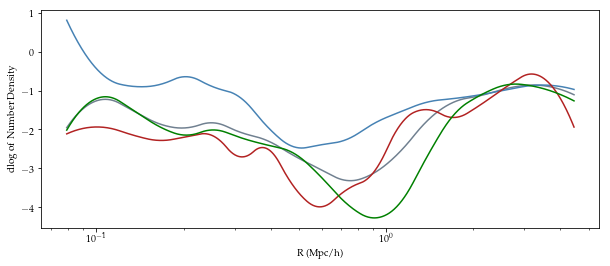

In [226]:
# Running Color Split Profiles
#(DO NOT USE)
bin_stack1, Yi_avg1, cov1, boot_err1, Yi_avg_blue1, cov_blue1, boot_err_blue1, Yi_avg_red1, cov_red1, boot_err_red1, Yi_avg_green1, cov_green1, boot_err_green1, red1_ratio1, red2_ratio1, number_red11, number_red21, red1_submass, red2_submass, R_avg1, color_title1  = ColorProfiles(subhalo_table_m, CM_coords,halo_array_masked,'basic','stellarmass')




Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 14051.14262509346
R500c, R200c, R200m: 0.7612624597816122 1.24644093717065 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 14051.19081401825
566208 566208 time 14051.231359004974
N Subhalos within 7*R200m: 4517 14052.08558011055
galaxies 0 [   8.   21.   28.   34.   31.   59.   71.   83.  122.  129.  103.   76.
   84.   53.  118.  236.  519.  628.  738. 1347.]
galaxies 1 [  0.   0.   1.   2.   2.  10.   9.   7.   6.  13.  13.  13.  35.  33.
  79. 113. 153. 260. 509. 810.]
galaxies 2 [ 2.  3.  5.  3.  8.  8.  5.  5. 14. 12. 10.  8.  5.  2.  4. 18. 54. 47.
 43. 97.]
galaxies 3 [  6.  18.  22.  29.  21.  41.  57.  71. 102. 104.  80.  55.  44.  18.
  35. 105. 312. 321. 186. 440.]

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 14052.098593235016
R500c, R200c, R200m: 0.5860514830407864 0.916949635434108 1.1697442162737657
Rscale 1.1697442162737657
before dev loop: 14052.106501340866

N Subhalos within 7*R200m: 976 14053.214416265488
galaxies 0 [  5.   1.   6.  10.  17.  21.  24.  30.  32.  34.  50.  26.  12.  21.
  18.  32.  93. 109. 168. 259.]
galaxies 1 [  0.   0.   0.   1.   0.   2.   1.   5.   5.   2.   9.   1.   6.  19.
  13.  21.  44.  84. 150. 194.]
galaxies 2 [ 1.  0.  2.  3.  2.  2.  4.  4.  3.  4.  2.  2.  0.  0.  1.  1.  6.  5.
  7. 16.]
galaxies 3 [ 4.  1.  4.  6. 15. 17. 19. 21. 24. 28. 39. 23.  6.  2.  4. 10. 43. 20.
 11. 49.]

Halo: 13
Halo Mass: 27343.611
N Subhalos from Illustris Algorithm: 1930 14053.217993021011
R500c, R200c, R200m: 0.493707176709387 0.7360678987552932 0.9043717716298794
Rscale 0.9043717716298794
before dev loop: 14053.228250265121
566208 566208 time 14053.251665353775
N Subhalos within 7*R200m: 903 14053.29933333397
galaxies 0 [  3.   5.   2.  13.  10.  21.  24.  17.  26.  25.  39.  37.  48.  37.
  49.  52.  69.  97. 141. 178.]
galaxies 1 [  1.   0.   0.   1.   2.   4.   5.   6.   7.   8.  12.   8.  14.  16.
  38.  42.  56.  81.

N Subhalos within 7*R200m: 853 14054.116969108582
galaxies 0 [  2.   4.   8.  13.  11.  13.  16.  26.  18.  22.   8.  18.  29.  65.
  81.  64.  51.  71. 153. 173.]
galaxies 1 [  0.   0.   1.   1.   0.   3.   3.   5.   5.  10.   4.  14.  14.  21.
  38.  34.  39.  50.  61. 108.]
galaxies 2 [ 1.  0.  2.  1.  0.  1.  0.  3.  0.  0.  1.  0.  2.  4.  5.  5.  3.  2.
 13. 11.]
galaxies 3 [ 1.  4.  5. 11. 11.  9. 13. 18. 13. 12.  3.  4. 13. 40. 38. 25.  9. 19.
 79. 54.]

Halo: 25
Halo Mass: 19065.426
N Subhalos from Illustris Algorithm: 1228 14054.1215569973
R500c, R200c, R200m: 0.5023776780566084 0.7649002302428666 0.9437094634414113
Rscale 0.9437094634414113
before dev loop: 14054.126211166382
566208 566208 time 14054.147729158401
N Subhalos within 7*R200m: 939 14054.197377204895
galaxies 0 [  3.   2.   8.   8.  11.  14.  11.  12.  29.  18.  23.  25.  17.  20.
  49.  40.  50. 177. 187. 228.]
galaxies 1 [  0.   0.   0.   0.   2.   1.   1.   0.   5.   4.   4.   4.   5.   9.
  26.  25.  34.  62.

N Subhalos within 7*R200m: 839 14055.018398046494
galaxies 0 [  4.   3.   7.   8.   8.   7.  15.  13.  12.  12.  36.  33.  24.  17.
  32.  32.  58.  85. 198. 227.]
galaxies 1 [  0.   0.   0.   0.   0.   1.   1.   1.   2.   3.   8.   6.   8.  13.
  28.  26.  47.  51. 105. 153.]
galaxies 2 [ 0.  0.  1.  1.  3.  0.  3.  1.  1.  0.  4.  5.  0.  1.  0.  1.  3.  7.
 19. 13.]
galaxies 3 [ 4.  3.  6.  7.  5.  6. 11. 11.  9.  9. 24. 22. 16.  3.  4.  5.  8. 27.
 74. 61.]

Halo: 37
Halo Mass: 16608.855
N Subhalos from Illustris Algorithm: 1257 14055.02182507515
R500c, R200c, R200m: 0.4566091322127358 0.7167290968668999 0.8825100786829236
Rscale 0.8825100786829236
before dev loop: 14055.026192188263
566208 566208 time 14055.047806978226
N Subhalos within 7*R200m: 749 14055.090114116669
galaxies 0 [  7.   5.   5.  12.  14.  11.  22.  18.  19.  32.  20.  18.  10.  13.
  18.  33.  31.  42. 145. 269.]
galaxies 1 [  0.   0.   1.   1.   1.   3.   5.   4.   8.   6.   7.  11.   7.  11.
  12.  25.  25.  33

N Subhalos within 7*R200m: 683 14055.920128107071
galaxies 0 [  4.   4.  11.   9.   7.  10.  17.  13.  17.  13.  22.  15.  20.  24.
  49.  33.  54.  56. 112. 190.]
galaxies 1 [  0.   2.   1.   1.   1.   2.   3.   2.   3.   5.   8.   6.   4.  11.
  18.  21.  36.  44.  58. 107.]
galaxies 2 [ 1.  0.  0.  1.  1.  0.  1.  1.  1.  0.  0.  0.  2.  1.  6.  4.  1.  1.
 14. 14.]
galaxies 3 [ 3.  2. 10.  7.  5.  8. 13. 10. 13.  8. 14.  9. 14. 12. 25.  8. 17. 11.
 40. 69.]

Halo: 49
Halo Mass: 14361.839
N Subhalos from Illustris Algorithm: 1337 14055.923209190369
R500c, R200c, R200m: 0.3768843255150251 0.5990511097905536 0.7415446917762308
Rscale 0.7415446917762308
before dev loop: 14055.927905082703
566208 566208 time 14055.950840234756
N Subhalos within 7*R200m: 563 14055.993009090424
galaxies 0 [  2.   2.   4.   3.   4.   8.   9.  13.  13.  15.  14.  10.  31.  24.
  27.  53.  37.  72.  87. 130.]
galaxies 1 [  1.   0.   0.   0.   0.   1.   1.   5.   8.   5.   8.   3.  10.  17.
  19.  42.  29.  5

N Subhalos within 7*R200m: 755 14056.776870965958
galaxies 0 [  2.   1.   3.   3.  12.   3.  11.  13.  12.  15.  19.  25.  16.  19.
  16.  30.  37. 105. 130. 274.]
galaxies 1 [  0.   0.   1.   0.   2.   0.   1.   3.   3.   6.   4.   7.   6.  10.
  12.  25.  22.  58.  76. 119.]
galaxies 2 [ 1.  0.  1.  1.  2.  0.  2.  1.  0.  0.  2.  2.  1.  1.  0.  1.  2.  9.
 10. 18.]
galaxies 3 [  1.   1.   1.   2.   8.   3.   8.   9.   9.   9.  13.  16.   9.   8.
   4.   4.  13.  38.  44. 137.]

Halo: 61
Halo Mass: 12851.317
N Subhalos from Illustris Algorithm: 940 14056.77982711792
R500c, R200c, R200m: 0.44482178868592587 0.6774657890660761 0.8176854942809225
Rscale 0.8176854942809225
before dev loop: 14056.784026145935
566208 566208 time 14056.80533003807
N Subhalos within 7*R200m: 473 14056.846927165985
galaxies 0 [  1.   6.   4.   5.   8.  11.  22.  18.  23.  14.  11.  11.   6.   7.
   9.  14.  17.  56. 110. 112.]
galaxies 1 [ 1.  1.  2.  1.  1.  4.  3.  6.  6.  4.  5.  7.  4.  7.  9. 11. 15. 32

N Subhalos within 7*R200m: 699 14057.608976125717
galaxies 0 [  3.   2.   6.   9.   5.   5.  11.  16.  17.  13.  19.  13.  16.   8.
   7.  17.  38.  74. 145. 269.]
galaxies 1 [  0.   0.   0.   1.   0.   0.   2.   5.   5.   2.   1.   5.   1.   6.
   7.  15.  29.  58.  90. 134.]
galaxies 2 [ 1.  0.  0.  0.  1.  0.  0.  3.  2.  0.  0.  0.  0.  0.  0.  1.  3.  3.
  7. 19.]
galaxies 3 [  2.   2.   6.   8.   4.   5.   9.   8.  10.  11.  18.   8.  15.   2.
   0.   1.   6.  13.  48. 116.]

Halo: 73
Halo Mass: 11412.425
N Subhalos from Illustris Algorithm: 955 14057.61254310608
R500c, R200c, R200m: 0.38442537491924356 0.5967422829436472 0.7624553262956387
Rscale 0.7624553262956387
before dev loop: 14057.61681008339
566208 566208 time 14057.637364149094
N Subhalos within 7*R200m: 583 14057.678599119186
galaxies 0 [  4.   3.   2.   4.   8.   5.   9.   4.  17.  18.  25.  17.  15.  10.
  34.  25.  60.  40. 103. 175.]
galaxies 1 [  0.   0.   0.   0.   0.   2.   3.   1.   4.   4.  11.   6.  11.   5.


N Subhalos within 7*R200m: 552 14058.448880910873
galaxies 0 [  3.   4.   1.   3.   4.   6.   4.   7.  26.  16.  16.  12.   9.  17.
  27.  41.  44.  42.  91. 175.]
galaxies 1 [  0.   1.   0.   0.   0.   0.   0.   4.  10.   7.   7.   7.   6.  14.
  20.  22.  27.  40.  66. 111.]
galaxies 2 [ 1.  0.  0.  1.  1.  0.  2.  0.  3.  1.  0.  0.  0.  1.  0.  3.  7.  1.
  7. 10.]
galaxies 3 [ 2.  3.  1.  2.  3.  6.  2.  3. 13.  8.  9.  5.  3.  2.  7. 16. 10.  1.
 18. 54.]

Halo: 85
Halo Mass: 10718.444
N Subhalos from Illustris Algorithm: 786 14058.453032970428
R500c, R200c, R200m: 0.3747067315998202 0.600676668655352 0.7469546272633242
Rscale 0.7469546272633242
before dev loop: 14058.456947088242
566208 566208 time 14058.479042053223
N Subhalos within 7*R200m: 588 14058.519702196121
galaxies 0 [  0.   1.   5.   2.   8.   8.   8.  14.  13.  13.  10.  14.   6.  15.
  16.  19.  17.  30. 117. 266.]
galaxies 1 [  0.   0.   0.   0.   0.   2.   0.   5.   5.   2.   5.   8.   2.   9.
  14.  13.  14.  24.

N Subhalos within 7*R200m: 507 14059.312777042389
galaxies 0 [ 0.  2.  2.  2.  4.  9.  8. 14. 11.  6. 12. 23. 27. 21. 19. 35. 53. 89.
 78. 88.]
galaxies 1 [ 0.  0.  0.  0.  2.  2.  1.  1.  5.  2.  7.  7. 10. 12. 15. 24. 32. 67.
 58. 72.]
galaxies 2 [0. 1. 0. 0. 0. 0. 2. 0. 0. 0. 1. 1. 2. 2. 1. 2. 4. 7. 7. 5.]
galaxies 3 [ 0.  1.  2.  2.  2.  7.  5. 13.  6.  4.  4. 15. 15.  7.  3.  9. 17. 15.
 13. 11.]

Halo: 97
Halo Mass: 10113.485
N Subhalos from Illustris Algorithm: 705 14059.31593298912
R500c, R200c, R200m: 0.36940857230104623 0.5926599699340055 0.7532871967174686
Rscale 0.7532871967174686
before dev loop: 14059.320290088654
566208 566208 time 14059.343111991882
N Subhalos within 7*R200m: 481 14059.381930112839
galaxies 0 [  0.   2.   3.   4.   2.   5.   9.  10.  11.  21.  18.  13.   6.  11.
  20.  33.  31.  34.  64. 180.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  0.  0.  4.  5.  3.  5. 11. 13. 24. 30. 31.
 47. 83.]
galaxies 2 [0. 2. 1. 1. 1. 2. 0. 1. 2. 4. 1. 0. 1. 0. 1. 0. 1. 1. 4.

galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 2. 1. 0. 1. 1. 5. 1. 1. 7. 4.]
galaxies 3 [ 0.  1.  2.  1.  3.  4.  6.  4.  6.  6. 14.  9. 11.  8.  8. 15.  6.  1.
 23. 26.]

Halo: 109
Halo Mass: 9206.317
N Subhalos from Illustris Algorithm: 698 14060.130716085434
R500c, R200c, R200m: 0.3922152784733877 0.5971815009099979 0.7320837502204935
Rscale 0.7320837502204935
before dev loop: 14060.13528418541
566208 566208 time 14060.156230211258
N Subhalos within 7*R200m: 434 14060.196315288544
galaxies 0 [ 5.  2.  4.  4.  4. 10. 10. 20. 17. 13. 13.  2. 15. 30. 20. 23. 37. 51.
 63. 85.]
galaxies 1 [ 1.  0.  0.  1.  2.  0.  3.  8.  3.  2.  3.  1. 12. 13. 15. 20. 27. 43.
 54. 66.]
galaxies 2 [0. 0. 0. 0. 0. 1. 0. 1. 3. 0. 1. 0. 0. 5. 0. 2. 4. 3. 2. 4.]
galaxies 3 [ 4.  2.  4.  3.  2.  9.  7. 11. 11. 11.  9.  1.  3. 12.  5.  1.  6.  5.
  7. 15.]

Halo: 110
Halo Mass: 9351.555
N Subhalos from Illustris Algorithm: 592 14060.198634147644
R500c, R200c, R200m: 0.39980837266443103 0.5988868884708953 0.7428289

galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  3.  2.  2.  1.  2.  1.  0. 11. 13. 31. 40.
 82. 73.]
galaxies 2 [1. 0. 0. 0. 0. 1. 2. 2. 1. 2. 0. 0. 0. 0. 0. 2. 2. 6. 6. 8.]
galaxies 3 [ 3.  4.  1.  4.  5.  7. 11.  7.  9. 10. 14.  8.  1.  0.  1.  8.  3. 16.
 28. 30.]

Halo: 121
Halo Mass: 9259.929
N Subhalos from Illustris Algorithm: 824 14060.947127103806
R500c, R200c, R200m: 0.3034331375417668 0.4711724645998827 0.601254726099171
Rscale 0.601254726099171
before dev loop: 14060.951480150223
566208 566208 time 14060.97379899025
N Subhalos within 7*R200m: 271 14061.012970209122
galaxies 0 [ 1.  1.  1.  1.  4.  0.  6. 11.  8.  4. 12. 20. 16.  6.  8. 23. 24. 23.
 39. 61.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  1.  1.  4.  5.  6.  2.  3. 12. 18. 20.
 31. 50.]
galaxies 2 [1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 2. 2. 0. 2. 3. 2. 0. 3. 4.]
galaxies 3 [ 0.  1.  1.  1.  4.  0.  6.  9.  6.  3.  7. 13.  8.  4.  3.  8.  4.  3.
  5.  7.]

Halo: 122
Halo Mass: 9256.363
N Subhalos from Illustris Algorithm: 

before dev loop: 14061.765911102295
566208 566208 time 14061.787962198257
N Subhalos within 7*R200m: 504 14061.828560352325
galaxies 0 [  2.   0.   3.   3.   5.   3.   7.   8.  12.   8.   7.   8.  13.   5.
  19.  15.  31.  44. 138. 170.]
galaxies 1 [  0.   0.   1.   0.   0.   0.   0.   0.   3.   0.   0.   2.   9.   2.
  17.  13.  25.  33.  60. 105.]
galaxies 2 [ 0.  0.  0.  0.  1.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.  3.  3.
 12. 11.]
galaxies 3 [ 2.  0.  2.  3.  4.  3.  6.  7.  8.  7.  7.  5.  3.  3.  2.  1.  3.  8.
 66. 54.]

Halo: 135
Halo Mass: 8747.786
N Subhalos from Illustris Algorithm: 812 14061.833571195602
R500c, R200c, R200m: 0.39101192293309345 0.589699101977086 0.7159501065114855
Rscale 0.7159501065114855
before dev loop: 14061.838343143463
566208 566208 time 14061.85973405838
N Subhalos within 7*R200m: 550 14061.899147033691
galaxies 0 [  0.   0.   2.   4.  11.   7.  18.  21.  14.   9.   8.   9.   6.   6.
   8.  28.  31.  96. 170.  97.]
galaxies 1 [ 0.  0.  0.  0. 

N Subhalos within 7*R200m: 250 14062.805042982101
galaxies 0 [ 1.  1.  1.  5.  5.  5.  6. 12.  2. 12. 10. 12. 13.  6.  8.  8. 17. 20.
 42. 60.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  2.  0.  0.  0.  0.  1.  6.  4.  8.  8. 16. 20.
 41. 51.]
galaxies 2 [1. 0. 0. 1. 1. 2. 0. 1. 0. 2. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1.]
galaxies 3 [ 0.  1.  1.  4.  4.  3.  4. 11.  2. 10.  9. 10.  7.  2.  0.  0.  1.  0.
  1.  8.]

Halo: 152
Halo Mass: 8128.882
N Subhalos from Illustris Algorithm: 566 14062.808650016785
R500c, R200c, R200m: 0.3697602349221769 0.5736313149406371 0.7048703318787857
Rscale 0.7048703318787857
before dev loop: 14062.813143253326
566208 566208 time 14062.836113214493
N Subhalos within 7*R200m: 354 14062.87724328041
galaxies 0 [  1.   1.   0.   5.   7.   6.  10.  14.  10.  11.   8.  11.   8.   8.
  13.  20.  38.  37.  41. 101.]
galaxies 1 [ 0.  0.  0.  2.  1.  1.  3.  3.  4.  3.  0.  3.  3.  6.  8. 10. 18. 21.
 30. 72.]
galaxies 2 [1. 0. 0. 3. 2. 0. 2. 1. 2. 1. 0. 0. 0. 1. 1. 3. 1. 1. 2. 

N Subhalos within 7*R200m: 443 14063.657747983932
galaxies 0 [  0.   4.   3.   3.   7.   8.   6.  13.  10.   9.  16.   7.   6.   8.
  13.  17.  21.  40.  99. 143.]
galaxies 1 [ 0.  0.  0.  1.  2.  3.  3.  6.  3.  0.  3.  5.  3.  8.  8. 13. 19. 33.
 65. 95.]
galaxies 2 [ 0.  0.  1.  0.  0.  1.  0.  1.  0.  1.  2.  0.  0.  0.  1.  0.  0.  3.
 10.  7.]
galaxies 3 [ 0.  4.  2.  2.  5.  4.  3.  6.  7.  8. 11.  2.  3.  0.  4.  4.  2.  4.
 24. 41.]

Halo: 164
Halo Mass: 7866.6455
N Subhalos from Illustris Algorithm: 695 14063.66007399559
R500c, R200c, R200m: 0.3497964952473708 0.5679393767778557 0.702229419257485
Rscale 0.702229419257485
before dev loop: 14063.66652393341
566208 566208 time 14063.689977169037
N Subhalos within 7*R200m: 530 14063.73668217659
galaxies 0 [  1.   3.   1.   6.   2.   3.   8.  15.  19.  20.   7.   5.   8.   5.
   9.  35.  56. 100.  98. 124.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  0.  4.  2.  4.  2.  2.  7.  5.  8. 25. 25. 28.
 56. 73.]
galaxies 2 [ 0.  1.  0.  0.  0.

N Subhalos within 7*R200m: 337 14064.511836051941
galaxies 0 [ 2.  3.  2.  5.  3.  5. 10. 15. 14. 15.  5.  9.  7.  6.  8. 35. 26. 28.
 53. 84.]
galaxies 1 [ 0.  0.  0.  0.  0.  2.  2.  4.  3.  3.  2.  9.  7.  5.  5. 24. 21. 22.
 46. 67.]
galaxies 2 [0. 0. 0. 2. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 3. 2. 2. 1. 4.]
galaxies 3 [ 2.  3.  2.  3.  2.  2.  7. 10. 11. 12.  3.  0.  0.  0.  2.  8.  3.  4.
  6. 13.]

Halo: 179
Halo Mass: 7369.969
N Subhalos from Illustris Algorithm: 663 14064.515032291412
R500c, R200c, R200m: 0.36381283692498806 0.5530233809082931 0.671854480288422
Rscale 0.671854480288422
before dev loop: 14064.519846916199
566208 566208 time 14064.54307103157
N Subhalos within 7*R200m: 412 14064.584502220154
galaxies 0 [  0.   2.   1.   3.   4.   8.  17.  18.   9.   5.   5.   8.   5.   6.
  10.  12.  24.  29. 112. 132.]
galaxies 1 [ 0.  0.  1.  2.  1.  2.  7.  7.  6.  3.  2.  4.  5.  3.  9.  9. 17. 16.
 58. 79.]
galaxies 2 [0. 0. 0. 0. 2. 0. 0. 3. 0. 0. 0. 0. 0. 2. 0. 1. 2. 2. 7. 7

N Subhalos within 7*R200m: 239 14065.341598033905
galaxies 0 [ 1.  4.  2.  3.  2.  3.  6. 12. 12.  8.  5.  9.  4.  6. 13. 19. 13. 22.
 42. 50.]
galaxies 1 [ 0.  2.  1.  1.  0.  0.  0.  7.  4.  8.  2.  4.  4.  4.  8. 15. 12. 14.
 26. 43.]
galaxies 2 [1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 2. 1. 0. 1. 1. 1. 0. 3. 3. 1.]
galaxies 3 [ 0.  2.  1.  2.  2.  2.  5.  4.  8.  0.  1.  4.  0.  1.  4.  3.  1.  5.
 13.  6.]

Halo: 192
Halo Mass: 6880.6846
N Subhalos from Illustris Algorithm: 510 14065.344627141953
R500c, R200c, R200m: 0.3320443787714628 0.5399835996037677 0.6750545140580275
Rscale 0.6750545140580275
before dev loop: 14065.350097179413
566208 566208 time 14065.372531175613
N Subhalos within 7*R200m: 595 14065.411879062653
galaxies 0 [  0.   1.   1.   4.   4.   3.   9.   9.  13.  11.   6.   7.   8.   6.
  13.  38.  87.  91. 107. 174.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  1.  0.  0.  3.  0.  4.  4.  6. 10. 26. 24. 40.
 69. 78.]
galaxies 2 [ 0.  0.  0.  2.  0.  0.  0.  1.  3.  1.  0.  0.  1.  0.

before dev loop: 14066.17468714714
566208 566208 time 14066.199525117874
N Subhalos within 7*R200m: 224 14066.239314079285
galaxies 0 [ 0.  2.  2.  4.  4.  5. 12.  5.  8.  9.  6.  9.  6. 12. 12. 10. 12. 18.
 31. 54.]
galaxies 1 [ 0.  0.  0.  2.  1.  1.  5.  1.  3.  2.  3.  4.  5.  6. 11.  9. 12. 17.
 28. 48.]
galaxies 2 [0. 2. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 2. 0. 0. 0. 1. 1. 2.]
galaxies 3 [0. 0. 1. 2. 3. 4. 7. 4. 5. 7. 3. 4. 1. 4. 1. 1. 0. 0. 2. 4.]

Halo: 209
Halo Mass: 6508.1846
N Subhalos from Illustris Algorithm: 523 14066.241932153702
R500c, R200c, R200m: 0.3555031660882688 0.5365006824005432 0.6607603332876681
Rscale 0.6607603332876681
before dev loop: 14066.246570110321
566208 566208 time 14066.271705150604
N Subhalos within 7*R200m: 188 14066.310899972916
galaxies 0 [ 1.  2.  5.  5.  6.  6.  4. 14.  9.  9. 10.  5.  8.  3.  7.  8. 14. 16.
 19. 33.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  3.  2.  4.  5.  3.  6.  3.  6.  6. 13. 14.
 18. 29.]
galaxies 2 [0. 0. 1. 2. 0. 0. 2. 1.

before dev loop: 14067.219412088394
566208 566208 time 14067.240960121155
N Subhalos within 7*R200m: 269 14067.280772209167
galaxies 0 [ 0.  4.  0.  1.  5.  4.  3.  4.  7.  6. 10. 13.  8.  1. 16. 17. 15. 39.
 60. 54.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  2.  1.  1.  6.  3.  4.  1. 12. 12. 13. 29.
 47. 43.]
galaxies 2 [0. 3. 0. 1. 0. 0. 1. 1. 1. 0. 1. 2. 1. 0. 2. 0. 1. 4. 4. 2.]
galaxies 3 [0. 1. 0. 0. 5. 3. 2. 1. 5. 5. 3. 8. 3. 0. 2. 5. 1. 6. 9. 9.]

Halo: 226
Halo Mass: 6017.781
N Subhalos from Illustris Algorithm: 532 14067.28350019455
R500c, R200c, R200m: 0.33531717515649473 0.507898589042993 0.6217982847336577
Rscale 0.6217982847336577
before dev loop: 14067.287596225739
566208 566208 time 14067.308950185776
N Subhalos within 7*R200m: 336 14067.349523067474
galaxies 0 [ 0.  3.  1.  5.  4.  8.  8. 10.  4.  9.  8.  8.  7. 12. 11. 10. 21. 48.
 65. 91.]
galaxies 1 [ 0.  0.  0.  2.  0.  0.  2.  1.  0.  2.  1.  1.  1.  9.  9.  8. 18. 31.
 44. 67.]
galaxies 2 [0. 0. 0. 1. 1. 1. 2. 1. 

 31. 53.]

Halo: 241
Halo Mass: 5835.177
N Subhalos from Illustris Algorithm: 466 14068.235323905945
R500c, R200c, R200m: 0.34901314113675336 0.519944635194774 0.634574519244592
Rscale 0.634574519244592
before dev loop: 14068.239822149277
566208 566208 time 14068.261721134186
N Subhalos within 7*R200m: 333 14068.30182814598
galaxies 0 [  0.   1.   1.   2.   6.  12.   7.   6.   7.   7.   4.   0.   3.   5.
   4.   8.  24.  28.  50. 153.]
galaxies 1 [  0.   0.   0.   0.   3.   6.   3.   1.   2.   4.   2.   0.   3.   4.
   4.   8.  20.  23.  46. 109.]
galaxies 2 [ 0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  1.
  0. 15.]
galaxies 3 [ 0.  0.  1.  2.  2.  6.  3.  5.  5.  3.  1.  0.  0.  1.  0.  0.  3.  4.
  4. 29.]

Halo: 242
Halo Mass: 5958.2607
N Subhalos from Illustris Algorithm: 521 14068.304602146149
R500c, R200c, R200m: 0.32684578515332996 0.5150684390137957 0.6334359794811204
Rscale 0.6334359794811204
before dev loop: 14068.308526277542
566208 566208 time 14068.

before dev loop: 14069.270093202591
566208 566208 time 14069.291132926941
N Subhalos within 7*R200m: 311 14069.33189201355
galaxies 0 [ 2.  0.  3.  3.  4.  1.  2. 10.  7.  9.  5.  3.  8.  8. 11. 27. 28. 32.
 63. 82.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  5.  0.  2.  0.  1.  4.  8.  9. 21. 22. 24.
 53. 64.]
galaxies 2 [1. 0. 0. 0. 0. 0. 0. 1. 0. 2. 0. 0. 1. 0. 0. 3. 2. 1. 1. 6.]
galaxies 3 [ 1.  0.  3.  3.  4.  1.  2.  4.  7.  5.  5.  2.  3.  0.  2.  3.  4.  7.
  9. 12.]

Halo: 266
Halo Mass: 5678.0728
N Subhalos from Illustris Algorithm: 463 14069.334443092346
R500c, R200c, R200m: 0.2737970543905859 0.4370054623938552 0.6025881535720761
Rscale 0.6025881535720761
before dev loop: 14069.338939905167
566208 566208 time 14069.359956026077
N Subhalos within 7*R200m: 400 14069.398726940155
galaxies 0 [  1.   1.   0.   2.   2.   4.   1.   2.   6.   8.  17.  17.   5.   6.
  15.   9.  34.  51.  48. 168.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  3.  3.  6.  7.  2.  2. 12.  5. 16. 34.
 39.

N Subhalos within 7*R200m: 349 14070.139857292175
galaxies 0 [  1.   2.   3.   1.   5.   8.   6.   6.  10.   4.   6.   4.   1.   8.
  13.   9.  19.  21.  69. 152.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  4.  1.  0.  1.  2.  1.  2. 10.  7. 18. 17.
 57. 97.]
galaxies 2 [ 0.  0.  1.  0.  1.  0.  0.  0.  1.  2.  0.  0.  0.  2.  0.  1.  1.  1.
  3. 15.]
galaxies 3 [ 1.  2.  2.  1.  4.  8.  5.  2.  8.  2.  5.  2.  0.  4.  3.  1.  0.  3.
  9. 40.]

Halo: 281
Halo Mass: 5205.5664
N Subhalos from Illustris Algorithm: 444 14070.142212152481
R500c, R200c, R200m: 0.2867492803498911 0.4828415463572459 0.6001194691607145
Rscale 0.6001194691607145
before dev loop: 14070.146600961685
566208 566208 time 14070.170775175095
N Subhalos within 7*R200m: 260 14070.209281206131
galaxies 0 [ 1.  1.  1.  2.  3.  3.  7.  5. 10.  9. 11.  8.  6.  5.  1. 14. 19. 48.
 41. 61.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  1.  0.  0.  2.  3.  4.  3.  4.  0. 12. 16. 32.
 26. 48.]
galaxies 2 [0. 0. 1. 0. 0. 0. 2. 0. 2. 2. 0. 0

N Subhalos within 7*R200m: 201 14071.187229156494
galaxies 0 [ 1.  1.  0.  2.  7.  4.  9. 10.  7.  4.  5.  2.  6.  4.  9.  6. 18. 22.
 44. 36.]
galaxies 1 [ 0.  0.  0.  1.  4.  1.  3.  3.  3.  3.  1.  2.  5.  4.  9.  5. 12. 13.
 35. 34.]
galaxies 2 [1. 0. 0. 0. 0. 0. 2. 2. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 2. 0.]
galaxies 3 [0. 1. 0. 1. 3. 3. 4. 5. 3. 1. 4. 0. 0. 0. 0. 1. 5. 8. 7. 2.]

Halo: 302
Halo Mass: 5081.5635
N Subhalos from Illustris Algorithm: 305 14071.189247131348
R500c, R200c, R200m: 0.31142261283615874 0.48302834710749587 0.6019721835027778
Rscale 0.6019721835027778
before dev loop: 14071.193979978561
566208 566208 time 14071.215792894363
N Subhalos within 7*R200m: 205 14071.256362199783
galaxies 0 [ 2.  1.  2.  1.  4.  2.  0.  5.  1. 11.  9.  1.  3.  0.  6. 12.  6. 25.
 28. 82.]
galaxies 1 [ 0.  1.  0.  1.  1.  0.  0.  2.  1.  1.  3.  0.  3.  0.  4. 10.  5. 18.
 19. 52.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 1. 0. 0. 2. 0. 7.]
galaxies 3 [ 2.  0.  2.  0.  3.  

N Subhalos within 7*R200m: 183 14072.237982988358
galaxies 0 [ 3.  2.  2.  0.  3.  4.  3.  4.  4.  5.  5.  3.  2.  7.  5. 19. 10. 26.
 35. 38.]
galaxies 1 [ 0.  1.  0.  0.  0.  1.  2.  0.  0.  3.  1.  1.  1.  6.  4. 14. 10. 19.
 27. 31.]
galaxies 2 [0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 2. 0. 1. 1. 0.]
galaxies 3 [3. 0. 2. 0. 3. 3. 1. 3. 3. 2. 4. 2. 1. 1. 1. 3. 0. 6. 7. 7.]

Halo: 324
Halo Mass: 4964.8613
N Subhalos from Illustris Algorithm: 363 14072.240027189255
R500c, R200c, R200m: 0.30144602754634103 0.4807737269077902 0.5966820310942845
Rscale 0.5966820310942845
before dev loop: 14072.244859218597
566208 566208 time 14072.267893075943
N Subhalos within 7*R200m: 329 14072.308859348297
galaxies 0 [ 1.  1.  1.  3.  1.  8.  6.  5.  9.  4.  8. 13.  6.  8.  5. 14. 11. 43.
 97. 83.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  1.  3.  0.  2.  3.  2.  4.  5. 11. 10. 26.
 56. 68.]
galaxies 2 [ 0.  0.  0.  0.  0.  1.  0.  0.  1.  2.  0.  0.  1.  0.  0.  1.  0.  5.
 12.  4.]
galaxies 3 [ 

N Subhalos within 7*R200m: 243 14073.308077096939
galaxies 0 [ 0.  3.  1.  3.  3.  5.  5. 10.  7.  6.  7.  3.  7.  6.  7. 19.  7. 29.
 53. 60.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  0.  4.  1.  0.  2.  1.  5.  1.  5. 15.  6. 20.
 38. 51.]
galaxies 2 [0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 4. 5. 2.]
galaxies 3 [ 0.  2.  0.  2.  3.  5.  4.  5.  6.  5.  5.  2.  2.  5.  2.  3.  1.  5.
 10.  7.]

Halo: 352
Halo Mass: 4664.3867
N Subhalos from Illustris Algorithm: 325 14073.310953140259
R500c, R200c, R200m: 0.3208671602840462 0.4830717444528176 0.5920226214676576
Rscale 0.5920226214676576
before dev loop: 14073.31524515152
566208 566208 time 14073.339021205902
N Subhalos within 7*R200m: 164 14073.379208087921
galaxies 0 [ 2.  1.  3.  5.  1.  2.  4.  6.  5.  2.  6.  4.  2.  7.  3.  9. 18. 18.
 34. 30.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  2.  2.  2.  0.  1.  0.  0.  4.  3.  9. 12. 16.
 26. 23.]
galaxies 2 [1. 0. 2. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1.]
galaxies 3 [1. 

/Users/TaraD/anaconda3/lib/python3.7/site-packages/scipy/signal/_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


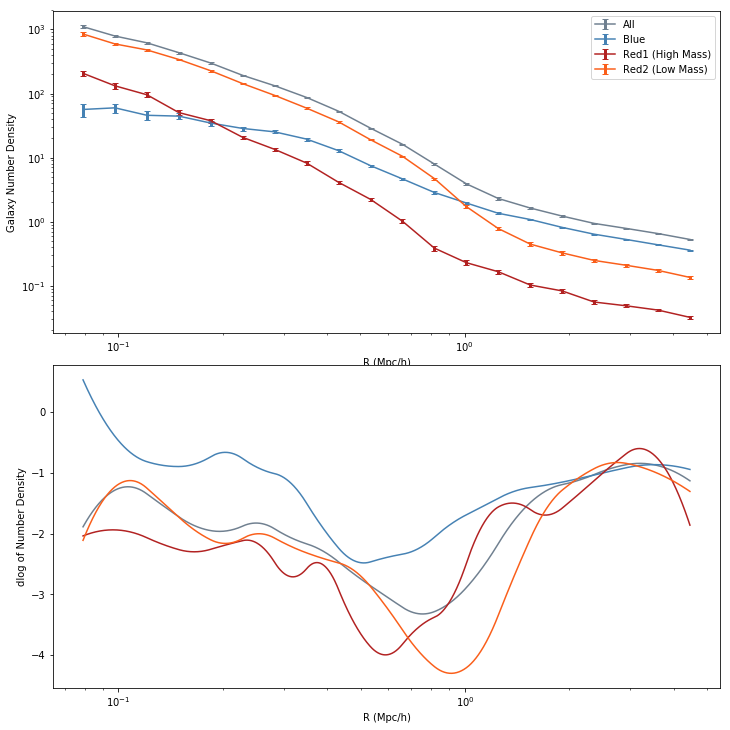

In [21]:
#USE THIS
#plot_colors = ['dimgray','steelblue','firebrick','#fa5f1b']
#label_list = ['All','Blue','Red1','Red2']
bin_stack2, Yi_avg_list2, cov_list2, boot_err_list2, R_avg2, title2 = MultiProfiles('color',4, subhalo_table_m, CM_coords,halo_array_masked,'basic','stellarmass')


In [21]:
#Running and saving for Sam:

print(np.shape(cov_list2))
r = bin_stack2## some array of length N corresponding to r values
rho = Yi_avg_list2## some array of length N corresponding density values
cov = cov_list2## N*N covariance matrix
profile = np.empty(3, dtype=object)
profile[0]=r
profile[1]=rho
profile[2]=cov
print(R_avg2)
np.save("GalNDensity_Profiles_9_5e13.npy", profile, allow_pickle=True)

(4, 20, 20)
0.7067824398397052



Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 501641.63221502304
R500c, R200c, R200m: 0.7612624597816122 1.24644093717065 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 501641.63358306885
163012 163012 time 501641.6397590637
N Subhalos within 7*R200m: 1214 501641.65689110756
galaxies 0 [  2.   5.  10.  10.  11.  14.  13.  15.  28.  30.  21.  16.  20.  11.
  32.  69. 141. 169. 218. 367.]
galaxies 1 [  0.   0.   1.   0.   0.   1.   1.   1.   0.   2.   0.   0.   6.   4.
  15.  25.  32.  54. 114. 147.]
galaxies 2 [  2.   5.   9.   9.  10.  13.   9.  13.  26.  25.  18.  13.   9.   2.
   6.  26.  86.  72.  46. 114.]
galaxies 3 [ 0.  0.  0.  1.  0.  0.  3.  1.  0.  2.  1.  3.  2.  4.  9. 17. 20. 34.
 51. 78.]

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 501641.65973496437
R500c, R200c, R200m: 0.5860514830407864 0.916949635434108 1.1697442162737657
Rscale 1.1697442162737657
before dev loop: 501641.6613957882
163012 163012 time

 25. 39.]
galaxies 2 [ 0.  0.  2.  4.  1.  5.  2.  5.  6.  2.  0.  0.  2. 10. 13.  5.  4. 13.
 14.  7.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  0.  1.  2.  1.  3.  4. 13. 10.
 17. 17.]

Halo: 17
Halo Mass: 24397.488
N Subhalos from Illustris Algorithm: 2019 501642.04292178154
R500c, R200c, R200m: 0.38384803809554985 0.6399654383672685 0.8183489452095857
Rscale 0.8183489452095857
before dev loop: 501642.0442929268
163012 163012 time 501642.05174708366
N Subhalos within 7*R200m: 274 501642.0651278496
galaxies 0 [ 1.  0.  1.  3.  1.  4.  2.  5.  5.  4.  7.  2.  2.  8. 11. 15. 41. 24.
 57. 78.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  4.  4.  7. 13. 15.
 29. 38.]
galaxies 2 [ 1.  0.  0.  1.  0.  2.  2.  3.  1.  2.  4.  1.  0.  3.  4.  3. 21.  4.
 11. 18.]
galaxies 3 [ 0.  0.  1.  1.  1.  1.  0.  1.  4.  1.  3.  0.  2.  1.  3.  4.  7.  3.
 14. 19.]

Halo: 18
Halo Mass: 22562.018
N Subhalos from Illustris Algorithm: 1709 501642.0675339699
R500c, R200c, R2

before dev loop: 501642.45775294304
163012 163012 time 501642.465392828
N Subhalos within 7*R200m: 244 501642.47886776924
galaxies 0 [ 0.  0.  3.  1.  4.  3.  5.  2.  4.  2. 14.  9.  4.  5. 11. 10. 15. 22.
 61. 65.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  4.  3.  2.  2.  7.  5.  6.  8.
 16. 38.]
galaxies 2 [ 0.  0.  3.  1.  3.  2.  5.  2.  3.  0.  7.  4.  1.  1.  0.  2.  4.  9.
 24. 12.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  2.  4.  2.  4.  4.
 21. 10.]

Halo: 37
Halo Mass: 16608.855
N Subhalos from Illustris Algorithm: 1257 501642.48108792305
R500c, R200c, R200m: 0.4566091322127358 0.7167290968668999 0.8825100786829236
Rscale 0.8825100786829236
before dev loop: 501642.4823589325
163012 163012 time 501642.48930191994
N Subhalos within 7*R200m: 209 501642.5023570061
galaxies 0 [ 2.  4.  1.  4.  3.  4.  7.  5.  5.  7.  1.  4.  4.  5.  2. 11.  7. 15.
 45. 70.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  3.  1.  1.  1.  1.  1.  4.  1.  5.  3.  7.
 18. 2

  8. 21.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1.  3.  4.  2.  3.  1.
  6. 13.]

Halo: 52
Halo Mass: 13769.684
N Subhalos from Illustris Algorithm: 917 501642.86783099174
R500c, R200c, R200m: 0.41704704730108577 0.6642341226359727 0.8275377325646801
Rscale 0.8275377325646801
before dev loop: 501642.8700928688
163012 163012 time 501642.8777329922
N Subhalos within 7*R200m: 223 501642.8913807869
galaxies 0 [ 1.  2.  2.  0.  2.  1.  3.  7.  7.  7.  3.  4.  4.  6.  6.  7.  9. 39.
 43. 67.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  1.  2.  0.  1.  2.  6.  3.  3.  3. 10.
 22. 39.]
galaxies 2 [ 1.  2.  2.  0.  2.  1.  3.  6.  4.  4.  3.  2.  2.  0.  1.  3.  4. 14.
 12. 15.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  0.  0.  2.  1.  0.  1.  0.  0.  2.  1.  2. 12.
  8.  9.]

Halo: 53
Halo Mass: 13625.6455
N Subhalos from Illustris Algorithm: 958 501642.89448189735
R500c, R200c, R200m: 0.4059635494644054 0.6272828444381676 0.7807677249189424
Rscale 0.7807677249189424
before 

N Subhalos within 7*R200m: 177 501643.2828409672
galaxies 0 [ 0.  2.  1.  1.  2.  3.  1.  1.  4.  4. 11.  6.  6.  2. 13.  3. 16. 19.
 27. 52.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  2.  2.  3.  0.  3.  2.  6. 12.
 13. 28.]
galaxies 2 [ 0.  1.  1.  1.  2.  1.  1.  0.  3.  3.  8.  3.  2.  1.  5.  0.  7.  2.
  6. 12.]
galaxies 3 [ 0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.  5.  1.  2.  4.
  7. 11.]

Halo: 74
Halo Mass: 11098.631
N Subhalos from Illustris Algorithm: 859 501643.2852449417
R500c, R200c, R200m: 0.38206606462911696 0.60605365578894 0.755542977916265
Rscale 0.755542977916265
before dev loop: 501643.2868180275
163012 163012 time 501643.2935857773
N Subhalos within 7*R200m: 136 501643.3071129322
galaxies 0 [ 1.  1.  1.  0.  2.  2.  1.  2.  3.  9.  2.  1.  3.  3.  4.  6.  7. 24.
 22. 41.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  4.  1.  0.  2.  1.  1.  4.  3. 11.
 15. 25.]
galaxies 2 [1. 1. 1. 0. 1. 1. 1. 2. 2. 5. 1. 1. 0. 0. 2. 0. 0. 6. 5. 6.]
ga

N Subhalos within 7*R200m: 128 501643.689180851
galaxies 0 [ 0.  0.  3.  1.  0.  3.  1.  5.  1.  4.  4.  1.  2.  4.  8.  2.  9. 14.
 31. 32.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  3.  4.  1.  6.  7.
 11. 15.]
galaxies 2 [0. 0. 2. 1. 0. 3. 1. 4. 0. 3. 3. 0. 0. 0. 3. 1. 2. 1. 9. 5.]
galaxies 3 [ 0.  0.  1.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.  5.
  9. 11.]

Halo: 111
Halo Mass: 9310.482
N Subhalos from Illustris Algorithm: 632 501643.6911818981
R500c, R200c, R200m: 0.41250193603321655 0.6107573835532709 0.7427579758604733
Rscale 0.7427579758604733
before dev loop: 501643.69248986244
163012 163012 time 501643.6988117695
N Subhalos within 7*R200m: 116 501643.71151304245
galaxies 0 [ 0.  1.  1.  1.  1.  4.  1.  2.  1.  2.  0.  2.  0.  0.  0.  7. 12. 26.
 17. 36.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  0.  0.  0.  3.  8. 11.
 10. 16.]
galaxies 2 [0. 1. 1. 1. 1. 3. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 2. 7. 2. 8.]
galaxies 3 [ 0.  0

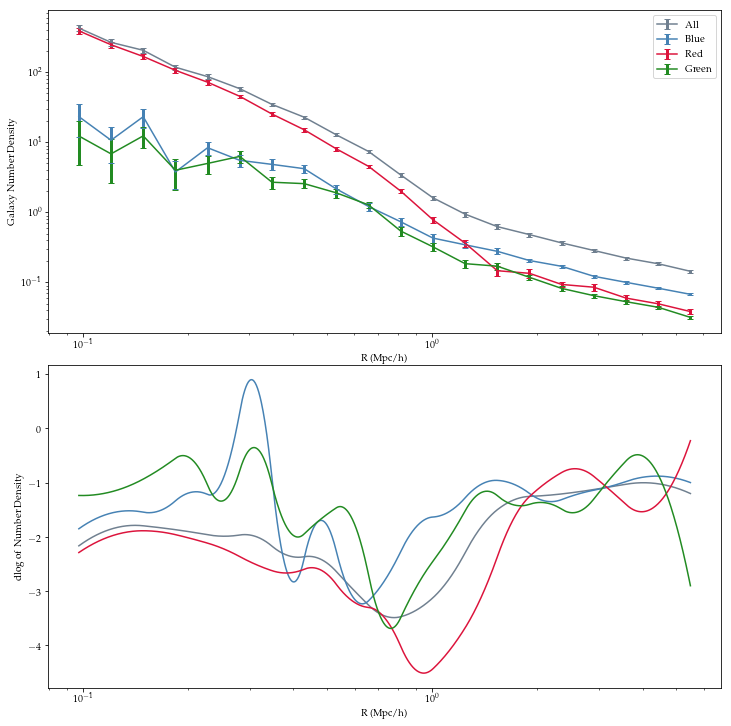

In [54]:
subhalo_table_ib = subhalo_table_clean[((subhalo_table_clean['SubhaloStellarPhotometrics'][:,6]))<-19.87]
CM_coords_ib = subhalo_table_ib['SubhaloPos']
bin_stack3, Yi_avg_list3, cov_list3, boot_err_list3, R_avg3, title3 = MultiProfiles('color_old',4, subhalo_table_ib, CM_coords_ib,halo_array_masked,'basic','stellarmass')


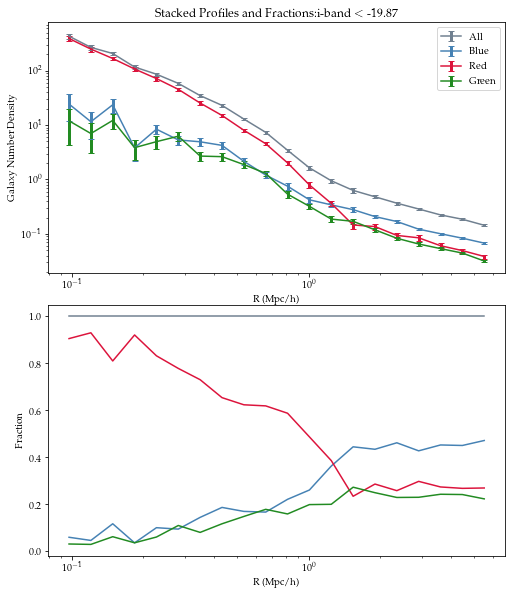

In [52]:
#Color fractions:
plot_color_list = ['slategray','steelblue','firebrick','#fa5f1b']
plot_color_list = ['slategray','steelblue','crimson','forestgreen']

label_list = ['All', 'Blue', 'Red1 (High Mass)', 'Red2 (Low Mass)']
label_list = ['All', 'Blue', 'Red','Green']

bins = 20
Y = Yi_avg_list3[0]
plt.figure(figsize=(7,8))
ax0 = plt.subplot(2,1,1)
ax1 = plt.subplot(2,1,2)
plt.tight_layout()
for i in range(0,4):
    Yi_avg = Yi_avg_list3[i]
    cov = cov_list3[i]
    boot_err = boot_err_list3[i]
    ax0.errorbar(bin_stack3, Yi_avg, yerr = boot_err, c = plot_color_list[i], ecolor = plot_color_list[i], elinewidth = 3, capsize=3, label = label_list[i])
    ax0.set_xscale('log')
    ax0.set_yscale('log')
    ax0.set_xlabel('R (Mpc/h)')
    ax0.set_ylabel('Galaxy Number Density')# (scaled by M200m)
    #ax0.set_title('300-1 Stacked Profiles (Stellar Mass > 10^'+str(M)+')', fontweight = 'bold', wrap=True)
    ax0.set_title('Stacked Profiles and Fractions:i-band $<$ -19.87')
    ax0.legend()
    #ax1.plot(dlog_data_SG_x1, dlog_data_SG_y1, c = plot_color_list[i])
    ax1.plot(bin_stack3, Yi_avg/Y, c = plot_color_list[i])
    ax1.set_xscale('log')
    ax1.set_xlabel('R (Mpc/h)')
    ax1.set_ylabel('Fraction')
    #ax1.set_ylabel('dlog of Number Density')
    
plt.show()


Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 3810.0468549728394
R500c, R200c, R200m: 0.7612624597816122 1.24644093717065 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 3810.0997879505157
232118 232118 time 3810.1409969329834
N Subhalos within 5*R200m: 1175 3810.741037130356
galaxies [4, 8, 14, 20, 16, 27, 32, 21, 25, 59, 52, 35, 29, 32, 19, 39, 70, 122, 290, 243]
blue galaxies counted [0, 0, 0, 2, 1, 3, 3, 5, 2, 3, 4, 5, 4, 12, 15, 26, 38, 65, 82, 147]
red galaxies counted [2, 1, 7, 3, 4, 6, 7, 4, 6, 14, 10, 6, 7, 5, 2, 4, 10, 15, 53, 29]
red galaxies counted [2, 7, 7, 14, 11, 17, 21, 12, 16, 37, 34, 18, 17, 9, 2, 3, 19, 37, 127, 54]
sum of galaxies: 1157

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 3810.9309470653534
R500c, R200c, R200m: 0.5860514830407864 0.916949635434108 1.1697442162737657
Rscale 1.1697442162737657
before dev loop: 3810.9500539302826
232118 232118 time 3810.9953758716583
N Subhalos within 5*R200m:

N Subhalos within 5*R200m: 250 3821.0664279460907
galaxies [4, 1, 2, 6, 7, 7, 7, 14, 19, 9, 13, 20, 7, 2, 5, 10, 5, 19, 50, 37]
blue galaxies counted [0, 0, 0, 0, 0, 1, 0, 2, 4, 2, 2, 5, 1, 2, 5, 9, 4, 11, 24, 33]
red galaxies counted [1, 0, 1, 2, 3, 1, 2, 3, 3, 1, 2, 2, 2, 0, 0, 1, 0, 1, 8, 3]
red galaxies counted [3, 1, 1, 4, 4, 5, 2, 6, 11, 6, 7, 11, 4, 0, 0, 0, 0, 6, 18, 0]
sum of galaxies: 244

Halo: 13
Halo Mass: 27343.611
N Subhalos from Illustris Algorithm: 1930 3821.075742006302
R500c, R200c, R200m: 0.493707176709387 0.7360678987552932 0.9043717716298794
Rscale 0.9043717716298794
before dev loop: 3821.0852830410004
232118 232118 time 3821.123626947403
N Subhalos within 5*R200m: 280 3821.31920003891
galaxies [1, 3, 2, 4, 5, 6, 14, 6, 12, 9, 11, 7, 9, 22, 19, 14, 21, 30, 28, 48]
blue galaxies counted [0, 1, 0, 0, 3, 1, 2, 3, 6, 3, 6, 2, 4, 4, 7, 10, 19, 24, 22, 42]
red galaxies counted [1, 1, 0, 3, 1, 1, 2, 1, 3, 1, 2, 0, 0, 7, 2, 2, 1, 4, 4, 4]
red galaxies counted [0, 1, 2, 1,

N Subhalos within 5*R200m: 281 3825.5050041675568
galaxies [2, 3, 3, 5, 6, 5, 7, 5, 7, 9, 6, 9, 12, 5, 7, 16, 24, 18, 30, 96]
blue galaxies counted [0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 2, 2, 3, 1, 4, 12, 9, 15, 15, 29]
red galaxies counted [0, 1, 1, 2, 1, 0, 1, 2, 2, 1, 2, 0, 3, 1, 1, 1, 3, 0, 6, 13]
red galaxies counted [2, 2, 2, 2, 3, 4, 5, 2, 3, 6, 2, 7, 6, 1, 1, 3, 10, 2, 7, 42]
sum of galaxies: 275

Halo: 26
Halo Mass: 18821.283
N Subhalos from Illustris Algorithm: 1328 3825.5229630470276
R500c, R200c, R200m: 0.47668837127984176 0.7524419893794323 0.9314922299754277
Rscale 0.9314922299754277
before dev loop: 3825.5277769565582
232118 232118 time 3825.5502269268036
N Subhalos within 5*R200m: 318 3825.7553391456604
galaxies [1, 3, 6, 5, 5, 3, 5, 10, 8, 11, 12, 11, 3, 5, 2, 13, 24, 7, 58, 118]
blue galaxies counted [0, 0, 0, 0, 1, 0, 0, 2, 0, 2, 3, 2, 1, 3, 2, 9, 17, 5, 19, 61]
red galaxies counted [0, 0, 1, 2, 0, 1, 0, 1, 2, 3, 1, 3, 0, 0, 0, 2, 2, 1, 9, 16]
red galaxies counted [1, 1, 5,

N Subhalos within 5*R200m: 189 3827.9258329868317
galaxies [2, 0, 2, 2, 6, 7, 4, 3, 7, 1, 5, 2, 1, 4, 9, 15, 9, 20, 40, 45]
blue galaxies counted [0, 0, 0, 0, 0, 0, 2, 0, 2, 1, 1, 1, 1, 2, 4, 13, 7, 14, 19, 36]
red galaxies counted [1, 0, 0, 1, 2, 1, 1, 0, 1, 0, 1, 1, 0, 1, 3, 2, 1, 3, 5, 3]
red galaxies counted [1, 0, 2, 1, 4, 6, 1, 2, 4, 0, 1, 0, 0, 0, 1, 0, 1, 2, 13, 3]
sum of galaxies: 184

Halo: 40
Halo Mass: 15832.792
N Subhalos from Illustris Algorithm: 1144 3827.9589200019836
R500c, R200c, R200m: 0.4847836976637453 0.7167998777769817 0.8706583597582565
Rscale 0.8706583597582565
before dev loop: 3827.9715809822083
232118 232118 time 3827.9983530044556
N Subhalos within 5*R200m: 169 3828.150932073593
galaxies [0, 2, 6, 3, 7, 4, 8, 8, 11, 5, 3, 6, 2, 1, 8, 10, 10, 21, 20, 31]
blue galaxies counted [0, 1, 2, 1, 2, 1, 1, 2, 4, 3, 1, 3, 1, 1, 6, 7, 8, 13, 19, 23]
red galaxies counted [0, 0, 1, 0, 1, 0, 2, 4, 1, 1, 0, 1, 1, 0, 0, 3, 1, 4, 0, 2]
red galaxies counted [0, 1, 3, 1, 4, 3, 

N Subhalos within 5*R200m: 137 3829.8943181037903
galaxies [0, 1, 2, 3, 2, 6, 5, 7, 13, 6, 9, 6, 4, 5, 3, 4, 15, 7, 15, 18]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 2, 2, 1, 1, 3, 3, 13, 6, 9, 13]
red galaxies counted [0, 1, 0, 1, 0, 3, 2, 0, 3, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 3]
red galaxies counted [0, 0, 2, 2, 2, 3, 3, 4, 7, 5, 5, 3, 2, 2, 0, 0, 1, 0, 4, 1]
sum of galaxies: 131

Halo: 55
Halo Mass: 13161.834
N Subhalos from Illustris Algorithm: 952 3829.8992640972137
R500c, R200c, R200m: 0.43555845718231756 0.675873859140457 0.8280938911635812
Rscale 0.8280938911635812
before dev loop: 3829.904664039612
232118 232118 time 3829.9387991428375
N Subhalos within 5*R200m: 281 3830.245465040207
galaxies [1, 4, 2, 6, 4, 8, 4, 6, 10, 11, 7, 6, 8, 9, 12, 17, 25, 14, 54, 65]
blue galaxies counted [0, 0, 0, 1, 0, 0, 0, 2, 6, 4, 3, 2, 4, 5, 8, 8, 16, 10, 38, 37]
red galaxies counted [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 0, 1, 5, 4, 3, 9, 10]
red galaxies counted [0, 4, 2, 4, 3, 7, 3

N Subhalos within 5*R200m: 139 3831.496546983719
galaxies [0, 2, 2, 5, 1, 3, 1, 2, 5, 5, 5, 6, 5, 5, 3, 3, 5, 13, 30, 35]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 3, 2, 2, 2, 2, 4, 10, 23, 28]
red galaxies counted [0, 0, 0, 1, 1, 1, 0, 2, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 3, 4]
red galaxies counted [0, 2, 2, 4, 0, 2, 1, 0, 5, 4, 1, 2, 2, 2, 0, 0, 0, 0, 3, 1]
sum of galaxies: 136

Halo: 68
Halo Mass: 12416.961
N Subhalos from Illustris Algorithm: 1120 3831.5135219097137
R500c, R200c, R200m: 0.3187205930686792 0.495798416312914 0.6181949038661593
Rscale 0.6181949038661593
before dev loop: 3831.521529197693
232118 232118 time 3831.546959877014
N Subhalos within 5*R200m: 157 3831.5959780216217
galaxies [0, 0, 3, 1, 1, 0, 5, 4, 2, 5, 4, 2, 8, 7, 11, 5, 5, 20, 23, 48]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 2, 1, 3, 4, 9, 5, 4, 10, 13, 30]
red galaxies counted [0, 0, 0, 0, 0, 0, 1, 2, 0, 1, 0, 0, 1, 2, 2, 0, 1, 5, 3, 5]
red galaxies counted [0, 0, 3, 1, 0, 0, 4, 2, 1,

232118 232118 time 3833.0585730075836
N Subhalos within 5*R200m: 179 3833.1324281692505
galaxies [1, 3, 2, 1, 0, 1, 2, 1, 2, 7, 11, 9, 9, 2, 16, 6, 14, 14, 31, 45]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 0, 2, 6, 5, 8, 2, 7, 4, 10, 11, 21, 28]
red galaxies counted [0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 3, 0, 1, 0, 2, 0, 0, 1, 5, 7]
red galaxies counted [1, 2, 2, 1, 0, 1, 1, 0, 1, 5, 1, 1, 0, 0, 6, 2, 2, 1, 3, 6]
sum of galaxies: 177

Halo: 82
Halo Mass: 10597.636
N Subhalos from Illustris Algorithm: 766 3833.1350860595703
R500c, R200c, R200m: 0.3803419009105111 0.5842685887819711 0.7219066723980457
Rscale 0.7219066723980457
before dev loop: 3833.1405789852142
232118 232118 time 3833.156275033951
N Subhalos within 5*R200m: 120 3833.181885957718
galaxies [0, 0, 2, 2, 1, 2, 3, 7, 6, 9, 6, 7, 3, 4, 12, 3, 2, 9, 20, 18]
blue galaxies counted [0, 0, 0, 0, 0, 0, 2, 1, 4, 1, 3, 2, 2, 3, 5, 3, 2, 7, 17, 15]
red galaxies counted [0, 0, 0, 0, 0, 1, 1, 3, 0, 1, 1, 1, 0, 0, 4, 0, 0, 1, 3, 2]
red gal

232118 232118 time 3834.1313660144806
N Subhalos within 5*R200m: 133 3834.2198100090027
galaxies [0, 1, 0, 4, 2, 2, 3, 2, 7, 4, 7, 2, 4, 3, 11, 11, 11, 14, 17, 26]
blue galaxies counted [0, 0, 0, 0, 1, 1, 0, 0, 4, 1, 5, 1, 2, 1, 6, 7, 6, 7, 13, 18]
red galaxies counted [0, 0, 0, 2, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 3, 2, 0, 3, 4, 3]
red galaxies counted [0, 1, 0, 0, 1, 0, 3, 1, 1, 2, 0, 0, 0, 1, 1, 2, 4, 3, 0, 2]
sum of galaxies: 131

Halo: 95
Halo Mass: 10305.533
N Subhalos from Illustris Algorithm: 818 3834.223696947098
R500c, R200c, R200m: 0.3879188612176387 0.6091632116983731 0.7620091823691952
Rscale 0.7620091823691952
before dev loop: 3834.2438621520996
232118 232118 time 3834.2678170204163
N Subhalos within 5*R200m: 119 3834.3421471118927
galaxies [2, 1, 2, 5, 4, 3, 5, 2, 4, 6, 8, 6, 2, 3, 1, 3, 4, 16, 16, 18]
blue galaxies counted [1, 0, 0, 0, 2, 0, 1, 0, 0, 0, 4, 2, 1, 2, 1, 3, 3, 10, 15, 18]
red galaxies counted [0, 1, 0, 0, 0, 2, 2, 1, 1, 2, 0, 0, 0, 0, 0, 0, 1, 3, 1, 0]
red gal

N Subhalos within 5*R200m: 98 3835.6599130630493
galaxies [0, 0, 2, 1, 0, 4, 3, 3, 0, 6, 2, 5, 6, 5, 3, 5, 1, 9, 30, 10]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 1, 0, 2, 2, 2, 1, 7, 27, 10]
red galaxies counted [0, 0, 0, 0, 0, 2, 0, 0, 0, 1, 0, 2, 0, 1, 0, 2, 0, 2, 2, 0]
red galaxies counted [0, 0, 2, 1, 0, 2, 2, 3, 0, 2, 2, 2, 3, 0, 1, 0, 0, 0, 0, 0]
sum of galaxies: 95

Halo: 108
Halo Mass: 9763.695
N Subhalos from Illustris Algorithm: 768 3835.667916059494
R500c, R200c, R200m: 0.267284029646739 0.4277241554215666 0.5814296257295761
Rscale 0.5814296257295761
before dev loop: 3835.6735150814056
232118 232118 time 3835.691213130951
N Subhalos within 5*R200m: 95 3835.731748819351
galaxies [0, 1, 1, 0, 0, 3, 1, 2, 2, 3, 2, 16, 2, 2, 5, 11, 11, 11, 5, 14]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 1, 1, 1, 6, 5, 9, 5, 9]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 2, 0, 0, 0, 2, 3, 2, 0, 2]
red galaxies counted [0, 1, 0, 0, 0, 3, 1, 2, 2, 1, 0, 1

before dev loop: 3836.550577878952
232118 232118 time 3836.5772359371185
N Subhalos within 5*R200m: 133 3836.6605660915375
galaxies [1, 4, 0, 2, 1, 4, 8, 3, 4, 8, 1, 5, 4, 1, 0, 4, 12, 11, 20, 37]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 4, 9, 9, 14, 26]
red galaxies counted [0, 1, 0, 0, 0, 0, 1, 2, 1, 2, 0, 0, 0, 0, 0, 0, 2, 1, 2, 5]
red galaxies counted [1, 3, 0, 2, 1, 4, 5, 0, 3, 4, 1, 5, 4, 1, 0, 0, 0, 0, 3, 3]
sum of galaxies: 130

Halo: 121
Halo Mass: 9259.929
N Subhalos from Illustris Algorithm: 824 3836.6646139621735
R500c, R200c, R200m: 0.3034331375417668 0.4711724645998827 0.601254726099171
Rscale 0.601254726099171
before dev loop: 3836.6712992191315
232118 232118 time 3836.6886038780212
N Subhalos within 5*R200m: 71 3836.7244169712067
galaxies [1, 0, 1, 0, 1, 1, 1, 4, 3, 1, 0, 5, 10, 7, 1, 1, 6, 9, 11, 6]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 2, 2, 0, 0, 3, 6, 10, 6]
red galaxies counted [1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 

N Subhalos within 5*R200m: 105 3837.6534929275513
galaxies [2, 0, 1, 3, 1, 1, 4, 4, 5, 7, 3, 1, 6, 4, 4, 6, 9, 11, 15, 16]
blue galaxies counted [0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2, 2, 6, 7, 9, 13, 9]
red galaxies counted [0, 0, 0, 0, 0, 1, 0, 1, 2, 1, 0, 0, 1, 1, 0, 0, 0, 2, 2, 1]
red galaxies counted [2, 0, 0, 2, 1, 0, 4, 3, 3, 5, 3, 1, 3, 1, 2, 0, 0, 0, 0, 4]
sum of galaxies: 103

Halo: 134
Halo Mass: 9039.415
N Subhalos from Illustris Algorithm: 875 3837.6584329605103
R500c, R200c, R200m: 0.20959902917027928 0.35189406029421955 0.4597316592844237
Rscale 0.4597316592844237
before dev loop: 3837.6779079437256
232118 232118 time 3837.713219165802
N Subhalos within 5*R200m: 77 3837.7407310009003
galaxies [0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 1, 0, 3, 5, 10, 2, 6, 7, 22, 16]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 0, 0, 2, 0, 3, 2, 6, 7, 15, 10]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 2, 1, 0, 0, 0, 2, 2]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 

232118 232118 time 3838.755033969879
N Subhalos within 5*R200m: 109 3838.8017239570618
galaxies [0, 1, 0, 1, 3, 1, 0, 0, 1, 4, 4, 7, 2, 13, 6, 9, 5, 5, 15, 30]
blue galaxies counted [0, 1, 0, 0, 2, 1, 0, 0, 1, 1, 1, 2, 2, 5, 6, 6, 5, 5, 8, 19]
red galaxies counted [0, 0, 0, 0, 1, 0, 0, 0, 0, 3, 1, 1, 0, 2, 0, 0, 0, 0, 1, 4]
red galaxies counted [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 2, 1, 0, 5, 0, 2, 0, 0, 3, 6]
sum of galaxies: 107

Halo: 148
Halo Mass: 8410.298
N Subhalos from Illustris Algorithm: 755 3838.804344177246
R500c, R200c, R200m: 0.3365799218054465 0.5395676416536827 0.6763263285102222
Rscale 0.6763263285102222
before dev loop: 3838.81165099144
232118 232118 time 3838.8297560214996
N Subhalos within 5*R200m: 97 3838.8511049747467
galaxies [0, 2, 0, 0, 3, 1, 1, 5, 2, 5, 8, 1, 2, 5, 5, 2, 9, 6, 17, 17]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 1, 0, 3, 3, 0, 1, 1, 4, 1, 7, 6, 16, 10]
red galaxies counted [0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 2, 0, 1, 0, 1, 0, 2, 0, 0, 4]
red galaxies coun

232118 232118 time 3839.6772639751434
N Subhalos within 5*R200m: 76 3839.7013549804688
galaxies [0, 1, 0, 1, 1, 2, 3, 6, 7, 8, 1, 1, 5, 8, 6, 2, 3, 4, 5, 10]
blue galaxies counted [0, 0, 0, 0, 0, 1, 2, 3, 4, 5, 0, 1, 2, 6, 5, 1, 3, 4, 3, 6]
red galaxies counted [0, 0, 0, 0, 1, 0, 0, 1, 2, 0, 0, 0, 1, 0, 0, 1, 0, 0, 2, 0]
red galaxies counted [0, 0, 0, 1, 0, 1, 1, 1, 1, 3, 1, 0, 1, 2, 0, 0, 0, 0, 0, 3]
sum of galaxies: 74

Halo: 162
Halo Mass: 7918.1523
N Subhalos from Illustris Algorithm: 662 3839.7039539813995
R500c, R200c, R200m: 0.2918016080998203 0.5420416106126296 0.6729753648588245
Rscale 0.6729753648588245
before dev loop: 3839.7162659168243
232118 232118 time 3839.7497129440308
N Subhalos within 5*R200m: 110 3839.7698922157288
galaxies [0, 3, 3, 1, 0, 1, 2, 3, 8, 7, 5, 5, 3, 6, 9, 9, 3, 7, 16, 18]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 4, 1, 2, 3, 0, 4, 4, 6, 3, 4, 13, 16]
red galaxies counted [0, 1, 0, 0, 0, 1, 0, 0, 3, 3, 0, 0, 0, 1, 2, 0, 0, 1, 2, 1]
red galaxies cou

232118 232118 time 3840.78711104393
N Subhalos within 5*R200m: 75 3840.816777944565
galaxies [1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 5, 4, 9, 7, 2, 4, 8, 11, 8, 11]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 4, 2, 3, 4, 2, 4, 7, 7, 8, 9]
red galaxies counted [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 2, 0, 0, 0, 0, 2, 0, 1]
red galaxies counted [0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 4, 3, 0, 0, 0, 1, 0, 0]
sum of galaxies: 74

Halo: 178
Halo Mass: 7203.893
N Subhalos from Illustris Algorithm: 573 3840.8378438949585
R500c, R200c, R200m: 0.3506559548501068 0.5494880185737295 0.6718899508123657
Rscale 0.6718899508123657
before dev loop: 3840.84490609169
232118 232118 time 3840.8723981380463
N Subhalos within 5*R200m: 94 3840.9004230499268
galaxies [1, 1, 0, 5, 1, 2, 4, 2, 8, 4, 2, 3, 4, 2, 3, 2, 12, 10, 8, 18]
blue galaxies counted [0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 1, 2, 4, 2, 2, 2, 9, 7, 4, 17]
red galaxies counted [0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 2, 3, 2, 0]
red galaxies counted [

before dev loop: 3841.799324989319
232118 232118 time 3841.8287110328674
N Subhalos within 5*R200m: 82 3841.8753609657288
galaxies [2, 1, 0, 0, 0, 1, 2, 1, 3, 3, 3, 1, 4, 8, 3, 4, 4, 14, 7, 18]
blue galaxies counted [0, 1, 0, 0, 0, 0, 1, 0, 0, 2, 3, 1, 2, 1, 3, 2, 4, 14, 5, 12]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 4]
red galaxies counted [2, 0, 0, 0, 0, 1, 1, 1, 2, 1, 0, 0, 2, 4, 0, 2, 0, 0, 0, 0]
sum of galaxies: 79

Halo: 191
Halo Mass: 7042.9897
N Subhalos from Illustris Algorithm: 570 3841.8847618103027
R500c, R200c, R200m: 0.33705493057135216 0.5325804688846353 0.6522088943989216
Rscale 0.6522088943989216
before dev loop: 3841.8927750587463
232118 232118 time 3841.914144039154
N Subhalos within 5*R200m: 79 3841.9431920051575
galaxies [0, 4, 1, 0, 1, 3, 3, 1, 11, 5, 4, 3, 3, 0, 4, 6, 5, 7, 2, 13]
blue galaxies counted [0, 1, 1, 0, 1, 0, 0, 0, 5, 4, 3, 2, 2, 0, 4, 5, 3, 7, 1, 5]
red galaxies counted [0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0,

232118 232118 time 3843.457747936249
N Subhalos within 5*R200m: 81 3843.4815769195557
galaxies [0, 0, 0, 1, 0, 4, 3, 6, 3, 3, 6, 3, 2, 3, 0, 4, 4, 3, 17, 15]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 2, 0, 1, 1, 1, 2, 2, 0, 4, 4, 3, 9, 13]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 2, 0, 0, 1, 0, 0, 0, 0, 3, 1]
red galaxies counted [0, 0, 0, 1, 0, 4, 2, 4, 2, 1, 3, 2, 0, 0, 0, 0, 0, 0, 3, 1]
sum of galaxies: 77

Halo: 204
Halo Mass: 6706.4194
N Subhalos from Illustris Algorithm: 525 3843.4857931137085
R500c, R200c, R200m: 0.321439853111377 0.4772940124606779 0.5869305595247102
Rscale 0.5869305595247102
before dev loop: 3843.494698047638
232118 232118 time 3843.51446890831
N Subhalos within 5*R200m: 50 3843.570844888687
galaxies [0, 1, 2, 0, 0, 1, 5, 3, 1, 0, 0, 3, 3, 8, 5, 2, 4, 1, 3, 7]
blue galaxies counted [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 2, 2, 3, 3, 2, 2, 1, 3, 5]
red galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1]
red galaxies counted [0, 

N Subhalos within 5*R200m: 131 3844.597242832184
galaxies [1, 2, 1, 1, 1, 1, 2, 3, 6, 2, 2, 1, 3, 1, 4, 12, 5, 5, 16, 60]
blue galaxies counted [0, 0, 1, 0, 1, 1, 1, 1, 2, 2, 2, 1, 0, 1, 2, 12, 5, 4, 11, 24]
red galaxies counted [1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 2, 9]
red galaxies counted [0, 2, 0, 1, 0, 0, 1, 1, 2, 0, 0, 0, 0, 0, 1, 0, 0, 1, 3, 22]
sum of galaxies: 129

Halo: 217
Halo Mass: 6301.3247
N Subhalos from Illustris Algorithm: 430 3844.6000320911407
R500c, R200c, R200m: 0.34407853469117694 0.5281512973880313 0.6543059790323534
Rscale 0.6543059790323534
before dev loop: 3844.6054751873016
232118 232118 time 3844.652734041214
N Subhalos within 5*R200m: 57 3844.6792919635773
galaxies [0, 0, 2, 1, 4, 2, 1, 3, 1, 3, 2, 3, 0, 1, 1, 1, 5, 3, 9, 13]
blue galaxies counted [0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 5, 3, 8, 8]
red galaxies counted [0, 0, 0, 0, 3, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1]
red galaxies counted [0, 0, 1, 1, 0, 0, 1, 1, 1, 1,

N Subhalos within 5*R200m: 74 3845.711606025696
galaxies [1, 0, 1, 2, 0, 2, 2, 1, 2, 1, 4, 6, 4, 1, 0, 2, 7, 1, 6, 27]
blue galaxies counted [0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 2, 3, 2, 1, 0, 1, 5, 1, 6, 20]
red galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 3]
red galaxies counted [1, 0, 1, 1, 0, 2, 1, 1, 1, 1, 1, 2, 2, 0, 0, 0, 0, 0, 0, 4]
sum of galaxies: 70

Halo: 232
Halo Mass: 6047.211
N Subhalos from Illustris Algorithm: 410 3845.7306950092316
R500c, R200c, R200m: 0.32095057206354594 0.48856094815369033 0.6087796416194736
Rscale 0.6087796416194736
before dev loop: 3845.73610496521
232118 232118 time 3845.8054749965668
N Subhalos within 5*R200m: 91 3845.8278369903564
galaxies [1, 0, 4, 0, 2, 3, 3, 2, 4, 2, 3, 5, 2, 8, 5, 4, 2, 6, 11, 21]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 2, 1, 2, 2, 2, 3, 2, 3, 9, 12]
red galaxies counted [1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 3]
red galaxies counted [0, 0, 3, 0, 1, 2, 1, 2, 3, 2, 1, 3,

before dev loop: 3846.6847670078278
232118 232118 time 3846.7391419410706
N Subhalos within 5*R200m: 72 3846.7902569770813
galaxies [0, 0, 0, 1, 0, 0, 0, 4, 2, 2, 2, 2, 4, 5, 2, 2, 3, 12, 9, 17]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 1, 2, 3, 2, 2, 2, 9, 8, 15]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 2, 0, 0, 1, 2, 0, 2]
red galaxies counted [0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0]
sum of galaxies: 67

Halo: 245
Halo Mass: 5983.657
N Subhalos from Illustris Algorithm: 609 3846.7959790229797
R500c, R200c, R200m: 0.2623690400823504 0.408838463454161 0.5164104338593012
Rscale 0.5164104338593012
before dev loop: 3846.8044109344482
232118 232118 time 3846.82922911644
N Subhalos within 5*R200m: 57 3846.86003613472
galaxies [1, 0, 2, 1, 0, 0, 1, 2, 1, 3, 3, 3, 3, 1, 0, 1, 14, 7, 9, 4]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 2, 1, 0, 0, 7, 4, 8, 4]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 

232118 232118 time 3847.763859987259
N Subhalos within 5*R200m: 34 3847.801113128662
galaxies [0, 1, 2, 1, 0, 1, 2, 2, 3, 4, 0, 4, 1, 0, 1, 2, 0, 1, 4, 2]
blue galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 2, 0, 1, 3, 2]
red galaxies counted [0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
red galaxies counted [0, 0, 2, 1, 0, 1, 0, 2, 1, 2, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0]
sum of galaxies: 31

Halo: 260
Halo Mass: 5686.5054
N Subhalos from Illustris Algorithm: 460 3847.8029339313507
R500c, R200c, R200m: 0.26082509144673854 0.4081524330949062 0.5256688010909355
Rscale 0.5256688010909355
before dev loop: 3847.8107562065125
232118 232118 time 3847.834051132202
N Subhalos within 5*R200m: 44 3847.8691580295563
galaxies [0, 0, 1, 0, 2, 2, 2, 1, 0, 1, 4, 4, 4, 2, 4, 0, 3, 4, 2, 5]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 4, 2, 5]
red galaxies counted [0, 0, 0, 0, 2, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0]
red galaxies counted [0,

232118 232118 time 3848.6607089042664
N Subhalos within 5*R200m: 100 3848.686325073242
galaxies [2, 0, 0, 3, 2, 2, 7, 3, 3, 3, 0, 3, 1, 4, 7, 12, 11, 11, 11, 11]
blue galaxies counted [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 2, 5, 8, 3, 9, 10, 8]
red galaxies counted [0, 0, 0, 0, 0, 0, 2, 1, 0, 0, 0, 0, 1, 0, 0, 2, 0, 1, 0, 0]
red galaxies counted [1, 0, 0, 3, 2, 1, 5, 2, 3, 3, 0, 2, 0, 1, 1, 1, 5, 0, 1, 1]
sum of galaxies: 96

Halo: 273
Halo Mass: 5389.974
N Subhalos from Illustris Algorithm: 438 3848.693038225174
R500c, R200c, R200m: 0.29426496792914525 0.47707726594077793 0.6095587520782423
Rscale 0.6095587520782423
before dev loop: 3848.6980061531067
232118 232118 time 3848.727907180786
N Subhalos within 5*R200m: 85 3848.7526290416718
galaxies [0, 2, 1, 1, 0, 2, 3, 2, 2, 8, 6, 5, 2, 0, 4, 5, 10, 8, 6, 14]
blue galaxies counted [0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 3, 4, 2, 0, 3, 4, 8, 6, 6, 10]
red galaxies counted [0, 0, 0, 0, 0, 0, 1, 0, 0, 2, 1, 0, 0, 0, 0, 1, 2, 2, 0, 2]
red galaxies c

N Subhalos within 5*R200m: 112 3849.5523660182953
galaxies [0, 0, 0, 2, 2, 1, 1, 1, 3, 3, 3, 2, 3, 0, 4, 9, 8, 7, 34, 28]
blue galaxies counted [0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 2, 2, 2, 0, 4, 4, 5, 5, 18, 14]
red galaxies counted [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 2, 7, 5]
red galaxies counted [0, 0, 0, 1, 1, 0, 0, 1, 2, 2, 0, 0, 0, 0, 0, 2, 0, 0, 8, 6]
sum of galaxies: 111

Halo: 286
Halo Mass: 5479.643
N Subhalos from Illustris Algorithm: 466 3849.5557219982147
R500c, R200c, R200m: 0.34696918222033424 0.512538381788432 0.6223428333416517
Rscale 0.6223428333416517
before dev loop: 3849.563066959381
232118 232118 time 3849.5948429107666
N Subhalos within 5*R200m: 103 3849.643388032913
galaxies [0, 0, 1, 1, 3, 1, 6, 5, 3, 2, 0, 2, 2, 4, 6, 6, 7, 17, 16, 20]
blue galaxies counted [0, 0, 0, 0, 0, 0, 5, 3, 2, 1, 0, 1, 2, 3, 6, 5, 7, 8, 12, 16]
red galaxies counted [0, 0, 1, 0, 2, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 3]
red galaxies counted [0, 0, 0, 1, 1, 0, 0, 1, 1, 1,

232118 232118 time 3850.613033056259
N Subhalos within 5*R200m: 67 3850.6569731235504
galaxies [1, 0, 0, 0, 4, 4, 2, 3, 5, 2, 2, 1, 1, 2, 1, 4, 2, 3, 13, 13]
blue galaxies counted [0, 0, 0, 0, 4, 1, 1, 1, 2, 2, 2, 0, 1, 1, 1, 4, 2, 3, 7, 12]
red galaxies counted [1, 0, 0, 0, 0, 0, 1, 1, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1]
red galaxies counted [0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 3, 0]
sum of galaxies: 63

Halo: 302
Halo Mass: 5081.5635
N Subhalos from Illustris Algorithm: 305 3850.6593248844147
R500c, R200c, R200m: 0.31142261283615874 0.48302834710749587 0.6019721835027778
Rscale 0.6019721835027778
before dev loop: 3850.6646540164948
232118 232118 time 3850.698476076126
N Subhalos within 5*R200m: 46 3850.720559120178
galaxies [2, 0, 0, 1, 1, 2, 1, 1, 3, 0, 2, 4, 0, 1, 0, 2, 3, 4, 5, 12]
blue galaxies counted [0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 1, 2, 0, 1, 0, 1, 3, 4, 4, 7]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 1, 0, 0, 0, 1]
red galaxies counte

before dev loop: 3851.4576439857483
232118 232118 time 3851.477903842926
N Subhalos within 5*R200m: 134 3851.5136981010437
galaxies [1, 0, 0, 0, 1, 0, 0, 3, 1, 3, 0, 7, 3, 9, 4, 14, 12, 15, 22, 35]
blue galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 5, 1, 7, 2, 4, 3, 0, 11, 21]
red galaxies counted [1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 2, 2, 7, 3, 6]
red galaxies counted [0, 0, 0, 0, 1, 0, 0, 2, 0, 2, 0, 2, 2, 1, 1, 6, 6, 7, 6, 6]
sum of galaxies: 130

Halo: 331
Halo Mass: 5080.8345
N Subhalos from Illustris Algorithm: 549 3851.5311970710754
R500c, R200c, R200m: 0.23717990372419664 0.39582738685129226 0.49783637006162257
Rscale 0.49783637006162257
before dev loop: 3851.537075996399
232118 232118 time 3851.557721853256
N Subhalos within 5*R200m: 42 3851.6013901233673
galaxies [0, 0, 0, 0, 0, 0, 3, 3, 1, 4, 3, 2, 2, 0, 2, 5, 6, 2, 5, 1]
blue galaxies counted [0, 0, 0, 0, 0, 0, 2, 2, 1, 3, 3, 2, 1, 0, 0, 4, 5, 2, 4, 0]
red galaxies counted [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 

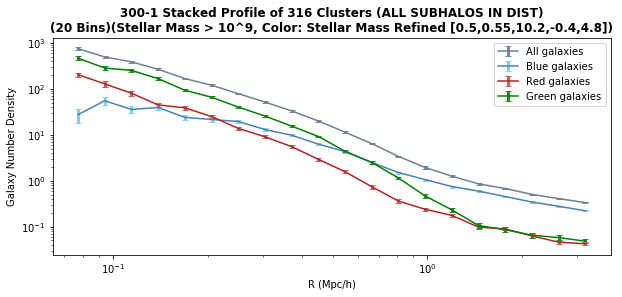

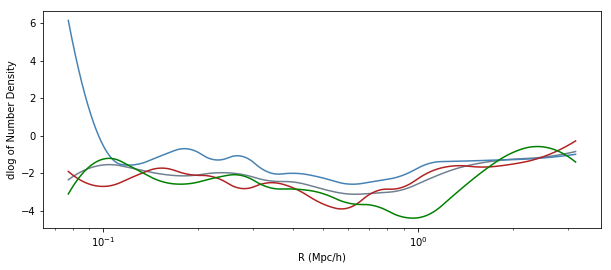

In [185]:
# REFINED COLOR_CUTS PROFILES
#IGNORE
bin_stackR, Yi_avgR, covR, boot_errR, Yi_avg_blueR, cov_blueR, boot_err_blueR, Yi_avg_redR, cov_redR, boot_err_redR, Yi_avg_greenR, cov_greenR, boot_err_greenR, red1_ratioR, red2_ratioR, number_red1R, number_red2R, red1_submass, red2_submass, R_avgR, color_titleR  = ColorProfiles(halo_array_masked,'refined','stellarmass')


In [22]:
#NOT USED
'''
# REPLOTTING COLOR SPLIT PROFILES

# REPLOTTING AND ADJUSTING (NEW ALL SUBS/TABLE)

w = 9#9
p = 5#5

# BOOTSTRAP PROFILES, ERRORBARS
Yi_avg1, cov1, boot_err1 = Bootstrap_Covariance(NDensity_list, 300, bins)
Yi_avg_blue1, cov_blue1, boot_err_blue1 = Bootstrap_Covariance(NDensity_list_b, 300, bins)
Yi_avg_red1, cov_red1, boot_err_red1 = Bootstrap_Covariance(NDensity_list_r, 300, bins)
Yi_avg_green1, cov_green1, boot_err_green1 = Bootstrap_Covariance(NDensity_list_g, 300, bins)

dlog_data_SG_x, dlog_data_SG_y, yy_fine, xx_fine = get_slope_sg(bin_stack1, (Yi_avg1), 1000,w,p)  
dlog_data_SG_x_b, dlog_data_SG_y_b, yy_fine_b, xx_fine_b = get_slope_sg(bin_stack1, (Yi_avg_blue1), 1000,w,p)  
dlog_data_SG_x_r, dlog_data_SG_y_r, yy_fine_r, xx_fine_r = get_slope_sg(bin_stack1, (Yi_avg_red1), 1000,w,p)  
dlog_data_SG_x_g, dlog_data_SG_y_g, yy_fine_g, xx_fine_g = get_slope_sg(bin_stack1, (Yi_avg_green1), 1000,w,p)  

print("Time:",time.time()-t0)         
# PLOTTING BOOTSTRAPPED STACKED PROFILES
plt.figure(figsize=(10,4))
plt.errorbar(bin_stack1, Yi_avg1, yerr = boot_err1, c = 'slategrey', ecolor = 'lightslategrey', elinewidth = 3, capsize=3, label = 'All galaxies')
plt.errorbar(bin_stack1, Yi_avg_blue1, yerr = boot_err_blue1, c = 'steelblue',ecolor = 'skyblue', elinewidth = 3, capsize=3, label = 'Blue galaxies')
plt.errorbar(bin_stack1, Yi_avg_red1, yerr = boot_err_red1, c='firebrick', ecolor = 'indianred', elinewidth = 3, capsize=3, label = 'Red galaxies')
plt.errorbar(bin_stack1, Yi_avg_green1, yerr = boot_err_green1, c='green', ecolor = 'forestgreen', elinewidth = 3, capsize=3, label = 'Green galaxies')
#plt.plot(xx_fine, yy_fine, c = 'orange')
#plt.plot(xx_fine_b, yy_fine_b, c = 'orange')
#plt.plot(xx_fine_r, yy_fine_r, c = 'orange')
#plt.plot(xx_fine_g, yy_fine_g, c = 'orange')

#plt.plot(xx_fine_g, yy_fine_g, c = 'orange')

plt.xscale('log')
plt.yscale('log')
plt.xlabel('R (Mpc/h)')
plt.ylabel('Galaxy Number Density')# (scaled by M200m)
plt.title('300-1 Stacked Profile of %s Clusters (ALL SUBHALOS IN %s*R200m)\n (%s Bins)(Cluster > 5*10^13)(Stellar Mass > 10^%s, Color: %s)' %(Number_of_halos, Halo_Rmax, bins, M,color_title), fontweight = 'bold', wrap=True)
plt.legend()

# SG LOG DERIVATIVE AND PLOT
plt.figure(figsize = (10,4))
plt.plot(dlog_data_SG_x, dlog_data_SG_y, c = 'slategrey')
plt.plot(dlog_data_SG_x_b, dlog_data_SG_y_b, c = 'steelblue')
plt.plot(dlog_data_SG_x_r, dlog_data_SG_y_r, c = 'firebrick')
plt.plot(dlog_data_SG_x_g, dlog_data_SG_y_g, c = 'green')
plt.xscale('log')
plt.xlabel('R (Mpc/h)')
plt.ylabel('dlog of Number Density')
plt.text(2.8,-4.5,'SG: %s,%s'%(w,p))
plt.ylim(-5,0)

plt.show()
'''

'\n# REPLOTTING COLOR SPLIT PROFILES\n\n# REPLOTTING AND ADJUSTING (NEW ALL SUBS/TABLE)\n\nw = 9#9\np = 5#5\n\n# BOOTSTRAP PROFILES, ERRORBARS\nYi_avg1, cov1, boot_err1 = Bootstrap_Covariance(NDensity_list, 300, bins)\nYi_avg_blue1, cov_blue1, boot_err_blue1 = Bootstrap_Covariance(NDensity_list_b, 300, bins)\nYi_avg_red1, cov_red1, boot_err_red1 = Bootstrap_Covariance(NDensity_list_r, 300, bins)\nYi_avg_green1, cov_green1, boot_err_green1 = Bootstrap_Covariance(NDensity_list_g, 300, bins)\n\ndlog_data_SG_x, dlog_data_SG_y, yy_fine, xx_fine = get_slope_sg(bin_stack1, (Yi_avg1), 1000,w,p)  \ndlog_data_SG_x_b, dlog_data_SG_y_b, yy_fine_b, xx_fine_b = get_slope_sg(bin_stack1, (Yi_avg_blue1), 1000,w,p)  \ndlog_data_SG_x_r, dlog_data_SG_y_r, yy_fine_r, xx_fine_r = get_slope_sg(bin_stack1, (Yi_avg_red1), 1000,w,p)  \ndlog_data_SG_x_g, dlog_data_SG_y_g, yy_fine_g, xx_fine_g = get_slope_sg(bin_stack1, (Yi_avg_green1), 1000,w,p)  \n\nprint("Time:",time.time()-t0)         \n# PLOTTING BOOTSTRAPPE

/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: overflow encountered in power


Running burn-in...


  0%|          | 9/5000 [00:00<01:02, 80.42it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 10/5000 [00:00<00:52, 95.04it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 9/5000 [00:00<00:58, 85.14it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 9/5000 [00:00<00:58, 85.93it/s]

Running production...


100%|██████████| 5000/5000 [00:55<00:00, 89.78it/s]


done MCMC
1111.9093270301819


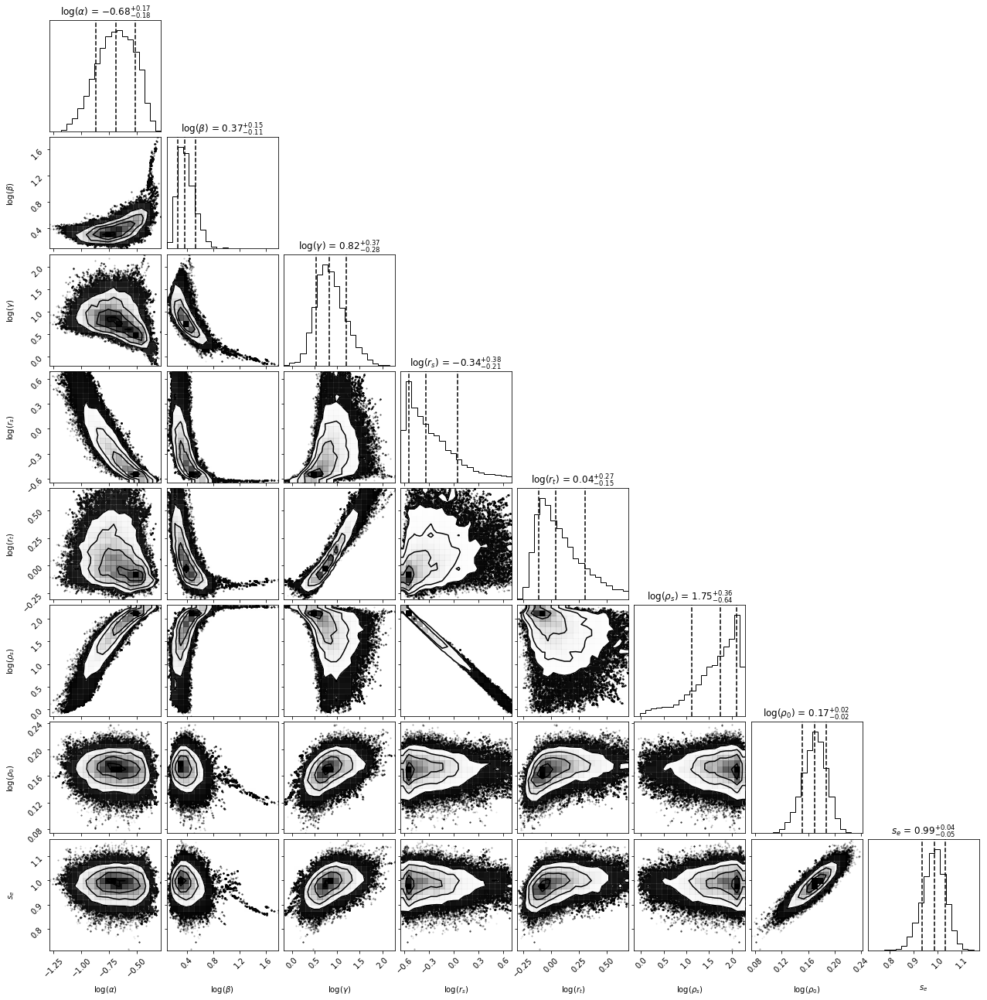

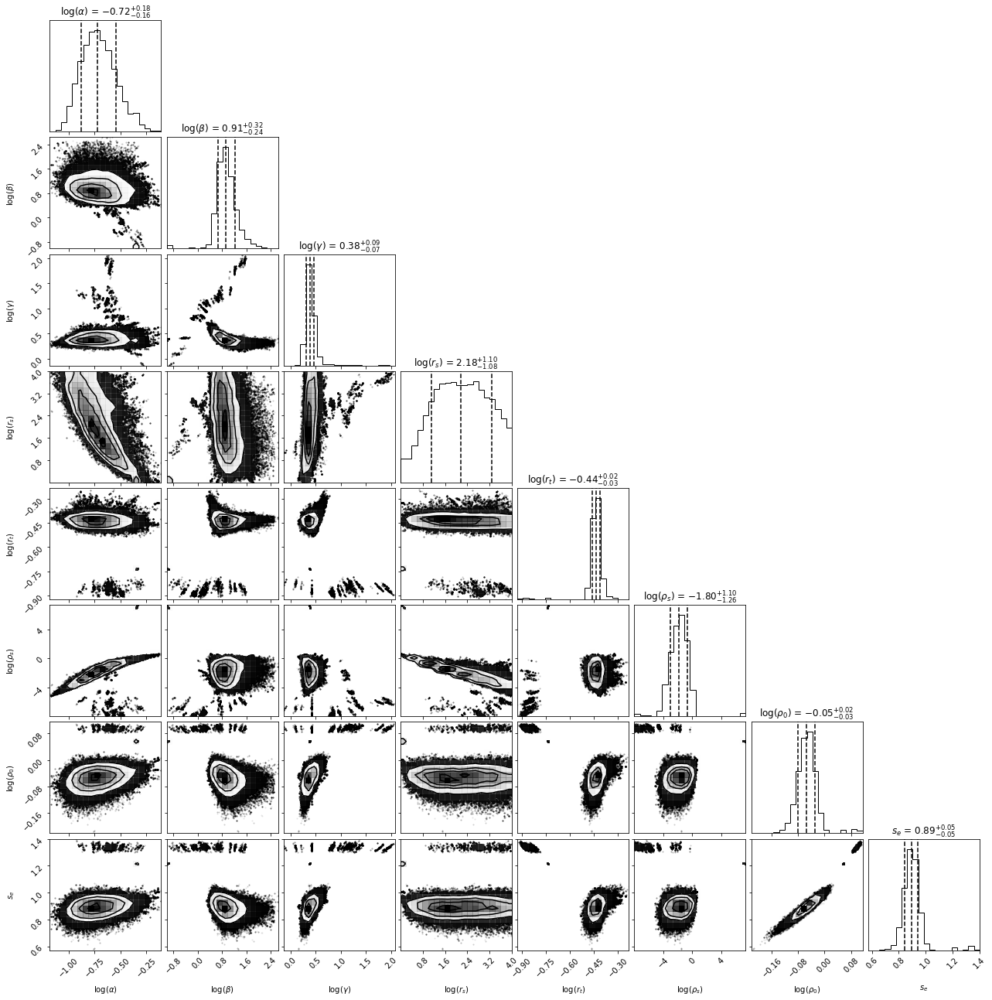

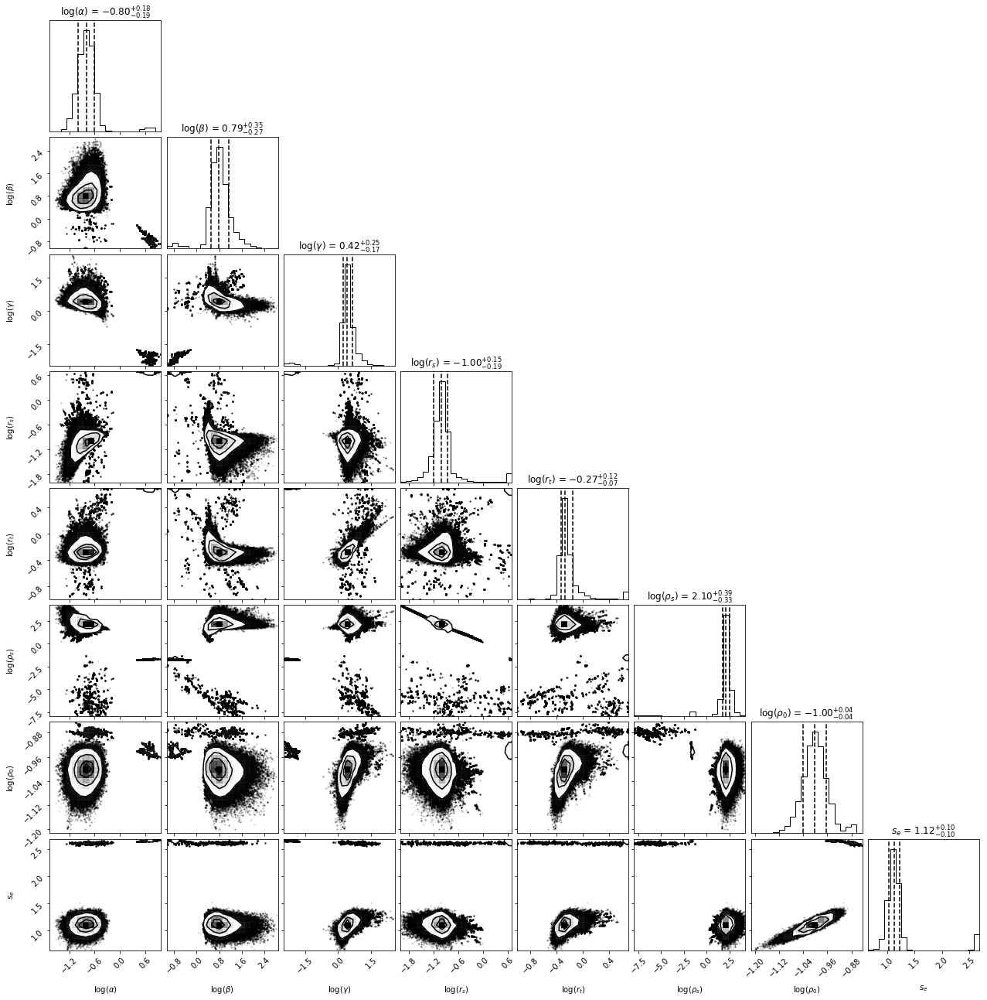

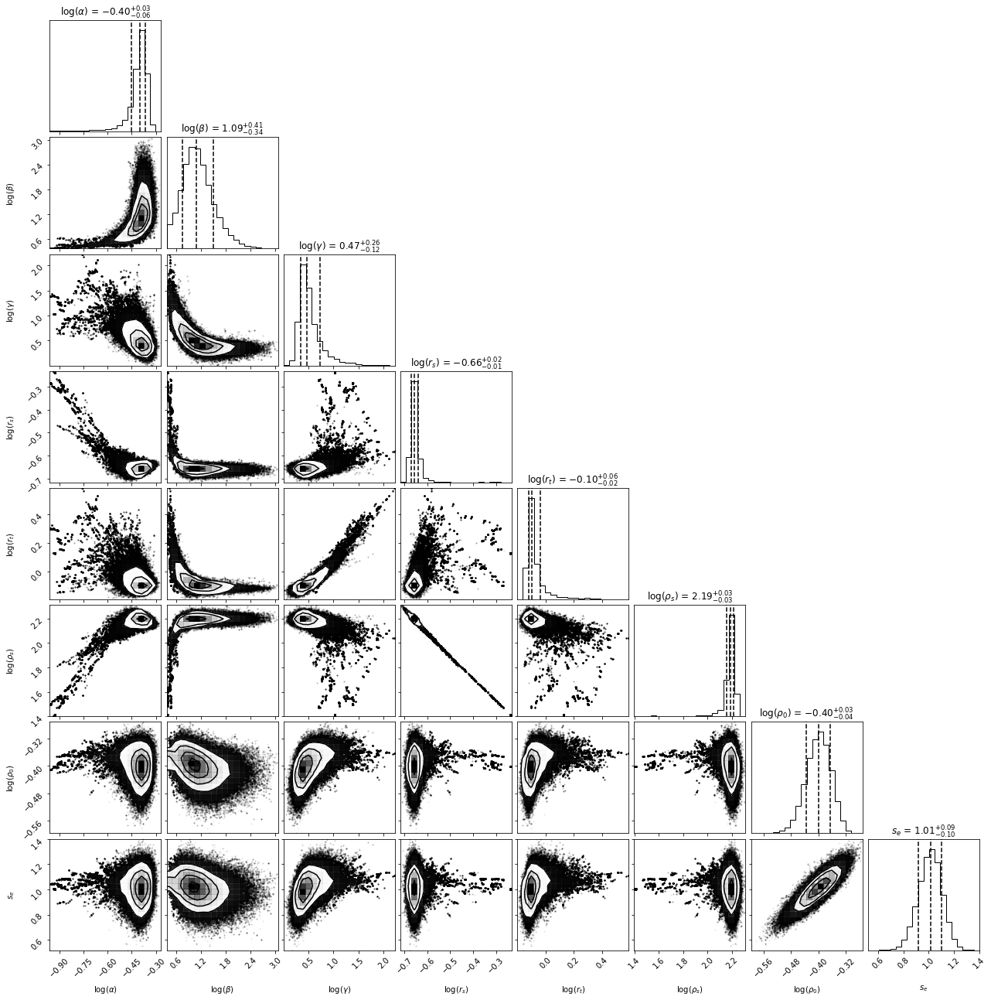

In [23]:
#MCMC
t0 = time.time()

#FROM BLUES:
#bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))

#import corner

profiles = Yi_avg_list2#[Yi_avg_list2[2],Yi_avg_list2[3]]#
covs = cov_list2#[cov_list2[2],cov_list2[3]]

#init_theta = np.array([-.92, 0.78, 0.60, 1.5, 0.34, 2, 3 , 1.66])
#bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10)) #from blue

#-0.34, 30, .03
init_theta_list1 = np.array([[-.92, 0.78, 0.60, -0.2, 0.02, 1.5, .2 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -1, -.34, 3, -0.5 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
#init_theta_list1 = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -1, -.34, 3, -0.5 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34

bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (-2, 0.7), (-2, 0.7), (-1, 30), (-1, 30), (.1, 10))
#rho_g_list = [0.0029584016482639545, 0.0022859795998316913]
rho_g_list = [0.026943079757983778, 0.021698698509888134, 0.0029584016482639545, 0.0022859795998316913]

blue_list1 = [False, True, False, False]
#blue_list1 = [False, False]

#profiles = [profiles[1]]
#covs = [covs[1]]
#init_theta_list1 = [init_theta_list1[1]]
#rho_g_list = [rho_g_list[1]]
#blue_list1 = [blue_list1[1]]

best_fit_mcmc_list, sample_list, sampler_list = MCMC(bin_stack2, profiles, covs,rho_g_list,blue_list1,init_theta_list1, bounds, 20000, 128, 5000)    
#change priors on p_s to less? change priors on r_s a little?
print(time.time() - t0)

Progress: [------------------->] 100%count 0 = 0, count total = 10000
Progress: [-->                 ] 13%

/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: overflow encountered in power


Progress: [------------------->] 100%count 1 = 227, count total = 10000
Progress: [------------------->] 100%count 2 = 643, count total = 10000
Progress: [------------------->] 100%count 3 = 0, count total = 10000


<Figure size 720x576 with 0 Axes>

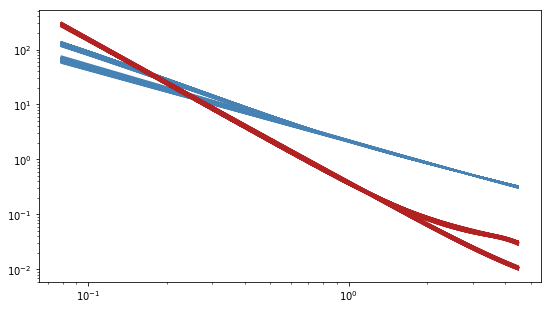

In [27]:
colors = ['slategray','steelblue','firebrick','#fa5f1b']#,'dimgray','steelblue'
labels = ['All','Blue','Red1','Red2']
'''
plt.figure(figsize=(10,8))
rsp_samps_list = []
averaged_r_tot = bin_stack2
r_thr = np.logspace(np.log10(np.min(averaged_r_tot)), np.log10(np.max(averaged_r_tot)), 3000)

plt.figure(figsize=(9,5))
for j in range(len(sampler_list)):
    indices = np.random.choice(sample_list[j].shape[0], 10000, replace=False)
    samp_list = sample_list[j][indices]
    #sampler_list[j]
    r_sp_samps = np.zeros_like(samp_list[:,0])#(sampler_list[j].flatlnprobability)
    count = 0
    count_all = 0
    for i, sample in enumerate(samp_list):
        progress_bar(i, len(samp_list))
        r_spi= get_rsp(r_thr,sample, rho_g_list)
        r_sp_samps[i] = r_spi
        if r_spi <=.3:
            #print('yes')
            plt.plot(r_thr, rho_DK14(sample, r_thr, rho_g_list[j]), color=colors[j], label="Model Fit")
            plt.xscale('log')
            plt.yscale('log')
            #print('rthr values=', (r_thr[:5]))
            count+=1
            #print(sample)
            #print(r_spi)
        count_all += 1
        progress_bar(i+1, len(samp_list))
    print('count %s = %s, count total = %s' %(j,count, count_all))
    mean = np.mean(r_sp_samps)
    variance = np.var(r_sp_samps)
    sigma = np.std(r_sp_samps)#np.sqrt(variance)
    x = np.linspace(min(r_sp_samps), max(r_sp_samps), 100)
    #res = plt.hist(r_sp_samps, bins=30, alpha=0.3, color = colors[j],label=labels[j])
    #dx = res[1][1] - res[1][0]
    #scale = len(r_sp_samps)*dx
    rsp_samps_list.append(r_sp_samps)
    #plt.figure()
    #plt.plot(x, scipy.stats.norm.pdf(x, mean, sigma)*scale, color='k', linestyle="--")
    #plt.title(r"$R_{sp}$ Posterior ", fontsize=16)
    #plt.legend(frameon=False)
    #plt.xlabel(r"$r$ [h$^{-1}$Mpc]")
    #plt.ylabel("Counts")
plt.show()
'''
rsp_samps_list = rsp_samp(sample_list, sampler_list,bin_stack2,colors,labels)


4
0.803532964418213
0 1.1368886932171804 0.034865850095079434
1 0.7062022452662826 0.13123844474432006
2 0.836914971245885 0.204818638931784
3 1.2837035531824224 0.07795703902761301


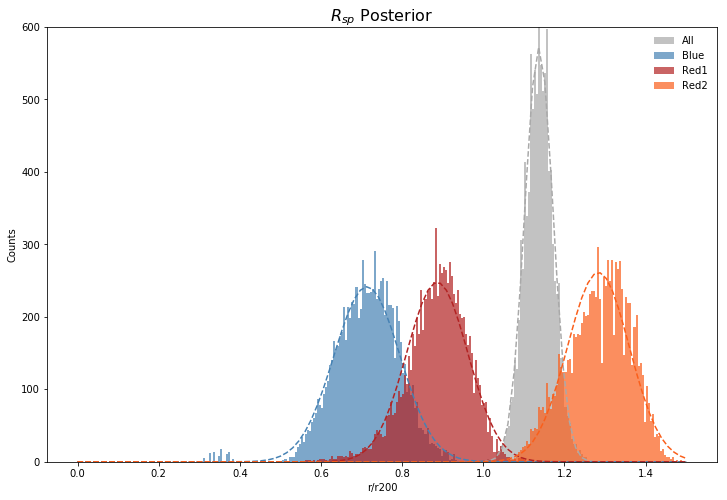

[1.1368886932171804, 0.713265961108064, 0.8863937496702353, 1.2835465394007617] [0.034865850095079434, 0.08137818896947827, 0.07536750459725555, 0.07636343659377484]


In [28]:
print(len(rsp_samps_list))
print(np.mean(rsp_samps_list[0]))

colors = ['darkgray','steelblue','firebrick','#fa5f1b']
'''
#labels = ['Red1-low','Red2-low','Red1-high','Red2-high']
alpha_list = [.7,.7,.7,.7]
plt.figure(figsize=(12,8))
means_colors = []
sigs_colors = []
for j in range(len(rsp_samps_list)):#(2,3):#
    r_sp_samps = rsp_samps_list[j]/R_avg2
    print(j,np.mean(r_sp_samps), np.std(r_sp_samps))
    r_sp_samps = r_sp_samps[(r_sp_samps>.3) & (r_sp_samps <2)] #.4
    mean = np.mean(r_sp_samps)
    variance = np.var(r_sp_samps)
    sigma = np.std(r_sp_samps)
    means_colors.append(mean)
    sigs_colors.append(sigma)
    print(j,np.mean(r_sp_samps), np.std(r_sp_samps))

    
    #mu,std = scipy.stats.norm.fit(r_sp_samps)
    x = np.linspace(0,1.5,100)#(min(r_sp_samps), max(r_sp_samps), 100)#
    res = plt.hist(r_sp_samps, bins=300, alpha=alpha_list[j], color = colors[j],label=labels[j], range=[0,1.5])#
    dx = res[1][1] - res[1][0]
    scale = len(r_sp_samps)*dx
    #rsp_samps_list.append(r_sp_samps)
    plt.plot((1)*x, scipy.stats.norm.pdf(x, mean, sigma)*scale, color=colors[j], linestyle="--")
    plt.title(r"$R_{sp}$ Posterior ", fontsize=16)
    plt.legend(frameon=False)
    plt.xlabel('r/r200')#r"$r$ [h$^{-1}$Mpc]")#
    plt.ylabel("Counts")
    plt.ylim(0,600)
    #print(mean,variance,sigma)
    #print(mu,std)
plt.show()
print(means_colors,sigs_colors)
'''
#rsp_samps_list = rsp_samp(sample_list, sampler_list,bin_stack2,colors,labels)

means_colors, sigs_colors = rsp_dist(rsp_samps_list, colors, R_avg2)


In [345]:
print(np.shape(rsp_samps_list))
#values from above originally:
#[1.1397377007955718, 0.7165847609490976, 0.8699419411397745, 1.3020391966313256] [0.04197615363969405, 0.10462829400108052, 0.07864125487824394, 0.08041914222285676]

(4, 10000)


Running burn-in...


  0%|          | 0/5000 [00:00<?, ?it/s]

Running production...


100%|██████████| 5000/5000 [02:03<00:00, 40.32it/s]


Running burn-in...


  0%|          | 7/5000 [00:00<01:19, 62.61it/s]

Running production...


100%|██████████| 5000/5000 [01:24<00:00, 69.09it/s]


Running burn-in...


  0%|          | 6/5000 [00:00<01:29, 55.57it/s]

Running production...


100%|██████████| 5000/5000 [01:21<00:00, 61.41it/s]


Running burn-in...


  0%|          | 0/5000 [00:00<?, ?it/s]

Running production...


100%|██████████| 5000/5000 [01:27<00:00, 57.46it/s]


done MCMC
1252.8555250167847


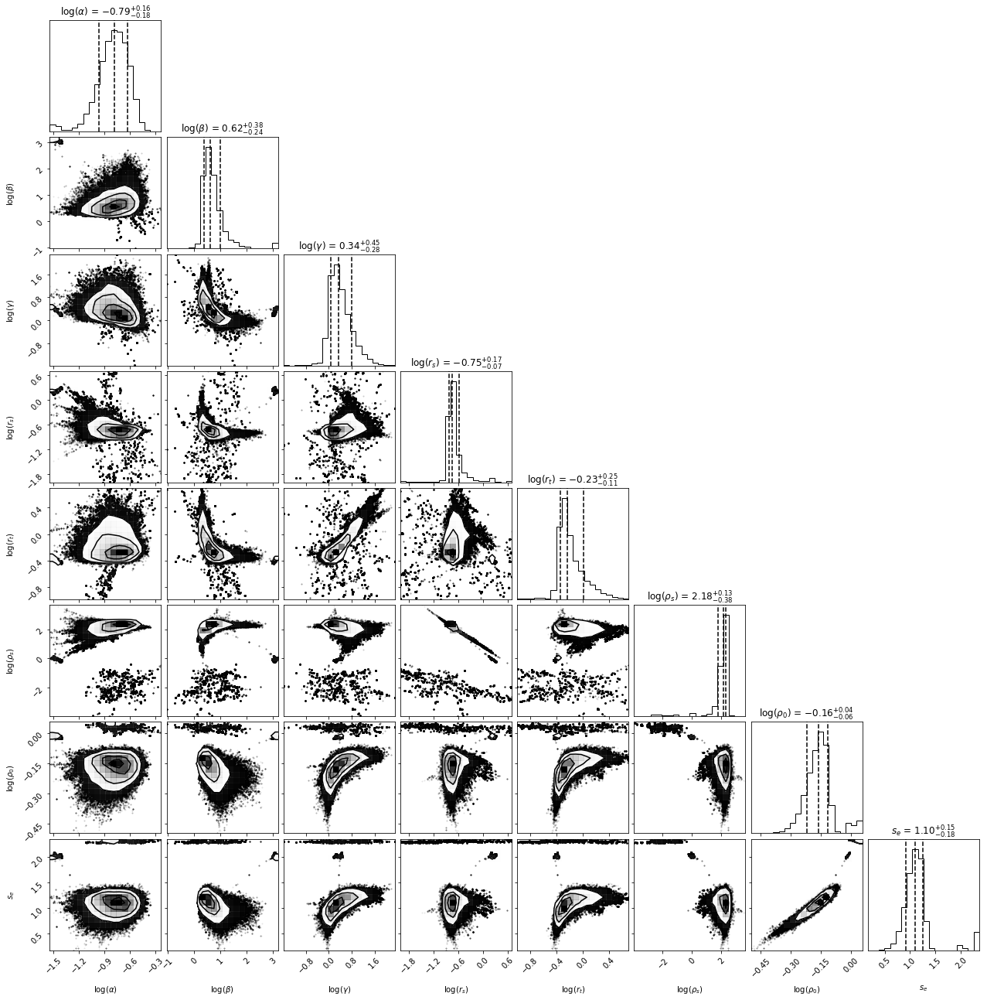

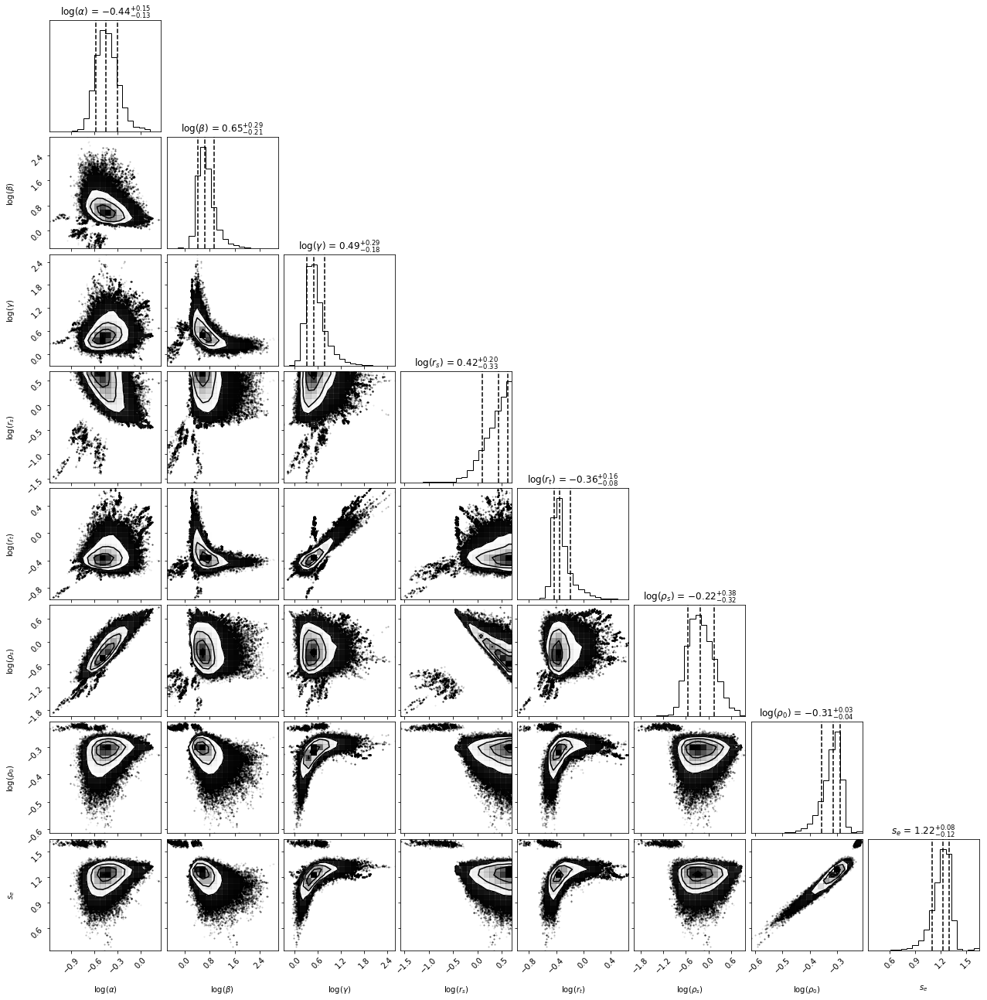

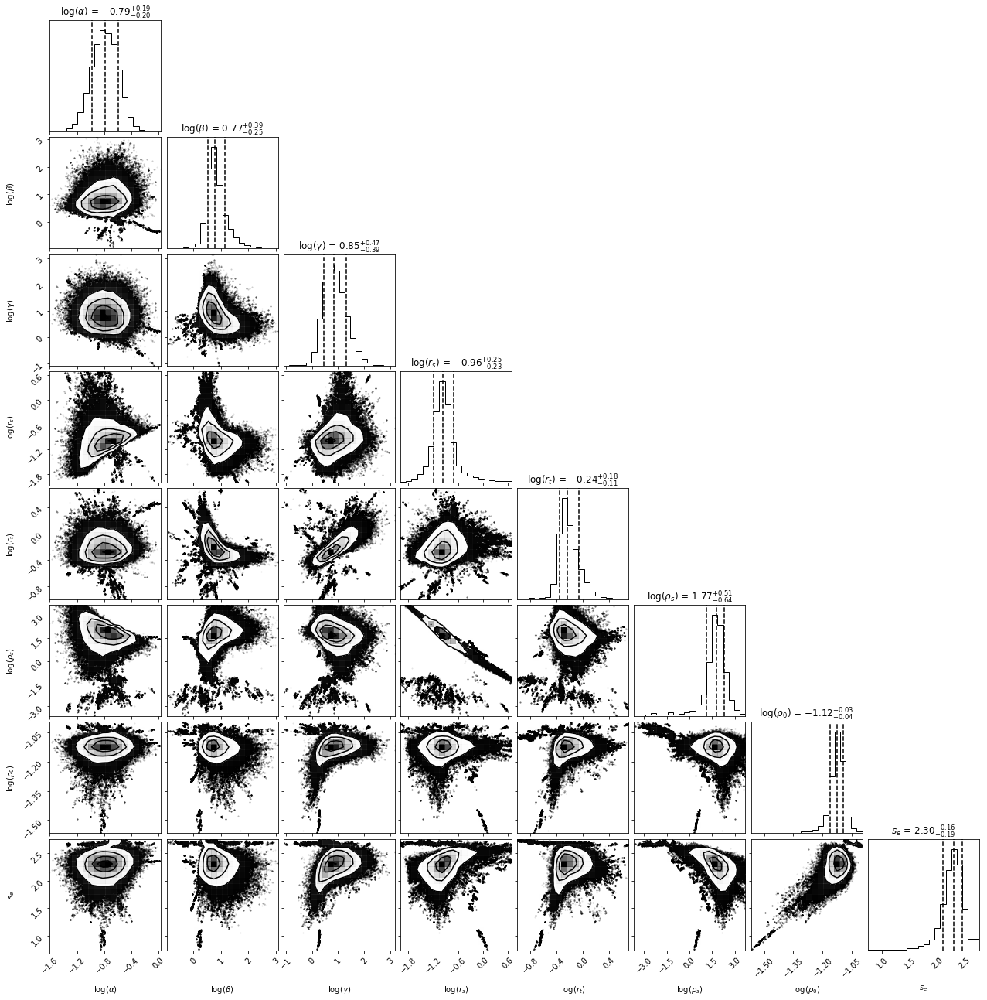

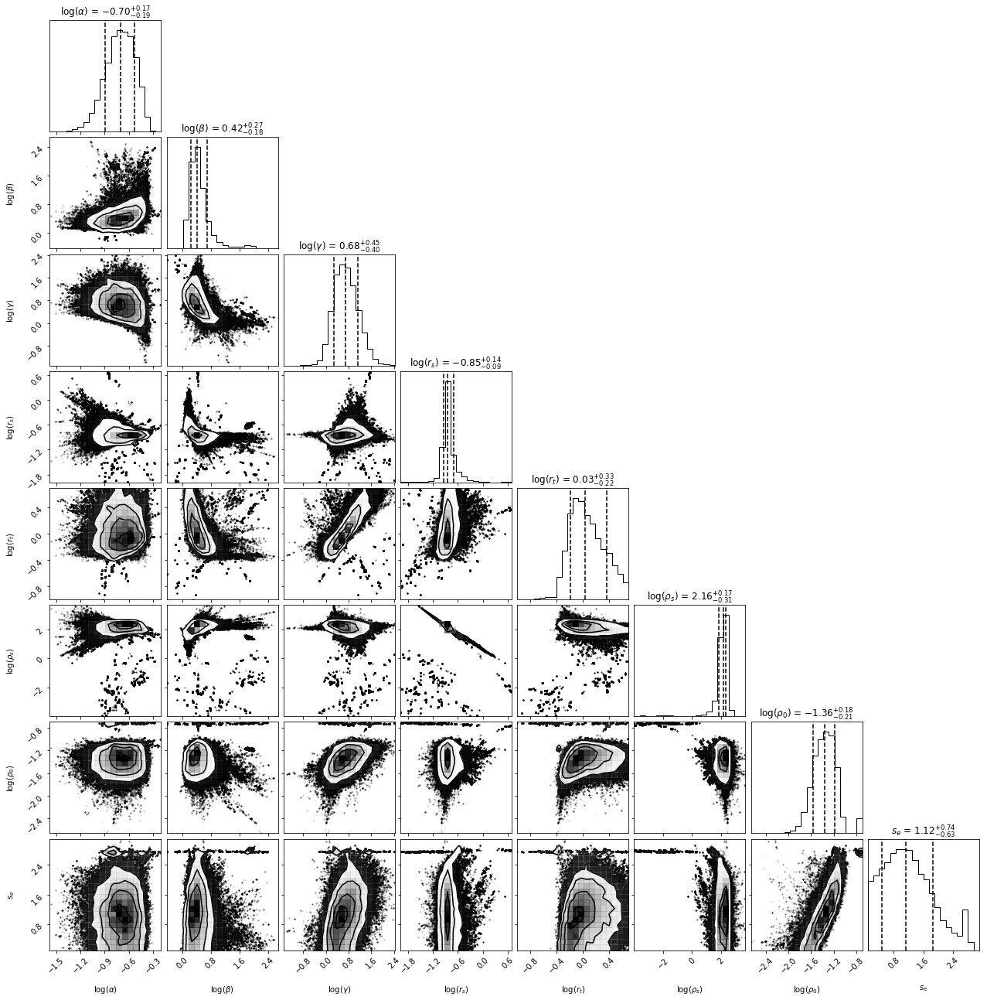

In [191]:
# REFINED COLOR CUTS MCMC RUN
t0 = time.time()

#import corner

profiles = [Yi_avgR, Yi_avg_blueR, Yi_avg_redR,Yi_avg_greenR]
covs = [covR, cov_blueR, cov_redR,cov_greenR]


init_theta = np.array([-.92, 0.78, 0.60, -0.61, 0.34, 2, 3 , 1.66])
bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (-2, 0.7), (-2, 0.7), (-1, 30), (-1, 30), (.1, 10))
#NEED TO PUT IN CORRECT RHO_G_LIST
best_fit_mcmc_listR, samplesR = MCMC(bin_stackR, profiles, covs,rho_g_list,init_theta, bounds, 10000, 128, 5000) 
print(time.time()-t0)


/Users/TaraD/anaconda3/lib/python3.7/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))
/Users/TaraD/anaconda3/lib/python3.7/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


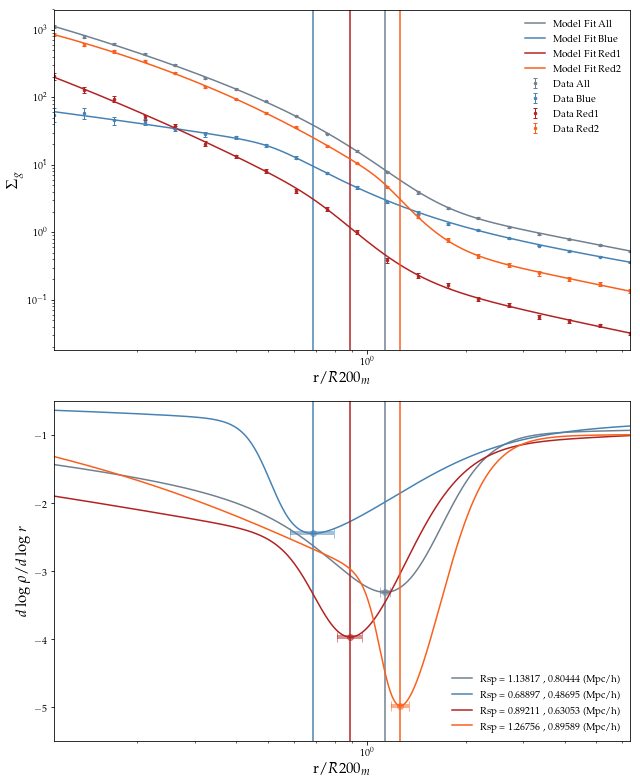

R_avg= 0.7067824398397052
[0.8044418668031104, 0.4869508913948915, 0.6305282254889524, 0.8958859689373306]


In [40]:
# MCMC FITTING COLOR SPLIT PROFILES
colors = ['slategray','steelblue','firebrick','#fa5f1b']#,'dimgray','steelblue'
labels = ['All','Blue','Red1','Red2']
#labels = ['Low stellar mass Red','High stellar mass Red']

ls_list = ['-','-','-','-']

#BASIC
# NOT RUN
profiles = Yi_avg_list2#
covs = cov_list2#[cov_list2[2],cov_list2[3]]
averaged_r_tot = bin_stack2
r_sp_list, r_sp_r200_list = FittedPlots(best_fit_mcmc_list, profiles, averaged_r_tot,R_avg2,covs,rho_g_list,sigs_colors,labels, colors, ls_list)
'''
#REFINED
profiles = [Yi_avgR, Yi_avg_blueR, Yi_avg_redR,Yi_avg_greenR]
covs = [covR, cov_blueR, cov_redR,cov_greenR]
averaged_r_tot = bin_stackR
r_sp_list = FittedPlots(best_fit_mcmc_listR, profiles, averaged_r_tot,covs,rho_g_list,labels, colors, ls_list)
'''

print(r_sp_list)
#print(R_avg1, 2./R_avg1)



/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: overflow encountered in power


Running burn-in...


  0%|          | 11/5000 [00:00<00:48, 102.06it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 11/5000 [00:00<00:47, 105.65it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 12/5000 [00:00<00:43, 115.47it/s]

Running production...


100%|██████████| 5000/5000 [00:48<00:00, 102.83it/s]


Running burn-in...


  0%|          | 13/5000 [00:00<00:39, 124.78it/s]

Running production...


100%|██████████| 5000/5000 [00:42<00:00, 117.51it/s]


done MCMC
929.223687171936


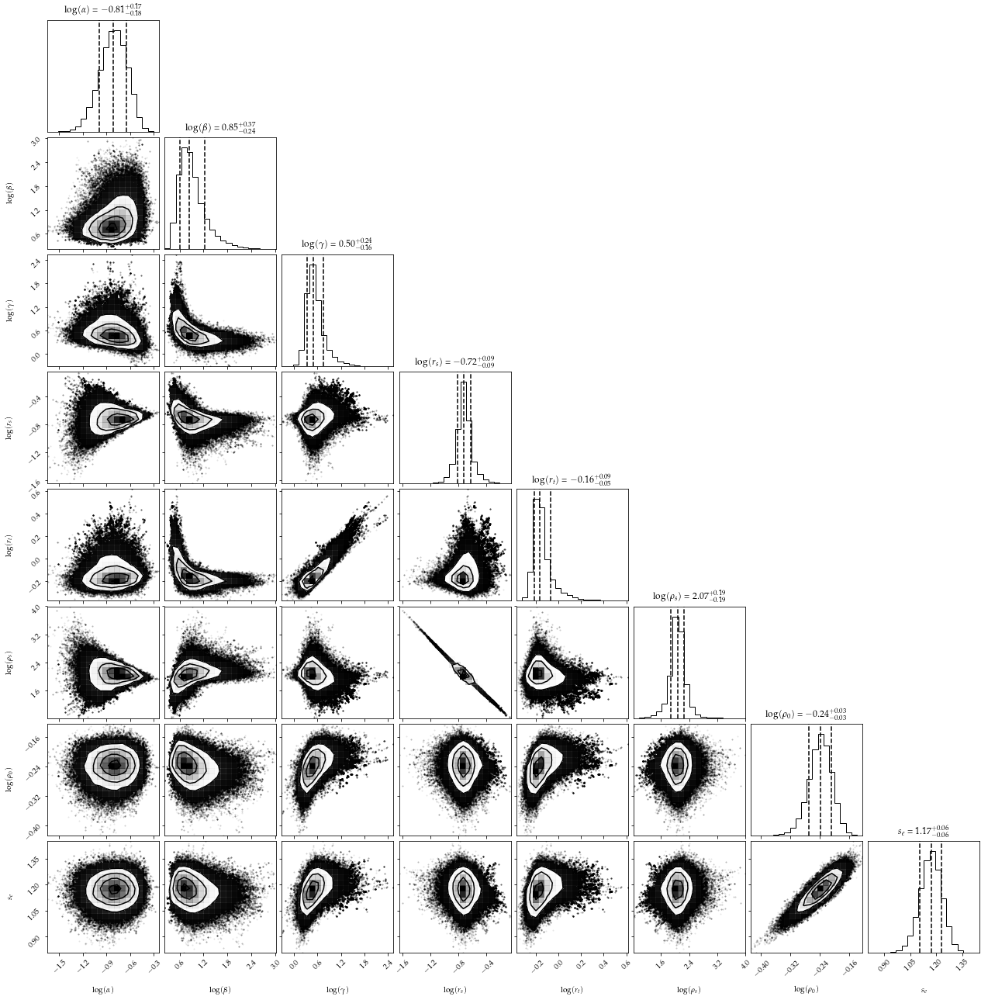

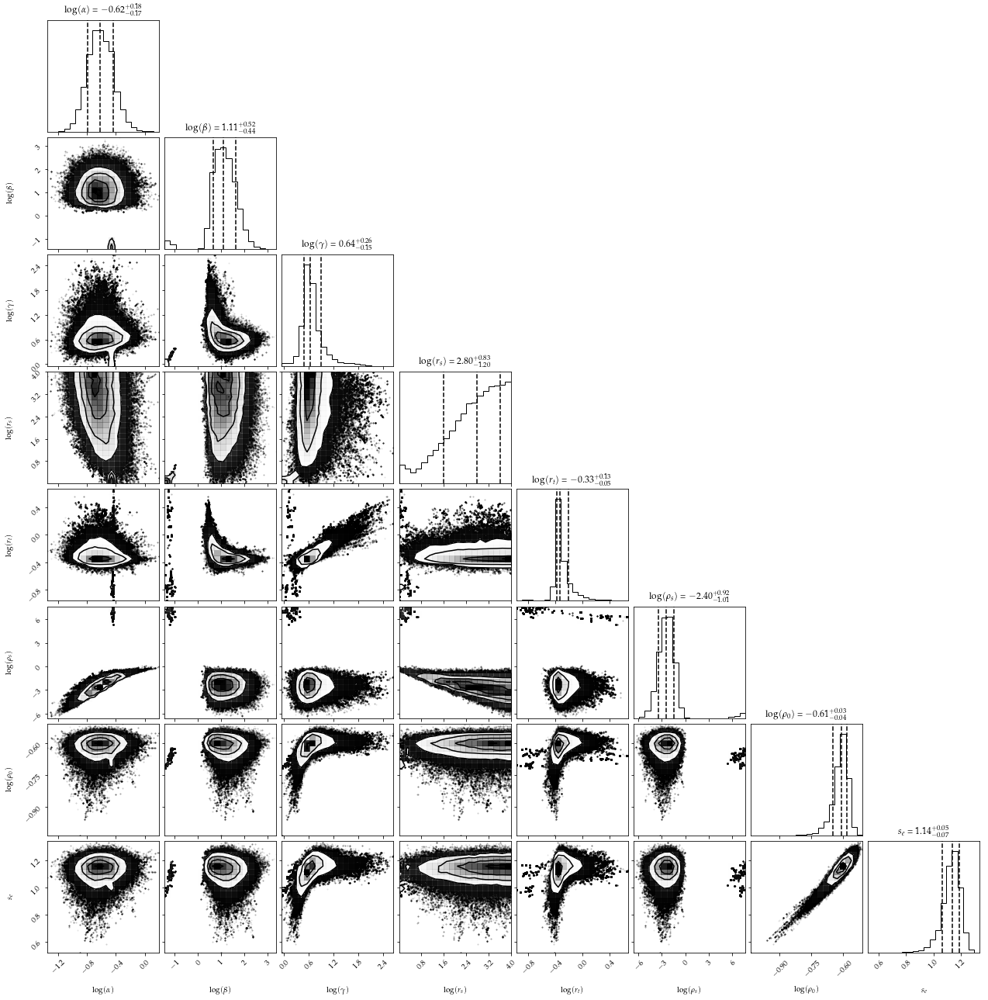

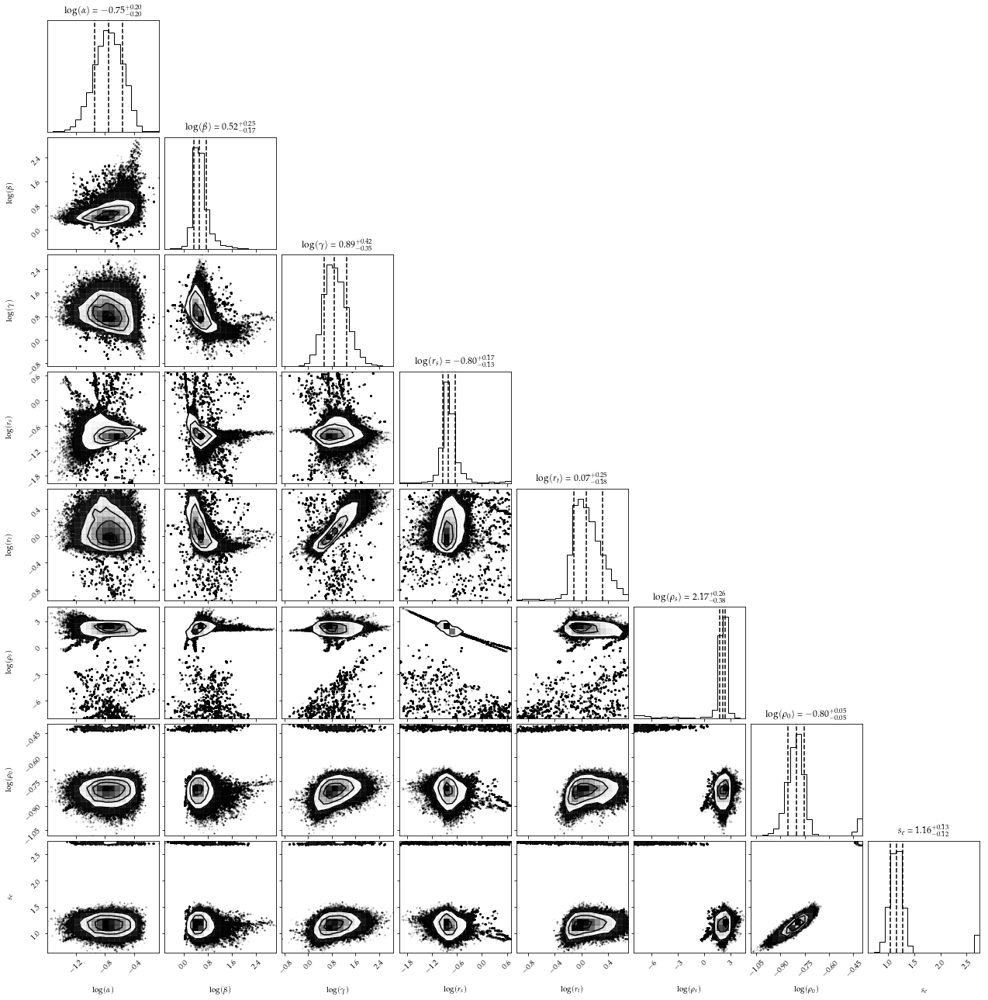

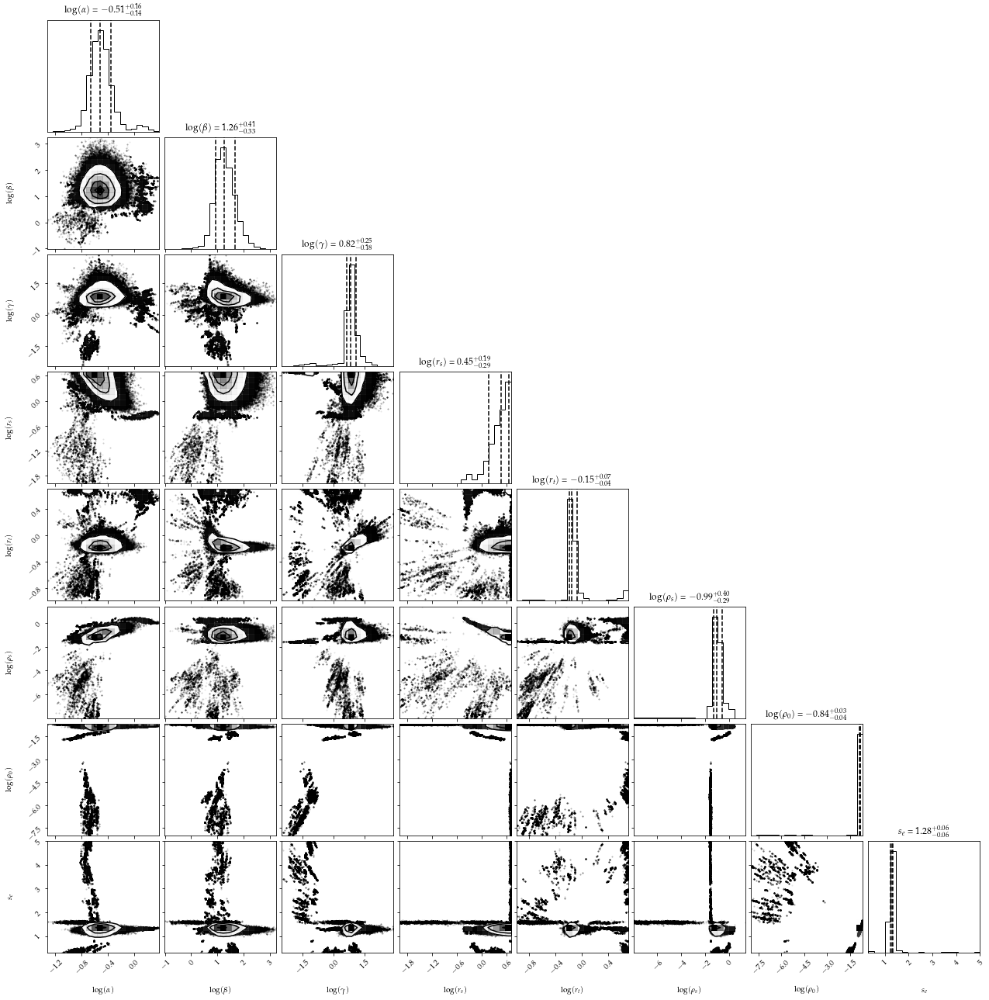

In [60]:
#MCMC
t0 = time.time()

profiles = Yi_avg_list3
covs = cov_list3

init_theta_list1 = np.array([[-.92, 0.78, 0.60, -0.2, 0.02, 1.5, .2 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (-2, .7), (-2, 0.7), (-1, 30), (-1, 30), (.1, 10))

blue_list1 = [False, True, False, False]

best_fit_mcmc_list3, sample_list3, sampler_list3 = MCMC(bin_stack3, profiles, covs,rho_g_list_old,blue_list1,init_theta_list1, bounds, 20000, 128, 5000)    
print(time.time() - t0)

Progress: [---->               ] 23%

/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: overflow encountered in power


Progress: [------------------->] 100%count 0 = 0, count total = 10000
Progress: [------------------->] 100%count 1 = 5, count total = 10000
Progress: [------------------->] 100%count 2 = 576, count total = 10000
Progress: [------------------->] 100%count 3 = 283, count total = 10000


<Figure size 720x576 with 0 Axes>

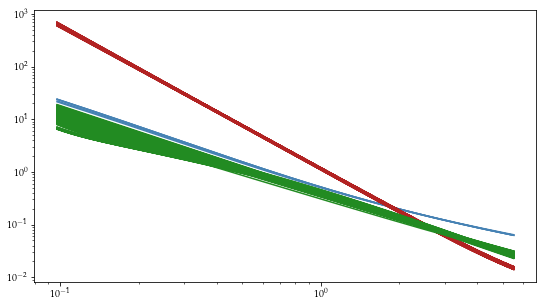

0 0.8981702406337616 0.07677149840100139
1 0.6592068077804717 0.1390443838423638
2 1.0419630672679485 0.2412379009399588
3 0.9023293828666178 0.30081957362739326


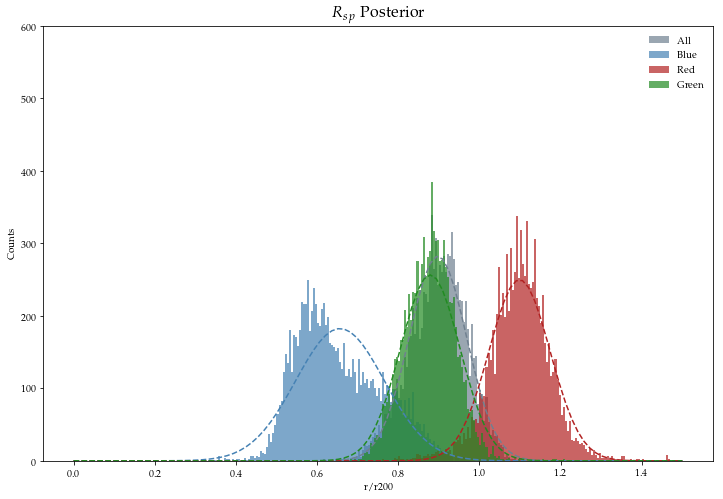

[0.8976704585989699, 0.6565348932318308, 1.098803877163065, 0.8788210067697056] [0.07066013513440529, 0.10920822558007402, 0.07523996918493474, 0.07323549593695046]


In [70]:
rsp_samps_list3 = rsp_samp(sample_list3, sampler_list3,bin_stack3,colors,labels,rho_g_list_old)

means_colors_old, sigs_colors_old = rsp_dist(rsp_samps_list3, colors, R_avg3,.2)

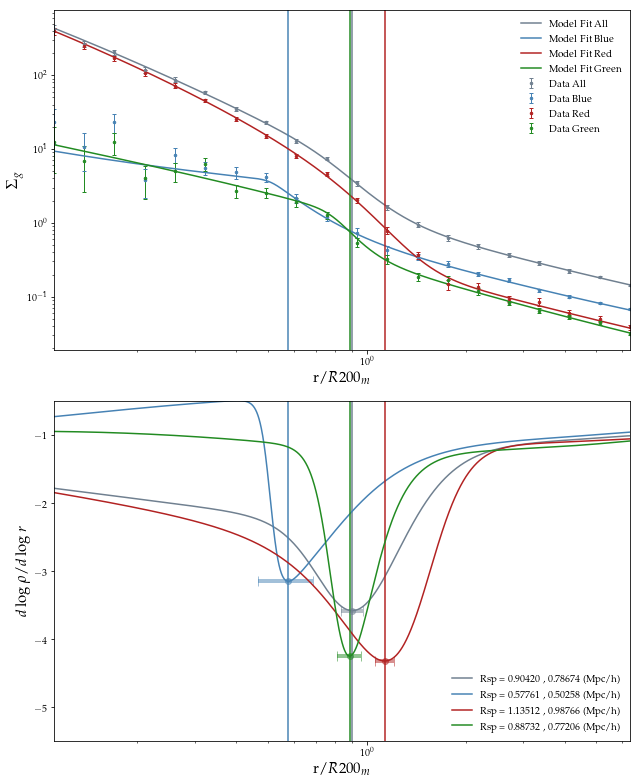

R_avg= 0.8701007239330811
[0.7867433312355722, 0.5025769949048527, 0.9876646104135888, 0.772058854536504]


In [71]:
# MCMC FITTING COLOR SPLIT PROFILES
colors = ['slategray','steelblue','firebrick','forestgreen']#,'dimgray','steelblue'
labels = ['All','Blue','Red','Green']

ls_list = ['-','-','-','-']

profiles = Yi_avg_list3
covs = cov_list3
averaged_r_tot = bin_stack3
#sigs_colors_old = [0.01,.01,.01,.01]
r_sp_list_old, r_sp_r200_list_old = FittedPlots(best_fit_mcmc_list3, profiles, averaged_r_tot,R_avg3,covs,rho_g_list_old,sigs_colors_old,labels, colors, ls_list)
'''
#REFINED
profiles = [Yi_avgR, Yi_avg_blueR, Yi_avg_redR,Yi_avg_greenR]
covs = [covR, cov_blueR, cov_redR,cov_greenR]
averaged_r_tot = bin_stackR
r_sp_list = FittedPlots(best_fit_mcmc_listR, profiles, averaged_r_tot,covs,rho_g_list,labels, colors, ls_list)
'''

print(r_sp_list_old)
#print(R_avg1, 2./R_avg1)

## Blue Splitting Profiles


Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 15743.363617897034
R500c, R200c, R200m: 0.7612624597816122 1.24644093717065 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 15743.376821041107
566208 566208 time 15743.399690151215
N Subhalos within 7*R200m: 4517 15743.44922876358
galaxies 0 [   8.   21.   28.   34.   31.   59.   71.   83.  122.  129.  103.   76.
   84.   53.  118.  236.  519.  628.  738. 1347.]
galaxies 1 [  0.   0.   1.   2.   2.  10.   9.   7.   6.  13.  13.  13.  35.  33.
  79. 113. 153. 260. 509. 810.]
galaxies 2 [  0.   0.   0.   0.   0.   1.   0.   0.   1.   3.   4.   3.   8.  11.
  21.  32.  55.  82. 181. 278.]
galaxies 3 [  0.   0.   1.   2.   2.   9.   9.   7.   5.  10.   9.  10.  27.  21.
  58.  81.  98. 178. 328. 532.]

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 15743.45325088501
R500c, R200c, R200m: 0.5860514830407864 0.916949635434108 1.1697442162737657
Rscale 1.1697442162737657
before dev loo

N Subhalos within 7*R200m: 903 15744.517985105515
galaxies 0 [  3.   5.   2.  13.  10.  21.  24.  17.  26.  25.  39.  37.  48.  37.
  49.  52.  69.  97. 141. 178.]
galaxies 1 [  1.   0.   0.   1.   2.   4.   5.   6.   7.   8.  12.   8.  14.  16.
  38.  42.  56.  81. 128. 156.]
galaxies 2 [ 0.  0.  0.  1.  0.  0.  1.  0.  1.  5.  3.  1.  3.  9. 15. 17. 23. 31.
 46. 46.]
galaxies 3 [  1.   0.   0.   0.   2.   4.   4.   6.   6.   3.   9.   7.  11.   7.
  23.  25.  33.  50.  82. 109.]

Halo: 14
Halo Mass: 25908.443
N Subhalos from Illustris Algorithm: 1733 15744.521311044693
R500c, R200c, R200m: 0.5403272153001663 0.8218303411036568 1.0292258540514474
Rscale 1.0292258540514474
before dev loop: 15744.525812149048
566208 566208 time 15744.5497879982
N Subhalos within 7*R200m: 1352 15744.59372997284
galaxies 0 [  4.   4.   9.  10.  13.  14.  21.  32.  24.  33.  40.  45.  17.  16.
  25.  62. 252. 223. 140. 356.]
galaxies 1 [  0.   0.   0.   0.   2.   0.   1.   2.   2.   2.   5.  13.   3.   8.


N Subhalos within 7*R200m: 939 15745.424342870712
galaxies 0 [  3.   2.   8.   8.  11.  14.  11.  12.  29.  18.  23.  25.  17.  20.
  49.  40.  50. 177. 187. 228.]
galaxies 1 [  0.   0.   0.   0.   2.   1.   1.   0.   5.   4.   4.   4.   5.   9.
  26.  25.  34.  62. 105. 177.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  2.  0.  1.  1.  3.  4.  6.  8.  9. 23.
 35. 58.]
galaxies 3 [  0.   0.   0.   0.   2.   1.   1.   0.   3.   4.   3.   3.   2.   5.
  20.  17.  25.  39.  70. 119.]

Halo: 26
Halo Mass: 18821.283
N Subhalos from Illustris Algorithm: 1328 15745.42759680748
R500c, R200c, R200m: 0.47668837127984176 0.7524419893794323 0.9314922299754277
Rscale 0.9314922299754277
before dev loop: 15745.43219590187
566208 566208 time 15745.455212116241
N Subhalos within 7*R200m: 1130 15745.497925043106
galaxies 0 [  3.   3.  10.  10.   3.  11.  19.  20.  22.  28.  23.  14.  11.   7.
  48.  47.  43. 219. 225. 355.]
galaxies 1 [  0.   0.   0.   0.   1.   1.   2.   1.   3.   5.   5.   4.   6.   6

N Subhalos within 7*R200m: 749 15746.316874980927
galaxies 0 [  7.   5.   5.  12.  14.  11.  22.  18.  19.  32.  20.  18.  10.  13.
  18.  33.  31.  42. 145. 269.]
galaxies 1 [  0.   0.   1.   1.   1.   3.   5.   4.   8.   6.   7.  11.   7.  11.
  12.  25.  25.  33.  98. 161.]
galaxies 2 [ 0.  0.  0.  1.  0.  0.  1.  2.  3.  3.  4.  2.  0.  2.  3.  9.  9.  8.
 32. 65.]
galaxies 3 [ 0.  0.  1.  0.  1.  3.  4.  2.  5.  3.  3.  9.  7.  9.  9. 16. 16. 25.
 66. 96.]

Halo: 38
Halo Mass: 16264.685
N Subhalos from Illustris Algorithm: 1115 15746.320759057999
R500c, R200c, R200m: 0.4649485486468481 0.705506239104883 0.8694410722288736
Rscale 0.8694410722288736
before dev loop: 15746.325465917587
566208 566208 time 15746.349711894989
N Subhalos within 7*R200m: 666 15746.391522884369
galaxies 0 [  1.   4.   3.   6.   6.  11.  12.  17.  22.  24.  23.  22.  13.   6.
  18.  18.  53.  72. 118. 210.]
galaxies 1 [  0.   0.   1.   0.   0.   1.   1.   2.   4.   4.   4.   4.   9.   5.
  13.  17.  34.  48

N Subhalos within 7*R200m: 563 15747.205697774887
galaxies 0 [  2.   2.   4.   3.   4.   8.   9.  13.  13.  15.  14.  10.  31.  24.
  27.  53.  37.  72.  87. 130.]
galaxies 1 [  1.   0.   0.   0.   0.   1.   1.   5.   8.   5.   8.   3.  10.  17.
  19.  42.  29.  56.  80. 103.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  1.  2.  4.  1.  3.  1.  2.  8.  7. 12.  6. 14.
 36. 42.]
galaxies 3 [ 1.  0.  0.  0.  0.  1.  0.  3.  4.  4.  5.  2.  8.  9. 12. 30. 23. 42.
 44. 61.]

Halo: 50
Halo Mass: 13977.665
N Subhalos from Illustris Algorithm: 1162 15747.210167884827
R500c, R200c, R200m: 0.40147216443032 0.6469831173882855 0.8314299619990567
Rscale 0.8314299619990567
before dev loop: 15747.214191913605
566208 566208 time 15747.237482070923
N Subhalos within 7*R200m: 924 15747.2806558609
galaxies 0 [  0.   4.   5.   4.   5.   4.   7.  15.  19.  20.  26.  31.  21.  18.
  32.  68.  71.  59. 155. 356.]
galaxies 1 [  0.   0.   0.   0.   0.   0.   2.   1.   1.   4.   6.   9.   7.  12.
  20.  30.  44.  39. 1

before dev loop: 15748.040912866592
566208 566208 time 15748.065121889114
N Subhalos within 7*R200m: 473 15748.10599899292
galaxies 0 [  1.   6.   4.   5.   8.  11.  22.  18.  23.  14.  11.  11.   6.   7.
   9.  14.  17.  56. 110. 112.]
galaxies 1 [ 1.  1.  2.  1.  1.  4.  3.  6.  6.  4.  5.  7.  4.  7.  9. 11. 15. 32.
 73. 88.]
galaxies 2 [ 1.  0.  1.  1.  0.  0.  1.  1.  2.  1.  2.  1.  1.  2.  3.  0.  7.  9.
 27. 28.]
galaxies 3 [ 0.  1.  1.  0.  1.  4.  2.  5.  4.  3.  3.  6.  3.  5.  6. 11.  8. 23.
 46. 59.]

Halo: 62
Halo Mass: 13000.34
N Subhalos from Illustris Algorithm: 1047 15748.109589099884
R500c, R200c, R200m: 0.4069041589001368 0.6331709514128275 0.782193111526722
Rscale 0.782193111526722
before dev loop: 15748.114068984985
566208 566208 time 15748.136529922485
N Subhalos within 7*R200m: 386 15748.178101062775
galaxies 0 [  1.   5.   8.   4.   7.  11.  11.  11.  13.   8.  14.   4.  15.  15.
  10.  10.  21.  37.  68. 108.]
galaxies 1 [ 0.  1.  1.  0.  0.  1.  4.  2.  1.  1

N Subhalos within 7*R200m: 607 15749.140547990799
galaxies 0 [  3.   3.   2.   6.   6.  11.   6.  10.  10.  13.  15.  18.  14.  14.
  17.  47.  62. 103. 131. 114.]
galaxies 1 [  0.   0.   0.   0.   1.   1.   1.   3.   2.   4.   2.   3.   5.   6.
  11.  21.  36.  55.  93. 107.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  1.  0.  2.  0.  2.  1.  2.  2.  4. 10. 18.
 33. 44.]
galaxies 3 [ 0.  0.  0.  0.  1.  1.  1.  2.  2.  2.  2.  1.  4.  4.  9. 16. 26. 37.
 60. 63.]

Halo: 76
Halo Mass: 11053.76
N Subhalos from Illustris Algorithm: 749 15749.144716024399
R500c, R200c, R200m: 0.4207121212581975 0.6474206539076773 0.7837246694996244
Rscale 0.7837246694996244
before dev loop: 15749.14955997467
566208 566208 time 15749.172678947449
N Subhalos within 7*R200m: 451 15749.213109016418
galaxies 0 [  3.   5.   2.   3.   5.  11.  19.  13.  19.  16.   8.   5.   7.  11.
  19.  27.  34.  34.  81. 125.]
galaxies 1 [  0.   1.   0.   0.   1.   1.   2.   1.   4.   6.   2.   2.   7.  10.
  13.  22.  29.  28. 

N Subhalos within 7*R200m: 643 15750.001768112183
galaxies 0 [  1.   2.   2.   7.   9.   9.   6.  12.  11.  18.  17.  25.  15.  12.
  18.  52.  49.  91.  86. 200.]
galaxies 1 [  0.   0.   0.   0.   0.   0.   0.   2.   2.   6.   3.   4.   4.   9.
  11.  33.  34.  51.  65. 166.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  2.  5.  4. 17.  8. 13.
 27. 64.]
galaxies 3 [  0.   0.   0.   0.   0.   0.   0.   2.   1.   6.   3.   4.   2.   4.
   7.  16.  26.  38.  38. 102.]

Halo: 88
Halo Mass: 10377.713
N Subhalos from Illustris Algorithm: 915 15750.005192995071
R500c, R200c, R200m: 0.36927057354705745 0.5933709417564849 0.7523559153089142
Rscale 0.7523559153089142
before dev loop: 15750.01012301445
566208 566208 time 15750.032472848892
N Subhalos within 7*R200m: 702 15750.07361483574
galaxies 0 [  0.   4.   3.   0.   4.   7.   4.   8.  23.  22.  14.  18.  18.   7.
  32.  54.  98.  76. 121. 180.]
galaxies 1 [ 0.  0.  0.  0.  1.  0.  0.  2.  6.  4.  6.  7. 12.  1. 12. 17. 56. 47

N Subhalos within 7*R200m: 445 15750.881097078323
galaxies 0 [ 2.  2.  2.  5.  3.  8. 10.  9. 13. 12. 13. 21. 11. 20. 16. 21. 32. 65.
 86. 90.]
galaxies 1 [ 0.  0.  1.  0.  0.  3.  2.  2.  4.  2.  7.  7.  7. 13. 11. 20. 30. 49.
 68. 85.]
galaxies 2 [ 0.  0.  1.  0.  0.  1.  0.  2.  1.  1.  1.  3.  4.  2.  6.  7. 10. 22.
 24. 26.]
galaxies 3 [ 0.  0.  0.  0.  0.  2.  2.  0.  3.  1.  6.  4.  3. 11.  5. 13. 20. 27.
 44. 59.]

Halo: 100
Halo Mass: 9850.419
N Subhalos from Illustris Algorithm: 734 15750.884021043777
R500c, R200c, R200m: 0.4086667957265417 0.612058583292796 0.75188551050492
Rscale 0.75188551050492
before dev loop: 15750.888731002808
566208 566208 time 15750.911751031876
N Subhalos within 7*R200m: 469 15750.953387022018
galaxies 0 [  1.   2.   2.   4.   8.  13.  16.   5.  12.  12.  14.  16.   4.   7.
  11.  33.  27.  80.  76. 121.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  1.  1.  4.  3.  7.  5.  1.  5. 10. 25. 15. 37.
 61. 91.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  2. 

N Subhalos within 7*R200m: 433 15751.745797872543
galaxies 0 [  2.   3.   3.   5.   2.   7.   9.  11.  13.  12.   7.   8.   6.   3.
  14.  29.  36.  74.  68. 117.]
galaxies 1 [ 0.  0.  1.  0.  0.  1.  0.  2.  3.  5.  1.  4.  4.  2. 13. 26. 26. 53.
 53. 85.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  1.  0.  0.  5. 10. 13. 13.
 12. 23.]
galaxies 3 [ 0.  0.  1.  0.  0.  1.  0.  2.  3.  4.  0.  3.  4.  2.  8. 16. 13. 40.
 41. 62.]

Halo: 112
Halo Mass: 9802.825
N Subhalos from Illustris Algorithm: 757 15751.74797797203
R500c, R200c, R200m: 0.2996138308606221 0.4969133757845088 0.6207533054831167
Rscale 0.6207533054831167
before dev loop: 15751.752597093582
566208 566208 time 15751.773823976517
N Subhalos within 7*R200m: 374 15751.81362581253
galaxies 0 [ 0.  1.  1.  1.  3.  5.  7.  9.  9.  6.  4.  8. 15. 15. 13. 39. 35. 46.
 70. 84.]
galaxies 1 [ 0.  0.  0.  1.  1.  0.  1.  2.  1.  1.  1.  5.  7.  9.  8. 12. 19. 23.
 56. 64.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  

N Subhalos within 7*R200m: 356 15752.60400891304
galaxies 0 [  3.   2.   1.   4.   6.   4.   8.   8.  18.   7.  18.  13.  11.   5.
   5.  42.  27.  21.  44. 103.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  0.  2.  1.  2.  5.  4.  3.  4. 28. 16. 18.
 34. 90.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  2.  1.  0.  3. 10.  2.  9.
 11. 34.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  1.  0.  1.  1.  2.  3.  3.  3.  1. 18. 14.  9.
 23. 56.]

Halo: 124
Halo Mass: 9097.682
N Subhalos from Illustris Algorithm: 812 15752.606029987335
R500c, R200c, R200m: 0.34309460797902663 0.5356989124422801 0.6703758878947268
Rscale 0.6703758878947268
before dev loop: 15752.612032175064
566208 566208 time 15752.636369943619
N Subhalos within 7*R200m: 475 15752.679121017456
galaxies 0 [ 0.  0.  6.  0.  5. 14.  4. 12. 11. 11. 15. 22. 15.  9. 22. 40. 50. 55.
 95. 84.]
galaxies 1 [ 0.  0.  0.  0.  0.  4.  0.  1.  5.  3.  6.  8.  4.  6. 15. 28. 32. 32.
 42. 66.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  1.  1.

 29. 51.]

Halo: 137
Halo Mass: 8702.109
N Subhalos from Illustris Algorithm: 666 15753.462926864624
R500c, R200c, R200m: 0.40050092863926473 0.5958553597072482 0.7231846521557567
Rscale 0.7231846521557567
before dev loop: 15753.467777967453
566208 566208 time 15753.490805149078
N Subhalos within 7*R200m: 241 15753.530722856522
galaxies 0 [ 1.  5.  4.  4. 11.  8.  7.  9.  9. 16.  5.  9.  4.  8.  9. 11. 20. 27.
 32. 40.]
galaxies 1 [ 0.  0.  0.  1.  2.  1.  3.  3.  5.  5.  2.  6.  2.  7.  8. 10.  9. 25.
 27. 35.]
galaxies 2 [ 0.  0.  0.  0.  1.  1.  2.  1.  1.  1.  1.  3.  1.  2.  3.  2.  4. 10.
 12. 15.]
galaxies 3 [ 0.  0.  0.  1.  1.  0.  1.  2.  4.  4.  1.  3.  1.  5.  5.  8.  5. 15.
 15. 20.]

Halo: 138
Halo Mass: 8484.707
N Subhalos from Illustris Algorithm: 536 15753.533283948898
R500c, R200c, R200m: 0.35872738066652227 0.5530849939290035 0.7087427842941688
Rscale 0.7087427842941688
before dev loop: 15753.537683963776
566208 566208 time 15753.559735059738
N Subhalos within 7*R200

N Subhalos within 7*R200m: 719 15754.51448392868
galaxies 0 [  2.   0.   3.   4.   4.   4.   7.  16.  11.  14.  10.   7.   6.  10.
  12.  19.  54.  82. 120. 331.]
galaxies 1 [  0.   0.   0.   0.   1.   1.   2.   1.   3.   4.   4.   4.   6.   9.
   8.  15.  37.  56.  50. 131.]
galaxies 2 [ 0.  0.  0.  0.  1.  0.  0.  1.  1.  0.  0.  2.  1.  4.  3.  7. 14. 15.
 17. 37.]
galaxies 3 [ 0.  0.  0.  0.  0.  1.  2.  0.  2.  4.  4.  2.  5.  5.  5.  8. 23. 41.
 33. 94.]

Halo: 155
Halo Mass: 8149.402
N Subhalos from Illustris Algorithm: 772 15754.517557144165
R500c, R200c, R200m: 0.27335867714771467 0.5035693835715442 0.6768387694881904
Rscale 0.6768387694881904
before dev loop: 15754.522028207779
566208 566208 time 15754.544952869415
N Subhalos within 7*R200m: 721 15754.585888147354
galaxies 0 [  1.   1.   1.   4.   2.   2.   4.   4.  14.  32.  16.  15.   8.   7.
  28.  46.  38.  85.  97. 314.]
galaxies 1 [  0.   0.   0.   0.   0.   0.   0.   1.   9.   9.   9.   6.   7.   6.
  24.  25.  25.  46

N Subhalos within 7*R200m: 702 15755.375655889511
galaxies 0 [  1.   0.   4.   5.   0.   4.   3.   5.  12.   6.  16.  20.  17.  27.
  26.  75.  83.  46. 131. 218.]
galaxies 1 [  0.   0.   2.   1.   0.   0.   1.   1.   4.   3.   2.  12.   8.  15.
  12.  27.  47.  34.  91. 129.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  1.  0.  2.  0.  3.  0.  4.  1. 11. 11. 14.
 28. 43.]
galaxies 3 [ 0.  0.  2.  1.  0.  0.  1.  0.  4.  1.  2.  9.  8. 11. 11. 16. 36. 20.
 63. 86.]

Halo: 168
Halo Mass: 7575.211
N Subhalos from Illustris Algorithm: 598 15755.380886793137
R500c, R200c, R200m: 0.35806773301074246 0.5511675038445688 0.6865883594385488
Rscale 0.6865883594385488
before dev loop: 15755.387339115143
566208 566208 time 15755.413185119629
N Subhalos within 7*R200m: 406 15755.454221963882
galaxies 0 [ 1.  3.  1.  3.  3.  5.  7. 17. 11.  9. 14. 13.  1.  1. 12. 22. 46. 99.
 49. 82.]
galaxies 1 [ 0.  1.  0.  1.  0.  1.  1.  3.  0.  2.  4.  4.  1.  1.  9. 11. 16. 30.
 36. 73.]
galaxies 2 [ 0.  0.  0.  0

N Subhalos within 7*R200m: 251 15756.237187862396
galaxies 0 [ 0.  1.  2.  1.  3.  5. 11.  3.  9.  8. 10.  3.  5. 12. 13.  8. 21. 18.
 47. 69.]
galaxies 1 [ 0.  0.  2.  0.  1.  1.  1.  1.  1.  0.  2.  1.  3.  7.  8.  8. 16. 18.
 34. 54.]
galaxies 2 [ 0.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  3.  5.  3.  7.  7.
 11. 22.]
galaxies 3 [ 0.  0.  1.  0.  0.  0.  1.  0.  1.  0.  2.  1.  3.  4.  3.  5.  9. 11.
 23. 32.]

Halo: 182
Halo Mass: 7302.4766
N Subhalos from Illustris Algorithm: 604 15756.23975610733
R500c, R200c, R200m: 0.3087313568922179 0.5232440745072151 0.6722466577743732
Rscale 0.6722466577743732
before dev loop: 15756.24421787262
566208 566208 time 15756.26693892479
N Subhalos within 7*R200m: 370 15756.309361934662
galaxies 0 [  1.   0.   2.   4.   2.   4.   2.   4.  13.  10.  18.   8.   2.  15.
   9.  16.  26.  51.  61. 118.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  1.  1.  6.  0.  7.  7.  2. 14.  5. 15. 24. 38.
 53. 97.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  

N Subhalos within 7*R200m: 397 15757.098973989487
galaxies 0 [  1.   2.   0.   6.   2.   3.   7.   6.  13.  13.  11.   9.   7.  13.
  16.  17.  38.  41.  66. 120.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  3.  1.  3.  2.  2.  5.  5.  7. 10. 14. 34. 32.
 45. 84.]
galaxies 2 [ 0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  0.  3.  2.  1.  4.  5. 11. 12.
 11. 32.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  3.  1.  2.  1.  2.  2.  3.  6.  6.  9. 23. 20.
 34. 52.]

Halo: 196
Halo Mass: 6886.1846
N Subhalos from Illustris Algorithm: 545 15757.101016998291
R500c, R200c, R200m: 0.34478286079472337 0.5249554272013718 0.6443699486418077
Rscale 0.6443699486418077
before dev loop: 15757.105581998825
566208 566208 time 15757.127905130386
N Subhalos within 7*R200m: 310 15757.169299125671
galaxies 0 [ 0.  0.  4.  4.  2.  6. 10.  6. 10. 10. 10. 10. 13.  3.  8. 12. 34. 43.
 44. 78.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  3.  2.  1.  3.  2.  3.  4.  2.  8. 12. 27. 28.
 35. 59.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  2.  0.  

N Subhalos within 7*R200m: 399 15757.947070121765
galaxies 0 [  1.   2.   2.   3.   2.  10.   4.   7.   8.   3.  14.  15.   5.   7.
   9.  14.  43.  40.  68. 139.]
galaxies 1 [ 0.  0.  0.  0.  1.  2.  1.  3.  2.  1.  8.  9.  2.  3.  7.  8. 33. 26.
 42. 66.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  4.  4.  1.  0.  4.  1. 13.  4.
 16. 23.]
galaxies 3 [ 0.  0.  0.  0.  1.  2.  0.  3.  2.  0.  4.  5.  1.  3.  3.  7. 20. 22.
 26. 43.]

Halo: 212
Halo Mass: 6530.6816
N Subhalos from Illustris Algorithm: 510 15757.949814081192
R500c, R200c, R200m: 0.3259620646730433 0.5007373865136935 0.6280111511781049
Rscale 0.6280111511781049
before dev loop: 15757.955132961273
566208 566208 time 15757.977355003357
N Subhalos within 7*R200m: 291 15758.018485069275
galaxies 0 [ 2.  0.  1.  4.  4.  5.  3.  5.  4.  9.  8. 13.  9.  2. 16. 22. 23. 32.
 38. 87.]
galaxies 1 [ 0.  0.  0.  1.  1.  1.  0.  1.  1.  2.  2.  4.  4.  1. 11. 14. 18. 29.
 29. 55.]
galaxies 2 [ 0.  0.  0.  1.  1.  0.  0.  0.  0

 31. 32.]

Halo: 225
Halo Mass: 6161.1543
N Subhalos from Illustris Algorithm: 546 15758.794828176498
R500c, R200c, R200m: 0.3010629178636327 0.47783940179215134 0.6086834788672018
Rscale 0.6086834788672018
before dev loop: 15758.798915863037
566208 566208 time 15758.822215080261
N Subhalos within 7*R200m: 269 15758.861508846283
galaxies 0 [ 0.  4.  0.  1.  5.  4.  3.  4.  7.  6. 10. 13.  8.  1. 16. 17. 15. 39.
 60. 54.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  2.  1.  1.  6.  3.  4.  1. 12. 12. 13. 29.
 47. 43.]
galaxies 2 [ 0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  2.  1.  0.  0.  4.  4.  0. 10.
 19.  9.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  0.  1.  1.  1.  4.  2.  4.  1.  8.  8. 13. 19.
 28. 34.]

Halo: 226
Halo Mass: 6017.781
N Subhalos from Illustris Algorithm: 532 15758.863615989685
R500c, R200c, R200m: 0.33531717515649473 0.507898589042993 0.6217982847336577
Rscale 0.6217982847336577
before dev loop: 15758.86796283722
566208 566208 time 15758.890743017197
N Subhalos within 7*R200m

N Subhalos within 7*R200m: 331 15759.8366689682
galaxies 0 [  1.   0.   2.   3.   4.   3.   8.   5.   3.  10.  19.  10.  10.   8.
   6.   5.  13.  28.  68. 121.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  1.  1.  0.  4.  4.  1.  4.  5.  4.  3. 10. 22.
 31. 58.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  2.  1.  0.  0.  5.  8.
 12. 17.]
galaxies 3 [ 0.  0.  0.  0.  0.  1.  1.  1.  0.  4.  3.  0.  2.  4.  4.  3.  5. 14.
 19. 41.]

Halo: 241
Halo Mass: 5835.177
N Subhalos from Illustris Algorithm: 466 15759.839344024658
R500c, R200c, R200m: 0.34901314113675336 0.519944635194774 0.634574519244592
Rscale 0.634574519244592
before dev loop: 15759.84400177002
566208 566208 time 15759.866513967514
N Subhalos within 7*R200m: 333 15759.908343791962
galaxies 0 [  0.   1.   1.   2.   6.  12.   7.   6.   7.   7.   4.   0.   3.   5.
   4.   8.  24.  28.  50. 153.]
galaxies 1 [  0.   0.   0.   0.   3.   6.   3.   1.   2.   4.   2.   0.   3.   4.
   4.   8.  20.  23.  46. 109.]
galaxies 2 [

 33. 58.]

Halo: 262
Halo Mass: 5504.6484
N Subhalos from Illustris Algorithm: 541 15760.666435956955
R500c, R200c, R200m: 0.2849685679686774 0.48359487462931056 0.5980243862498527
Rscale 0.5980243862498527
before dev loop: 15760.671177148819
566208 566208 time 15760.693609952927
N Subhalos within 7*R200m: 224 15760.733430147171
galaxies 0 [ 0.  0.  1.  3.  5.  4.  4.  9. 12.  9.  6.  5.  8.  9.  6.  9. 20. 20.
 38. 52.]
galaxies 1 [ 0.  0.  0.  0.  2.  0.  1.  1.  1.  2.  3.  5.  6.  9.  6.  8.  9. 19.
 36. 43.]
galaxies 2 [ 0.  0.  0.  0.  2.  0.  0.  0.  0.  0.  1.  1.  2.  4.  1.  4.  3.  8.
 18. 14.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  1.  1.  1.  2.  2.  4.  4.  5.  5.  4.  6. 11.
 18. 29.]

Halo: 263
Halo Mass: 5607.6855
N Subhalos from Illustris Algorithm: 481 15760.735863924026
R500c, R200c, R200m: 0.3161559060428514 0.4853225613796399 0.6059943247319596
Rscale 0.6059943247319596
before dev loop: 15760.739799976349
566208 566208 time 15760.761741876602
N Subhalos within 7*R20

N Subhalos within 7*R200m: 196 15761.704932928085
galaxies 0 [ 1.  0.  2.  3.  5.  3.  4.  6.  7.  9.  8. 11.  2.  3.  5. 10.  6. 22.
 33. 50.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  4.  3.  5.  2.  4.  1.  2.  5.  7.  5. 18.
 28. 44.]
galaxies 2 [ 0.  0.  0.  0.  0.  1.  0.  1.  0.  3.  1.  1.  1.  0.  1.  2.  1.  9.
  8. 20.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  0.  3.  3.  2.  1.  3.  0.  2.  4.  5.  4.  9.
 20. 24.]

Halo: 279
Halo Mass: 5378.4937
N Subhalos from Illustris Algorithm: 429 15761.706900119781
R500c, R200c, R200m: 0.3139084920443983 0.4986738507505379 0.618305438986485
Rscale 0.618305438986485
before dev loop: 15761.71204996109
566208 566208 time 15761.733445882797
N Subhalos within 7*R200m: 349 15761.773930072784
galaxies 0 [  1.   2.   3.   1.   5.   8.   6.   6.  10.   4.   6.   4.   1.   8.
  13.   9.  19.  21.  69. 152.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  4.  1.  0.  1.  2.  1.  2. 10.  7. 18. 17.
 57. 97.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  1.  1.  

 17. 20.]

Halo: 298
Halo Mass: 5065.933
N Subhalos from Illustris Algorithm: 387 15762.52426290512
R500c, R200c, R200m: 0.2990328909363021 0.4725223862667662 0.6032335089287048
Rscale 0.6032335089287048
before dev loop: 15762.528675794601
566208 566208 time 15762.551722049713
N Subhalos within 7*R200m: 378 15762.591484069824
galaxies 0 [  0.   0.   4.   3.   1.   5.   4.   8.   7.   9.  13.   2.   4.   2.
   6.  18.  30.  41.  63. 154.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  2.  5.  0.  3.  1.  5. 11. 27. 32.
 37. 90.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  0.  1.  4. 15. 10.
  8. 36.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  2.  4.  0.  3.  1.  4.  7. 12. 22.
 29. 54.]

Halo: 299
Halo Mass: 5121.6265
N Subhalos from Illustris Algorithm: 392 15762.594388961792
R500c, R200c, R200m: 0.3265473683525663 0.49782311865820794 0.6106951700157894
Rscale 0.6106951700157894
before dev loop: 15762.59878396988
566208 566208 time 15762.620371103287
N Subh

N Subhalos within 7*R200m: 239 15763.571283102036
galaxies 0 [ 3.  1.  1.  1.  3.  2.  3.  4.  2. 10.  4. 11.  9. 14.  9. 13. 22. 16.
 30. 76.]
galaxies 1 [ 1.  0.  0.  0.  1.  0.  1.  2.  2.  7.  0.  5.  5.  6.  5. 10. 12. 14.
 25. 64.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1.  2.  1.  0.  5.  4.  5.
  9. 18.]
galaxies 3 [ 1.  0.  0.  0.  1.  0.  1.  1.  1.  7.  0.  4.  3.  5.  5.  5.  8.  9.
 16. 46.]

Halo: 315
Halo Mass: 4983.67
N Subhalos from Illustris Algorithm: 432 15763.573472976685
R500c, R200c, R200m: 0.29753121868137267 0.46869277071438503 0.591612068168512
Rscale 0.591612068168512
before dev loop: 15763.577768087387
566208 566208 time 15763.600453853607
N Subhalos within 7*R200m: 390 15763.64005112648
galaxies 0 [  1.   0.   0.   3.   7.   3.   2.   5.  11.   7.   8.   6.   9.   9.
  24.  16.  10.  21.  47. 198.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  3.  1.  3.  3.  1.  4. 12.  6.  7. 20.
 27. 66.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  2.  

galaxies 3 [ 0.  0.  0.  0.  0.  1.  1.  0.  1.  2.  4.  2.  1.  0.  4.  1.  3.  5.
  6. 13.]

Halo: 338
Halo Mass: 4821.7466
N Subhalos from Illustris Algorithm: 354 15764.39487195015
R500c, R200c, R200m: 0.32544874293714426 0.48510265213807907 0.59142606810729
Rscale 0.59142606810729
before dev loop: 15764.399860143661
566208 566208 time 15764.421151161194
N Subhalos within 7*R200m: 199 15764.460150003433
galaxies 0 [ 1.  3.  5.  2.  5.  2.  4.  5.  6.  3.  5.  7.  5.  5.  8.  8. 10. 14.
 33. 64.]
galaxies 1 [ 1.  0.  2.  0.  1.  0.  1.  2.  4.  0.  3.  5.  4.  5.  8.  8.  8. 12.
 27. 56.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  1.  2.  0.  0.  1.  1.  3.  3.  1.  4.  4.
 16. 22.]
galaxies 3 [ 1.  0.  2.  0.  1.  0.  1.  1.  2.  0.  3.  4.  3.  2.  5.  7.  4.  8.
 10. 34.]

Halo: 339
Halo Mass: 4908.9023
N Subhalos from Illustris Algorithm: 359 15764.462204933167
R500c, R200c, R200m: 0.3065673346560389 0.4785314773535682 0.5919285805413101
Rscale 0.5919285805413101
before dev loop: 

galaxies 0 [  1.   1.   1.   2.   2.   4.   5.   6.   9.  11.   7.   9.  12.   8.
   6.  14.  30.  90. 195. 205.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  0.  0.  0.  3.  1.  2.  0.  4.  4.  9.  7. 14.
 60. 95.]
galaxies 2 [ 0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  6.  1.  5.
 15. 28.]
galaxies 3 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  3.  1.  2.  0.  3.  3.  3.  6.  9.
 45. 67.]

Halo: 369
Halo Mass: 4679.082
N Subhalos from Illustris Algorithm: 330 15765.424606084824
R500c, R200c, R200m: 0.30272710997403574 0.4722461885865316 0.5846195708174279
Rscale 0.5846195708174279
before dev loop: 15765.429786920547
566208 566208 time 15765.452692985535
N Subhalos within 7*R200m: 288 15765.493500947952
galaxies 0 [ 0.  3.  1.  1.  6.  4.  5.  6.  8.  5.  8.  7.  6. 10.  4. 12. 17. 39.
 85. 58.]
galaxies 1 [ 0.  0.  0.  0.  1.  1.  1.  1.  2.  2.  3.  5.  4. 10.  4. 12. 17. 30.
 49. 34.]
galaxies 2 [ 0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  3.  7.  3.  7. 10. 10.
 18. 11.]
ga

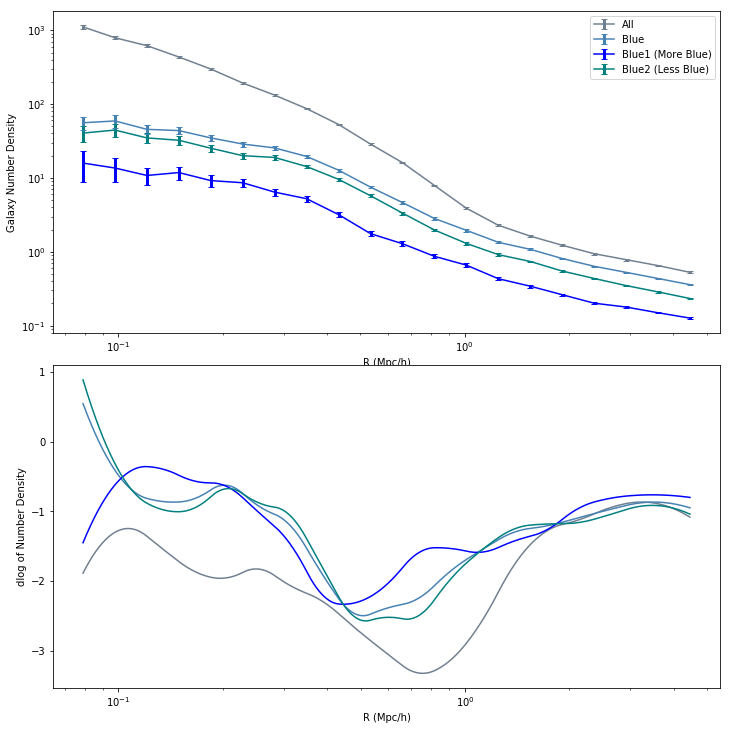

In [29]:
bin_stackB, Yi_avg_listB, cov_listB, boot_err_listB, R_avgB, titleB = MultiProfiles('blues',4, subhalo_table_m, CM_coords,halo_array_masked,'basic','stellarmass')


In [5]:
'''
import corner
t0 = time.time()
profiles = Yi_avg_listB#[Yi_avgB,Yi_avg_blue1B,Yi_avg_blue2B]

#profiles = [Yi_avg_blue1B]

covs = cov_listB#[covB,cov_blue1B,cov_blue2B]
#covs = [cov_blue1B]

init_theta_listB = np.array([[-.92, 0.78, 0.60, -0.2, 0.02, 1.5, .2 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
blue_listB = [False, True, True, True]


#init_theta = np.array([-.92, 0.78, 0.60, 1.5, 0.34, 2, 3 , 1.66])
#[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66]
#bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))
bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (-2, 0.7), (-2, 0.7), (-1, 30), (-1, 30), (.1, 10)) #From color-split

#rho_g_listB = []
#rho_g_listB = [rho_g, rho_g_b, rho_g_b1, rho_g_b2]

best_fit_mcmc_listB, samples_listB, sampler_listB = MCMC(bin_stackB, profiles, covs, rho_g_listB, blue_listB, init_theta_listB, bounds, 20000, 128, 5000)   #10000 
print(time.time()-t0)
'''

'\nimport corner\nt0 = time.time()\nprofiles = Yi_avg_listB#[Yi_avgB,Yi_avg_blue1B,Yi_avg_blue2B]\n\n#profiles = [Yi_avg_blue1B]\n\ncovs = cov_listB#[covB,cov_blue1B,cov_blue2B]\n#covs = [cov_blue1B]\n\ninit_theta_listB = np.array([[-.92, 0.78, 0.60, -0.2, 0.02, 1.5, .2 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34\nblue_listB = [False, True, True, True]\n\n\n#init_theta = np.array([-.92, 0.78, 0.60, 1.5, 0.34, 2, 3 , 1.66])\n#[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66]\n#bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))\nbounds = ((-2, 2),(-1.4, 3), (-1.2,3), (-2, 0.7), (-2, 0.7), (-1, 30), (-1, 30), (.1, 10)) #From color-split\n\n#rho_g_listB = []\n#rho_g_listB = [rho_g, rho_g_b, rho_g_b1, rho_g_b2]\n\nbest_fit_mcmc_listB, samples_listB, sampler_listB = MCMC(bin_stackB, profiles, covs, rho_g_listB, blue

Progress: [------------------->] 100%count 0 = 0, count total = 10000
Progress: [------------------->] 100%count 1 = 418, count total = 10000
Progress: [->                  ] 8%

/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: overflow encountered in power


Progress: [------------------->] 100%count 2 = 313, count total = 10000
Progress: [------------------->] 100%count 3 = 152, count total = 10000


<Figure size 720x576 with 0 Axes>

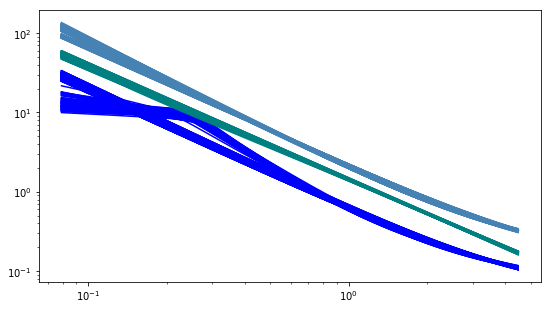

0 1.1425400422616716 0.03893684891458139
1 0.7149993633233842 0.16433825459165624
2 0.6246155233182534 0.17662105946865084
3 0.7979087714433019 0.12212083840621649


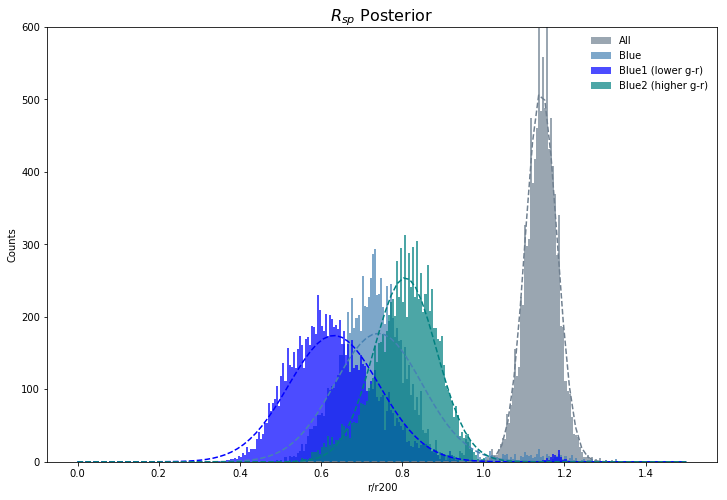

[1.1425400422616716, 0.7413049689173208, 0.6319339607898224, 0.8075971976886479] [0.03893684891458139, 0.10784498638768926, 0.11172668905775768, 0.07731564850099071]


In [36]:
colors = ['slategray','steelblue','blue','teal']
labels = ['All','Blue','Blue1 (lower g-r)','Blue2 (higher g-r)']
rsp_samps_listB = rsp_samp(samples_listB, sampler_listB,bin_stackB,colors,labels)

means_colors, sigs_colors = rsp_dist(rsp_samps_listB, colors, R_avgB)


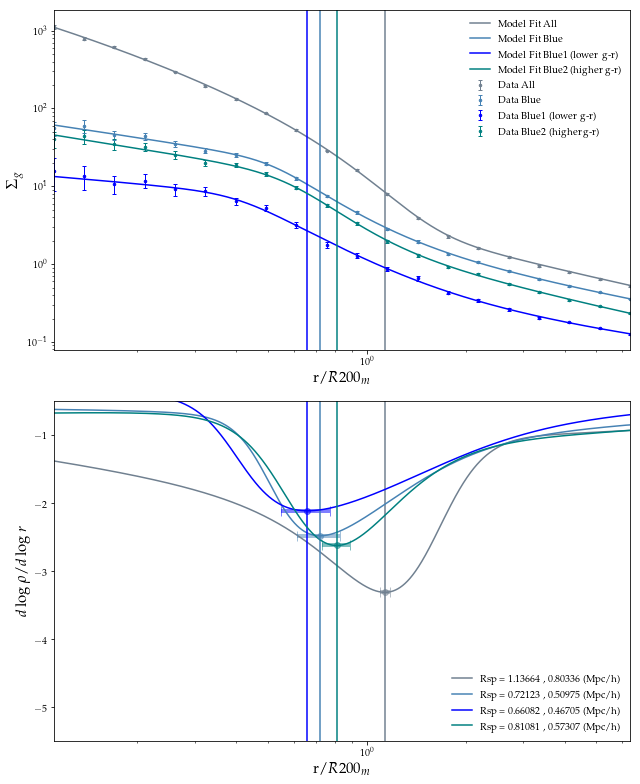

R_avg= 0.7067824398397052


In [60]:
colors = ['slategray','steelblue','blue','teal']
labels = ['All','Blue','Blue1 (lower g-r)','Blue2 (higher g-r)']
ls_list = ['-','-','-','-']
profiles = Yi_avg_listB #[Yi_avgB,Yi_avg_blue1B,Yi_avg_blue2B]
averaged_r_tot = bin_stackB
covs = cov_listB#[covB,cov_blue1B,cov_blue2B]


#profiles = [Yi_avg_blue1B]
#covs = [cov_blue1B]
#colors = ['steelblue']
#labels = ['Blue1 (lower g-r)']
#ls_list = ['-']

r_sp_list = FittedPlots(best_fit_mcmc_listB, profiles, averaged_r_tot, R_avgB, covs,rho_g_listB,sigs_colors,labels, colors, ls_list)


# DYN FRICTION (Diff Methods)


Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 301.58066296577454
R500c, R200c, R200m: 0.7612624597816122 1.24644093717065 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 301.5933880805969
566208 566208 time 301.6259388923645
N Subhalos within 7*R200m: 4517 301.671493768692
galaxies 0 [   8.   21.   28.   34.   31.   59.   71.   83.  122.  129.  103.   76.
   84.   53.  118.  236.  519.  628.  738. 1347.]
galaxies 1 [  5.  10.  15.  24.  20.  31.  29.  27.  57.  55.  40.  29.  34.  19.
  48. 101. 239. 267. 312. 579.]
galaxies 2 [  2.   3.   8.   6.   8.  11.   7.   9.  18.  19.  14.  11.  10.   6.
  12.  37.  80.  91. 104. 183.]

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 301.67906403541565
R500c, R200c, R200m: 0.5860514830407864 0.916949635434108 1.1697442162737657
Rscale 1.1697442162737657
before dev loop: 301.6874806880951
566208 566208 time 301.7057857513428
N Subhalos within 7*R200m: 2089 301.7523410320282
galaxies

N Subhalos within 7*R200m: 1352 302.7395398616791
galaxies 0 [  4.   4.   9.  10.  13.  14.  21.  32.  24.  33.  40.  45.  17.  16.
  25.  62. 252. 223. 140. 356.]
galaxies 1 [  2.   4.   4.   6.   8.   6.  14.  13.   9.  15.  16.  21.   7.   2.
   6.  22. 107.  89.  53. 150.]
galaxies 2 [ 1.  3.  1.  1.  4.  3.  3.  6.  2.  5.  5.  5.  1.  0.  2.  8. 38. 30.
 20. 41.]

Halo: 15
Halo Mass: 25923.64
N Subhalos from Illustris Algorithm: 1930 302.74198293685913
R500c, R200c, R200m: 0.5543512035580016 0.8399260732759634 1.0439992872395611
Rscale 1.0439992872395611
before dev loop: 302.746221780777
566208 566208 time 302.76693987846375
N Subhalos within 7*R200m: 1525 302.80749893188477
galaxies 0 [  6.   5.  10.  29.  21.  19.  25.  23.  38.  47.  33.  36.  37.  21.
  33.  37. 190. 309. 311. 285.]
galaxies 1 [  4.   2.   7.  14.  10.   6.   9.   5.  13.  17.  14.  16.  20.   4.
  16.  14.  82. 143. 113. 107.]
galaxies 2 [ 1.  1.  5.  6.  3.  2.  7.  2.  2.  2.  5.  3.  8.  1.  5.  4. 28. 49

566208 566208 time 303.809091091156
N Subhalos within 7*R200m: 588 303.8540527820587
galaxies 0 [  3.   1.  11.  13.   8.  14.  20.  17.  20.  24.  28.  26.  13.  12.
  10.  22.  58.  70.  90. 126.]
galaxies 1 [ 1.  1.  9.  3.  5.  6. 11. 10.  9.  9.  5.  6.  4.  6.  4. 10. 30. 33.
 39. 44.]
galaxies 2 [ 1.  0.  3.  0.  1.  0.  4.  5.  2.  4.  2.  1.  0.  0.  1.  4.  7.  8.
 13. 17.]

Halo: 31
Halo Mass: 17812.344
N Subhalos from Illustris Algorithm: 1331 303.85881090164185
R500c, R200c, R200m: 0.4590839418951622 0.6922596398244059 0.8449716151863796
Rscale 0.8449716151863796
before dev loop: 303.86569809913635
566208 566208 time 303.8913950920105
N Subhalos within 7*R200m: 768 303.9325177669525
galaxies 0 [  3.   7.   4.   8.   6.   9.  20.  11.  17.  16.  17.  44.  43.  26.
  20.  30.  25.  61. 157. 233.]
galaxies 1 [  1.   4.   2.   5.   4.   6.  11.   6.   9.   9.   5.  14.  16.  11.
  10.   7.   9.  25.  65. 102.]
galaxies 2 [ 0.  2.  0.  2.  1.  2.  2.  2.  2.  3.  1.  1.  6.  3.

N Subhalos within 7*R200m: 577 304.9012930393219
galaxies 0 [  4.   3.   8.  10.   7.   7.  10.  13.  17.  16.  20.  33.  29.  19.
   8.  23.  37.  37.  80. 192.]
galaxies 1 [ 3.  1.  5.  6.  5.  3.  5.  7.  6.  9.  4. 11.  9.  9.  2.  6. 17. 20.
 38. 86.]
galaxies 2 [ 1.  0.  2.  0.  1.  2.  2.  2.  3.  1.  3.  3.  4.  3.  0.  2.  6.  4.
 14. 19.]

Halo: 46
Halo Mass: 14551.992
N Subhalos from Illustris Algorithm: 1044 304.9037461280823
R500c, R200c, R200m: 0.44943243635074304 0.702010991290626 0.8500623960268822
Rscale 0.8500623960268822
before dev loop: 304.90779280662537
566208 566208 time 304.9279718399048
N Subhalos within 7*R200m: 914 304.9680030345917
galaxies 0 [  1.   5.   5.   3.  12.  14.  16.  29.  20.  23.  11.  12.   6.  18.
  21.  43.  99.  70. 195. 305.]
galaxies 1 [  1.   2.   4.   2.   7.   5.   8.  12.  11.  10.   4.   7.   1.   6.
  10.  19.  36.  34.  79. 131.]
galaxies 2 [ 0.  0.  4.  2.  4.  1.  2.  5.  2.  4.  1.  0.  1.  2.  3.  8. 13. 10.
 30. 44.]

Halo: 47


N Subhalos within 7*R200m: 473 305.9702410697937
galaxies 0 [  1.   6.   4.   5.   8.  11.  22.  18.  23.  14.  11.  11.   6.   7.
   9.  14.  17.  56. 110. 112.]
galaxies 1 [ 0.  5.  3.  3.  5.  3. 10. 11.  7.  3.  5.  2.  4.  6.  1.  7.  9. 30.
 46. 44.]
galaxies 2 [ 0.  3.  2.  2.  2.  1.  5.  1.  1.  2.  0.  2.  2.  2.  0.  5.  2. 13.
 17. 18.]

Halo: 62
Halo Mass: 13000.34
N Subhalos from Illustris Algorithm: 1047 305.9726960659027
R500c, R200c, R200m: 0.4069041589001368 0.6331709514128275 0.782193111526722
Rscale 0.782193111526722
before dev loop: 305.97694277763367
566208 566208 time 305.99827003479004
N Subhalos within 7*R200m: 386 306.03675603866577
galaxies 0 [  1.   5.   8.   4.   7.  11.  11.  11.  13.   8.  14.   4.  15.  15.
  10.  10.  21.  37.  68. 108.]
galaxies 1 [ 1.  2.  4.  2.  3.  7.  8.  7.  6.  6.  5.  2.  7.  3.  4.  3.  9. 12.
 29. 51.]
galaxies 2 [ 1.  1.  0.  2.  2.  2.  3.  1.  1.  2.  1.  0.  2.  0.  1.  0.  3.  1.
  8. 19.]

Halo: 63
Halo Mass: 12791.595


before dev loop: 306.8364989757538
566208 566208 time 306.8571209907532
N Subhalos within 7*R200m: 607 306.89625906944275
galaxies 0 [  3.   3.   2.   6.   6.  11.   6.  10.  10.  13.  15.  18.  14.  14.
  17.  47.  62. 103. 131. 114.]
galaxies 1 [ 3.  3.  2.  4.  4.  7.  2.  4.  7.  4.  6.  8.  5.  4.  8. 17. 28. 55.
 63. 46.]
galaxies 2 [ 1.  1.  0.  2.  1.  2.  1.  1.  2.  2.  4.  4.  1.  0.  3.  8. 13. 17.
 24. 10.]

Halo: 76
Halo Mass: 11053.76
N Subhalos from Illustris Algorithm: 749 306.8989198207855
R500c, R200c, R200m: 0.4207121212581975 0.6474206539076773 0.7837246694996244
Rscale 0.7837246694996244
before dev loop: 306.90307092666626
566208 566208 time 306.9234299659729
N Subhalos within 7*R200m: 451 306.9621617794037
galaxies 0 [  3.   5.   2.   3.   5.  11.  19.  13.  19.  16.   8.   5.   7.  11.
  19.  27.  34.  34.  81. 125.]
galaxies 1 [ 2.  2.  1.  3.  2.  5. 10.  7.  5.  5.  1.  0.  2.  3.  7. 12. 15.  8.
 36. 61.]
galaxies 2 [ 2.  0.  0.  2.  1.  2.  2.  3.  2.  2.  

N Subhalos within 7*R200m: 432 307.94943475723267
galaxies 0 [  4.   4.   1.   3.   6.   7.   8.  17.  18.  11.  11.  10.  12.   5.
  12.  28.  34.  62.  59. 114.]
galaxies 1 [ 3.  1.  1.  2.  5.  2.  3.  7.  8.  7.  3.  6.  6.  0.  4. 12. 15. 26.
 24. 51.]
galaxies 2 [ 0.  1.  1.  1.  2.  0.  1.  1.  5.  2.  1.  1.  4.  0.  1.  4.  7.  7.
  8. 12.]

Halo: 92
Halo Mass: 10326.346
N Subhalos from Illustris Algorithm: 947 307.950927734375
R500c, R200c, R200m: 0.36435314188113327 0.5709463243883409 0.7234369492685032
Rscale 0.7234369492685032
before dev loop: 307.9552776813507
566208 566208 time 307.9762167930603
N Subhalos within 7*R200m: 932 308.0145409107208
galaxies 0 [  2.   0.   1.   2.   3.   5.   9.   8.  14.  21.  21.  18.  15.  21.
  22.  10.  31. 117. 189. 415.]
galaxies 1 [  2.   0.   1.   1.   1.   1.   4.   4.   6.  10.   6.   6.   6.  11.
  10.   5.  10.  52.  89. 194.]
galaxies 2 [ 1.  0.  1.  0.  0.  0.  2.  0.  1.  3.  1.  2.  4.  3.  4.  0.  2. 23.
 35. 54.]

Halo: 93
H

566208 566208 time 308.8291609287262
N Subhalos within 7*R200m: 713 308.8675558567047
galaxies 0 [  1.   1.   2.   5.   5.   4.  12.  11.  17.  22.  21.  22.   7.  13.
  25.  46.  73. 123. 108. 191.]
galaxies 1 [ 1.  1.  1.  2.  3.  2.  5.  5. 10.  8.  6.  6.  4.  4.  8. 23. 32. 56.
 41. 78.]
galaxies 2 [ 1.  1.  0.  1.  0.  1.  1.  1.  5.  2.  1.  0.  3.  2.  1.  7.  9. 24.
  5. 29.]

Halo: 106
Halo Mass: 9582.273
N Subhalos from Illustris Algorithm: 627 308.8702619075775
R500c, R200c, R200m: 0.409483058156213 0.6119061321018505 0.7454023314445947
Rscale 0.7454023314445947
before dev loop: 308.8744888305664
566208 566208 time 308.8960268497467
N Subhalos within 7*R200m: 289 308.9345910549164
galaxies 0 [ 3.  1.  1.  6.  7.  6. 10.  8. 11.  7.  5. 10. 11.  3. 10. 15. 21. 37.
 38. 75.]
galaxies 1 [ 1.  1.  0.  5.  5.  1.  5.  4.  6.  2.  2.  1.  4.  1.  4.  5.  7. 18.
 17. 30.]
galaxies 2 [1. 1. 0. 2. 0. 0. 1. 1. 1. 0. 0. 0. 3. 0. 1. 1. 2. 8. 6. 9.]

Halo: 107
Halo Mass: 9395.793
N Subh

before dev loop: 309.88449883461
566208 566208 time 309.9049868583679
N Subhalos within 7*R200m: 402 309.94348788261414
galaxies 0 [ 4.  1.  3.  4.  2.  7.  6.  6.  9. 13. 23. 10. 14. 12. 15. 32. 25. 76.
 62. 73.]
galaxies 1 [ 4.  1.  2.  1.  1.  4.  2.  3.  3.  4.  9.  5.  8.  3. 10. 16. 14. 41.
 28. 23.]
galaxies 2 [ 0.  1.  1.  1.  0.  3.  1.  0.  1.  1.  2.  1.  2.  0.  3.  6.  1. 12.
 12.  9.]

Halo: 123
Halo Mass: 9079.802
N Subhalos from Illustris Algorithm: 753 309.94525384902954
R500c, R200c, R200m: 0.3533611227659105 0.5591400045315655 0.715194416206788
Rscale 0.715194416206788
before dev loop: 309.94967699050903
566208 566208 time 309.97036600112915
N Subhalos within 7*R200m: 356 310.00918769836426
galaxies 0 [  3.   2.   1.   4.   6.   4.   8.   8.  18.   7.  18.  13.  11.   5.
   5.  42.  27.  21.  44. 103.]
galaxies 1 [ 2.  2.  1.  1.  3.  1.  5.  3. 11.  0. 10.  3.  3.  3.  2. 19.  9. 10.
 19. 50.]
galaxies 2 [ 1.  2.  0.  1.  3.  0.  1.  1.  3.  0.  1.  0.  0.  1.  0.  

before dev loop: 310.9426648616791
566208 566208 time 310.9639868736267
N Subhalos within 7*R200m: 418 311.0017249584198
galaxies 0 [  1.   1.   5.   4.   4.   9.   6.   8.  12.  21.  16.   6.   6.  16.
  13.  31.  32.  53.  70. 101.]
galaxies 1 [ 1.  1.  3.  2.  2.  4.  3.  3.  7.  7.  6.  3.  3.  4.  4. 14. 14. 24.
 34. 40.]
galaxies 2 [ 0.  0.  0.  0.  1.  1.  0.  2.  4.  2.  3.  1.  1.  2.  1. 10.  7. 11.
  9. 11.]

Halo: 141
Halo Mass: 8617.786
N Subhalos from Illustris Algorithm: 608 311.0031678676605
R500c, R200c, R200m: 0.3631599951259469 0.5389215256424773 0.665320577578168
Rscale 0.665320577578168
before dev loop: 311.0072157382965
566208 566208 time 311.0278100967407
N Subhalos within 7*R200m: 244 311.0653200149536
galaxies 0 [ 2.  0.  1.  2.  2.  3.  9.  8.  4.  7.  9.  9. 17. 19. 18. 16.  9. 25.
 37. 45.]
galaxies 1 [ 2.  0.  1.  2.  2.  1.  3.  1.  2.  4.  5.  5.  3. 11.  9.  6.  3.  9.
 17. 20.]
galaxies 2 [0. 0. 1. 1. 0. 0. 1. 0. 1. 2. 3. 2. 0. 4. 4. 3. 1. 2. 6. 4.]

Ha

N Subhalos within 7*R200m: 359 312.0326819419861
galaxies 0 [ 0.  0.  1.  2.  4.  5.  4.  7.  9. 11.  9. 16. 20. 18. 11. 17. 35. 42.
 52. 94.]
galaxies 1 [ 0.  0.  0.  1.  3.  2.  3.  2.  3.  2.  3.  6.  9. 10.  7. 10. 20. 15.
 26. 36.]
galaxies 2 [ 0.  0.  0.  0.  3.  0.  0.  1.  1.  0.  1.  3.  4.  3.  5.  1.  5.  4.
 11. 11.]

Halo: 159
Halo Mass: 8084.0312
N Subhalos from Illustris Algorithm: 588 312.0345368385315
R500c, R200c, R200m: 0.3891170523137019 0.5873126082944562 0.706823292487164
Rscale 0.706823292487164
before dev loop: 312.0386128425598
566208 566208 time 312.0593328475952
N Subhalos within 7*R200m: 342 312.09677171707153
galaxies 0 [ 4.  2.  2.  6.  4.  3. 15. 11. 10. 12.  8.  4. 10.  7. 13. 14. 33. 46.
 51. 84.]
galaxies 1 [ 3.  0.  0.  3.  1.  0.  8.  5.  5.  4.  1.  1.  4.  2.  3.  6. 10. 25.
 23. 38.]
galaxies 2 [2. 0. 0. 0. 1. 0. 6. 3. 2. 3. 0. 0. 0. 0. 0. 1. 2. 8. 4. 9.]

Halo: 160
Halo Mass: 7919.1826
N Subhalos from Illustris Algorithm: 555 312.09818983078003
R

N Subhalos within 7*R200m: 373 312.91724705696106
galaxies 0 [  0.   1.   4.   0.   1.   4.   2.   2.  17.  10.   9.  10.   5.  16.
  11.  19.  18.  23.  93. 124.]
galaxies 1 [ 0.  1.  2.  0.  1.  3.  2.  2.  8.  5.  3.  3.  1.  8.  5.  7.  9.  8.
 44. 45.]
galaxies 2 [ 0.  1.  0.  0.  0.  2.  1.  0.  3.  1.  1.  2.  0.  4.  2.  3.  4.  3.
 14. 15.]

Halo: 174
Halo Mass: 7402.9487
N Subhalos from Illustris Algorithm: 673 312.9186089038849
R500c, R200c, R200m: 0.3185681618949594 0.4925385710729112 0.6168368552056408
Rscale 0.6168368552056408
before dev loop: 312.9227011203766
566208 566208 time 312.94360280036926
N Subhalos within 7*R200m: 597 312.9814610481262
galaxies 0 [  1.   0.   1.   3.   2.   6.   4.   7.   6.   8.  10.  21.  33.  30.
  38.  24.  88. 154.  71.  82.]
galaxies 1 [ 1.  0.  1.  1.  2.  1.  1.  4.  3.  2.  0.  9. 10. 13. 18.  8. 37. 74.
 20. 40.]
galaxies 2 [ 0.  0.  0.  0.  0.  1.  0.  1.  2.  2.  0.  2.  4.  6.  6.  1. 10. 28.
  9. 10.]

Halo: 175
Halo Mass: 7307.71

N Subhalos within 7*R200m: 200 313.818883895874
galaxies 0 [ 3.  2.  2.  5.  7.  5.  6. 11. 10. 10.  5.  4.  7.  3. 10. 10. 14. 18.
 27. 35.]
galaxies 1 [ 2.  1.  1.  1.  4.  2.  2.  1.  5.  7.  2.  0.  5.  2.  5.  4.  4.  5.
 11. 16.]
galaxies 2 [0. 0. 0. 1. 2. 0. 0. 0. 2. 1. 0. 0. 1. 0. 2. 2. 2. 1. 3. 3.]

Halo: 191
Halo Mass: 7042.9897
N Subhalos from Illustris Algorithm: 570 313.8202760219574
R500c, R200c, R200m: 0.33705493057135216 0.5325804688846353 0.6522088943989216
Rscale 0.6522088943989216
before dev loop: 313.8248257637024
566208 566208 time 313.8453149795532
N Subhalos within 7*R200m: 239 313.88263487815857
galaxies 0 [ 1.  4.  2.  3.  2.  3.  6. 12. 12.  8.  5.  9.  4.  6. 13. 19. 13. 22.
 42. 50.]
galaxies 1 [ 1.  4.  0.  1.  1.  3.  3.  8.  5.  6.  4.  3.  1.  4.  6.  8.  3.  9.
 19. 20.]
galaxies 2 [1. 2. 0. 0. 0. 1. 1. 3. 0. 1. 2. 1. 1. 1. 2. 3. 2. 3. 7. 5.]

Halo: 192
Halo Mass: 6880.6846
N Subhalos from Illustris Algorithm: 510 313.88409399986267
R500c, R200c, R200m:

N Subhalos within 7*R200m: 224 314.7094039916992
galaxies 0 [ 0.  2.  2.  4.  4.  5. 12.  5.  8.  9.  6.  9.  6. 12. 12. 10. 12. 18.
 31. 54.]
galaxies 1 [ 0.  2.  1.  2.  3.  0.  4.  1.  5.  3.  4.  2.  1.  7.  6.  3.  7.  5.
 18. 22.]
galaxies 2 [0. 2. 1. 1. 1. 0. 1. 0. 0. 0. 2. 1. 0. 3. 4. 1. 3. 1. 2. 8.]

Halo: 209
Halo Mass: 6508.1846
N Subhalos from Illustris Algorithm: 523 314.71079993247986
R500c, R200c, R200m: 0.3555031660882688 0.5365006824005432 0.6607603332876681
Rscale 0.6607603332876681
before dev loop: 314.71494698524475
566208 566208 time 314.735634803772
N Subhalos within 7*R200m: 188 314.77327370643616
galaxies 0 [ 1.  2.  5.  5.  6.  6.  4. 14.  9.  9. 10.  5.  8.  3.  7.  8. 14. 16.
 19. 33.]
galaxies 1 [ 1.  1.  3.  3.  2.  4.  3.  5.  1.  4.  4.  3.  2.  0.  1.  1.  4.  3.
  7. 11.]
galaxies 2 [0. 0. 1. 2. 0. 1. 2. 1. 0. 1. 0. 2. 0. 0. 0. 0. 0. 2. 0. 2.]

Halo: 210
Halo Mass: 6658.897
N Subhalos from Illustris Algorithm: 599 314.77553367614746
R500c, R200c, R200m:

566208 566208 time 315.58368372917175
N Subhalos within 7*R200m: 308 315.6215748786926
galaxies 0 [ 1.  3.  2.  2.  3.  5.  4.  4.  4.  8. 12. 12. 12.  6.  8. 19. 37. 38.
 63. 58.]
galaxies 1 [ 0.  1.  2.  1.  1.  3.  1.  1.  2.  6.  2.  3.  6.  4.  1. 12. 18. 13.
 37. 23.]
galaxies 2 [ 0.  0.  1.  1.  1.  1.  1.  0.  1.  3.  2.  0.  0.  1.  0.  5. 10.  1.
  9.  4.]

Halo: 225
Halo Mass: 6161.1543
N Subhalos from Illustris Algorithm: 546 315.62373185157776
R500c, R200c, R200m: 0.3010629178636327 0.47783940179215134 0.6086834788672018
Rscale 0.6086834788672018
before dev loop: 315.627681016922
566208 566208 time 315.6483368873596
N Subhalos within 7*R200m: 269 315.6887888908386
galaxies 0 [ 0.  4.  0.  1.  5.  4.  3.  4.  7.  6. 10. 13.  8.  1. 16. 17. 15. 39.
 60. 54.]
galaxies 1 [ 0.  4.  0.  1.  1.  0.  1.  4.  5.  4.  5.  6.  7.  0.  7. 10.  6. 19.
 31. 13.]
galaxies 2 [ 0.  3.  0.  1.  0.  0.  1.  2.  3.  2.  3.  3.  1.  0.  3.  4.  2.  6.
 12.  7.]

Halo: 226
Halo Mass: 6017.781
N

566208 566208 time 316.6716318130493
N Subhalos within 7*R200m: 193 316.70827078819275
galaxies 0 [ 0.  2.  2.  4.  1.  3.  9.  4. 12. 11.  6.  1.  3.  5.  7.  8. 14. 13.
 31. 54.]
galaxies 1 [ 0.  1.  2.  1.  0.  2.  5.  3.  2.  2.  2.  1.  2.  1.  1.  3.  7.  4.
 12. 17.]
galaxies 2 [ 0.  1.  0.  0.  0.  1.  3.  0.  1.  1.  0.  0.  0.  0.  1.  1.  4.  0.
  6. 10.]

Halo: 247
Halo Mass: 5637.5234
N Subhalos from Illustris Algorithm: 445 316.7096209526062
R500c, R200c, R200m: 0.3296730381286894 0.5019103959398237 0.6218595774787569
Rscale 0.6218595774787569
before dev loop: 316.71414589881897
566208 566208 time 316.7350027561188
N Subhalos within 7*R200m: 299 316.77174186706543
galaxies 0 [ 2.  2.  3.  4.  3.  4.  7.  4.  7.  9.  8. 12. 11. 12. 10. 13. 36. 28.
 55. 66.]
galaxies 1 [ 2.  2.  2.  2.  1.  2.  4.  2.  1.  4.  2.  5.  2.  4.  4.  7. 20. 13.
 25. 26.]
galaxies 2 [ 1.  1.  0.  0.  1.  1.  1.  0.  0.  2.  1.  2.  1.  0.  1.  1.  7.  1.
 11.  7.]

Halo: 248
Halo Mass: 5912.9204

before dev loop: 317.5381157398224
566208 566208 time 317.55910301208496
N Subhalos within 7*R200m: 311 317.59632205963135
galaxies 0 [ 2.  0.  3.  3.  4.  1.  2. 10.  7.  9.  5.  3.  8.  8. 11. 27. 28. 32.
 63. 82.]
galaxies 1 [ 1.  0.  0.  2.  2.  1.  1.  4.  4.  5.  0.  1.  3.  3.  3. 11. 17.  8.
 28. 31.]
galaxies 2 [1. 0. 0. 0. 0. 0. 0. 2. 0. 3. 0. 0. 2. 0. 1. 5. 6. 4. 9. 9.]

Halo: 266
Halo Mass: 5678.0728
N Subhalos from Illustris Algorithm: 463 317.5977599620819
R500c, R200c, R200m: 0.2737970543905859 0.4370054623938552 0.6025881535720761
Rscale 0.6025881535720761
before dev loop: 317.60181188583374
566208 566208 time 317.6214118003845
N Subhalos within 7*R200m: 400 317.6587851047516
galaxies 0 [  1.   1.   0.   2.   2.   4.   1.   2.   6.   8.  17.  17.   5.   6.
  15.   9.  34.  51.  48. 168.]
galaxies 1 [ 0.  0.  0.  1.  1.  1.  0.  0.  1.  6.  8.  6.  1.  2.  5.  2. 13. 23.
 18. 80.]
galaxies 2 [ 0.  0.  0.  0.  0.  1.  0.  0.  0.  2.  3.  2.  0.  1.  2.  1.  4. 10.
  7. 32

566208 566208 time 318.6348628997803
N Subhalos within 7*R200m: 353 318.67218589782715
galaxies 0 [ 0.  0.  2.  2.  4. 10.  8.  3.  9.  4.  9.  5. 13.  3. 16. 20. 63. 40.
 60. 81.]
galaxies 1 [ 0.  0.  1.  2.  2.  5.  6.  2.  4.  0.  2.  2.  9.  2.  8.  7. 25. 11.
 32. 29.]
galaxies 2 [ 0.  0.  1.  0.  2.  3.  1.  0.  1.  0.  1.  0.  4.  1.  3.  3.  9.  4.
 12.  8.]

Halo: 287
Halo Mass: 5378.2646
N Subhalos from Illustris Algorithm: 462 318.67405700683594
R500c, R200c, R200m: 0.3080054722365906 0.47901721535245007 0.5991632462889356
Rscale 0.5991632462889356
before dev loop: 318.67819690704346
566208 566208 time 318.6987199783325
N Subhalos within 7*R200m: 290 318.73536801338196
galaxies 0 [ 1.  0.  2.  3.  3.  3.  5.  4.  5.  9.  7.  3.  8.  1.  8.  9. 12. 60.
 47. 97.]
galaxies 1 [ 1.  0.  1.  1.  2.  1.  1.  1.  3.  3.  2.  0.  5.  0.  3.  4.  5. 23.
 19. 46.]
galaxies 2 [ 1.  0.  0.  1.  0.  1.  1.  0.  0.  0.  1.  0.  3.  0.  2.  2.  1.  8.
  4. 20.]

Halo: 289
Halo Mass: 5268.21

566208 566208 time 319.5152659416199
N Subhalos within 7*R200m: 338 319.5520009994507
galaxies 0 [  0.   2.   2.   2.   2.   6.   4.   7.   4.   3.   9.   9.   8.   9.
  10.  10.  31.  50.  58. 109.]
galaxies 1 [ 0.  2.  1.  0.  1.  4.  2.  5.  2.  1.  2.  4.  1.  2.  6.  5. 13. 27.
 23. 57.]
galaxies 2 [ 0.  0.  1.  0.  0.  0.  0.  1.  1.  1.  0.  2.  0.  1.  2.  1.  5. 12.
  8. 13.]

Halo: 309
Halo Mass: 5126.7944
N Subhalos from Illustris Algorithm: 337 319.554438829422
R500c, R200c, R200m: 0.32850757519664875 0.506117696506748 0.6120615458422
Rscale 0.6120615458422
before dev loop: 319.55870175361633
566208 566208 time 319.578999042511
N Subhalos within 7*R200m: 322 319.6159658432007
galaxies 0 [ 0.  1.  4.  1.  5.  5.  4.  4. 13.  4.  3.  4.  6.  2.  5. 10. 18. 48.
 88. 93.]
galaxies 1 [ 0.  0.  2.  0.  3.  1.  2.  3.  3.  3.  1.  2.  3.  0.  2.  5.  9. 25.
 38. 45.]
galaxies 2 [ 0.  0.  0.  0.  1.  1.  1.  2.  1.  0.  0.  0.  1.  0.  1.  1.  2.  9.
 12. 12.]

Halo: 310
Halo Mass:

566208 566208 time 320.41088795661926
N Subhalos within 7*R200m: 295 320.4483127593994
galaxies 0 [ 0.  1.  4.  6.  4.  1.  9.  6.  7. 11. 11.  2.  7. 17. 14. 12. 20. 34.
 37. 91.]
galaxies 1 [ 0.  0.  4.  2.  2.  1.  4.  5.  1.  3.  5.  1.  2.  8.  9.  3.  8. 13.
 18. 42.]
galaxies 2 [ 0.  0.  2.  0.  2.  1.  2.  2.  0.  2.  1.  0.  1.  4.  0.  1.  1.  1.
  8. 15.]

Halo: 330
Halo Mass: 4934.81
N Subhalos from Illustris Algorithm: 468 320.45066809654236
R500c, R200c, R200m: 0.30504586536489026 0.4681591114771729 0.584298814792781
Rscale 0.584298814792781
before dev loop: 320.45491003990173
566208 566208 time 320.47612500190735
N Subhalos within 7*R200m: 323 320.5129590034485
galaxies 0 [ 2.  2.  4.  4.  3.  4.  5.  5.  5.  7. 11.  5.  5.  7. 16.  7. 26. 50.
 60. 94.]
galaxies 1 [ 1.  1.  3.  1.  2.  1.  0.  3.  3.  2.  5.  3.  1.  1. 10.  3. 10. 26.
 28. 33.]
galaxies 2 [0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 2. 1. 0. 4. 0. 5. 6. 7. 9.]

Halo: 333
Halo Mass: 4809.46
N Subhalos from Illustri

N Subhalos within 7*R200m: 211 321.52177691459656
galaxies 0 [ 2.  2.  1.  1.  3.  2.  5.  4.  6.  4.  6.  5.  3.  8.  8. 16. 17. 18.
 24. 71.]
galaxies 1 [ 1.  2.  0.  0.  3.  0.  3.  2.  4.  4.  2.  4.  1.  3.  5.  7. 11.  7.
 10. 33.]
galaxies 2 [ 1.  1.  0.  0.  0.  0.  1.  0.  1.  0.  1.  1.  0.  2.  2.  1.  3.  2.
  4. 13.]

Halo: 363
Halo Mass: 4563.262
N Subhalos from Illustris Algorithm: 343 321.52313804626465
R500c, R200c, R200m: 0.31622792802092675 0.4722260112230241 0.5846765798762269
Rscale 0.5846765798762269
before dev loop: 321.5272948741913
566208 566208 time 321.5483977794647
N Subhalos within 7*R200m: 167 321.5847508907318
galaxies 0 [ 2.  3.  1.  1.  5.  3.  6.  5.  1.  6.  6. 11.  2.  3.  5. 19. 14. 18.
 17. 34.]
galaxies 1 [ 2.  1.  1.  1.  4.  2.  5.  3.  1.  3.  3.  3.  1.  1.  3. 11.  4.  9.
  5. 17.]
galaxies 2 [1. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 0. 1. 3. 1. 3. 0. 5.]

Halo: 368
Halo Mass: 4699.356
N Subhalos from Illustris Algorithm: 381 321.58611583709717

/Users/TaraD/anaconda3/lib/python3.7/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))
/Users/TaraD/anaconda3/lib/python3.7/site-packages/scipy/signal/_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


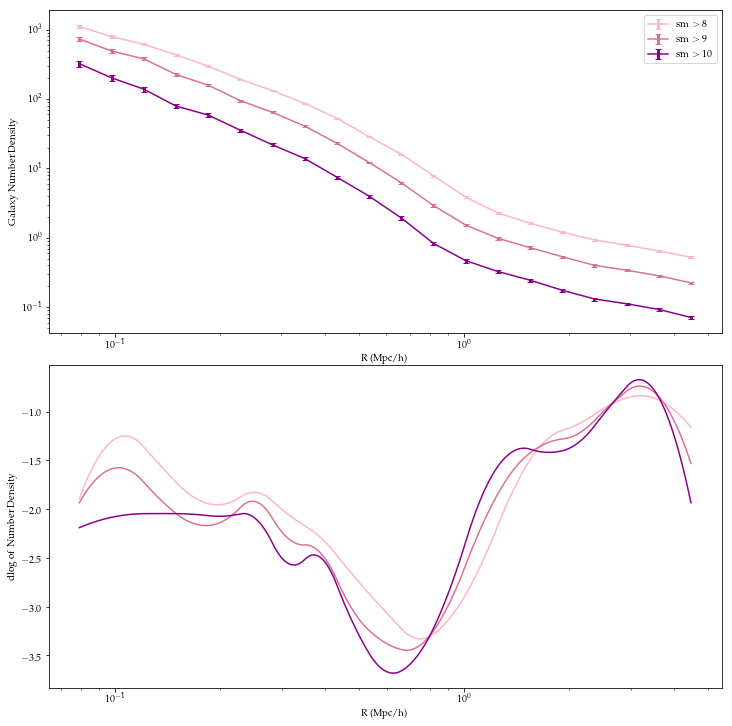

In [21]:
bin_stack_sm, Yi_avg_list_sm, cov_list_sm, boot_err_list_sm, R_avg_sm, title_sm = MultiProfiles('sm',3, subhalo_table_m, CM_coords,halo_array_masked,'basic','stellarmass')



Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 255744.389742136
R500c, R200c, R200m: 0.7612624597816122 1.24644093717065 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 255744.40024495125
566208 566208 time 255744.4215772152
N Subhalos within 7*R200m: 4517 255744.46968102455
galaxies 0 [  2.   3.  10.   9.  10.  14.  13.  13.  27.  27.  19.  14.  20.  11.
  30.  63. 124. 140. 194. 316.]
galaxies 1 [  1.   3.   8.   3.   8.   8.   6.   6.  15.  14.  10.   7.   9.   6.
  10.  35.  70.  78.  98. 170.]
galaxies 2 [ 0.  2.  3.  2.  3.  1.  1.  1.  4.  1.  2.  0.  1.  0.  1.  9. 14. 10.
 16. 28.]

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 255744.4728732109
R500c, R200c, R200m: 0.5860514830407864 0.916949635434108 1.1697442162737657
Rscale 1.1697442162737657
before dev loop: 255744.48053908348
566208 566208 time 255744.5010111332
N Subhalos within 7*R200m: 2089 255744.5455610752
galaxies 0 [  1.   5.   9.   2.   6.   4.   7. 

N Subhalos within 7*R200m: 1352 255745.5309920311
galaxies 0 [ 1.  3.  2.  1.  4.  4.  4.  7.  4.  6.  7.  8.  2.  1.  5. 13. 58. 48.
 37. 89.]
galaxies 1 [ 1.  3.  1.  1.  4.  3.  3.  3.  1.  5.  3.  5.  1.  0.  2.  6. 31. 28.
 21. 39.]
galaxies 2 [0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 8. 4. 2. 7.]

Halo: 15
Halo Mass: 25923.64
N Subhalos from Illustris Algorithm: 1930 255745.53357315063
R500c, R200c, R200m: 0.5543512035580016 0.8399260732759634 1.0439992872395611
Rscale 1.0439992872395611
before dev loop: 255745.53771305084
566208 566208 time 255745.55744099617
N Subhalos within 7*R200m: 1525 255745.59949111938
galaxies 0 [ 2.  1.  6.  6.  3.  3.  7.  2.  4.  7. 10.  9. 10.  3.  9.  7. 45. 67.
 59. 63.]
galaxies 1 [ 1.  1.  4.  6.  2.  1.  6.  2.  1.  2.  5.  3.  5.  1.  3.  4. 25. 44.
 30. 35.]
galaxies 2 [0. 0. 0. 3. 1. 0. 0. 0. 0. 1. 2. 0. 2. 0. 0. 0. 3. 9. 5. 4.]

Halo: 16
Halo Mass: 24286.85
N Subhalos from Illustris Algorithm: 1685 255745.6039469242
R500c, R200c, R200

N Subhalos within 7*R200m: 762 255746.57484006882
galaxies 0 [ 0.  1.  3.  0.  0.  1.  0.  2.  3.  0.  3.  3.  4.  9. 14.  8. 17. 17.
 40. 48.]
galaxies 1 [ 0.  1.  3.  0.  0.  1.  0.  2.  2.  0.  1.  2.  2.  6.  5.  5.  8.  7.
 23. 23.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 3. 5. 4.]

Halo: 30
Halo Mass: 17775.602
N Subhalos from Illustris Algorithm: 1246 255746.57797122002
R500c, R200c, R200m: 0.49212849818718246 0.7397235245818736 0.9071572886896503
Rscale 0.9071572886896503
before dev loop: 255746.58214592934
566208 566208 time 255746.6031551361
N Subhalos within 7*R200m: 588 255746.64141893387
galaxies 0 [ 1.  0.  4.  0.  1.  0.  4.  5.  2.  6.  3.  2.  2.  3.  3.  7. 17. 19.
 28. 29.]
galaxies 1 [ 1.  0.  2.  0.  1.  0.  3.  4.  2.  4.  1.  1.  0.  0.  1.  4.  6.  7.
 12. 15.]
galaxies 2 [0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 3.]

Halo: 31
Halo Mass: 17812.344
N Subhalos from Illustris Algorithm: 1331 255746.6438949108
R500c, R200c, R20

N Subhalos within 7*R200m: 479 255747.6022450924
galaxies 0 [ 1.  1.  1.  2.  3.  2.  2.  0.  6.  2.  5.  5.  3.  1.  6.  5.  8.  6.
 25. 22.]
galaxies 1 [ 1.  1.  0.  0.  3.  2.  1.  0.  3.  1.  4.  4.  1.  0.  3.  3.  3.  3.
  9. 14.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 2. 2.]

Halo: 45
Halo Mass: 14590.398
N Subhalos from Illustris Algorithm: 1159 255747.60363793373
R500c, R200c, R200m: 0.4273328987279976 0.6585129593236665 0.8233019274683564
Rscale 0.8233019274683564
before dev loop: 255747.61391997337
566208 566208 time 255747.63540387154
N Subhalos within 7*R200m: 577 255747.67644619942
galaxies 0 [ 2.  0.  3.  1.  2.  2.  3.  3.  3.  3.  3.  6.  6.  6.  1.  3. 13.  9.
 26. 41.]
galaxies 1 [ 1.  0.  2.  0.  1.  2.  1.  2.  1.  1.  3.  3.  4.  3.  0.  2.  6.  4.
 13. 14.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 3. 4.]

Halo: 46
Halo Mass: 14551.992
N Subhalos from Illustris Algorithm: 1044 255747.67867302895
R500c, R200c, R20

566208 566208 time 255748.65343999863
N Subhalos within 7*R200m: 755 255748.69202804565
galaxies 0 [ 1.  0.  1.  1.  3.  1.  3.  1.  1.  2.  2.  5.  2.  4.  3.  7.  7. 28.
 30. 62.]
galaxies 1 [ 1.  0.  1.  1.  1.  0.  2.  1.  1.  1.  2.  4.  2.  1.  2.  5.  3. 17.
 21. 33.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 4. 2. 6.]

Halo: 61
Halo Mass: 12851.317
N Subhalos from Illustris Algorithm: 940 255748.69492292404
R500c, R200c, R200m: 0.44482178868592587 0.6774657890660761 0.8176854942809225
Rscale 0.8176854942809225
before dev loop: 255748.6997768879
566208 566208 time 255748.72079706192
N Subhalos within 7*R200m: 473 255748.75882697105
galaxies 0 [ 0.  3.  2.  2.  2.  1.  6.  4.  2.  2.  2.  2.  2.  3.  0.  7.  6. 23.
 29. 31.]
galaxies 1 [ 0.  3.  1.  2.  2.  1.  5.  1.  1.  2.  0.  1.  2.  2.  0.  5.  3.  9.
 17. 17.]
galaxies 2 [0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 2. 1. 2.]

Halo: 62
Halo Mass: 13000.34
N Subhalos from Illustris Algorithm: 1047

N Subhalos within 7*R200m: 395 255749.78280997276
galaxies 0 [ 0.  0.  0.  0.  0.  0.  2.  1.  2.  1.  6.  2.  2.  2.  2.  6.  8.  9.
 27. 32.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  2.  1.  1.  0.  5.  1.  0.  1.  1.  2.  3.  2.
 14. 17.]
galaxies 2 [0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 2. 0.]

Halo: 78
Halo Mass: 11066.363
N Subhalos from Illustris Algorithm: 995 255749.78416395187
R500c, R200c, R200m: 0.3372438131130751 0.5315203966459151 0.6709240396033471
Rscale 0.6709240396033471
before dev loop: 255749.78823709488
566208 566208 time 255749.8091480732
N Subhalos within 7*R200m: 441 255749.84610915184
galaxies 0 [ 0.  0.  1.  0.  1.  1.  0.  0.  5.  2.  2.  9.  7.  5. 13.  5.  6. 15.
 21. 39.]
galaxies 1 [ 0.  0.  1.  0.  1.  0.  0.  0.  2.  0.  2.  6.  3.  3.  7.  2.  3.  8.
  9. 22.]
galaxies 2 [0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 2. 0. 2.]

Halo: 79
Halo Mass: 10952.339
N Subhalos from Illustris Algorithm: 883 255749.84753918648
R500c, R200c, R200m

566208 566208 time 255750.89177584648
N Subhalos within 7*R200m: 392 255750.92930912971
galaxies 0 [ 2.  1.  1.  0.  3.  1.  4.  3.  2.  2.  5.  1.  3.  0.  2.  7.  7. 16.
 24. 24.]
galaxies 1 [ 1.  1.  0.  0.  2.  1.  3.  2.  2.  2.  2.  0.  1.  0.  1.  2.  4.  9.
 11. 16.]
galaxies 2 [1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 2. 3.]

Halo: 96
Halo Mass: 10355.052
N Subhalos from Illustris Algorithm: 803 255750.93073701859
R500c, R200c, R200m: 0.38060488722178243 0.5781708614197612 0.7136957665529395
Rscale 0.7136957665529395
before dev loop: 255750.9352390766
566208 566208 time 255750.95672893524
N Subhalos within 7*R200m: 507 255750.99395799637
galaxies 0 [ 0.  1.  0.  1.  1.  1.  3.  2.  1.  1.  3.  3.  7.  6.  6.  9. 14. 31.
 19. 27.]
galaxies 1 [ 0.  1.  0.  0.  0.  0.  2.  1.  0.  0.  2.  3.  3.  2.  4.  4.  5. 16.
 12.  9.]
galaxies 2 [0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 2. 3. 2. 1.]

Halo: 97
Halo Mass: 10113.485
N Subhalos from Illustris Algorithm: 705

N Subhalos within 7*R200m: 374 255751.9981842041
galaxies 0 [ 0.  0.  0.  1.  0.  1.  2.  3.  2.  1.  1.  1.  4.  3.  4. 13. 15.  9.
 23. 22.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  1.  2.  1.  0.  0.  1.  2.  1.  3.  8.  8.  7.
 10. 12.]
galaxies 2 [0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 2. 0. 3. 2. 2.]

Halo: 113
Halo Mass: 9353.096
N Subhalos from Illustris Algorithm: 720 255751.99952101707
R500c, R200c, R200m: 0.3717452230916783 0.5889004547060323 0.7217228341971997
Rscale 0.7217228341971997
before dev loop: 255752.00344586372
566208 566208 time 255752.02489709854
N Subhalos within 7*R200m: 477 255752.062541008
galaxies 0 [ 0.  1.  2.  0.  2.  0.  2.  3.  5.  1.  2.  1.  4.  6.  3.  6.  6.  6.
 36. 30.]
galaxies 1 [ 0.  1.  2.  0.  0.  0.  1.  3.  5.  1.  1.  1.  3.  5.  1.  2.  3.  2.
 21. 15.]
galaxies 2 [0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 4. 2.]

Halo: 114
Halo Mass: 9329.943
N Subhalos from Illustris Algorithm: 820 255752.06393527985
R500c, R200c, R200m: 

566208 566208 time 255753.10395789146
N Subhalos within 7*R200m: 331 255753.14077305794
galaxies 0 [ 1.  1.  0.  1.  0.  1.  2.  1.  1.  3.  0.  1.  0.  1.  5. 12.  4. 11.
  8. 32.]
galaxies 1 [ 1.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  2.  9.  3.  4.
  5. 12.]
galaxies 2 [0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 3.]

Halo: 131
Halo Mass: 8610.865
N Subhalos from Illustris Algorithm: 620 255753.14210915565
R500c, R200c, R200m: 0.3800983313081706 0.5802232676054265 0.7170685890148039
Rscale 0.7170685890148039
before dev loop: 255753.14619112015
566208 566208 time 255753.1660540104
N Subhalos within 7*R200m: 367 255753.20303821564
galaxies 0 [ 0.  1.  1.  1.  0.  0.  1.  1.  2.  0.  1.  1.  4.  1.  2.  9.  7. 11.
 20. 29.]
galaxies 1 [ 0.  0.  1.  1.  0.  0.  1.  0.  2.  0.  1.  0.  3.  1.  0.  4.  4.  4.
 11. 11.]
galaxies 2 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 2.]

Halo: 132
Halo Mass: 8506.837
N Subhalos from Illustris Algorithm: 660 

N Subhalos within 7*R200m: 250 255754.2107949257
galaxies 0 [ 1.  1.  0.  2.  1.  3.  1.  1.  0.  3.  1.  1.  3.  0.  4.  1.  4.  6.
 14. 15.]
galaxies 1 [1. 0. 0. 1. 1. 2. 1. 1. 0. 2. 1. 1. 2. 0. 2. 1. 0. 1. 6. 7.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Halo: 152
Halo Mass: 8128.882
N Subhalos from Illustris Algorithm: 566 255754.21209692955
R500c, R200c, R200m: 0.3697602349221769 0.5736313149406371 0.7048703318787857
Rscale 0.7048703318787857
before dev loop: 255754.21617603302
566208 566208 time 255754.23676896095
N Subhalos within 7*R200m: 354 255754.27430915833
galaxies 0 [ 1.  0.  0.  4.  4.  1.  4.  3.  6.  3.  0.  1.  0.  1.  4.  5.  7.  7.
  7. 33.]
galaxies 1 [ 1.  0.  0.  3.  2.  1.  2.  1.  5.  2.  0.  0.  0.  1.  3.  3.  2.  3.
  4. 17.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 2.]

Halo: 153
Halo Mass: 8169.5938
N Subhalos from Illustris Algorithm: 773 255754.27576327324
R500c, R200c, R200m: 0.2998800599624571

566208 566208 time 255755.30444908142
N Subhalos within 7*R200m: 575 255755.34247112274
galaxies 0 [ 1.  0.  1.  0.  2.  1.  3.  0.  4.  3.  2.  3.  0.  0.  2.  3.  1. 12.
 52. 36.]
galaxies 1 [ 1.  0.  1.  0.  1.  1.  2.  0.  3.  0.  1.  0.  0.  0.  0.  0.  1.  3.
 33. 16.]
galaxies 2 [1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 6. 1.]

Halo: 171
Halo Mass: 7560.329
N Subhalos from Illustris Algorithm: 603 255755.3452091217
R500c, R200c, R200m: 0.35118420943637946 0.5478741898031925 0.6800677081317096
Rscale 0.6800677081317096
before dev loop: 255755.34907102585
566208 566208 time 255755.36935591698
N Subhalos within 7*R200m: 383 255755.40629911423
galaxies 0 [ 0.  0.  0.  1.  4.  2.  0.  4.  0.  3.  2.  0.  0.  0.  2.  2.  3. 10.
 29. 23.]
galaxies 1 [ 0.  0.  0.  0.  2.  1.  0.  4.  0.  0.  2.  0.  0.  0.  2.  1.  1.  6.
 16. 15.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 2. 4.]

Halo: 172
Halo Mass: 7533.9155
N Subhalos from Illustris Algorithm: 66

N Subhalos within 7*R200m: 200 255756.4140200615
galaxies 0 [ 1.  0.  0.  1.  2.  0.  1.  1.  3.  1.  1.  0.  2.  0.  3.  4.  2.  3.
  6. 10.]
galaxies 1 [0. 0. 0. 1. 2. 0. 0. 0. 2. 0. 0. 0. 1. 0. 2. 2. 1. 0. 3. 3.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0.]

Halo: 191
Halo Mass: 7042.9897
N Subhalos from Illustris Algorithm: 570 255756.41534614563
R500c, R200c, R200m: 0.33705493057135216 0.5325804688846353 0.6522088943989216
Rscale 0.6522088943989216
before dev loop: 255756.41990494728
566208 566208 time 255756.4401729107
N Subhalos within 7*R200m: 239 255756.47729802132
galaxies 0 [ 1.  2.  0.  1.  0.  1.  3.  5.  1.  3.  2.  1.  1.  2.  6.  5.  2.  5.
 12. 11.]
galaxies 1 [1. 1. 0. 1. 0. 1. 1. 2. 0. 1. 2. 1. 1. 1. 2. 3. 2. 3. 6. 5.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 3. 1.]

Halo: 192
Halo Mass: 6880.6846
N Subhalos from Illustris Algorithm: 510 255756.4787402153
R500c, R200c, R200m: 0.3320443787714628 0.5399835996037677 0

N Subhalos within 7*R200m: 291 255757.5047941208
galaxies 0 [ 1.  0.  1.  0.  2.  1.  0.  2.  0.  0.  1.  3.  3.  0.  5.  8.  8.  7.
  6. 23.]
galaxies 1 [ 1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  2.  1.  0.  3.  3.  4.  4.
  3. 13.]
galaxies 2 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 2. 4.]

Halo: 213
Halo Mass: 6392.085
N Subhalos from Illustris Algorithm: 509 255757.50616312027
R500c, R200c, R200m: 0.3236201493520517 0.5226696201640225 0.6489194636993314
Rscale 0.6489194636993314
before dev loop: 255757.51029229164
566208 566208 time 255757.53035616875
N Subhalos within 7*R200m: 268 255757.5682349205
galaxies 0 [ 0.  0.  0.  1.  3.  1.  2.  1.  6.  2.  2.  2.  0.  0.  1.  5.  5.  8.
  8. 19.]
galaxies 1 [0. 0. 0. 1. 2. 1. 2. 1. 2. 2. 0. 1. 0. 0. 0. 3. 2. 6. 3. 8.]
galaxies 2 [0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1.]

Halo: 214
Halo Mass: 6460.0522
N Subhalos from Illustris Algorithm: 532 255757.56973314285
R500c, R200c, R200m: 0.3344818162935038 

566208 566208 time 255758.5986149311
N Subhalos within 7*R200m: 296 255758.63554501534
galaxies 0 [ 0.  0.  0.  1.  0.  1.  0.  1.  0.  2.  4.  2.  1.  0.  4.  2.  0. 12.
 17. 16.]
galaxies 1 [0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 3. 1. 0. 0. 2. 1. 0. 5. 9. 5.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 2. 1.]

Halo: 232
Halo Mass: 6047.211
N Subhalos from Illustris Algorithm: 410 255758.63748121262
R500c, R200c, R200m: 0.32095057206354594 0.48856094815369033 0.6087796416194736
Rscale 0.6087796416194736
before dev loop: 255758.6416990757
566208 566208 time 255758.66022610664
N Subhalos within 7*R200m: 309 255758.69736218452
galaxies 0 [ 1.  0.  1.  1.  1.  3.  1.  0.  2.  1.  1.  1.  6.  3.  3.  3.  3. 11.
 14. 19.]
galaxies 1 [ 1.  0.  1.  1.  0.  3.  1.  0.  1.  0.  1.  0.  3.  2.  3.  1.  1.  7.
  9. 12.]
galaxies 2 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 2. 3.]

Halo: 234
Halo Mass: 5898.1113
N Subhalos from Illustris Algorithm: 540 255758.6987171173
R

N Subhalos within 7*R200m: 409 255759.70494008064
galaxies 0 [ 0.  0.  0.  0.  1.  4.  1.  1.  1.  0.  1.  1.  0.  1.  3.  6.  9. 22.
 16. 34.]
galaxies 1 [ 0.  0.  0.  0.  0.  3.  0.  1.  1.  0.  0.  1.  0.  0.  3.  1.  3. 11.
 10. 17.]
galaxies 2 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 1. 7.]

Halo: 256
Halo Mass: 5481.364
N Subhalos from Illustris Algorithm: 356 255759.7068321705
R500c, R200c, R200m: 0.32691584544328656 0.5017217135703578 0.6232241917893055
Rscale 0.6232241917893055
before dev loop: 255759.7111260891
566208 566208 time 255759.7305419445
N Subhalos within 7*R200m: 223 255759.76857805252
galaxies 0 [ 0.  1.  1.  1.  2.  0.  3.  0.  3.  0.  4.  0.  1.  0.  2.  3.  1.  7.
 10. 17.]
galaxies 1 [0. 1. 1. 0. 2. 0. 2. 0. 1. 0. 3. 0. 0. 0. 1. 3. 0. 4. 4. 5.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 2.]

Halo: 259
Halo Mass: 5570.5083
N Subhalos from Illustris Algorithm: 352 255759.77003788948
R500c, R200c, R200m: 0.32082688562593403

566208 566208 time 255760.79005885124
N Subhalos within 7*R200m: 196 255760.82697606087
galaxies 0 [ 1.  0.  2.  2.  1.  1.  0.  1.  1.  2.  1.  2.  0.  1.  1.  2.  3.  3.
 11. 13.]
galaxies 1 [0. 0. 2. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 5. 7.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]

Halo: 279
Halo Mass: 5378.4937
N Subhalos from Illustris Algorithm: 429 255760.82889795303
R500c, R200c, R200m: 0.3139084920443983 0.4986738507505379 0.618305438986485
Rscale 0.618305438986485
before dev loop: 255760.83283805847
566208 566208 time 255760.85354304314
N Subhalos within 7*R200m: 349 255760.89070892334
galaxies 0 [ 0.  0.  1.  0.  1.  0.  3.  1.  2.  2.  1.  1.  0.  3.  2.  5.  5.  7.
 15. 51.]
galaxies 1 [ 0.  0.  1.  0.  1.  0.  2.  1.  1.  2.  0.  0.  0.  2.  1.  2.  1.  4.
  8. 26.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 3.]

Halo: 281
Halo Mass: 5205.5664
N Subhalos from Illustris Algorithm: 444 255760.89204907417
R

N Subhalos within 7*R200m: 205 255761.89811491966
galaxies 0 [ 1.  0.  0.  1.  1.  2.  0.  2.  0.  0.  3.  0.  1.  0.  3.  0.  2.  8.
  4. 27.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  2.  0.  0.  0.  1.  0.  0.  7.
  2. 13.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 3.]

Halo: 303
Halo Mass: 4994.038
N Subhalos from Illustris Algorithm: 445 255761.89942908287
R500c, R200c, R200m: 0.3003449600293833 0.46534901326423994 0.5870947007754656
Rscale 0.5870947007754656
before dev loop: 255761.9037179947
566208 566208 time 255761.92410707474
N Subhalos within 7*R200m: 270 255761.9611620903
galaxies 0 [ 0.  1.  1.  1.  1.  1.  1.  1.  0.  0.  3.  2.  2.  1.  1.  6. 10.  4.
 20. 18.]
galaxies 1 [ 0.  1.  1.  1.  0.  0.  1.  0.  0.  0.  3.  2.  1.  1.  1.  5.  7.  1.
 10.  7.]
galaxies 2 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 1. 0. 1. 0.]

Halo: 304
Halo Mass: 5006.5566
N Subhalos from Illustris Algorithm: 427 255761.96253991127
R500c, R200c, R200

566208 566208 time 255762.97906208038
N Subhalos within 7*R200m: 295 255763.0168750286
galaxies 0 [ 0.  0.  2.  0.  2.  1.  2.  2.  1.  3.  2.  0.  1.  5.  2.  1.  5.  7.
 12. 26.]
galaxies 1 [ 0.  0.  2.  0.  2.  1.  2.  0.  0.  2.  1.  0.  1.  4.  0.  1.  1.  2.
  8. 13.]
galaxies 2 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 2. 2.]

Halo: 330
Halo Mass: 4934.81
N Subhalos from Illustris Algorithm: 468 255763.0187780857
R500c, R200c, R200m: 0.30504586536489026 0.4681591114771729 0.584298814792781
Rscale 0.584298814792781
before dev loop: 255763.0231499672
566208 566208 time 255763.04544711113
N Subhalos within 7*R200m: 323 255763.08323407173
galaxies 0 [ 0.  1.  1.  1.  1.  0.  0.  1.  2.  0.  2.  2.  1.  0.  6.  1.  6. 14.
 16. 19.]
galaxies 1 [0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 2. 1. 0. 4. 0. 5. 6. 8. 8.]
galaxies 2 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 2. 1.]

Halo: 333
Halo Mass: 4809.46
N Subhalos from Illustris Algorithm: 365 255763.08457517624
R500c, 

N Subhalos within 7*R200m: 211 255764.0788872242
galaxies 0 [ 1.  1.  0.  0.  0.  0.  1.  0.  1.  0.  1.  1.  0.  2.  3.  5.  5.  6.
  7. 20.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  1.  2.  2.  1.  3.
  4. 11.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 2.]

Halo: 363
Halo Mass: 4563.262
N Subhalos from Illustris Algorithm: 343 255764.08035302162
R500c, R200c, R200m: 0.31622792802092675 0.4722260112230241 0.5846765798762269
Rscale 0.5846765798762269
before dev loop: 255764.08482289314
566208 566208 time 255764.1052892208
N Subhalos within 7*R200m: 167 255764.14289188385
galaxies 0 [ 2.  1.  0.  0.  3.  1.  2.  2.  1.  1.  1.  1.  0.  0.  2.  5.  2.  3.
  4. 11.]
galaxies 1 [0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 3. 0. 3. 1. 5.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1.]

Halo: 368
Halo Mass: 4699.356
N Subhalos from Illustris Algorithm: 381 255764.14432406425
R500c, R200c, R200m: 0.2827219346420268 

/Users/TaraD/anaconda3/lib/python3.7/site-packages/scipy/signal/_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


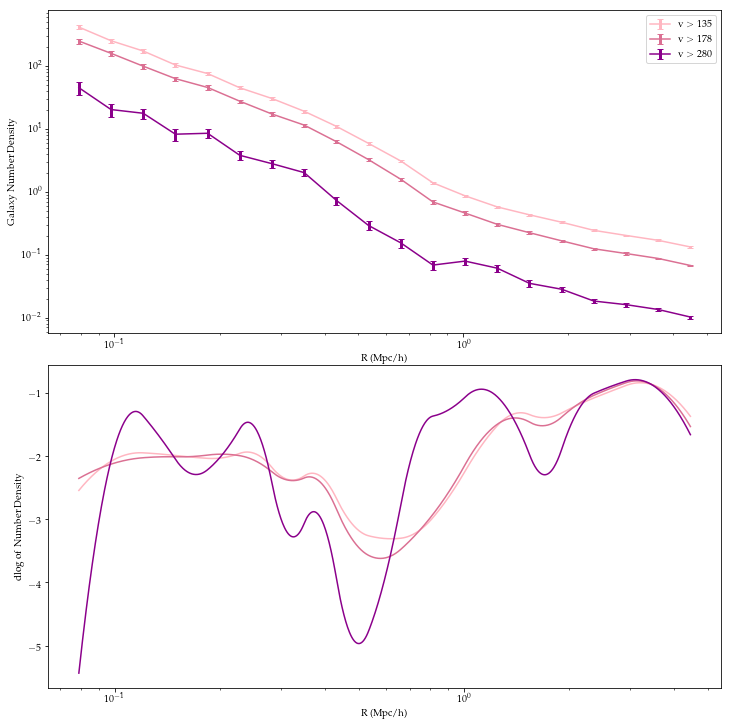

In [87]:
bin_stack_v, Yi_avg_list_v, cov_list_v, boot_err_list_v, R_avg_v, title_v = MultiProfiles('vcmax',3, subhalo_table_m, CM_coords,halo_array_masked,'basic','stellarmass')


In [98]:
#print(rho_g_list_sm)
rho_g_list_sm2 = [0.026943079757983778, 0.026943079757983778, 0.00805583203958155]

In [110]:
import corner
t0 = time.time()
profiles = Yi_avg_list_sm 
covs = cov_list_sm 
#[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -1, -.34, 3, -0.5 , 1.66]
#this one below
#init_theta_list_sm = np.array([[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
init_theta_list_sm = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34


bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))


blue_list_sm = [False, False, False]#[True, True, True, False]
#rho_g_list_sm

best_fit_mcmc_list_sm, samples_list_sm, sampler_list_sm = MCMC(bin_stack_sm, profiles, covs, rho_g_list_sm, blue_list_sm, init_theta_list_sm, bounds, 10000, 128, 5000)    
print(time.time()-t0)

NameError: name 'rho_g_list_sm' is not defined

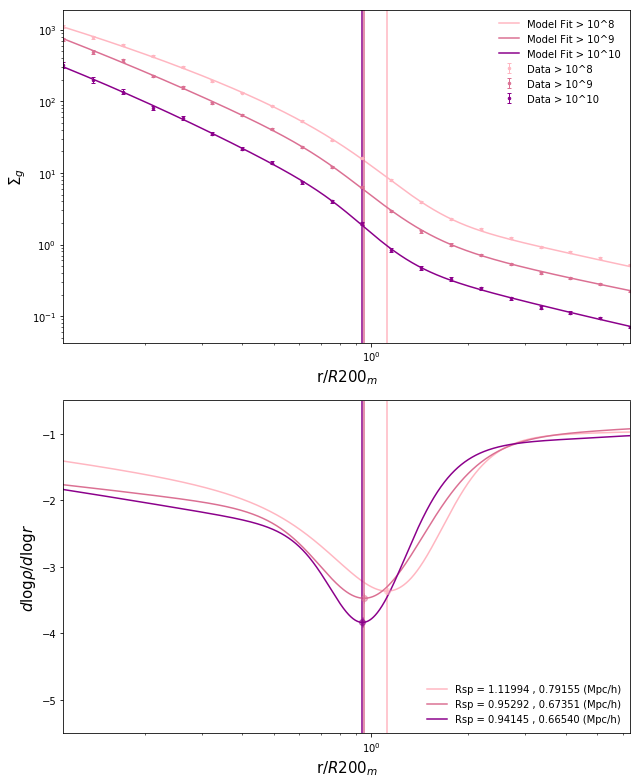

R_avg= 0.7067824398397052
[0.7915547414991042, 0.6735096926649821, 0.6654011809470552]


In [134]:
# MCMC FITTING SPLIT PROFILES
colors = ['lightpink', 'palevioletred','darkmagenta']
#labels = ['<-19.4', '<-20.4', '<-21.4']
labels =  ['> 10^8', '> 10^9', '> 10^10']
ls_list = ['-','-','-']

#BASIC
profiles = Yi_avg_list_sm#[Yi_avg1, Yi_avg_blue1, Yi_avg_red1,Yi_avg_green1]
covs = cov_list_sm#[cov1, cov_blue1, cov_red1,cov_green1]
averaged_r_tot = bin_stack_sm
sigs_sm = [.001,.001,.001]
r_sp_list, r_sp_r200_list = FittedPlots(best_fit_mcmc_list_sm, profiles, averaged_r_tot,R_avg_sm,covs,rho_g_list_sm2,sigs_sm,labels, colors, ls_list)

print(r_sp_list)



## i-band split


Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 373327.61919879913
R200m: 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 373327.6760277748
566208 566208 time 373327.736702919
N Subhalos within 7*R200m: 4517 373330.1122429371
galaxies 0 [   8.   20.   25.   31.   28.   55.   64.   77.  107.  118.   99.   73.
   80.   51.  115.  223.  497.  607.  715. 1307.]
galaxies 1 [  3.   6.  11.  19.  13.  24.  20.  20.  45.  41.  35.  23.  28.  16.
  45.  94. 199. 234. 320. 535.]
galaxies 2 [  2.   3.  10.  10.  10.  14.  13.  14.  28.  27.  21.  15.  19.  10.
  30.  68. 133. 156. 206. 351.]

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 373330.13309693336
R200m: 1.1697442162737657
Rscale 1.1697442162737657
before dev loop: 373330.142870903
566208 566208 time 373330.167883873
N Subhalos within 7*R200m: 2089 373330.4432308674
galaxies 0 [  5.  12.  21.  17.  20.  22.  32.  26.  35.  44.  73. 109.  87.  60.
  71. 138. 184. 167. 340. 526

N Subhalos within 7*R200m: 1352 373332.24887895584
galaxies 0 [  4.   4.   9.   9.  12.  12.  20.  28.  22.  32.  34.  42.  16.  15.
  24.  59. 232. 208. 136. 347.]
galaxies 1 [  1.   4.   3.   4.   6.   6.   9.  11.   8.  11.  14.  15.   5.   2.
   6.  18.  92.  81.  55. 147.]
galaxies 2 [ 1.  3.  2.  1.  6.  5.  4.  9.  4.  6.  8.  9.  2.  1.  5. 15. 65. 49.
 38. 94.]

Halo: 15
Halo Mass: 25923.64
N Subhalos from Illustris Algorithm: 1930 373332.252399683
R200m: 1.0439992872395611
Rscale 1.0439992872395611
before dev loop: 373332.2605419159
566208 566208 time 373332.28335785866
N Subhalos within 7*R200m: 1525 373332.328704834
galaxies 0 [  5.   5.  10.  25.  20.  16.  21.  21.  34.  39.  32.  35.  35.  18.
  32.  36. 175. 291. 300. 277.]
galaxies 1 [  2.   1.   6.  11.   6.   6.   8.   4.   7.  15.  12.  15.  17.   5.
  17.  11.  68. 116. 108. 105.]
galaxies 2 [ 2.  1.  6.  6.  4.  3.  7.  2.  4.  9. 11. 10. 12.  3. 10.  8. 49. 71.
 65. 69.]

Halo: 16
Halo Mass: 24286.85
N Subhalos f

N Subhalos within 7*R200m: 1475 373333.6066977978
galaxies 0 [  1.   4.   1.   2.   6.   8.  11.  20.  25.  23.  29.  10.  18.  22.
  26.  70. 160. 128. 274. 563.]
galaxies 1 [  1.   2.   1.   1.   1.   4.   0.  14.   8.   7.   7.   2.   8.   7.
   9.  32.  80.  45. 114. 255.]
galaxies 2 [  0.   0.   1.   1.   0.   2.   0.  12.   6.   5.   4.   1.   5.   4.
   8.  17.  54.  31.  78. 179.]

Halo: 33
Halo Mass: 16789.268
N Subhalos from Illustris Algorithm: 1276 373333.6107020378
R200m: 0.7387652599530732
Rscale 0.7387652599530732
before dev loop: 373333.61483597755
566208 566208 time 373333.63590979576
N Subhalos within 7*R200m: 511 373333.6782698631
galaxies 0 [  1.   3.   2.   4.   5.   3.   6.   6.  19.  12.  18.  16.  10.  14.
  13.  37.  60.  69.  83. 100.]
galaxies 1 [ 1.  3.  1.  2.  1.  2.  4.  4. 12.  3.  7.  5.  4.  8.  9. 16. 29. 36.
 33. 43.]
galaxies 2 [ 1.  3.  0.  1.  0.  1.  3.  3.  7.  3.  4.  3.  3.  6.  6. 12. 23. 24.
 21. 33.]

Halo: 35
Halo Mass: 16756.076
N Subhalo

N Subhalos within 7*R200m: 683 373334.6984157562
galaxies 0 [  4.   4.  11.   9.   7.  10.  15.  12.  16.  13.  21.  14.  19.  24.
  49.  31.  53.  55. 110. 184.]
galaxies 1 [ 2.  2.  4.  2.  2.  4.  7.  6.  8.  8.  9.  2.  7. 12. 19. 17. 21. 20.
 53. 74.]
galaxies 2 [ 2.  2.  2.  2.  2.  2.  5.  4.  5.  6.  7.  0.  4.  8. 14. 14. 16. 15.
 40. 54.]

Halo: 49
Halo Mass: 14361.839
N Subhalos from Illustris Algorithm: 1337 373334.7030119896
R200m: 0.7415446917762308
Rscale 0.7415446917762308
before dev loop: 373334.70740890503
566208 566208 time 373334.7285428047
N Subhalos within 7*R200m: 563 373334.7721788883
galaxies 0 [  2.   2.   4.   2.   4.   8.   9.  12.  13.  14.  13.  10.  30.  24.
  26.  51.  36.  71.  86. 129.]
galaxies 1 [ 2.  0.  1.  2.  2.  5.  1.  4.  7.  4.  5.  4. 13. 14. 14. 25. 21. 33.
 35. 60.]
galaxies 2 [ 2.  0.  1.  2.  2.  1.  1.  3.  5.  2.  5.  4. 11. 12.  9. 15. 15. 24.
 24. 36.]

Halo: 50
Halo Mass: 13977.665
N Subhalos from Illustris Algorithm: 1162 373334.77

N Subhalos within 7*R200m: 525 373335.76250576973
galaxies 0 [  3.   1.   6.  10.  10.  18.  12.  17.  20.  16.   5.   8.   7.  12.
  20.  21.  31.  59. 118. 110.]
galaxies 1 [ 1.  0.  4.  2.  4.  9.  5.  5. 12.  4.  3.  3.  1.  5.  9. 12. 11. 24.
 56. 44.]
galaxies 2 [ 0.  0.  3.  1.  3.  7.  3.  3.  9.  3.  3.  3.  1.  3.  5.  7.  7. 16.
 39. 29.]

Halo: 67
Halo Mass: 12368.131
N Subhalos from Illustris Algorithm: 844 373335.76538181305
R200m: 0.7830733890441879
Rscale 0.7830733890441879
before dev loop: 373335.7692337036
566208 566208 time 373335.7906398773
N Subhalos within 7*R200m: 453 373335.83324694633
galaxies 0 [ 1.  2.  4.  6.  4.  4.  4.  5. 15. 10. 15. 21. 16. 11. 10.  7. 41. 80.
 82. 98.]
galaxies 1 [ 0.  0.  3.  3.  0.  4.  1.  2.  5.  4.  7.  5.  6.  3.  5.  4. 16. 43.
 42. 34.]
galaxies 2 [ 0.  0.  3.  1.  0.  3.  1.  2.  2.  2.  3.  3.  5.  2.  3.  3. 13. 28.
 20. 22.]

Halo: 69
Halo Mass: 12028.139
N Subhalos from Illustris Algorithm: 983 373335.83551573753
R200m: 0.7

N Subhalos within 7*R200m: 643 373336.82255101204
galaxies 0 [  1.   2.   2.   6.   9.   8.   6.  10.  11.  17.  16.  24.  13.  12.
  16.  51.  48.  86.  84. 198.]
galaxies 1 [ 1.  1.  1.  2.  5.  5.  1.  5.  2. 12.  4. 10.  6.  6.  8. 26. 25. 40.
 34. 82.]
galaxies 2 [ 0.  1.  1.  1.  4.  3.  1.  3.  0.  9.  3.  5.  3.  4.  4. 18. 19. 29.
 24. 55.]

Halo: 88
Halo Mass: 10377.713
N Subhalos from Illustris Algorithm: 915 373336.8252747059
R200m: 0.7523559153089142
Rscale 0.7523559153089142
before dev loop: 373336.8296329975
566208 566208 time 373336.851033926
N Subhalos within 7*R200m: 702 373336.89289188385
galaxies 0 [  0.   3.   3.   0.   4.   7.   4.   8.  22.  20.  14.  17.  16.   7.
  29.  52.  98.  74. 113. 174.]
galaxies 1 [ 0.  0.  2.  0.  2.  3.  2.  4.  7.  9.  7.  5.  8.  2. 11. 17. 31. 37.
 51. 76.]
galaxies 2 [ 0.  0.  1.  0.  2.  2.  2.  1.  3.  7.  3.  5.  7.  2.  8. 14. 20. 29.
 33. 49.]

Halo: 91
Halo Mass: 10381.131
N Subhalos from Illustris Algorithm: 842 373336.8956

/Users/TaraD/anaconda3/lib/python3.7/site-packages/scipy/signal/_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


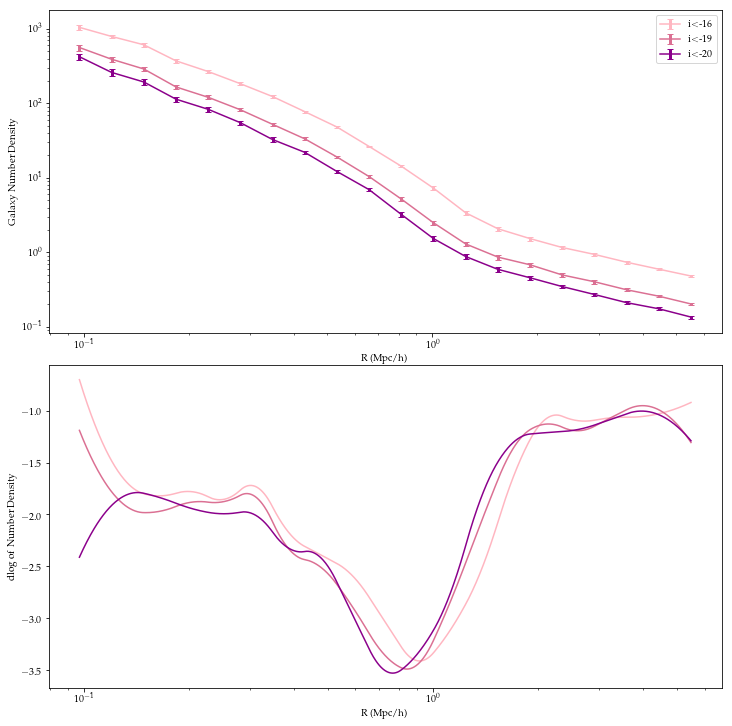

In [175]:
ND_LIST_i, bin_stack_i, Yi_avg_list_i, cov_list_i, boot_err_list_i, R_avg_i, title_i = MultiProfiles('i-band',3, subhalo_table_m, CM_coords,halo_array_masked,'basic','stellarmass')


In [176]:
datanew = np.load('N_gal_prof_mat.npy')
#print(Yi_avg_list_i[2])
print((np.array(ND_LIST_i)[:,2,:]))
arr = np.nanmean(datanew, axis = 0)
print(((datanew)))


[[1.44586197e+02 1.14670944e+02 2.02100518e+02 ... 2.22444378e-01
  1.55309975e-01 1.39918307e-01]
 [1.67342277e+02 5.30874934e+02 3.74253827e+02 ... 1.88139735e-01
  1.48340553e-01 1.42100950e-01]
 [4.68486114e+02 3.09629285e+02 2.94679435e+02 ... 4.08893301e-01
  2.27187780e-01 1.03330207e-01]
 ...
 [0.00000000e+00 3.45598395e+02 1.82728804e+02 ... 3.35204445e-01
  1.02249919e-01 1.26146456e-01]
 [6.76447767e+02 0.00000000e+00 0.00000000e+00 ... 2.00136142e-01
  1.48145633e-01 1.71578428e-01]
 [6.77470436e+02 0.00000000e+00 0.00000000e+00 ... 1.73713551e-01
  2.26087014e-01 1.27010566e-01]]
[[1.21980728e+03 6.44950692e+02 5.68343054e+02 ... 3.76936176e-01
  2.96826927e-01 3.36303827e-01]
 [0.00000000e+00 6.44950692e+02 5.68343054e+02 ... 4.33075606e-01
  2.24740388e-01 1.39005582e-01]
 [8.13204850e+02 6.44950692e+02 3.41005833e+02 ... 4.25055688e-01
  4.70682699e-01 4.03564592e-01]
 ...
 [0.00000000e+00 4.29967128e+02 1.13668611e+02 ... 9.62390237e-02
  1.31451925e-01 8.07129185e-02]

In [4]:
'''
#import corner
t0 = time.time()
profiles = Yi_avg_list_i 

covs = cov_list_i 

#init_theta_list_i = np.array([[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
init_theta_list_i = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]])#,[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34

bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))


blue_list_i = [False, False, False]#[True, True, True, False]
#rho_g_list_i = rho_g_list_sm2
best_fit_mcmc_list_i, samples_list_i, sampler_list_i = MCMC(bin_stack_i, profiles, covs, rho_g_list_i, blue_list_i, init_theta_list_i, bounds, 10000, 128, 5000)    
print(time.time()-t0)
'''

'\n#import corner\nt0 = time.time()\nprofiles = Yi_avg_list_i \n\ncovs = cov_list_i \n\n#init_theta_list_i = np.array([[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34\ninit_theta_list_i = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]])#,[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34\n\nbounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))\n\n\nblue_list_i = [False, False, False]#[True, True, True, False]\n#rho_g_list_i = rho_g_list_sm2\nbest_fit_mcmc_list_i, samples_list_i, sampler_list_i = MCMC(bin_stack_i, profiles, covs, rho_g_list_i, blue_list_i, init_theta_list_i, bounds, 10000, 128, 5000)    \nprint(time.time()-t0)\n'

Progress: [------------------->] 100%count 0 = 0, count total = 10000
Progress: [------------------->] 100%count 1 = 78, count total = 10000
Progress: [------------------->] 100%count 2 = 569, count total = 10000


<Figure size 720x576 with 0 Axes>

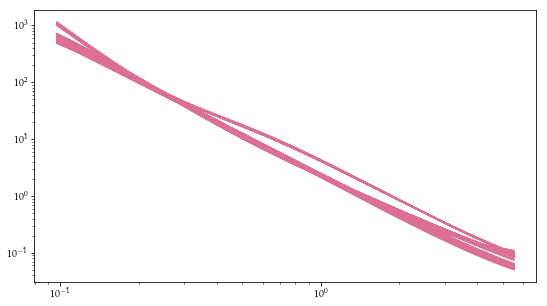

0 1.098733151797822 0.1470751831205206
1 0.9467090871347904 0.1631972235978958
2 0.8797648136185279 0.17886240721376548


/Users/TaraD/anaconda3/lib/python3.7/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


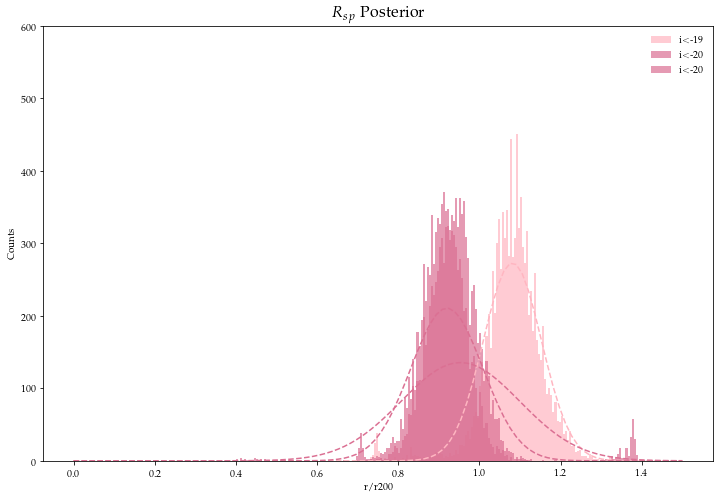

[1.081297186583813, 0.9532711246719905, 0.9199355852861376] [0.07167791961376144, 0.1460210632904495, 0.08883044903000327]


IndexError: list index out of range

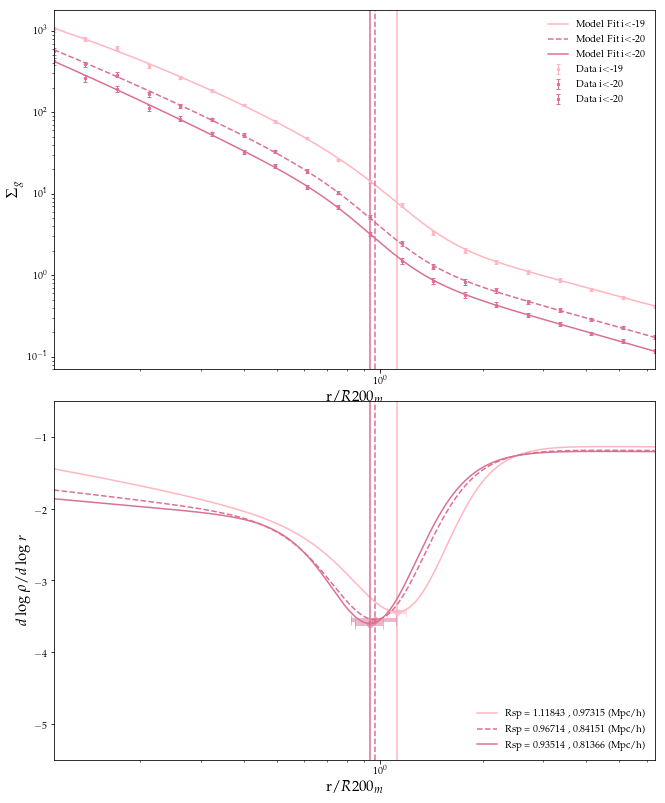

In [203]:
# MCMC FITTING SPLIT PROFILES
colors = ['lightpink', 'palevioletred','palevioletred','darkmagenta']
labels = ['i$<$-19', 'i$<$-20','i$<$-20', 'i$<$-21']
#labels =  ['> 10^9', '> 10^9.5', '> 10^10']
ls_list = ['-','--','-','-']

rsp_samps_list_i = rsp_samp(samples_list_i, sampler_list_i,bin_stack_i,colors,labels, rho_g_list_i)

means_i, sigs_i = rsp_dist(rsp_samps_list_i, colors, R_avg_i,.4)

profiles = Yi_avg_list_i
covs = cov_list_i
averaged_r_tot = bin_stack_i
#sigs_i = [.001,.001,.001]
r_sp_list, r_sp_r200_list = FittedPlots(best_fit_mcmc_list_i, profiles, averaged_r_tot,R_avg_i,covs,rho_g_list_i,sigs_i,labels, colors, ls_list)

print(r_sp_list)



In [207]:
'''
#import corner
t0 = time.time()
profiles = Yi_avg_list_v

covs = cov_list_v

#init_theta_list_i = np.array([[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
init_theta_list_v = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))


blue_list_v = [False, False, False]#[True, True, True, False]
#rho_g_list_v = rho_g_list_sm2


best_fit_mcmc_list_v, samples_list_v, sampler_list_v = MCMC(bin_stack_v, profiles, covs, rho_g_list_v, blue_list_v, init_theta_list_v, bounds, 10000, 128, 5000)    
print(time.time()-t0)
'''

'\n#import corner\nt0 = time.time()\nprofiles = Yi_avg_list_v\n\ncovs = cov_list_v\n\n#init_theta_list_i = np.array([[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34\ninit_theta_list_v = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34\nbounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))\n\n\nblue_list_v = [False, False, False]#[True, True, True, False]\n#rho_g_list_v = rho_g_list_sm2\n\n\nbest_fit_mcmc_list_v, samples_list_v, sampler_list_v = MCMC(bin_stack_v, profiles, covs, rho_g_list_v, blue_list_v, init_theta_list_v, bounds, 10000, 128, 5000)    \nprint(time.time()-t0)\n'

In [42]:
# MCMC FITTING SPLIT PROFILES
colors = ['lightpink', 'palevioletred','darkmagenta']
labels = ['v > 135', 'v > 178', 'v > 280']
#labels =  ['> 10^9', '> 10^9.5', '> 10^10']
ls_list = ['-','-','-']

#BASIC
profiles = Yi_avg_list_v#[Yi_avg1, Yi_avg_blue1, Yi_avg_red1,Yi_avg_green1]
covs = cov_list_v#[cov1, cov_blue1, cov_red1,cov_green1]
averaged_r_tot = bin_stack_v
sigs_v = [.001,.001,.001]
r_sp_list, r_sp_r200_list = FittedPlots(best_fit_mcmc_list_v, profiles, averaged_r_tot,R_avg_v,covs,rho_g_list_v,sigs_v,labels, colors, ls_list)

print(r_sp_list)



NameError: name 'Yi_avg_list_v' is not defined


Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 223337.47142195702
R500c, R200c, R200m: 0.7612624597816122 1.24644093717065 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 223337.48008823395
566208 566208 time 223337.4990181923
N Subhalos within 7*R200m: 4517 223337.55210614204
galaxies 0 [   8.   18.   26.   33.   31.   57.   70.   83.  117.  127.  102.   75.
   83.   53.  117.  230.  507.  615.  729. 1328.]
galaxies 1 [   2.    6.   12.   13.   16.   32.   31.   34.   58.   65.   73.   59.
   70.   47.  105.  179.  318.  431.  605. 1039.]
galaxies 2 [  0.   2.   4.   1.   5.   4.   3.   5.   9.   9.  10.   8.   9.   9.
  21.  47.  67.  92. 147. 233.]

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 223337.55517196655
R500c, R200c, R200m: 0.5860514830407864 0.916949635434108 1.1697442162737657
Rscale 1.1697442162737657
before dev loop: 223337.5631289482
566208 566208 time 223337.5838868618
N Subhalos within 7*R200m: 2089 223

N Subhalos within 7*R200m: 1352 223338.64342999458
galaxies 0 [  4.   4.   8.  10.  12.  14.  21.  32.  24.  33.  39.  44.  17.  16.
  24.  60. 239. 220. 140. 350.]
galaxies 1 [  1.   3.   2.   3.   6.   7.  12.  18.   7.  22.  28.  34.  16.  15.
  20.  47. 176. 157. 128. 285.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  3.  1.  3.  4.  5.  1.  0.  5.  9. 30. 30.
 30. 66.]

Halo: 15
Halo Mass: 25923.64
N Subhalos from Illustris Algorithm: 1930 223338.64684700966
R500c, R200c, R200m: 0.5543512035580016 0.8399260732759634 1.0439992872395611
Rscale 1.0439992872395611
before dev loop: 223338.65097999573
566208 566208 time 223338.67130804062
N Subhalos within 7*R200m: 1525 223338.71161913872
galaxies 0 [  4.   5.  10.  24.  20.  19.  23.  23.  38.  42.  33.  36.  37.  21.
  33.  37. 188. 303. 306. 283.]
galaxies 1 [  2.   1.   6.   8.   9.   7.  16.  13.  27.  26.  24.  32.  33.  18.
  27.  34. 117. 213. 257. 247.]
galaxies 2 [ 0.  0.  0.  3.  1.  1.  3.  2.  1.  3.  6.  5.  8.  2.  8.  7. 19.

before dev loop: 223339.4751162529
566208 566208 time 223339.4954278469
N Subhalos within 7*R200m: 896 223339.53484606743
galaxies 0 [  3.   3.   4.   6.   8.  17.  15.  23.  25.  32.  28.  18.  20.  22.
  25.  41.  80. 107. 151. 242.]
galaxies 1 [  1.   2.   2.   2.   2.   6.   7.   9.  15.  16.  21.  13.  14.  19.
  21.  40.  74.  87. 127. 205.]
galaxies 2 [ 0.  1.  0.  0.  0.  1.  2.  2.  2.  3.  3.  2.  3.  6.  5. 10. 13. 19.
 20. 53.]

Halo: 28
Halo Mass: 18303.37
N Subhalos from Illustris Algorithm: 1259 223339.53799891472
R500c, R200c, R200m: 0.47005714481822525 0.7368807582565953 0.9160478994506897
Rscale 0.9160478994506897
before dev loop: 223339.54194498062
566208 566208 time 223339.56123805046
N Subhalos within 7*R200m: 555 223339.6025710106
galaxies 0 [  2.   4.   2.   6.  10.   9.  12.  18.  24.  24.  27.  17.   9.  11.
  21.  23.  37.  49.  93. 139.]
galaxies 1 [  2.   3.   1.   2.   4.   4.   6.   7.  20.  15.  18.  13.   9.   9.
  18.  18.  32.  48.  81. 122.]
galaxies 

N Subhalos within 7*R200m: 1408 223340.51696109772
galaxies 0 [  3.   0.   3.   8.  17.  16.  20.  19.  19.  22.  23.  13.  11.   9.
  33.  53. 129. 151. 359. 464.]
galaxies 1 [  0.   0.   1.   3.  12.   9.   7.  10.  13.  16.  18.  10.  10.   5.
  30.  40.  82. 114. 251. 317.]
galaxies 2 [ 0.  0.  0.  1.  1.  2.  2.  0.  2.  3.  4.  3.  0.  1.  7. 11. 17. 27.
 55. 69.]

Halo: 44
Halo Mass: 14879.6455
N Subhalos from Illustris Algorithm: 1025 223340.52000713348
R500c, R200c, R200m: 0.4407996074222926 0.6726693415122941 0.8441294504666501
Rscale 0.8441294504666501
before dev loop: 223340.52414011955
566208 566208 time 223340.544809103
N Subhalos within 7*R200m: 479 223340.58445501328
galaxies 0 [  4.   1.   3.   4.   4.   8.   9.   6.  15.  21.  25.  20.  19.  18.
  15.  18.  35.  35.  82. 124.]
galaxies 1 [  1.   1.   1.   2.   3.   4.   4.   0.  10.  12.  16.  15.  12.  14.
  15.  14.  32.  28.  69. 108.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  0.  3.  1.  4.  3.  2.  1.  5.  4.  7. 

N Subhalos within 7*R200m: 755 223341.5754210949
galaxies 0 [  2.   1.   3.   3.  12.   3.  11.  13.  12.  15.  19.  22.  16.  19.
  16.  30.  36.  99. 120. 267.]
galaxies 1 [  1.   0.   2.   1.   4.   1.   6.   8.   9.  12.  12.  11.  11.  15.
  12.  23.  26.  64.  92. 178.]
galaxies 2 [ 0.  0.  1.  1.  0.  0.  1.  1.  1.  0.  2.  2.  2.  2.  3.  6.  6. 18.
 21. 32.]

Halo: 61
Halo Mass: 12851.317
N Subhalos from Illustris Algorithm: 940 223341.57801914215
R500c, R200c, R200m: 0.44482178868592587 0.6774657890660761 0.8176854942809225
Rscale 0.8176854942809225
before dev loop: 223341.58227324486
566208 566208 time 223341.60322999954
N Subhalos within 7*R200m: 473 223341.64018201828
galaxies 0 [  1.   5.   4.   4.   8.  11.  22.  18.  21.  14.  11.  11.   6.   7.
   9.  14.  17.  55. 108. 112.]
galaxies 1 [  0.   4.   3.   2.   4.   4.  12.  11.  10.   7.   9.   9.   5.   7.
   8.  13.  14.  44.  85. 103.]
galaxies 2 [ 0.  0.  1.  1.  2.  1.  2.  1.  1.  0.  0.  1.  2.  2.  0.  7.  3. 1

before dev loop: 223342.59172201157
566208 566208 time 223342.61238622665
N Subhalos within 7*R200m: 508 223342.64936208725
galaxies 0 [ 2.  1.  6.  2.  9.  9. 14. 14. 13. 14. 10.  2.  5.  4. 17. 47. 67. 97.
 77. 89.]
galaxies 1 [ 1.  0.  2.  0.  6.  5.  9.  8.  9.  9.  7.  1.  5.  4. 16. 32. 40. 75.
 69. 81.]
galaxies 2 [ 0.  0.  0.  0.  1.  1.  1.  0.  1.  1.  0.  0.  2.  1.  3.  8. 13. 11.
 16. 22.]

Halo: 83
Halo Mass: 10720.226
N Subhalos from Illustris Algorithm: 963 223342.6518239975
R500c, R200c, R200m: 0.4020546256637934 0.6195930270125328 0.7640232355504157
Rscale 0.7640232355504157
before dev loop: 223342.65594005585
566208 566208 time 223342.67650914192
N Subhalos within 7*R200m: 401 223342.71380114555
galaxies 0 [  0.   1.   5.   2.   7.   9.   7.  19.  24.  14.  13.   4.   8.   9.
  15.  37.  14.  23.  68. 112.]
galaxies 1 [ 0.  1.  4.  2.  3.  4.  6. 13. 15.  9.  9.  3.  8.  9. 13. 27. 14. 22.
 57. 89.]
galaxies 2 [ 0.  1.  0.  0.  2.  0.  1.  2.  1.  1.  1.  1.  1.  1. 

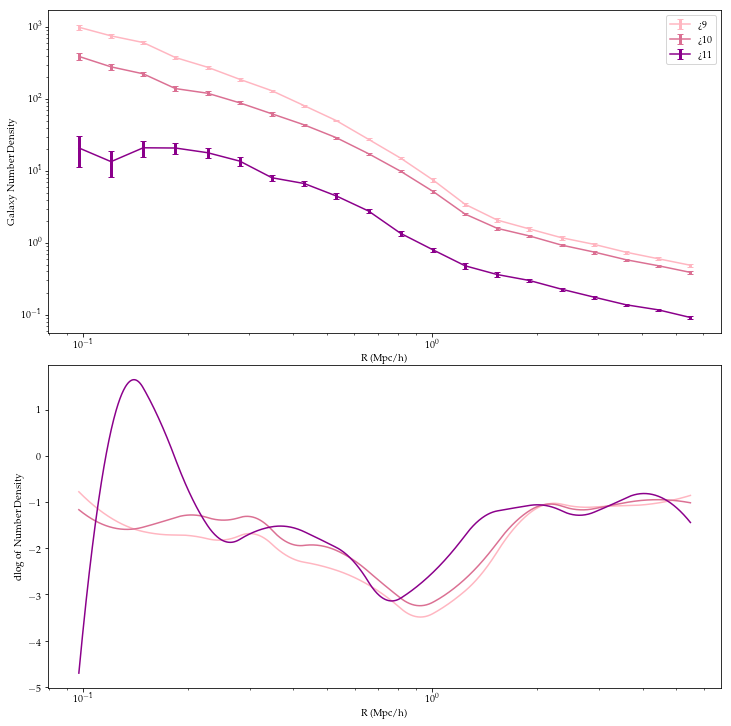

In [89]:
bin_stack_s3, Yi_avg_list_s3, cov_list_s3, boot_err_list_s3, R_avg_s3, title_s3 = MultiProfiles('subs3',3, subhalo_table_m, CM_coords,halo_array_masked,'basic','stellarmass')


In [208]:
'''
#import corner
t0 = time.time()
profiles = Yi_avg_list_s3

covs = cov_list_s3

init_theta_list_s3 = np.array([[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
#init_theta_list_s3 = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))


blue_list_s3 = [False, False, False]#[True, True, True, False]
#rho_g_list_s3 = rho_g_list_sm2


best_fit_mcmc_list_s3, samples_list_s3, sampler_list_s3 = MCMC(bin_stack_s3, profiles, covs, rho_g_list_s3, blue_list_s3, init_theta_list_s3, bounds, 10000, 128, 5000)    
print(time.time()-t0)
'''

'\n#import corner\nt0 = time.time()\nprofiles = Yi_avg_list_s3\n\ncovs = cov_list_s3\n\ninit_theta_list_s3 = np.array([[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34\n#init_theta_list_s3 = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34\nbounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))\n\n\nblue_list_s3 = [False, False, False]#[True, True, True, False]\n#rho_g_list_s3 = rho_g_list_sm2\n\n\nbest_fit_mcmc_list_s3, samples_list_s3, sampler_list_s3 = MCMC(bin_stack_s3, profiles, covs, rho_g_list_s3, blue_list_s3, init_theta_list_s3, bounds, 10000, 128, 5000)    \nprint(time.time()-t0)\n'

Progress: [------------------->] 100%count 0 = 308, count total = 10000
Progress: [>                   ] 3%

/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: overflow encountered in power


Progress: [------------------->] 100%count 1 = 76, count total = 10000
Progress: [------------------->] 100%count 2 = 161, count total = 10000


<Figure size 720x576 with 0 Axes>

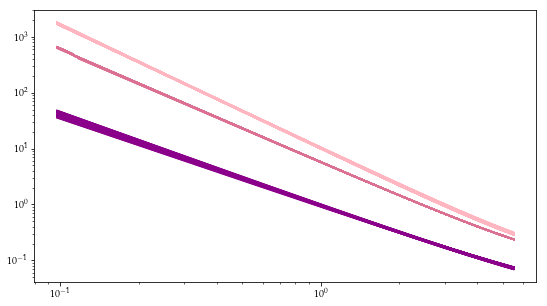

0 1.0905980679051928 0.18001505965394757
1 1.1374916668139434 0.09896997291973135
2 0.870383286386285 0.12168682250446615


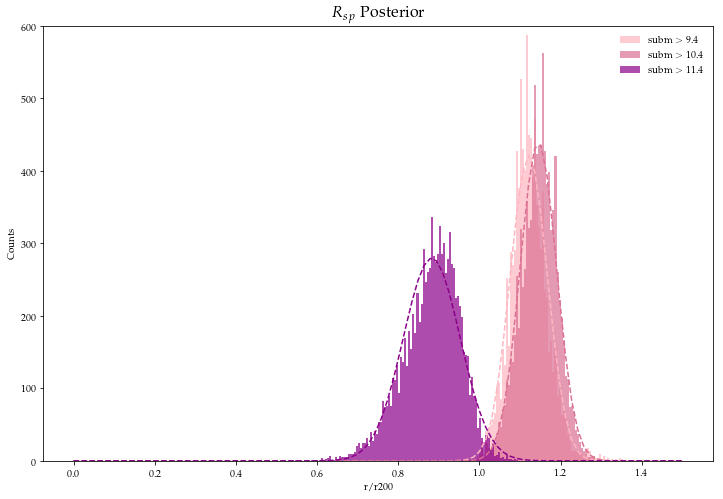

[1.121657441147411, 1.1452133380175784, 0.8825556275736199] [0.04595585613117636, 0.04499720462656177, 0.07020641712463843]


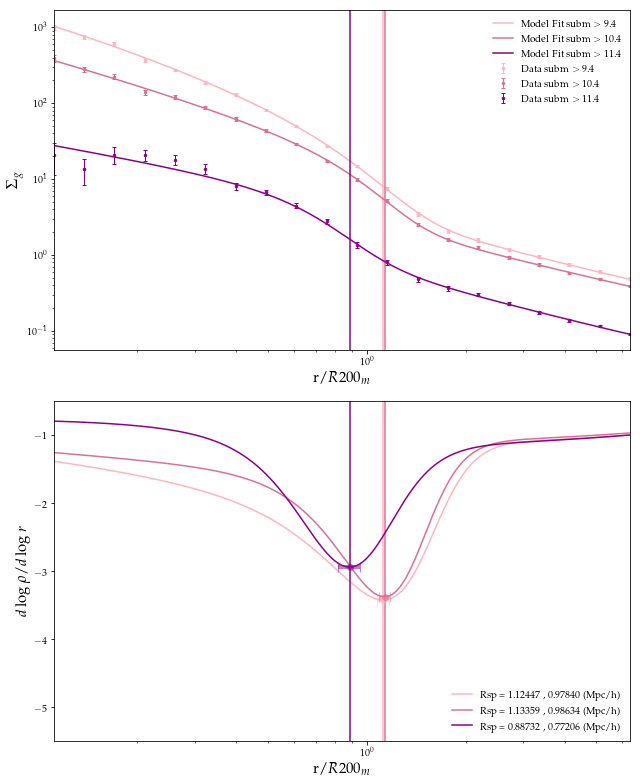

R_avg= 0.8701007239330811
[0.9784038691891703, 0.9863363000435367, 0.772058854536504]


In [92]:
colors = ['lightpink', 'palevioletred','darkmagenta']
labels = ['subm $>$ 9.4', 'subm $>$ 10.4', 'subm $>$ 11.4']
rsp_samps_list_s3 = rsp_samp(samples_list_s3, sampler_list_s3,bin_stack_s3,colors,labels, rho_g_list_s3)

means_s3, sigs_s3 = rsp_dist(rsp_samps_list_s3, colors, R_avg_s3,.3)

# MCMC FITTING SPLIT PROFILES

ls_list = ['-','-','-']

#BASIC
profiles = Yi_avg_list_s3
covs = cov_list_s3
averaged_r_tot = bin_stack_s3
r_sp_list, r_sp_r200_list = FittedPlots(best_fit_mcmc_list_s3, profiles, averaged_r_tot,R_avg_s3,covs,rho_g_list_s3,sigs_s3,labels, colors, ls_list)

print(r_sp_list)



## subs 2 split

In [2]:
#running for 10^14
#CM_coords_clean = subhalo_table_clean['SubhaloPos']
##ND_LIST_s2, bin_stack_s2, Yi_avg_list_s2, cov_list_s2, boot_err_list_s2, R_avg_s2, title_s2 = MultiProfiles('ibsubm',2, subhalo_table_clean, CM_coords_clean,halo_array_masked,'basic','stellarmass')

#ND_LIST_s2, bin_stack_s2, Yi_avg_list_s2, cov_list_s2, boot_err_list_s2, R_avg_s2, title_s2 = MultiProfiles('subs',2, subhalo_table_m, CM_coords_m,halo_array_masked,'basic','stellarmass')
#mean subm0= 10.963834
#median subm0 = 10.980335
# 11.885


In [131]:

s2 = np.log10(subhalo_table_m['SubhaloMass']*1e10)

s2mean = np.median(s2)
print(s2mean)
massmask1 = (s2<s2mean)
massmask2 = (s2>s2mean)


ib = (subhalo_table_m['SubhaloStellarPhotometrics'])[:,6]
samp = subhalo_table_m[ib < -19]

subm0 = np.log10(samp['SubhaloMass']*1e10)
subm = np.log10(subhalo_table_m['SubhaloMass']*1e10)

median = np.median(subm0)
print(median)
'''
massmask1 = (ib <-19)&(subm < median)
massmask2 = (ib <-19)
plt.figure()
plt.hist(subm[massmask2], bins=100)

'''

Nsubs_m1 = len((subhalo_table_m)[massmask1])
Nsubs_m2 = len((subhalo_table_m)[massmask2])

#rho_g_list_s2 = [Nsubs_m1/(boxsize*.001)**3, Nsubs_m2/(boxsize*.001)**3]#, Nsubs_m4/(boxsize*.001)**3]
#with subs3

10.980335
11.400008


/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log10
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log10
  """


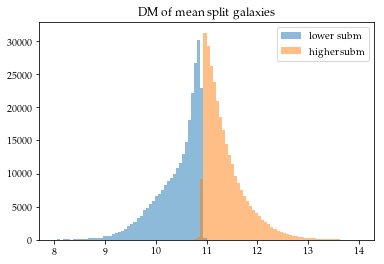

In [37]:
mag = subhalo_table_m['SubhaloStellarPhotometrics']
gmr = mag[:,4]-mag[:,5]
sfr = np.log10(subhalo_table_m['SubhaloSFR'])
sm = np.log10(subhalo_table_m['StellarMass']*1e10)
dm = np.log10(subhalo_table_m['SubhaloMassType'][:,1]*1e10)
param = dm
plt.figure()
plt.hist(param[massmask1], bins = 100, label = 'lower subm', alpha = .5)#, range = [8,14])
plt.hist(param[massmask2], bins = 100, label = 'higher subm', alpha = .5)#, range = [8,14])
plt.title('DM of mean split galaxies')
plt.legend()
plt.show()

In [3]:
'''
#import corner
t0 = time.time()
profiles = Yi_avg_list_s2

covs = cov_list_s2

init_theta_list_s2 = np.array([[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66]])#[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]])
#init_theta_list_s2 = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -1, .34, 3, -0.5 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34

bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))


blue_list_s2 = [False, False]
#rho_g_list_s3 = rho_g_list_sm2


best_fit_mcmc_list_s2, samples_list_s2, sampler_list_s2 = MCMC(bin_stack_s2, profiles, covs, rho_g_list_s2, blue_list_s2, init_theta_list_s2, bounds, 10000, 128, 5000)    
print(time.time()-t0)
'''

'\n#import corner\nt0 = time.time()\nprofiles = Yi_avg_list_s2\n\ncovs = cov_list_s2\n\ninit_theta_list_s2 = np.array([[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.05, 2, 3 , 1.66]])#[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66]])\n#init_theta_list_s2 = np.array([[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -1, .34, 3, -0.5 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34\n\nbounds = ((-2, 2),(-1.4, 3), (-1.2,3), (.3, 3), (-1, 0.7), (-1, 30), (-1, 30), (.1, 10))\n\n\nblue_list_s2 = [False, False]\n#rho_g_list_s3 = rho_g_list_sm2\n\n\nbest_fit_mcmc_list_s2, samples_list_s2, sampler_list_s2 = MCMC(bin_stack_s2, profiles, covs, rho_g_list_s2, blue_list_s2, init_theta_list_s2, bounds, 10000, 128, 5000)    \nprint(time.time()-t0)\n'

In [ ]:
colors = ['palevioletred','darkmagenta']
#labels = ['subm $<$ median', 'subm $>$ median']

labels = ['$M_i$ $<$ -19, subm $<$ median', '$M_i$ $<$ -19']
rsp_samps_list_s2 = rsp_samp(samples_list_s2, sampler_list_s2,bin_stack_s2,colors,labels, rho_g_list_s2)

means_s2, sigs_s2 = rsp_dist(rsp_samps_list_s2, colors, R_avg_s2,.3)

# MCMC FITTING SPLIT PROFILES

ls_list = ['-','-','-']

#BASIC
profiles = Yi_avg_list_s2
covs = cov_list_s2
averaged_r_tot = bin_stack_s2
r_sp_list, r_sp_r200_list = FittedPlots(best_fit_mcmc_list_s2, profiles, averaged_r_tot,R_avg_s2,covs,rho_g_list_s2,sigs_s2,labels, colors, ls_list)

print(r_sp_list)



In [200]:
sm = np.log10(subhalo_table_m['StellarMass']*1e10)
mean_sm = np.mean(sm)
print(mean_sm)
mask = (ib<-16)
VR_LIST, DIST_LIST_r200m, DIST_LIST_mpc = PhaseSpace(subhalo_table_m[mask], CM_coords[mask], halo_array_masked)
print(np.shape(VR_LIST), np.shape(DIST_LIST_r200m))

8.966586
V (4326, 3)
R_hat (4326, 3)
VR_list (4326,)
V (2009, 3)
R_hat (2009, 3)
VR_list

/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:405: RuntimeWarning: invalid value encountered in true_divide


 (2009,)
V (3318, 3)
R_hat (3318, 3)
VR_list (3318,)
V (1730, 3)
R_hat (1730, 3)
VR_list (1730,)
V (1588, 3)
R_hat (1588, 3)
VR_list (1588,)
V (1388, 3)
R_hat (1388, 3)
VR_list (1388,)
V (1666, 3)
R_hat (1666, 3)
VR_list (1666,)
V (1605, 3)
R_hat (1605, 3)
VR_list (1605,)
V (1185, 3)
R_hat (1185, 3)
VR_list (1185,)
V (970, 3)
R_hat (970, 3)
VR_list (970,)
V (1179, 3)
R_hat (1179, 3)
VR_list (1179,)
V (1791, 3)
R_hat (1791, 3)
VR_list (1791,)
V (943, 3)
R_hat (943, 3)
VR_list (943,)
V (884, 3)
R_hat (884, 3)
VR_list (884,)
V (1276, 3)
R_hat (1276, 3)
VR_list (1276,)
V (1437, 3)
R_hat (1437, 3)
VR_list (1437,)
V (977, 3)
R_hat (977, 3)
VR_list (977,)
V (843, 3)
R_hat (843, 3)
VR_list (843,)
V (960, 3)
R_hat (960, 3)
VR_list (960,)
V (696, 3)
R_hat (696, 3)
VR_list (696,)
V (829, 3)
R_hat (829, 3)
VR_list (829,)
V (625, 3)
R_hat (625, 3)
VR_list (625,)
V (670, 3)
R_hat (670, 3)
VR_list (670,)
V (711, 3)
R_hat (711, 3)
VR_list (711,)
V (828, 3)
R_hat (828, 3)
VR_list (828,)
V (907, 3)
R_ha

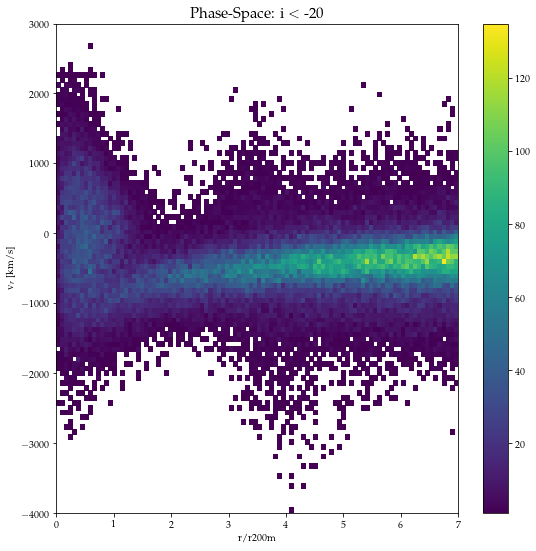

In [201]:
plt.figure(figsize = (9,9))
VR_array = np.array(VR_LIST)*-1
plt.hist2d(DIST_LIST_r200m,VR_array, bins = 100, range=[[0,7],[-4e3,3e3]], cmin = .000001)
plt.title('Phase-Space: i $<$ -20', fontsize = 15)
plt.colorbar()
plt.xlabel('r/r200m')
plt.ylabel('v$_{r}$ [km/s]')
#plt.scatter
plt.show()

['high_gal', 'low_wl', 'r_wl', 'high_wl', 'r_gal', 'low_gal']
3998


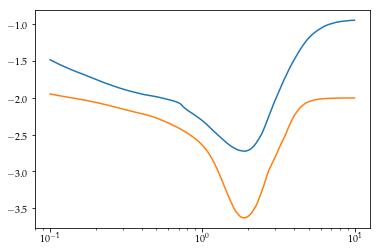

In [183]:
data = np.load('data_measurement_slope.npz')
lst = data.files
print(lst)
print(len(data['high_gal']))
plt.figure()
plt.plot(data['r_wl'], data['high_wl'])
plt.plot(data['r_wl'], data['low_wl'])
plt.xscale('log')

In [185]:
data2 = np.load('log_deriv_matter_e14.npy')
print(np.shape(data2))

(2, 3000)


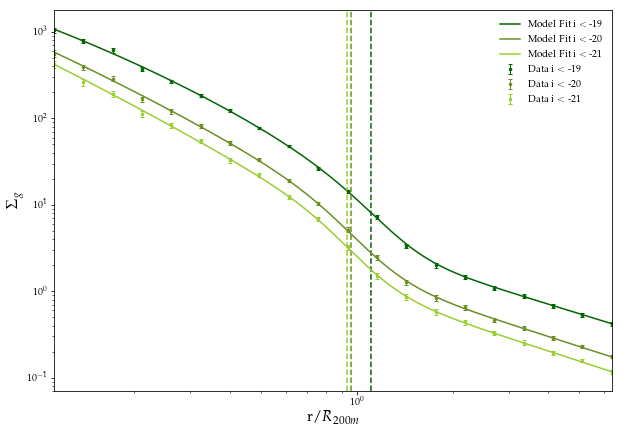

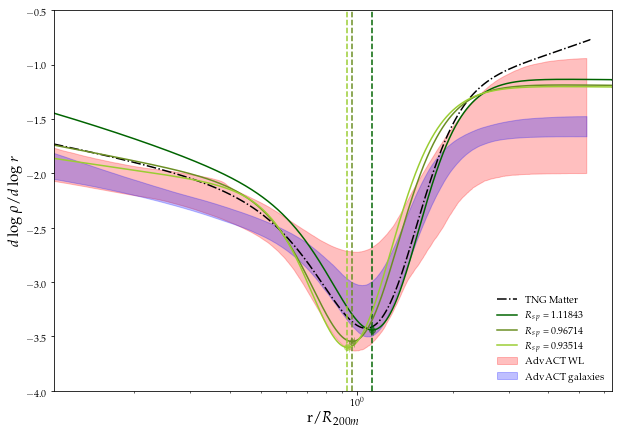

R_avg= 0.8701007239330811


In [188]:

#colors = ['lightpink', 'palevioletred','palevioletred','darkmagenta']
colors = ['darkmagenta', 'palevioletred', 'lightpink']
colors = ['darkgreen', 'olivedrab', 'yellowgreen']
#labels = ['i$<$-19.4', 'i$<$-20','i$<$-20.4', 'i$<$-21.4']
labels = ['i $<$ -19', 'i $<$ -20', 'i $<$ -21']
sigs_i = [.01,.01,.01]
ls_list = ['-','-','-']

#Yi_avg_list_i2 = np.delete(Yi_avg_list_i, [2])#
profiles = Yi_avg_list_i#np.delete(Yi_avg_list_i, 2, axis=0)#Yi_avg_list_i
covs = cov_list_i#np.delete(cov_list_i, 2, axis=0)#cov_list_i
averaged_r_tot = bin_stack_i
#(best_fit_mcmc_list_DF, profiles, averaged_r_tot,Ravg,covs,rho_g_list,sigs,labels, colors, ls_list) = (best_fit_mcmc_list_i, profiles, averaged_r_tot,R_avg_i,covs,rho_g_list_i,sigs_i,labels, colors, ls_list)
(best_fit_mcmc_list_DF, profiles, averaged_r_tot,Ravg,covs,rho_g_list,sigs,labels, colors, ls_list) = (best_fit_mcmc_list_i, profiles, averaged_r_tot,R_avg_i,covs,rho_g_list_i,sigs_i,labels, colors, ls_list)

for k in [0]:
    
    #plt.figure(figsize=(9,11))
    
    #plt = plt.subplot(2,1,1)
    #plt = plt.subplot(2,1,2)
    
    
    #plt.tight_layout()
    #halo_masses = []
    #for h_i in halo_array_masked:
        #halo_masses.append(halo_grp['GroupMass'][h_i]*1e10)
    r_sp_list = []
    r_sp_r200_list = []
    bins = 20
    
    #plt.plot(data['r_gal']/1.89, data['high_gal'])
    #plt.plot(data['r_gal']/1.89, data['low_gal'])
    
    plt.figure(figsize = (10,7))
    for i in range(len(colors)):#(1,2):#
        best_fit_mcmc = best_fit_mcmc_list_DF[i]
        averaged_rho_tot = profiles[i]
        r_thr = np.logspace(np.log10(np.min(averaged_r_tot)), np.log10(np.max(averaged_r_tot)), 3000)

        log_deriv_mcmc = r_thr/rho_DK14(best_fit_mcmc,r_thr, rho_g_list[i])*np.gradient(rho_DK14(best_fit_mcmc,r_thr, rho_g_list[i]), r_thr)

        r_sp = r_thr[np.argmin(log_deriv_mcmc)]
        r_sp_r200 = r_sp/Ravg
        r_sp_list.append(r_sp)
        r_sp_r200_list.append(r_sp_r200)
        
        
        Min = min(averaged_r_tot)/Ravg
        Max = max(averaged_r_tot)/Ravg
       
        plt.plot(r_thr/Ravg, rho_DK14(best_fit_mcmc, r_thr, rho_g_list[i]) - rho_g_list[i], color=colors[i], linestyle=ls_list[i] 
                 , label="Model Fit %s" %(labels[i]))
        
        plt.errorbar(averaged_r_tot/Ravg, averaged_rho_tot - rho_g_list[i], 
                     yerr=np.sqrt(np.diag(covs[i])), 
                     marker = '.', color = colors[i], linestyle = "none",
                     markersize = 5, ecolor = colors[i], elinewidth = 1, capsize=2, 
                     markeredgewidth=1, label="Data %s" %(labels[i]))
        
        plt.axvline(r_sp_r200, linestyle='--', color=colors[i])
        plt.legend(frameon=False, loc="upper right")
        
        #plt.title("300-1 Galaxy Number Density Profiles (Subhalos > 10$^{%s}$, Bins = %s)" %(M,bins), fontweight="bold")
        plt.xlabel('r/$R_{200m}$', fontsize=15)#(r"$r$ [h$^{-1}$Mpc]")
        plt.ylabel('$\Sigma_g$', fontsize=15)#(r"$\rho$ [$M_{\odot}h^3$Mpc$^{-3}$]", fontsize=15)
        plt.xscale("log")
        plt.yscale("log")
        plt.xlim(Min,Max)
    
    r_sp_list = []
    r_sp_r200_list = []
    bins = 20    
    plt.figure(figsize = (10,7))
    plt.fill_between(data['r_wl']/1.89, data['low_wl'],data['high_wl'], color = 'red', alpha = .25, edgecolor = 'red',label = 'AdvACT WL')
    plt.fill_between(data['r_gal']/1.89, data['low_gal'],data['high_gal'], color = 'blue', alpha = .25, edgecolor = 'blue',label = 'AdvACT galaxies')
    plt.plot(data2[0], data2[1], color = 'k', linestyle = 'dashdot', label = 'TNG Matter')
    for i in range(len(colors)):#(1,2):#
        best_fit_mcmc = best_fit_mcmc_list_DF[i]
        averaged_rho_tot = profiles[i]
        r_thr = np.logspace(np.log10(np.min(averaged_r_tot)), np.log10(np.max(averaged_r_tot)), 3000)

        log_deriv_mcmc = r_thr/(rho_DK14(best_fit_mcmc,r_thr, rho_g_list[i])-rho_g_list[i])*np.gradient((rho_DK14(best_fit_mcmc,r_thr, rho_g_list[i])-rho_g_list[i]), r_thr)

        r_sp = r_thr[np.argmin(log_deriv_mcmc)]
        r_sp_r200 = r_sp/Ravg
        r_sp_list.append(r_sp)
        r_sp_r200_list.append(r_sp_r200)
        
        
        Min = min(averaged_r_tot)/Ravg
        Max = max(averaged_r_tot)/Ravg
        
        plt.plot(r_thr/Ravg, log_deriv_mcmc, label='$R_{sp}$ = %s' %("{:.5f}".format(r_sp_r200)), color=colors[i], linestyle=ls_list[i])
        
        plt.axvline(r_sp_r200, linestyle='--', color=colors[i])
        plt.errorbar(r_sp_r200,np.min(log_deriv_mcmc),xerr = sigs[i],color = colors[i], fmt = 'o', elinewidth = 4,capsize = 5, alpha = .5)
        plt.xscale("log")
        #plt.title("Log Derivatives of Model Fits", fontweight="bold", color="k")
        plt.xlabel('r/$R_{200m}$', fontsize=15)#(r"$r$ [h$^{-1}$Mpc]")
        plt.ylabel(r"$d\log \rho / d \log r$", fontsize=15)
        plt.xlim(Min,Max)#(0.08, 3) #2
        plt.ylim(-4, -0.5)#-5.5
        plt.legend(frameon=False, loc="lower right")
        
    #plt.tight_layout()
    plt.show()
    print("R_avg=",Ravg)
    

In [70]:

i_b = (subhalo_table_m['SubhaloStellarPhotometrics'])[:,6]
massmask1 = (i_b<-16)
massmask1_5 = (i_b<-20)
massmask2 = (i_b<-19)
massmask3 = (i_b<-20)

Nsubs = len((subhalo_table_m))
Nsubs_m1 = len((subhalo_table_m)[massmask1])
Nsubs_m1_5 = len((subhalo_table_m)[massmask1_5])
Nsubs_m2 = len((subhalo_table_m)[massmask2])
Nsubs_m3 = len((subhalo_table_m)[massmask3])
print(Nsubs, Nsubs_m1, Nsubs_m2, Nsubs_m3)
#Nsubs_m4 = len((subhalo_table_m)[massmask4])

#sm before, v
#rho_g_list_i = [Nsubs_m1/(boxsize*.001)**3, Nsubs_m1_5/(boxsize*.001)**3,Nsubs_m2/(boxsize*.001)**3, Nsubs_m3/(boxsize*.001)**3]#, Nsubs_m4/(boxsize*.001)**3]


566208 556135 234909 153347


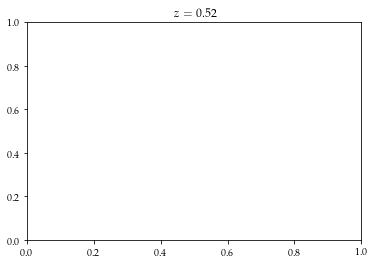

In [84]:
plt.figure()
#plt.title('$< 10^9 M_{\rm 200m}$ ')
#plt.title('$M_{\rm 500c} = 1.06 \times 10^{14} h^{-1} M_{\odot}$')
plt.title('$z = 0.52$ ')

plt.show()

In [46]:
#Running and saving for Sam:

print(np.shape(cov_list_i))
r = bin_stack_i## some array of length N corresponding to r values
rho = profiles#Yi_avg_list_i## some array of length N corresponding density values
cov = covs#cov_list_i## N*N covariance matrix
profile = np.empty(3, dtype=object)
profile[0]=r
profile[1]=rho
profile[2]=cov
print(R_avg_i)
np.save("Galaxy_Profiles_e14.npy", profile, allow_pickle=True)

(4, 20, 20)
0.8701007239330811


# Rsp v Mass Plots

Number of halos with mass > 31622776601683.797: 321
Number of halos with mass > 50118723362727.25: 220
Number of halos with mass > 100000000000000.0: 89

Halo: 108
Halo Mass: 9763.695
N Subhalos from Illustris Algorithm: 768 1815.7990219593048
R500c, R200c, R200m: 0.267284029646739 0.4277241554215666 0.5814296257295761
Rscale 0.5814296257295761
before dev loop: 1815.8102419376373
566208 566208 time 1815.8348641395569
N Subhalos within 7*R200m: 368 1815.8830659389496
galaxies 0 [ 0.  1.  2.  1.  3.  4.  6.  5.  6.  9. 21. 13. 13. 14. 21. 44. 22. 25.
 67. 87.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  0.  2.  5.  3.  2.  5. 12. 24. 15. 23.
 37. 57.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 2. 1. 0. 1. 1. 5. 1. 1. 7. 4.]
galaxies 3 [ 0.  1.  2.  1.  3.  4.  6.  4.  6.  6. 14.  9. 11.  8.  8. 15.  6.  1.
 23. 26.]

Halo: 139
Halo Mass: 8893.031
N Subhalos from Illustris Algorithm: 926 1815.8872287273407
R500c, R200c, R200m: 0.2630793913708331 0.4094901042196601 0.5141267886823278
Rscal

566208 566208 time 1816.7555029392242
N Subhalos within 7*R200m: 523 1816.8032460212708
galaxies 0 [  1.   0.   0.   1.   1.   1.   3.   3.   6.  11.   9.  17.  11.  19.
  17.  78.  89.  78.  58. 115.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  2.  1.  4.  4. 10.  9. 13. 10. 23. 36. 43.
 48. 75.]
galaxies 2 [ 1.  0.  0.  0.  0.  1.  1.  0.  0.  0.  1.  2.  0.  1.  1.  6. 10.  6.
  2. 10.]
galaxies 3 [ 0.  0.  0.  1.  1.  0.  2.  1.  5.  7.  4.  5.  2.  5.  6. 49. 43. 29.
  8. 30.]

Halo: 233
Halo Mass: 6026.4443
N Subhalos from Illustris Algorithm: 597 1816.809210062027
R500c, R200c, R200m: 0.27941981302134156 0.43607834456824685 0.5426424876937487
Rscale 0.5426424876937487
before dev loop: 1816.8150799274445
566208 566208 time 1816.8395478725433
N Subhalos within 7*R200m: 279 1816.8825137615204
galaxies 0 [ 1.  1.  1.  4.  3.  2.  6. 10.  5.  1.  6. 19. 23. 10. 13. 10. 17. 19.
 69. 56.]
galaxies 1 [ 1.  1.  0.  1.  1.  0.  3.  5.  4.  1.  3. 11. 14.  4. 11.  8. 15. 15.
 38. 40.]
galaxie

before dev loop: 1817.5979759693146
566208 566208 time 1817.6175427436829
N Subhalos within 7*R200m: 273 1817.6569430828094
galaxies 0 [ 0.  2.  2.  3.  1.  2.  3.  1. 11.  2.  8.  8.  8.  7. 34. 17.  9. 46.
 45. 60.]
galaxies 1 [ 0.  1.  0.  1.  0.  1.  0.  0.  6.  0.  2.  2.  4.  4. 21. 10.  9. 29.
 29. 48.]
galaxies 2 [0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 4. 1. 0. 4. 3. 2.]
galaxies 3 [ 0.  1.  1.  2.  1.  1.  2.  1.  4.  1.  6.  5.  4.  3.  9.  6.  0. 13.
 13. 10.]

Halo: 296
Halo Mass: 5273.228
N Subhalos from Illustris Algorithm: 498 1817.6594018936157
R500c, R200c, R200m: 0.26815423849967684 0.4309768745292195 0.5593085495719754
Rscale 0.5593085495719754
before dev loop: 1817.6641709804535
566208 566208 time 1817.6836698055267
N Subhalos within 7*R200m: 240 1817.7238948345184
galaxies 0 [ 1.  1.  2.  1.  1.  2.  6.  6.  6. 12. 15.  9.  9. 14. 11. 12. 18. 15.
 31. 65.]
galaxies 1 [ 0.  0.  0.  0.  1.  0.  1.  1.  0.  4.  6.  4.  7.  8.  8.  7. 16. 12.
 29. 47.]
galaxies 2 [0

566208 566208 time 1818.6350467205048
N Subhalos within 7*R200m: 353 1818.6736040115356
galaxies 0 [  0.   1.   0.   1.   5.   4.   0.   3.   9.   6.   9.   5.   6.   5.
   2.  19.  17.  47.  98. 114.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  3.  0.  1.  3.  4.  5.  2. 16. 16. 31.
 59. 78.]
galaxies 2 [0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 2. 8. 6.]
galaxies 3 [ 0.  0.  0.  1.  4.  4.  0.  2.  6.  6.  8.  2.  2.  0.  0.  2.  1. 14.
 31. 30.]

Halo: 342
Halo Mass: 4625.739
N Subhalos from Illustris Algorithm: 430 1818.6763319969177
R500c, R200c, R200m: 0.2904058670033052 0.45614048892460335 0.58035598181183
Rscale 0.58035598181183
before dev loop: 1818.6811938285828
566208 566208 time 1818.699439048767
N Subhalos within 7*R200m: 243 1818.7376248836517
galaxies 0 [ 0.  1.  1.  5.  4.  4.  6.  9. 10. 13.  5.  8.  6.  6.  6. 13. 11. 31.
 28. 71.]
galaxies 1 [ 0.  0.  0.  0.  0.  2.  2.  1.  2.  6.  3.  5.  3.  5.  5. 10. 11. 27.
 24. 60.]
galaxies 2 [0. 0. 0. 0. 0. 1. 0. 0

566208 566208 time 1819.5235209465027
N Subhalos within 7*R200m: 181 1819.5606939792633
galaxies 0 [ 2.  1.  1.  1.  2.  3.  3.  6.  7.  6.  6. 10.  7.  3.  8.  6. 19. 13.
 36. 39.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  2.  2.  1.  3.  3.  3.  8.  6. 13.  9.
 26. 36.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 2. 2. 0.]
galaxies 3 [2. 1. 1. 1. 2. 3. 3. 4. 5. 3. 4. 6. 4. 0. 0. 0. 5. 2. 8. 3.]

Halo: 370
Halo Mass: 4697.962
N Subhalos from Illustris Algorithm: 348 1819.5627098083496
R500c, R200c, R200m: 0.32278052681998626 0.4738319932410861 0.5777575057090173
Rscale 0.5777575057090173
before dev loop: 1819.5679547786713
566208 566208 time 1819.5879757404327
N Subhalos within 7*R200m: 139 1819.6263411045074
galaxies 0 [ 1.  4.  3.  6.  3.  6.  4.  4.  7.  1.  3.  3.  4.  3.  6.  6.  8. 10.
 19. 35.]
galaxies 1 [ 0.  0.  0.  2.  1.  0.  0.  1.  1.  0.  1.  2.  4.  3.  3.  6.  8.  8.
 16. 29.]
galaxies 2 [0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1

566208 566208 time 1820.3792219161987
N Subhalos within 7*R200m: 312 1820.416599035263
galaxies 0 [  1.   1.   0.   2.   4.   6.   4.   7.  10.   6.   3.   2.   2.   3.
   7.  22.  39.  38.  49. 104.]
galaxies 1 [ 0.  1.  0.  1.  2.  4.  1.  2.  7.  3.  0.  2.  2.  3.  7. 16. 23. 27.
 39. 75.]
galaxies 2 [0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 4. 1. 3. 2. 5.]
galaxies 3 [ 1.  0.  0.  1.  1.  2.  2.  4.  3.  3.  3.  0.  0.  0.  0.  2. 15.  8.
  8. 24.]

Halo: 386
Halo Mass: 4510.9404
N Subhalos from Illustris Algorithm: 392 1820.418926000595
R500c, R200c, R200m: 0.2978745541366113 0.4541780801856937 0.5624423663589592
Rscale 0.5624423663589592
before dev loop: 1820.4236640930176
566208 566208 time 1820.4399478435516
N Subhalos within 7*R200m: 116 1820.478308916092
galaxies 0 [ 2.  1.  1.  0.  3.  4.  2.  9.  3.  5.  7.  6.  4.  3.  2.  6.  2. 19.
 12. 21.]
galaxies 1 [ 0.  0.  0.  0.  1.  2.  0.  4.  0.  3.  5.  2.  2.  3.  2.  6.  2. 16.
 10. 21.]
galaxies 2 [0. 0. 1. 0. 0. 1. 0.

566208 566208 time 1821.451733827591
N Subhalos within 7*R200m: 235 1821.4940557479858
galaxies 0 [ 1.  2.  0.  1.  1.  1.  6.  7.  7.  6.  8.  5.  4. 10.  5.  8. 11. 23.
 61. 66.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  3.  1.  2.  0.  3.  1.  8.  5.  7.  8. 15.
 32. 47.]
galaxies 2 [0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 6. 6.]
galaxies 3 [ 1.  2.  0.  1.  1.  0.  6.  4.  5.  3.  7.  2.  3.  2.  0.  1.  2.  7.
 23. 13.]

Halo: 404
Halo Mass: 4505.2295
N Subhalos from Illustris Algorithm: 443 1821.4967260360718
R500c, R200c, R200m: 0.24819206016847553 0.4111368012747997 0.5150460997899123
Rscale 0.5150460997899123
before dev loop: 1821.5020899772644
566208 566208 time 1821.5196328163147
N Subhalos within 7*R200m: 347 1821.557532787323
galaxies 0 [ 0.  3.  3.  1.  1.  2.  4.  4.  9.  2.  5.  2.  1.  4. 25. 24. 32. 81.
 98. 45.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  1.  6.  2.  5.  1.  0.  2. 12. 12. 16. 23.
 51. 40.]
galaxies 2 [0. 1. 0. 0. 0. 0. 1. 0. 2. 0. 0. 0. 0.

566208 566208 time 1822.3328750133514
N Subhalos within 7*R200m: 133 1822.3687989711761
galaxies 0 [ 0.  1.  1.  2.  1.  1.  4.  4.  7. 11.  2.  6.  8.  3.  3.  7.  7.  9.
 26. 29.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  3.  0.  4.  1.  2.  3.  3.  2.  6.  5.  7.
 20. 23.]
galaxies 2 [0. 0. 0. 0. 1. 0. 2. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1.]
galaxies 3 [0. 1. 1. 2. 0. 1. 2. 1. 6. 6. 1. 4. 4. 0. 1. 1. 1. 2. 5. 5.]

Halo: 418
Halo Mass: 4209.2764
N Subhalos from Illustris Algorithm: 349 1822.3713479042053
R500c, R200c, R200m: 0.288226951951204 0.4442950153743552 0.5558996560693964
Rscale 0.5558996560693964
before dev loop: 1822.376520872116
566208 566208 time 1822.39430975914
N Subhalos within 7*R200m: 306 1822.4317507743835
galaxies 0 [  0.   2.   1.   1.   3.   1.   6.   7.   5.   3.   3.  10.   4.   6.
   4.  13.  32.  36.  61. 107.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  2.  3.  1.  1.  2.  6.  0.  5.  3.  9. 13. 21.
 43. 61.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1

566208 566208 time 1823.200716972351
N Subhalos within 7*R200m: 172 1823.2369248867035
galaxies 0 [ 1.  0.  1.  2.  4.  3.  2.  3.  7.  7.  5.  2.  2.  0.  3.  4. 15. 33.
 36. 41.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  2.  0.  0.  1.  1.  2.  1.  0.  3.  4. 10. 29.
 32. 34.]
galaxies 2 [0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 2. 1. 0. 2.]
galaxies 3 [1. 0. 0. 2. 4. 2. 0. 3. 7. 5. 4. 0. 1. 0. 0. 0. 3. 3. 4. 5.]

Halo: 434
Halo Mass: 4294.126
N Subhalos from Illustris Algorithm: 313 1823.2390048503876
R500c, R200c, R200m: 0.28671358963646465 0.4504412244572151 0.5659029843727519
Rscale 0.5659029843727519
before dev loop: 1823.24387383461
566208 566208 time 1823.2638330459595
N Subhalos within 7*R200m: 128 1823.3033180236816
galaxies 0 [ 1.  1.  1.  0.  0.  1.  4.  3.  2.  4.  7.  7.  3.  2.  4.  3. 10.  9.
 24. 40.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  0.  0.  3.  1.  3.  1.  1.  3.  3.  9.  8.
 21. 24.]
galaxies 2 [0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 3.]


N Subhalos within 7*R200m: 181 1824.081785917282
galaxies 0 [ 1.  1.  1.  0.  2.  2.  4.  4.  5.  7.  8.  8.  3.  1.  8.  4. 15. 19.
 33. 53.]
galaxies 1 [ 0.  0.  0.  0.  2.  0.  1.  0.  1.  2.  2.  1.  1.  0.  7.  1. 10. 16.
 32. 43.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 2.]
galaxies 3 [1. 1. 1. 0. 0. 2. 3. 4. 3. 5. 6. 7. 2. 1. 0. 2. 4. 2. 1. 8.]

Halo: 447
Halo Mass: 4102.084
N Subhalos from Illustris Algorithm: 347 1824.0838770866394
R500c, R200c, R200m: 0.28419298054163233 0.4320703355004105 0.5289767277070742
Rscale 0.5289767277070742
before dev loop: 1824.088928937912
566208 566208 time 1824.1055626869202
N Subhalos within 7*R200m: 146 1824.1431217193604
galaxies 0 [ 0.  1.  0.  1.  4.  7.  1.  4.  5.  4.  2.  3.  6.  7. 14.  8.  6. 15.
 20. 37.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  0.  2.  2.  1.  1.  2.  3.  4. 10.  6.  6. 13.
 16. 27.]
galaxies 2 [0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 2.]
galaxies 3 [0. 0. 0. 1. 4. 5. 1. 1. 3

N Subhalos within 7*R200m: 143 1824.9568319320679
galaxies 0 [ 0.  1.  0.  1.  4.  1.  5.  4.  1.  6.  2.  2.  3.  1.  7. 30. 11. 12.
 19. 29.]
galaxies 1 [ 0.  1.  0.  1.  1.  0.  2.  0.  1.  1.  0.  1.  2.  0.  7. 11.  8. 12.
 18. 29.]
galaxies 2 [0. 0. 0. 0. 0. 0. 2. 1. 0. 0. 1. 0. 0. 1. 0. 3. 1. 0. 0. 0.]
galaxies 3 [ 0.  0.  0.  0.  3.  1.  1.  3.  0.  5.  1.  1.  1.  0.  0. 16.  2.  0.
  1.  0.]

Halo: 463
Halo Mass: 3976.9045
N Subhalos from Illustris Algorithm: 359 1824.9593651294708
R500c, R200c, R200m: 0.26515383652199614 0.41969564653705593 0.5181396819532353
Rscale 0.5181396819532353
before dev loop: 1824.9642169475555
566208 566208 time 1824.982351064682
N Subhalos within 7*R200m: 386 1825.0206859111786
galaxies 0 [ 0.  0.  1.  4.  1.  3.  1.  4.  3.  4.  6.  3.  9.  4.  5. 22. 67. 93.
 65. 88.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  3.  3.  7.  4.  3.  7. 17. 31.
 35. 60.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 1. 0. 0. 1. 5. 9. 4. 6.]
galaxies 3 [ 

566208 566208 time 1825.7834920883179
N Subhalos within 7*R200m: 211 1825.821613073349
galaxies 0 [ 0.  2.  0.  0.  2.  2.  0.  4. 10.  4.  5.  3.  6.  4. 13. 14. 11. 17.
 58. 55.]
galaxies 1 [ 0.  0.  0.  0.  1.  1.  0.  2.  4.  0.  1.  1.  4.  3. 10. 13. 10.  9.
 33. 39.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 1. 0. 2. 0. 0. 1. 5. 4.]
galaxies 3 [ 0.  2.  0.  0.  1.  1.  0.  2.  4.  4.  4.  2.  1.  1.  1.  1.  1.  7.
 20. 12.]

Halo: 478
Halo Mass: 4047.0488
N Subhalos from Illustris Algorithm: 380 1825.823665857315
R500c, R200c, R200m: 0.24817734750758463 0.4084007667969637 0.5375653185667235
Rscale 0.5375653185667235
before dev loop: 1825.8287789821625
566208 566208 time 1825.8474729061127
N Subhalos within 7*R200m: 193 1825.8853969573975
galaxies 0 [ 1.  1.  2.  1.  3.  2.  7.  2.  9.  7.  7.  7.  6.  7. 13.  6.  8. 20.
 27. 54.]
galaxies 1 [ 0.  1.  2.  1.  0.  1.  2.  0.  4.  2.  3.  2.  4.  5. 11.  6.  8. 17.
 25. 46.]
galaxies 2 [0. 0. 0. 0. 0. 0. 1. 0. 0. 2. 0. 0. 2.

N Subhalos within 7*R200m: 494 1826.6807749271393
galaxies 0 [  1.   3.   2.   4.   5.   3.   9.   6.   2.   7.   4.   2.   1.   4.
   2.  16.  22.  69. 101. 229.]
galaxies 1 [ 0.  1.  1.  0.  1.  2.  3.  4.  1.  3.  1.  2.  0.  4.  2. 13.  9. 38.
 50. 85.]
galaxies 2 [ 0.  1.  0.  1.  0.  0.  0.  1.  0.  1.  0.  0.  0.  0.  0.  2.  1.  4.
 11. 24.]
galaxies 3 [  1.   1.   1.   3.   4.   1.   6.   1.   1.   3.   3.   0.   1.   0.
   0.   1.  12.  27.  40. 120.]

Halo: 496
Halo Mass: 3667.9478
N Subhalos from Illustris Algorithm: 260 1826.683032989502
R500c, R200c, R200m: 0.2849703695189906 0.43773825299234964 0.5422606390962597
Rscale 0.5422606390962597
before dev loop: 1826.6880009174347
566208 566208 time 1826.7101879119873
N Subhalos within 7*R200m: 508 1826.752082824707
galaxies 0 [  0.   0.   0.   1.   0.   3.   3.   6.   5.   4.   7.   4.   3.   4.
  23.  38. 112. 114. 107.  71.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  2.  2.  0.  3.  2.  2.  1.  2. 12. 25. 28. 54.
 36. 48.]
galaxie

galaxies 0 [  1.   1.   0.   1.   1.   1.   3.   4.   7.   6.  10.   3.   4.   6.
  15.  43.  60.  96.  99. 138.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  1.  4.  3.  8.  2.  4.  2.  4.  9. 19. 23.
 36. 59.]
galaxies 2 [ 0.  1.  0.  0.  0.  1.  1.  0.  1.  0.  0.  0.  0.  1.  0.  1.  3. 11.
  8. 13.]
galaxies 3 [ 1.  0.  0.  1.  1.  0.  1.  3.  2.  3.  2.  1.  0.  3. 11. 33. 38. 62.
 55. 66.]

Halo: 510
Halo Mass: 3669.203
N Subhalos from Illustris Algorithm: 260 1827.537309885025
R500c, R200c, R200m: 0.27215109797279724 0.4268186962341677 0.5294707128029452
Rscale 0.5294707128029452
before dev loop: 1827.5420427322388
566208 566208 time 1827.560301065445
N Subhalos within 7*R200m: 243 1827.6094439029694
galaxies 0 [ 1.  1.  1.  1.  1.  6.  3.  5.  6.  6.  3.  5.  6.  0.  4. 15. 32. 35.
 64. 47.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  1.  1.  3.  0.  0.  1.  3.  0.  4. 10. 14. 20.
 42. 39.]
galaxies 2 [0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 3. 1. 7. 1.]
galaxies 3 [ 1.  0.  1.  

566208 566208 time 1828.3878099918365
N Subhalos within 7*R200m: 235 1828.424350976944
galaxies 0 [ 0.  1.  2.  2.  3.  2.  6.  2.  2.  8.  5.  5.  5.  2.  6. 14. 17. 54.
 38. 59.]
galaxies 1 [ 0.  0.  1.  1.  2.  2.  1.  0.  0.  5.  5.  4.  5.  2.  5.  9. 13. 24.
 27. 47.]
galaxies 2 [0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 6. 2. 3.]
galaxies 3 [ 0.  1.  0.  1.  0.  0.  5.  2.  1.  3.  0.  1.  0.  0.  1.  4.  3. 24.
  9.  9.]

Halo: 524
Halo Mass: 3686.9731
N Subhalos from Illustris Algorithm: 415 1828.4265677928925
R500c, R200c, R200m: 0.2734023947686476 0.424483566752689 0.5347449314997798
Rscale 0.5347449314997798
before dev loop: 1828.431499004364
566208 566208 time 1828.4475808143616
N Subhalos within 7*R200m: 143 1828.4841299057007
galaxies 0 [ 0.  1.  1.  0.  2.  2.  2.  2.  5.  6. 10.  4.  3.  4.  9.  7. 18. 11.
 30. 24.]
galaxies 1 [ 0.  0.  0.  0.  0.  2.  0.  1.  2.  2.  4.  2.  3.  4.  8.  7. 18.  8.
 18. 20.]
galaxies 2 [0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

566208 566208 time 1829.2512519359589
N Subhalos within 7*R200m: 150 1829.287781715393
galaxies 0 [ 0.  2.  2.  2.  1.  1.  3.  6.  1.  6.  3.  9.  3.  2.  5.  4.  5. 10.
 13. 69.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  3.  1.  5.  1.  1.  3.  4.  5.  9.
 11. 54.]
galaxies 2 [0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 2. 3.]
galaxies 3 [ 0.  2.  2.  1.  0.  1.  3.  6.  1.  3.  2.  4.  2.  1.  1.  0.  0.  1.
  0. 12.]

Halo: 543
Halo Mass: 3638.7837
N Subhalos from Illustris Algorithm: 325 1829.2899508476257
R500c, R200c, R200m: 0.27963357697461194 0.4344065859465285 0.5378421567981805
Rscale 0.5378421567981805
before dev loop: 1829.294110774994
566208 566208 time 1829.3144130706787
N Subhalos within 7*R200m: 230 1829.351054906845
galaxies 0 [ 1.  1.  2.  0.  1.  8.  2.  1.  4.  4.  9.  1.  3. 12. 22. 16. 26. 31.
 34. 47.]
galaxies 1 [ 0.  0.  1.  0.  0.  1.  2.  1.  1.  1.  6.  1.  2.  8. 14.  7. 10. 19.
 28. 42.]
galaxies 2 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 

before dev loop: 1830.1177928447723
566208 566208 time 1830.138653755188
N Subhalos within 7*R200m: 315 1830.1751170158386
galaxies 0 [  0.   1.   1.   0.   1.   2.   3.   6.   3.   3.   1.   1.   6.   8.
  23.  17.  44.  17.  40. 137.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  3.  7.  9. 11.  8.
 24. 62.]
galaxies 2 [ 0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  1.  0.  0.  1.  2.  0.  4.  0.
  1. 13.]
galaxies 3 [ 0.  1.  1.  0.  1.  2.  3.  5.  2.  3.  0.  1.  6.  4. 14.  8. 29.  9.
 15. 62.]

Halo: 561
Halo Mass: 3490.9836
N Subhalos from Illustris Algorithm: 359 1830.1772599220276
R500c, R200c, R200m: 0.25961172729359333 0.41752698030451413 0.5267565371355757
Rscale 0.5267565371355757
before dev loop: 1830.1813187599182
566208 566208 time 1830.199836730957
N Subhalos within 7*R200m: 217 1830.2378370761871
galaxies 0 [ 0.  1.  2.  1.  2.  5.  4.  3.  7. 13.  2.  3.  6.  6.  5.  8. 19. 42.
 39. 48.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  2.  4.  2.  0.  1.  4.  5

N Subhalos within 7*R200m: 180 1830.9869599342346
galaxies 0 [ 2.  0.  1.  2.  1.  1.  5.  1.  2.  2.  3.  6.  7.  8.  4.  3.  4.  3.
 39. 83.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  0.  0.  2.  1.  1.  4.  6.  3.  2.  4.  1.
 17. 29.]
galaxies 2 [1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 4. 6.]
galaxies 3 [ 1.  0.  1.  1.  1.  0.  4.  1.  2.  0.  2.  4.  3.  1.  0.  0.  0.  1.
 18. 48.]

Halo: 574
Halo Mass: 3311.2502
N Subhalos from Illustris Algorithm: 244 1830.9890186786652
R500c, R200c, R200m: 0.2752749661986072 0.41760504748475147 0.5214457269501581
Rscale 0.5214457269501581
before dev loop: 1830.9930810928345
566208 566208 time 1831.0126769542694
N Subhalos within 7*R200m: 257 1831.0494949817657
galaxies 0 [ 1.  0.  1.  1.  0.  3.  5.  3.  1.  3.  5.  5.  1.  5.  8.  9. 15. 48.
 84. 56.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  3.  7.  8. 11. 30.
 41. 47.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 2. 7. 4.]
galaxies 3 [ 

N Subhalos within 7*R200m: 125 1831.8563339710236
galaxies 0 [ 0.  0.  4.  0.  4.  2.  3.  4.  7.  4.  6.  4.  4.  6.  6. 14.  7. 10.
 19. 19.]
galaxies 1 [ 0.  0.  1.  0.  2.  1.  2.  2.  2.  2.  3.  3.  4.  6.  5. 11.  5.  7.
 16. 19.]
galaxies 2 [0. 0. 2. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0.]
galaxies 3 [0. 0. 1. 0. 1. 1. 1. 2. 5. 2. 3. 1. 0. 0. 1. 2. 1. 3. 2. 0.]

Halo: 590
Halo Mass: 3364.7012
N Subhalos from Illustris Algorithm: 314 1831.8584480285645
R500c, R200c, R200m: 0.25314792490774735 0.3959086968220933 0.5001474388378075
Rscale 0.5001474388378075
before dev loop: 1831.8624079227448
566208 566208 time 1831.8817777633667
N Subhalos within 7*R200m: 118 1831.9176878929138
galaxies 0 [ 1.  0.  2.  1.  3.  1.  5.  4.  2.  2.  8.  6.  2.  4.  0.  6. 11.  7.
 16. 36.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  1.  0.  0.  0.  4.  2.  1.  3.  0.  6. 10.  7.
 11. 24.]
galaxies 2 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 2. 2.]
galaxies 3 [ 1.  0.  2.  0.  3.  0

N Subhalos within 7*R200m: 234 1832.742300748825
galaxies 0 [ 0.  0.  0.  0.  3.  4.  2.  8.  4. 10.  6.  4.  1.  7. 12. 38. 37. 19.
 29. 48.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  2.  1.  2.  1.  0.  1.  6.  7. 12. 25. 17.
 25. 43.]
galaxies 2 [0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 6. 2. 0. 2. 3.]
galaxies 3 [ 0.  0.  0.  0.  2.  3.  1.  6.  3.  7.  5.  3.  0.  0.  4. 20. 10.  2.
  2.  2.]

Halo: 610
Halo Mass: 3174.1768
N Subhalos from Illustris Algorithm: 209 1832.7451927661896
R500c, R200c, R200m: 0.2760304563310476 0.42249165262309474 0.5200860769115835
Rscale 0.5200860769115835
before dev loop: 1832.7493369579315
566208 566208 time 1832.768201828003
N Subhalos within 7*R200m: 270 1832.8051249980927
galaxies 0 [  1.   0.   1.   1.   2.   4.   2.   4.   3.   5.   1.   4.   5.   9.
  13.   8.  10.  16.  56. 124.]
galaxies 1 [ 0.  0.  1.  0.  2.  2.  1.  3.  0.  1.  1.  2.  3.  5. 12.  8.  6. 14.
 29. 54.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 8.

566208 566208 time 1833.597895860672
N Subhalos within 7*R200m: 165 1833.6372389793396
galaxies 0 [ 1.  1.  0.  0.  1.  3.  1.  3.  3.  8.  6.  9.  4.  1.  9. 17. 14. 12.
 27. 43.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  0.  3.  3.  2.  6.  1.  1.  5. 10.  8.  9.
 23. 28.]
galaxies 2 [0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 6.]
galaxies 3 [1. 1. 0. 0. 1. 3. 0. 3. 0. 4. 4. 3. 3. 0. 3. 6. 5. 2. 3. 9.]

Halo: 633
Halo Mass: 3120.761
N Subhalos from Illustris Algorithm: 242 1833.6393718719482
R500c, R200c, R200m: 0.2642031584217367 0.40079794423422926 0.5045450631867053
Rscale 0.5045450631867053
before dev loop: 1833.643539905548
566208 566208 time 1833.6632959842682
N Subhalos within 7*R200m: 136 1833.6997599601746
galaxies 0 [ 0.  0.  1.  1.  4.  2.  1.  4.  4.  3.  3.  4.  6.  5.  1. 10.  9. 21.
 21. 31.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  2.  2.  5.  1.  8.  8. 19.
 18. 28.]
galaxies 2 [0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 2.]

566208 566208 time 1834.4550409317017
N Subhalos within 7*R200m: 108 1834.4945750236511
galaxies 0 [ 2.  0.  1.  1.  0.  2.  0.  2.  2.  9.  9.  3.  4.  0.  2. 12. 11. 12.
 16. 17.]
galaxies 1 [ 0.  0.  1.  0.  0.  0.  0.  1.  0.  5.  4.  1.  3.  0.  2.  7.  9. 11.
 15. 14.]
galaxies 2 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 1. 1.]
galaxies 3 [1. 0. 0. 1. 0. 2. 0. 1. 2. 4. 4. 2. 0. 0. 0. 4. 1. 1. 0. 2.]

Halo: 660
Halo Mass: 2940.89
N Subhalos from Illustris Algorithm: 159 1834.497086763382
R500c, R200c, R200m: 0.2702409341929695 0.40684234570716943 0.5064163134797687
Rscale 0.5064163134797687
before dev loop: 1834.5015647411346
566208 566208 time 1834.5225458145142
N Subhalos within 7*R200m: 83 1834.5588998794556
galaxies 0 [ 0.  1.  0.  1.  0.  4.  4.  1.  3.  2.  5.  2.  1.  2.  6.  2.  3. 14.
 14. 16.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  1.  0.  0.  0.  2.  0.  1.  2.  4.  2.  2. 12.
 13. 16.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 2. 1. 0.]


N Subhalos within 7*R200m: 125 1835.3269119262695
galaxies 0 [ 1.  2.  0.  1.  5.  4.  2.  3.  3.  4.  4.  2.  0.  2.  5.  7. 11. 10.
 31. 25.]
galaxies 1 [ 1.  1.  0.  1.  0.  0.  1.  1.  2.  2.  1.  1.  0.  2.  5.  6. 10. 10.
 22. 21.]
galaxies 2 [0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 2. 1.]
galaxies 3 [0. 0. 0. 0. 5. 4. 1. 2. 1. 2. 2. 1. 0. 0. 0. 0. 1. 0. 7. 3.]

Halo: 686
Halo Mass: 2909.2983
N Subhalos from Illustris Algorithm: 214 1835.3288209438324
R500c, R200c, R200m: 0.2761185121069102 0.4098259532324863 0.5012922640101496
Rscale 0.5012922640101496
before dev loop: 1835.3332479000092
566208 566208 time 1835.3541469573975
N Subhalos within 7*R200m: 147 1835.3911459445953
galaxies 0 [ 1.  2.  2.  3.  3.  4.  5.  3.  1.  2.  4.  5.  3.  3.  0.  9.  4. 18.
 32. 40.]
galaxies 1 [ 0.  0.  0.  1.  1.  1.  2.  1.  0.  0.  0.  0.  1.  3.  0.  8.  4. 13.
 23. 29.]
galaxies 2 [0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 3. 2.]
galaxies 3 [1. 2. 2. 2. 1. 2. 3. 2.

N Subhalos within 7*R200m: 100 1836.2056159973145
galaxies 0 [ 1.  0.  1.  1.  0.  2.  0.  4.  4.  3.  5.  0.  2.  0.  4.  4.  4.  8.
 20. 36.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  0.  2.  0.  4.  0.  2.  0.  2.  3.  4.  7.
 18. 26.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 3.]
galaxies 3 [1. 0. 1. 1. 0. 2. 0. 3. 1. 3. 1. 0. 0. 0. 2. 1. 0. 0. 1. 7.]

Halo: 727
Halo Mass: 2880.832
N Subhalos from Illustris Algorithm: 278 1836.2080948352814
R500c, R200c, R200m: 0.2774604669179643 0.41324537579578446 0.5025261258024136
Rscale 0.5025261258024136
before dev loop: 1836.2120418548584
566208 566208 time 1836.2330238819122
N Subhalos within 7*R200m: 161 1836.2693479061127
galaxies 0 [ 0.  0.  1.  3.  5.  7.  8.  4.  7.  2.  2.  3.  5.  3.  2. 10.  8. 16.
 20. 53.]
galaxies 1 [ 0.  0.  0.  1.  0.  5.  1.  4.  5.  1.  1.  2.  4.  3.  1. 10.  8. 11.
 16. 44.]
galaxies 2 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 2. 2.]
galaxies 3 [0. 0. 1. 2. 4. 2. 7. 0.

/Users/TaraD/anaconda3/lib/python3.7/site-packages/scipy/signal/_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


<Figure size 720x576 with 0 Axes>

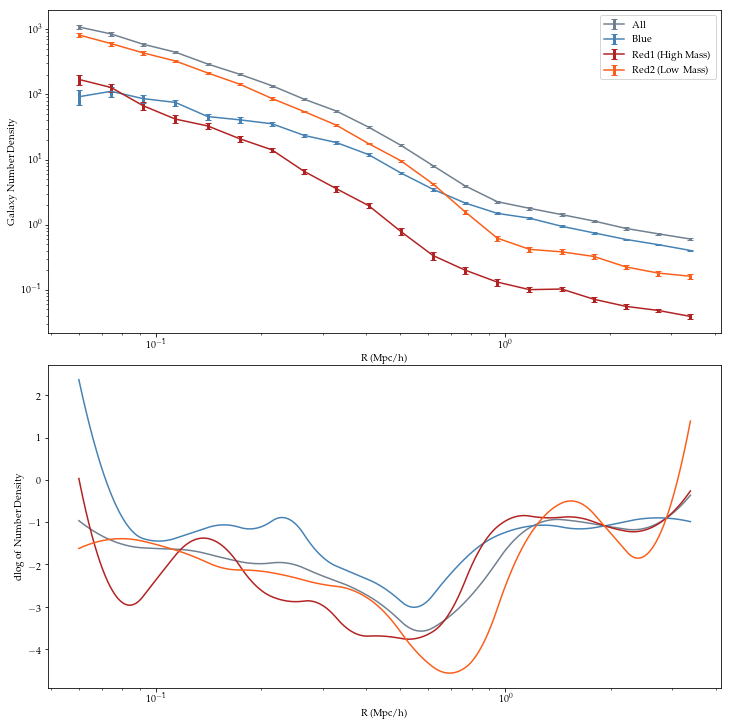

/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: overflow encountered in power
  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 11/5000 [00:00<00:47, 104.56it/s]

Running production...


100%|██████████| 5000/5000 [00:48<00:00, 102.73it/s]


Running burn-in...


  0%|          | 13/5000 [00:00<00:39, 125.89it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 13/5000 [00:00<00:40, 123.06it/s]

Running production...


100%|██████████| 5000/5000 [00:42<00:00, 116.56it/s]


Running burn-in...


  0%|          | 10/5000 [00:00<00:50, 99.73it/s]

Running production...


100%|██████████| 5000/5000 [00:48<00:00, 107.27it/s]


done MCMC
Progress: [------------------->] 100%count 0 = 0, count total = 10000
Progress: [------------------->] 100%count 1 = 539, count total = 10000
Progress: [------------------->] 100%count 2 = 848, count total = 10000
Progress: [------------------->] 100%count 3 = 0, count total = 10000


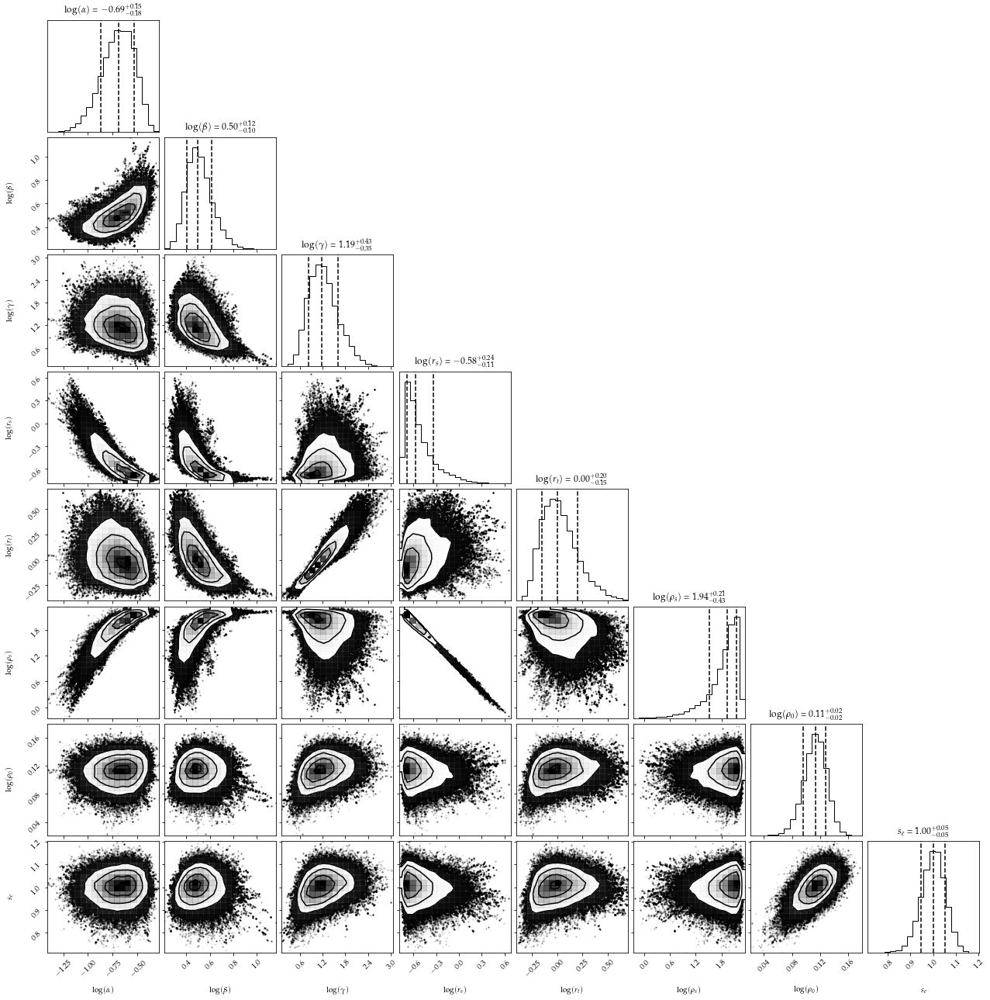

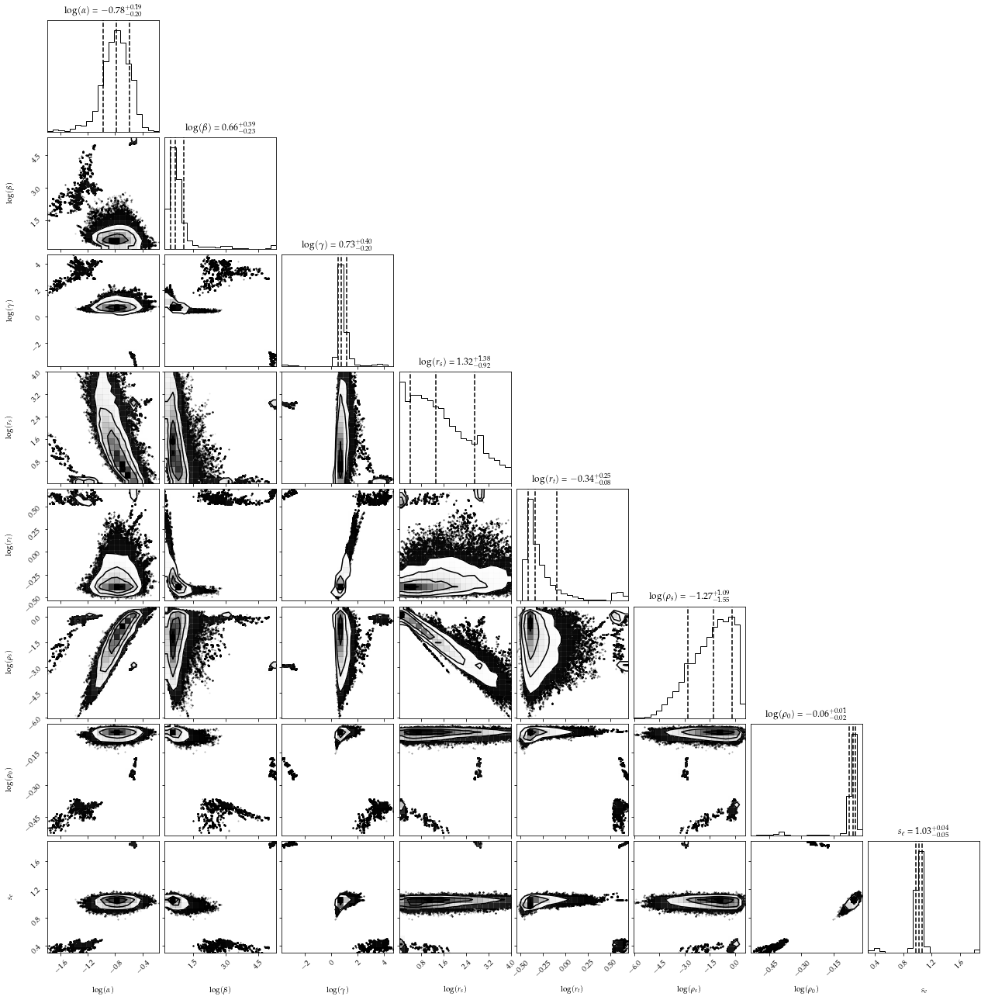

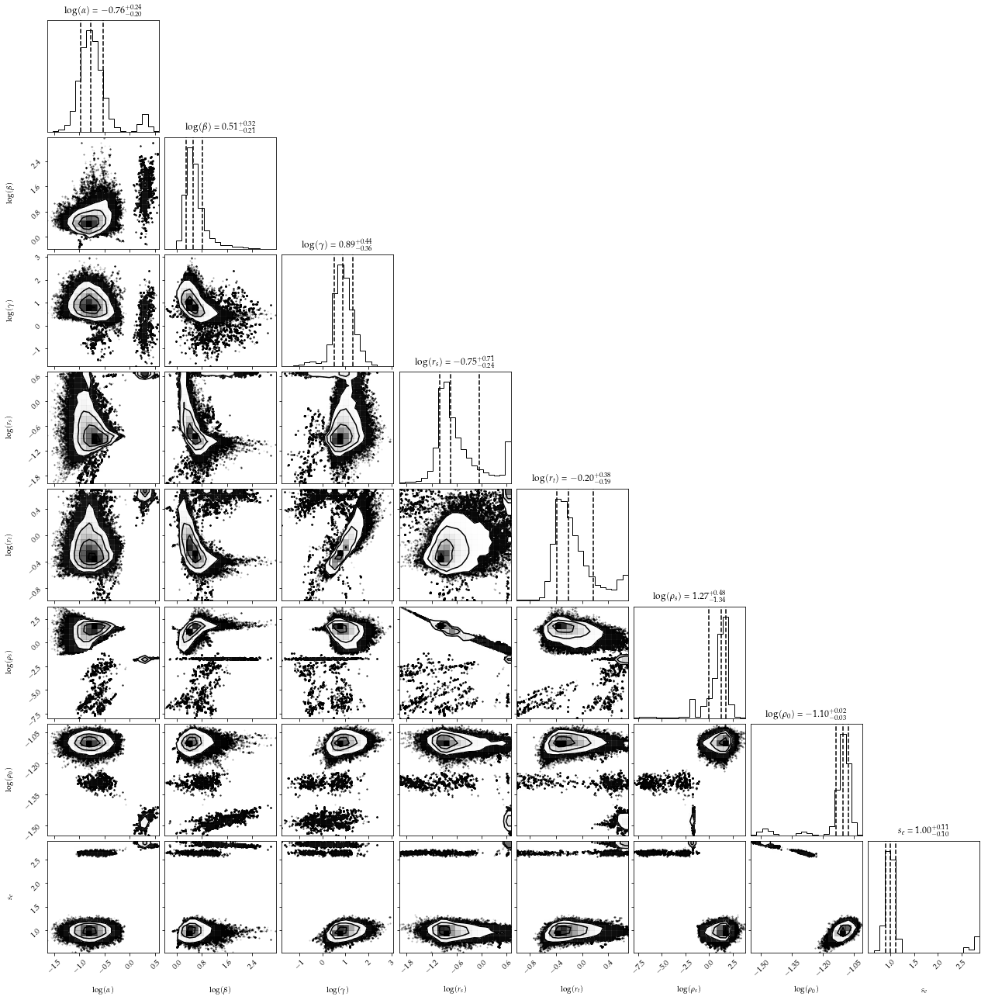

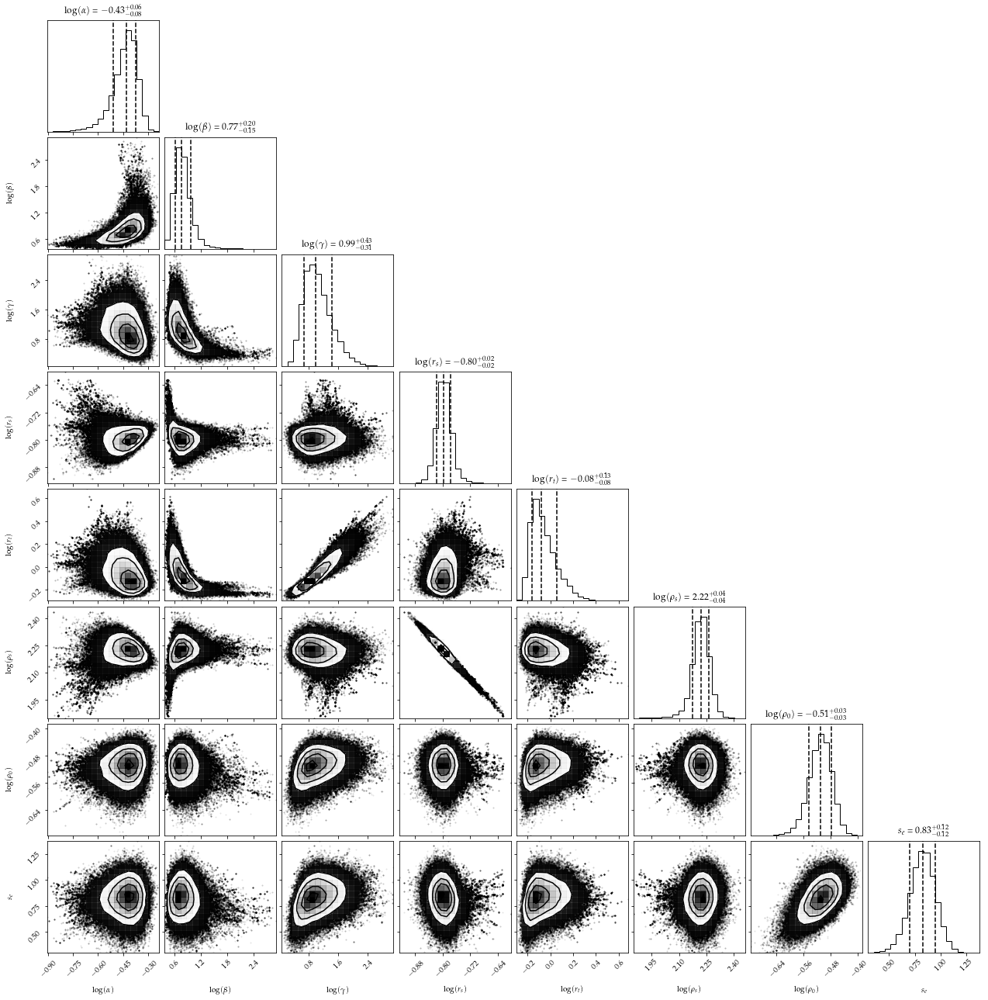

<Figure size 720x576 with 0 Axes>

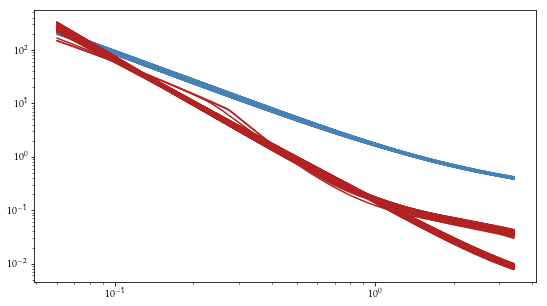

0 1.1788175231489972 0.03820459589157886
1 0.9192420112288515 0.2766083735407076
2 0.8311378067164824 0.2330976675327266
3 1.4076343443365698 0.05377148241312541


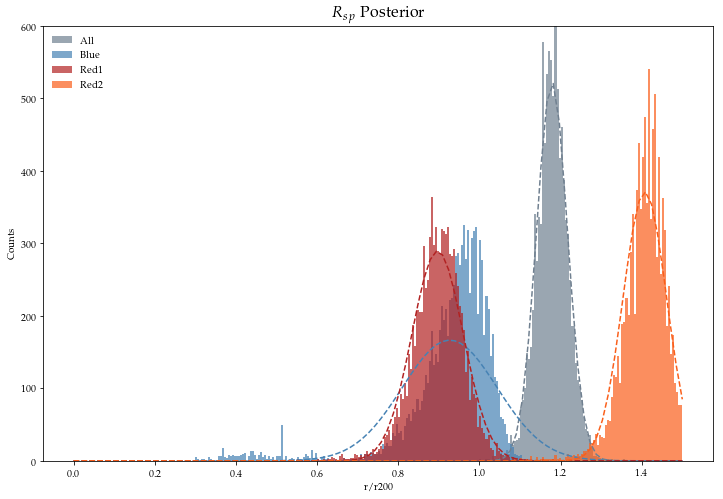

[1.1788175231489972, 0.926831552796275, 0.8969216946302013, 1.4076343443365698] [0.03820459589157886, 0.11696978794811513, 0.0631219930072268, 0.05377148241312541]
0 Means: [1.1788175231489972, 0.926831552796275, 0.8969216946302013, 1.4076343443365698] Sigs: [0.03820459589157886, 0.11696978794811513, 0.0631219930072268, 0.05377148241312541]


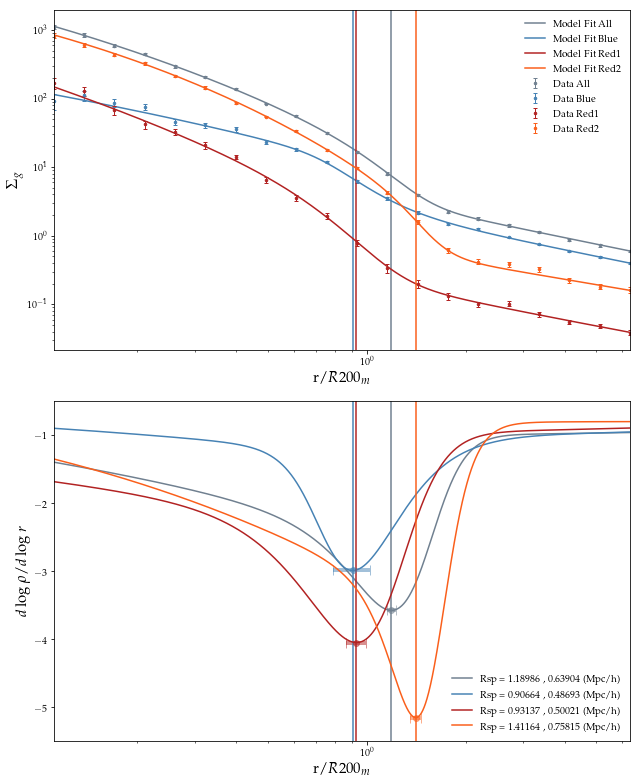

R_avg= 0.5370689493631483

Halo: 29
Halo Mass: 18336.77
N Subhalos from Illustris Algorithm: 1211 2974.8401930332184
R500c, R200c, R200m: 0.37254839425574054 0.582633141407676 0.7267309038611021
Rscale 0.7267309038611021
before dev loop: 2974.849748849869
566208 566208 time 2974.868033885956
N Subhalos within 7*R200m: 762 2974.90922999382
galaxies 0 [  1.   2.   5.   2.   1.   6.   7.  12.  12.   7.  13.   7.  25.  47.
  70.  41.  60. 104. 165. 169.]
galaxies 1 [  0.   0.   0.   0.   0.   1.   0.   2.   1.   0.   3.   1.   9.   4.
  15.  23.  39.  56.  81. 119.]
galaxies 2 [ 0.  1.  3.  0.  0.  0.  0.  1.  2.  0.  1.  2.  0.  6.  6.  2.  3.  5.
 16. 13.]
galaxies 3 [ 1.  1.  2.  2.  1.  5.  7.  9.  9.  7.  9.  4. 16. 37. 49. 16. 18. 43.
 68. 37.]

Halo: 34
Halo Mass: 16846.766
N Subhalos from Illustris Algorithm: 1203 2974.912503004074
R500c, R200c, R200m: 0.2652465563114473 0.4380927180250786 0.6004946320048191
Rscale 0.6004946320048191
before dev loop: 2974.9198257923126
566208 56620

566208 566208 time 2975.691487789154
N Subhalos within 7*R200m: 932 2975.7302069664
galaxies 0 [  2.   0.   1.   2.   3.   5.   9.   8.  14.  21.  21.  18.  15.  21.
  22.  10.  31. 117. 189. 415.]
galaxies 1 [  0.   0.   0.   0.   0.   1.   2.   5.   5.   8.   9.   8.   8.  12.
  11.   7.  25.  33.  55. 156.]
galaxies 2 [ 1.  0.  1.  0.  0.  0.  2.  0.  0.  2.  1.  0.  3.  1.  3.  0.  0. 15.
 13. 32.]
galaxies 3 [  1.   0.   0.   2.   3.   4.   5.   3.   9.  11.  11.  10.   4.   8.
   8.   3.   6.  69. 121. 227.]

Halo: 94
Halo Mass: 10289.019
N Subhalos from Illustris Algorithm: 856 2975.733435869217
R500c, R200c, R200m: 0.3173017320764785 0.5507157951293802 0.6841214365430489
Rscale 0.6841214365430489
before dev loop: 2975.7381727695465
566208 566208 time 2975.7534630298615
N Subhalos within 7*R200m: 549 2975.791166782379
galaxies 0 [  1.   1.   3.   6.   7.   8.   5.   5.  10.  12.  14.  13.  15.  27.
  23.  38.  24.  65. 131. 139.]
galaxies 1 [ 0.  0.  0.  0.  2.  1.  2.  2.  6.  

566208 566208 time 2976.562736749649
N Subhalos within 7*R200m: 404 2976.6001629829407
galaxies 0 [  3.   0.   1.   3.   7.   8.   8.   8.   5.  12.   9.   8.   5.  14.
  23.  32.  23.  44.  72. 116.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  3.  2.  1.  1.  2.  4.  2. 10. 16. 19. 19. 37.
 44. 81.]
galaxies 2 [0. 0. 0. 0. 2. 3. 1. 1. 0. 1. 1. 0. 1. 0. 3. 2. 1. 2. 5. 6.]
galaxies 3 [ 3.  0.  1.  3.  5.  5.  4.  5.  4. 10.  6.  4.  2.  4.  4. 11.  3.  5.
 23. 29.]

Halo: 117
Halo Mass: 9183.523
N Subhalos from Illustris Algorithm: 718 2976.602415084839
R500c, R200c, R200m: 0.372789681894351 0.5844826129591757 0.7274692192138902
Rscale 0.7274692192138902
before dev loop: 2976.6074318885803
566208 566208 time 2976.623622894287
N Subhalos within 7*R200m: 387 2976.660602092743
galaxies 0 [ 2.  2.  9.  3.  3.  7. 12. 20. 13. 10. 13. 13. 12.  8. 13. 15. 28. 36.
 64. 96.]
galaxies 1 [ 0.  0.  1.  1.  2.  1.  3.  5.  4.  7.  8.  7.  4.  8. 10. 13. 26. 31.
 55. 80.]
galaxies 2 [1. 0. 1. 0. 0. 1. 1. 2.

566208 566208 time 2977.4302797317505
N Subhalos within 7*R200m: 367 2977.4674186706543
galaxies 0 [ 0.  2.  1.  2.  5.  8. 10.  9.  7. 10. 11. 13. 17.  7.  6. 29. 21. 34.
 76. 93.]
galaxies 1 [ 0.  0.  0.  1.  1.  1.  1.  2.  1.  2.  2.  6.  8.  3.  5. 19. 15. 27.
 70. 73.]
galaxies 2 [0. 0. 1. 1. 0. 0. 1. 0. 2. 0. 0. 0. 1. 1. 0. 2. 2. 1. 3. 7.]
galaxies 3 [ 0.  2.  0.  0.  4.  7.  8.  7.  4.  8.  9.  7.  8.  3.  1.  8.  4.  6.
  3. 13.]

Halo: 132
Halo Mass: 8506.837
N Subhalos from Illustris Algorithm: 660 2977.469944000244
R500c, R200c, R200m: 0.3534979605208085 0.5626716036276971 0.7080698051660715
Rscale 0.7080698051660715
before dev loop: 2977.4747200012207
566208 566208 time 2977.4913878440857
N Subhalos within 7*R200m: 458 2977.528652906418
galaxies 0 [  3.   2.   0.   4.   3.   5.   7.   7.  13.  16.  15.  10.   6.   6.
  10.  22.  43.  81.  93. 107.]
galaxies 1 [ 0.  1.  0.  0.  0.  0.  1.  1.  3.  1.  3.  3.  5.  6.  9. 13. 21. 41.
 74. 91.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0.

566208 566208 time 2978.2822408676147
N Subhalos within 7*R200m: 442 2978.3198189735413
galaxies 0 [  0.   2.   1.   1.   4.   5.   5.   6.   9.  17.  12.   6.  12.  10.
  13.  17.  29.  46.  74. 165.]
galaxies 1 [  0.   0.   0.   0.   0.   0.   2.   1.   5.   5.   5.   1.   4.   7.
   9.  14.  24.  36.  57. 114.]
galaxies 2 [0. 1. 0. 0. 0. 0. 0. 1. 0. 3. 0. 1. 0. 1. 1. 1. 0. 4. 4. 8.]
galaxies 3 [ 0.  1.  1.  1.  4.  5.  3.  4.  4.  9.  7.  4.  8.  2.  3.  2.  5.  6.
 13. 43.]

Halo: 149
Halo Mass: 8279.199
N Subhalos from Illustris Algorithm: 669 2978.3219289779663
R500c, R200c, R200m: 0.3564033807625338 0.5670571776067224 0.7089757848013387
Rscale 0.7089757848013387
before dev loop: 2978.326815843582
566208 566208 time 2978.342992067337
N Subhalos within 7*R200m: 287 2978.3801188468933
galaxies 0 [ 4.  2.  1.  3.  6.  7. 11.  7. 12. 12. 17.  7.  3.  8. 14. 12. 21. 28.
 41. 70.]
galaxies 1 [ 1.  0.  0.  1.  1.  0.  3.  1.  1.  3.  8.  2.  1.  7. 12.  9. 12. 22.
 38. 57.]
galaxies 2 [

N Subhalos within 7*R200m: 443 2979.182181119919
galaxies 0 [  0.   4.   3.   3.   7.   8.   6.  13.  10.   9.  16.   7.   6.   8.
  13.  17.  21.  40.  99. 143.]
galaxies 1 [ 0.  0.  0.  1.  2.  3.  3.  6.  3.  0.  3.  5.  3.  8.  8. 13. 19. 33.
 65. 95.]
galaxies 2 [ 0.  0.  1.  0.  0.  1.  0.  1.  0.  1.  2.  0.  0.  0.  1.  0.  0.  3.
 10.  7.]
galaxies 3 [ 0.  4.  2.  2.  5.  4.  3.  6.  7.  8. 11.  2.  3.  0.  4.  4.  2.  4.
 24. 41.]

Halo: 164
Halo Mass: 7866.6455
N Subhalos from Illustris Algorithm: 695 2979.184476852417
R500c, R200c, R200m: 0.3497964952473708 0.5679393767778557 0.702229419257485
Rscale 0.702229419257485
before dev loop: 2979.189253091812
566208 566208 time 2979.205600976944
N Subhalos within 7*R200m: 530 2979.24290394783
galaxies 0 [  1.   3.   1.   6.   2.   3.   8.  15.  19.  20.   7.   5.   8.   5.
   9.  35.  56. 100.  98. 124.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  0.  4.  2.  4.  2.  2.  7.  5.  8. 25. 25. 28.
 56. 73.]
galaxies 2 [ 0.  1.  0.  0.  0.  1

N Subhalos within 7*R200m: 315 2980.042078971863
galaxies 0 [ 2.  2.  0.  5.  6.  6.  8. 12. 12. 10. 12.  5.  2.  5.  7. 24. 22. 29.
 58. 81.]
galaxies 1 [ 0.  0.  0.  0.  2.  0.  1.  0.  4.  5.  7.  2.  2.  3.  4. 21. 21. 22.
 42. 73.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 1. 1. 3. 0. 0. 4. 2.]
galaxies 3 [ 2.  2.  0.  5.  4.  6.  7. 10.  8.  5.  5.  3.  0.  1.  2.  0.  1.  7.
 12.  6.]

Halo: 181
Halo Mass: 7203.806
N Subhalos from Illustris Algorithm: 487 2980.0445737838745
R500c, R200c, R200m: 0.3417345175614866 0.5128303930769711 0.6381983977512092
Rscale 0.6381983977512092
before dev loop: 2980.0493879318237
566208 566208 time 2980.0663747787476
N Subhalos within 7*R200m: 251 2980.1028320789337
galaxies 0 [ 0.  1.  2.  1.  3.  5. 11.  3.  9.  8. 10.  3.  5. 12. 13.  8. 21. 18.
 47. 69.]
galaxies 1 [ 0.  0.  2.  0.  1.  1.  1.  1.  1.  0.  2.  1.  3.  7.  8.  8. 16. 18.
 34. 54.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 2. 0. 3. 4.]
galaxies 3 [ 0. 

N Subhalos within 7*R200m: 310 2980.9083409309387
galaxies 0 [ 0.  0.  4.  4.  2.  6. 10.  6. 10. 10. 10. 10. 13.  3.  8. 12. 34. 43.
 44. 78.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  3.  2.  1.  3.  2.  3.  4.  2.  8. 12. 27. 28.
 35. 59.]
galaxies 2 [ 0.  0.  0.  1.  1.  0.  0.  0.  0.  1.  0.  0.  2.  0.  0.  0.  1.  4.
  3. 10.]
galaxies 3 [ 0.  0.  4.  3.  1.  5.  7.  4.  9.  6.  8.  7.  7.  1.  0.  0.  6. 11.
  6.  9.]

Halo: 198
Halo Mass: 6816.1245
N Subhalos from Illustris Algorithm: 649 2980.910685777664
R500c, R200c, R200m: 0.30509052379543117 0.47337952387132076 0.5920286266353681
Rscale 0.5920286266353681
before dev loop: 2980.9156498908997
566208 566208 time 2980.9323041439056
N Subhalos within 7*R200m: 276 2980.9728560447693
galaxies 0 [  1.   1.   1.   2.   4.   2.   3.   3.   9.   1.   7.   6.   2.  15.
  22.  15.  18.  19.  30. 109.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  0.  0.  2.  0.  4.  3.  1. 10. 10.  6.  7. 12.
 22. 65.]
galaxies 2 [0. 1. 1. 0. 1. 1. 0. 0. 2. 0. 0. 

N Subhalos within 7*R200m: 281 2981.779576063156
galaxies 0 [ 0.  4.  1.  3.  5.  7.  6.  4.  9. 11.  7.  8. 12.  4. 14. 16. 19. 23.
 47. 77.]
galaxies 1 [ 0.  0.  0.  1.  2.  3.  2.  0.  2.  5.  0.  4.  7.  3. 12. 10. 16. 14.
 40. 61.]
galaxies 2 [0. 0. 0. 0. 0. 3. 1. 0. 2. 0. 0. 1. 0. 1. 0. 3. 0. 2. 2. 4.]
galaxies 3 [ 0.  4.  1.  2.  3.  1.  3.  4.  5.  6.  7.  3.  5.  0.  2.  3.  3.  7.
  5. 12.]

Halo: 215
Halo Mass: 6548.455
N Subhalos from Illustris Algorithm: 502 2981.783537864685
R500c, R200c, R200m: 0.3102551281643222 0.4878854468551546 0.6428702981266742
Rscale 0.6428702981266742
before dev loop: 2981.7890219688416
566208 566208 time 2981.809381008148
N Subhalos within 7*R200m: 260 2981.846505880356
galaxies 0 [ 0.  1.  1.  2.  4.  3.  6.  8.  3.  7. 19.  9.  2.  5.  7. 11. 11. 27.
 71. 61.]
galaxies 1 [ 0.  0.  0.  0.  1.  0.  1.  3.  0.  2.  4.  4.  0.  5.  5. 10. 11. 25.
 38. 50.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 3. 0. 0. 0. 0. 1. 0. 0. 7. 5.]
galaxies 3 [ 0.  1.

N Subhalos within 7*R200m: 217 2982.6478278636932
galaxies 0 [ 0.  2.  3.  2.  3.  7. 11.  8.  1.  8.  9.  5.  2.  3.  4.  5. 28. 18.
 27. 68.]
galaxies 1 [ 0.  0.  0.  0.  0.  2.  5.  2.  0.  3.  5.  1.  0.  3.  3.  3. 22. 17.
 20. 59.]
galaxies 2 [0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 3. 2.]
galaxies 3 [0. 1. 2. 2. 2. 5. 6. 6. 0. 4. 4. 4. 2. 0. 1. 1. 5. 1. 4. 7.]

Halo: 230
Halo Mass: 5808.349
N Subhalos from Illustris Algorithm: 398 2982.650094985962
R500c, R200c, R200m: 0.338700066282887 0.5111280080999289 0.6324279920636765
Rscale 0.6324279920636765
before dev loop: 2982.6548278331757
566208 566208 time 2982.6716918945312
N Subhalos within 7*R200m: 193 2982.7079768180847
galaxies 0 [ 3.  0.  2.  2.  6.  3.  4.  8.  1.  6.  9. 13.  4.  7.  4.  7. 10. 24.
 37. 39.]
galaxies 1 [ 0.  0.  0.  0.  1.  2.  1.  1.  0.  0.  3.  4.  3.  7.  4.  7.  7. 18.
 26. 31.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 2. 1. 2. 3.]
galaxies 3 [3. 0. 2. 2. 5. 1. 3. 6. 1.

N Subhalos within 7*R200m: 308 2983.5545740127563
galaxies 0 [  0.   1.   1.   2.   2.   4.   7.   6.  10.   7.  11.   5.   5.   6.
   3.   4.  11.  39. 120.  62.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  2.  1.  4.  4.  2.  3.  3.  4. 10. 17.
 53. 51.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 5. 8. 4.]
galaxies 3 [ 0.  1.  1.  2.  2.  4.  7.  4.  8.  6.  6.  1.  2.  3.  0.  0.  1. 17.
 59.  7.]

Halo: 250
Halo Mass: 5850.727
N Subhalos from Illustris Algorithm: 512 2983.5567049980164
R500c, R200c, R200m: 0.28499963470296674 0.47289826973099613 0.6134501808235908
Rscale 0.6134501808235908
before dev loop: 2983.5617110729218
566208 566208 time 2983.5786118507385
N Subhalos within 7*R200m: 446 2983.6166870594025
galaxies 0 [  2.   2.   3.   4.   2.   1.   0.   5.   9.  16.  11.   9.  16.   5.
  10.  18.  30.  45. 105. 150.]
galaxies 1 [ 1.  0.  0.  1.  0.  0.  0.  0.  3.  5.  1.  3. 11.  5.  7. 18. 22. 37.
 48. 88.]
galaxies 2 [0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 2. 0

566208 566208 time 2984.422717809677
N Subhalos within 7*R200m: 298 2984.459580898285
galaxies 0 [  1.   1.   3.   4.   4.   2.   8.   2.   3.   2.  13.   8.   4.  12.
   6.  11.  18.  26.  64. 104.]
galaxies 1 [ 0.  0.  0.  0.  2.  0.  3.  0.  2.  0.  4.  2.  2.  7.  5. 11. 17. 22.
 37. 50.]
galaxies 2 [0. 0. 1. 2. 1. 1. 2. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 4. 9.]
galaxies 3 [ 1.  1.  2.  2.  1.  1.  3.  2.  1.  1.  8.  6.  2.  4.  1.  0.  0.  3.
 23. 45.]

Halo: 271
Halo Mass: 5389.583
N Subhalos from Illustris Algorithm: 358 2984.4618079662323
R500c, R200c, R200m: 0.3341747320340112 0.4989794337181028 0.6199474920452618
Rscale 0.6199474920452618
before dev loop: 2984.466562986374
566208 566208 time 2984.4829199314117
N Subhalos within 7*R200m: 233 2984.5200939178467
galaxies 0 [ 2.  0.  2.  5.  2.  3.  7.  6.  4.  5. 13. 13. 12.  4.  7. 13. 33. 26.
 21. 53.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  0.  1.  3.  3.  4.  3.  3.  3.  4.  2. 18. 19.
 17. 42.]
galaxies 2 [0. 0. 0. 1. 0. 0. 0. 

566208 566208 time 2985.2833728790283
N Subhalos within 7*R200m: 290 2985.3202459812164
galaxies 0 [ 1.  0.  2.  3.  3.  3.  5.  4.  5.  9.  7.  3.  8.  1.  8.  9. 12. 60.
 47. 97.]
galaxies 1 [ 0.  0.  0.  1.  2.  1.  3.  1.  2.  1.  4.  0.  5.  1.  4.  6.  7. 40.
 43. 80.]
galaxies 2 [ 1.  0.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  2.  0.  1.  1.  1.  3.
  1. 10.]
galaxies 3 [ 0.  0.  2.  2.  1.  1.  1.  3.  3.  8.  3.  3.  1.  0.  3.  2.  4. 17.
  3.  7.]

Halo: 289
Halo Mass: 5268.219
N Subhalos from Illustris Algorithm: 453 2985.3226280212402
R500c, R200c, R200m: 0.2947966054265615 0.4896038456127583 0.6121466590858843
Rscale 0.6121466590858843
before dev loop: 2985.327377796173
566208 566208 time 2985.3435728549957
N Subhalos within 7*R200m: 240 2985.3798530101776
galaxies 0 [ 0.  0.  2.  1.  1.  5.  4.  8. 16.  8.  7.  3.  1.  3. 14.  6. 21. 34.
 39. 65.]
galaxies 1 [ 0.  0.  0.  0.  0.  2.  3.  2.  6.  2.  4.  1.  1.  2. 13.  5. 15. 23.
 35. 60.]
galaxies 2 [0. 0. 0. 0. 0. 1. 

566208 566208 time 2986.133400917053
N Subhalos within 7*R200m: 322 2986.1706988811493
galaxies 0 [ 0.  1.  4.  1.  5.  5.  4.  4. 13.  4.  3.  4.  6.  2.  5. 10. 18. 48.
 88. 93.]
galaxies 1 [ 0.  0.  0.  0.  1.  0.  0.  1.  5.  1.  2.  3.  4.  2.  4. 10. 17. 32.
 53. 65.]
galaxies 2 [ 0.  0.  0.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  4.
 10.  7.]
galaxies 3 [ 0.  1.  4.  1.  3.  4.  4.  2.  8.  3.  1.  1.  2.  0.  1.  0.  1. 12.
 25. 21.]

Halo: 310
Halo Mass: 5014.9004
N Subhalos from Illustris Algorithm: 357 2986.172903776169
R500c, R200c, R200m: 0.31482696242850344 0.4744959646176175 0.5871187214463078
Rscale 0.5871187214463078
before dev loop: 2986.1778848171234
566208 566208 time 2986.1957490444183
N Subhalos within 7*R200m: 182 2986.232246875763
galaxies 0 [ 3.  0.  1.  1.  1.  2.  5.  4.  7.  5.  8.  5.  5.  0.  3.  9. 12. 15.
 56. 36.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  1.  1.  0.  2.  2.  1.  2.  0.  3.  7. 11. 14.
 40. 30.]
galaxies 2 [0. 0. 0. 0. 0. 1. 

566208 566208 time 2987.051276922226
N Subhalos within 7*R200m: 274 2987.087862968445
galaxies 0 [ 0.  1.  2.  4.  3.  4.  8. 10.  5.  4.  6.  3.  2.  2.  7. 21. 16. 51.
 50. 68.]
galaxies 1 [ 0.  0.  0.  1.  0.  0.  2.  1.  2.  2.  5.  1.  1.  2.  7. 16. 10. 40.
 39. 57.]
galaxies 2 [0. 0. 0. 0. 0. 0. 1. 3. 0. 0. 0. 0. 0. 0. 0. 1. 1. 3. 3. 2.]
galaxies 3 [0. 1. 2. 3. 3. 4. 5. 6. 3. 2. 1. 2. 1. 0. 0. 4. 5. 8. 8. 9.]

Halo: 336
Halo Mass: 4971.3164
N Subhalos from Illustris Algorithm: 405 2987.0900168418884
R500c, R200c, R200m: 0.2874992857624892 0.4767803304147162 0.5884294894197184
Rscale 0.5884294894197184
before dev loop: 2987.0947749614716
566208 566208 time 2987.111274957657
N Subhalos within 7*R200m: 179 2987.147419691086
galaxies 0 [ 0.  1.  2.  0.  0.  2.  3. 11.  6. 13.  4.  5.  2.  3.  5. 10. 15.  8.
 32. 54.]
galaxies 1 [ 0.  0.  1.  0.  0.  0.  0.  3.  1.  3.  0.  2.  2.  2.  5.  9. 14.  6.
 26. 42.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 2. 3.]
g

566208 566208 time 2987.891139984131
N Subhalos within 7*R200m: 190 2987.927706003189
galaxies 0 [ 0.  0.  2.  3.  8.  4.  6. 11. 10.  4.  4.  2.  3.  4.  8.  8. 18. 14.
 34. 39.]
galaxies 1 [ 0.  0.  1.  1.  1.  1.  1.  3.  5.  1.  1.  1.  3.  4.  6.  6. 13. 14.
 30. 35.]
galaxies 2 [0. 0. 0. 0. 2. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 2. 0. 1. 2.]
galaxies 3 [0. 0. 1. 2. 5. 3. 4. 7. 5. 3. 3. 1. 0. 0. 1. 2. 3. 0. 3. 2.]

Halo: 361
Halo Mass: 4723.639
N Subhalos from Illustris Algorithm: 394 2987.930235862732
R500c, R200c, R200m: 0.29524707307375664 0.46798572226814317 0.5895762362457279
Rscale 0.5895762362457279
before dev loop: 2987.935141801834
566208 566208 time 2987.95174908638
N Subhalos within 7*R200m: 211 2987.987983942032
galaxies 0 [ 2.  2.  1.  1.  3.  2.  5.  4.  6.  4.  6.  5.  3.  8.  8. 16. 17. 18.
 24. 71.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  2.  4.  2.  1.  1.  2.  2.  6.  6.  9. 11. 15.
 19. 43.]
galaxies 2 [0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 2. 4.]
gal

/Users/TaraD/anaconda3/lib/python3.7/site-packages/scipy/signal/_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


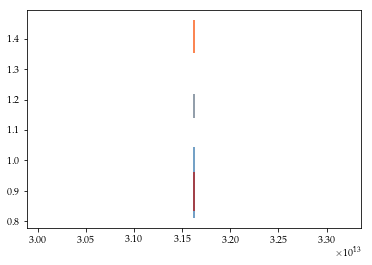

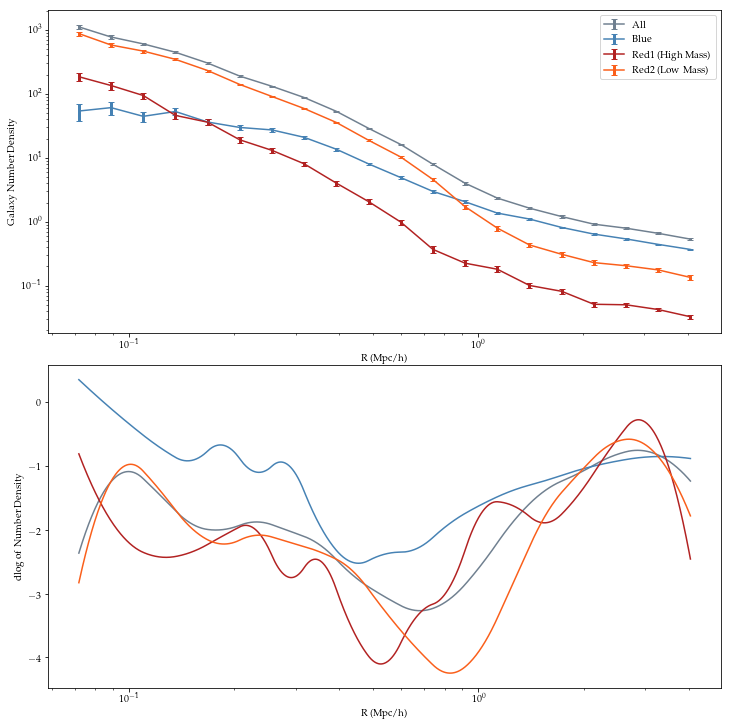

/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: overflow encountered in power
  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 12/5000 [00:00<00:42, 116.09it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 12/5000 [00:00<00:44, 111.55it/s]

Running production...


100%|██████████| 5000/5000 [00:44<00:00, 113.47it/s]


Running burn-in...


  0%|          | 10/5000 [00:00<00:52, 95.58it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 23/5000 [00:00<00:44, 111.15it/s]

Running production...


100%|██████████| 5000/5000 [00:46<00:00, 107.24it/s]


done MCMC
Progress: [------------------->] 100%count 0 = 0, count total = 10000
Progress: [------------------->] 100%count 1 = 373, count total = 10000
Progress: [------------------->] 100%count 2 = 284, count total = 10000
Progress: [------------------->] 100%count 3 = 0, count total = 10000


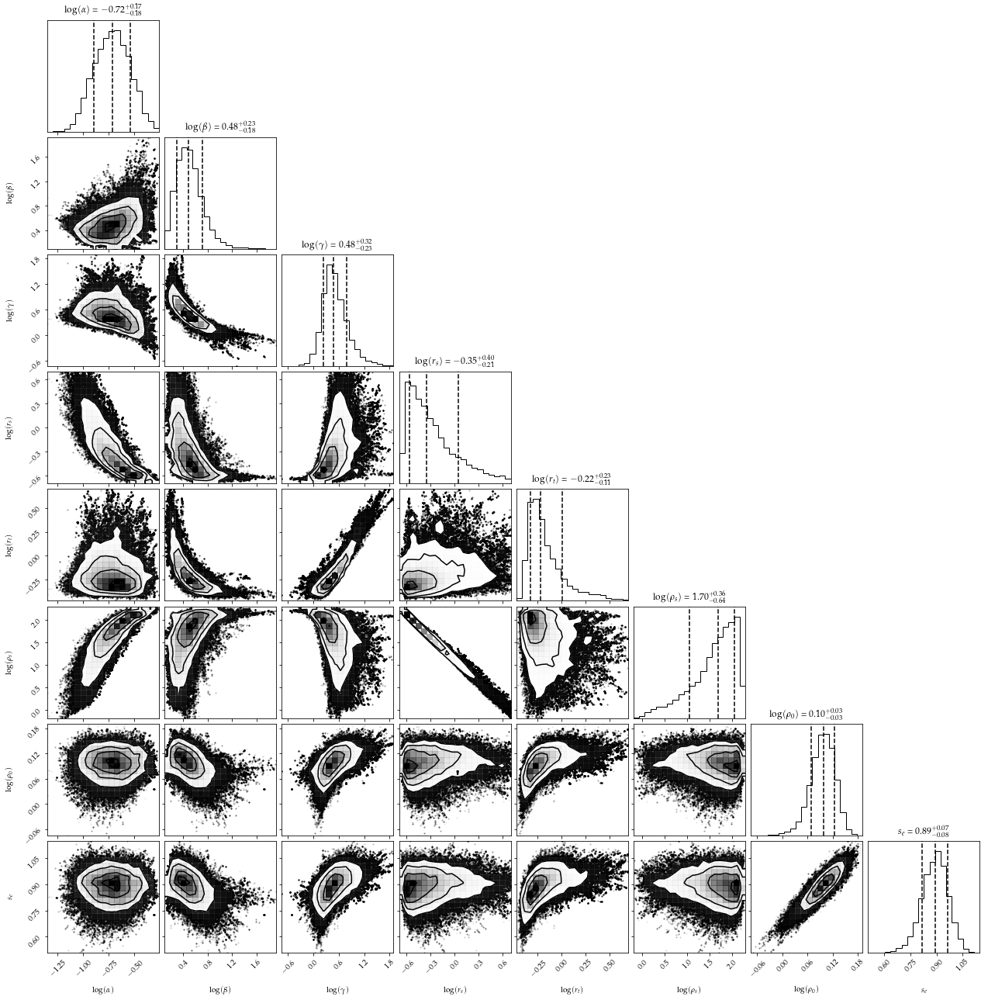

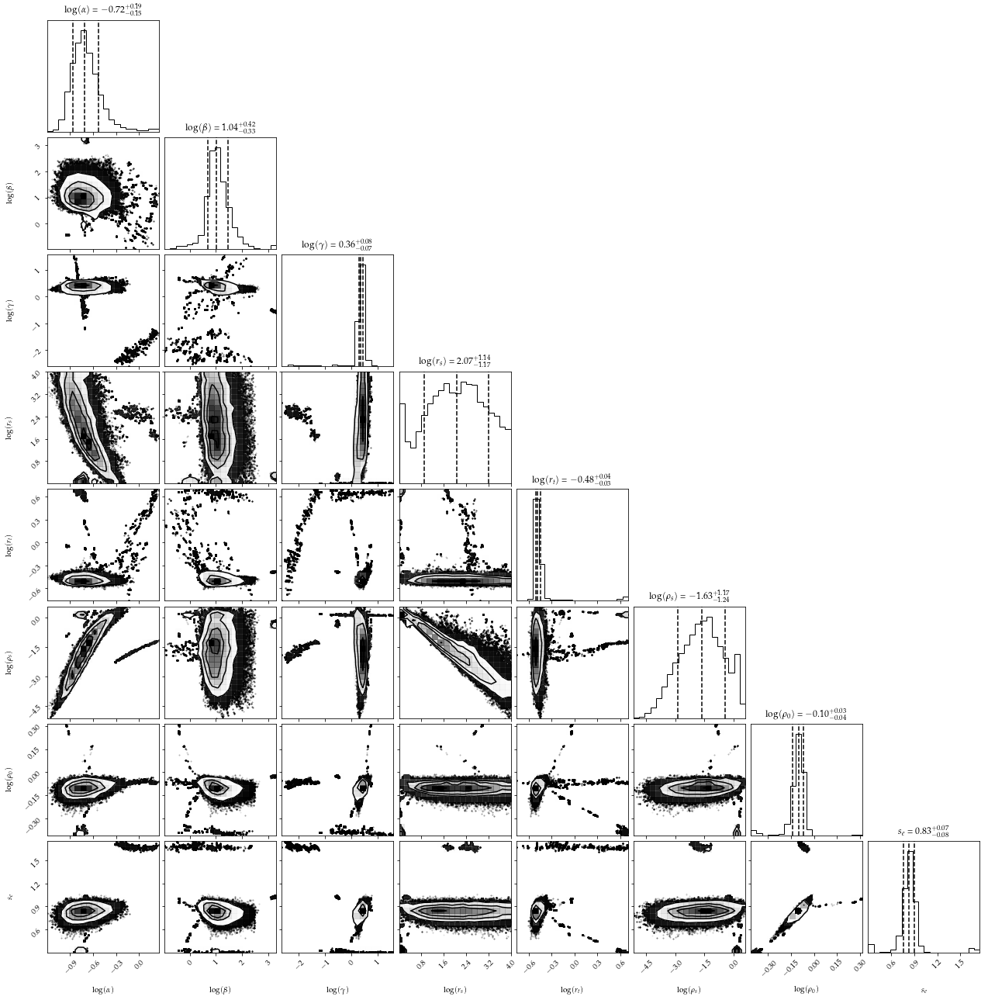

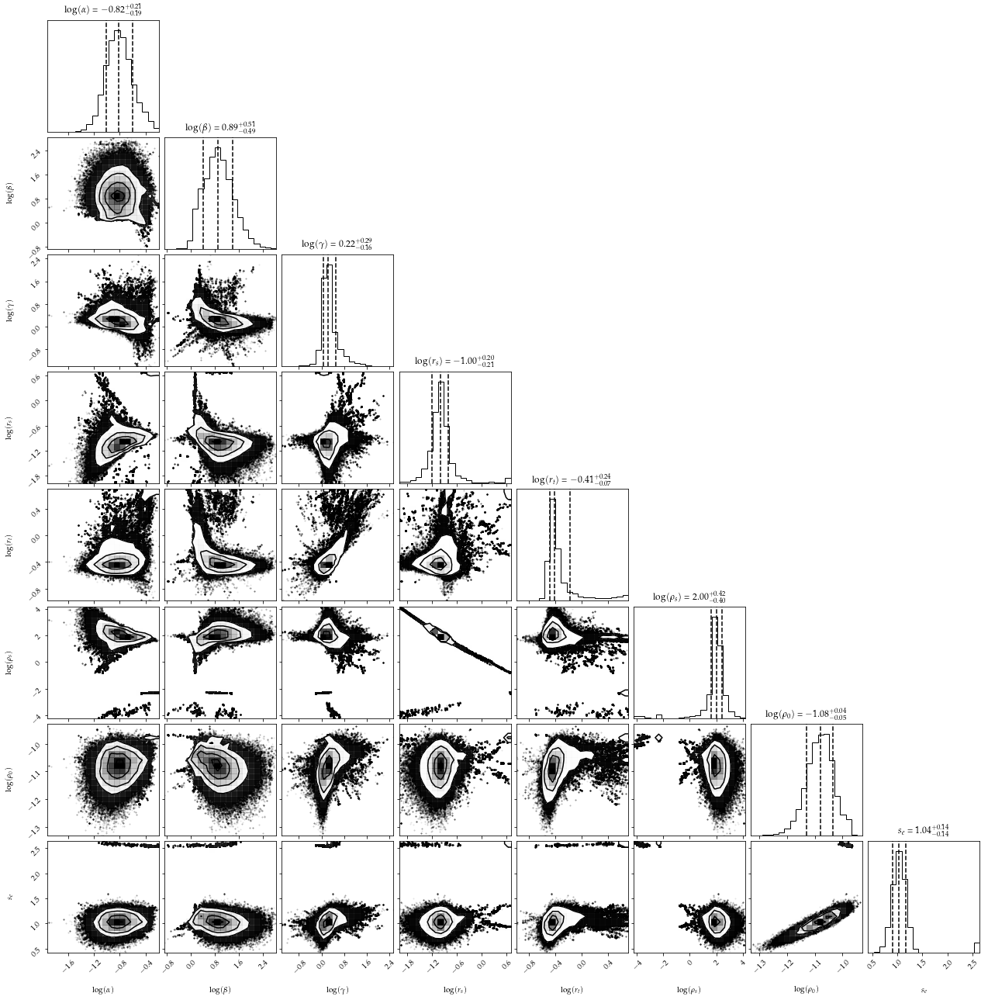

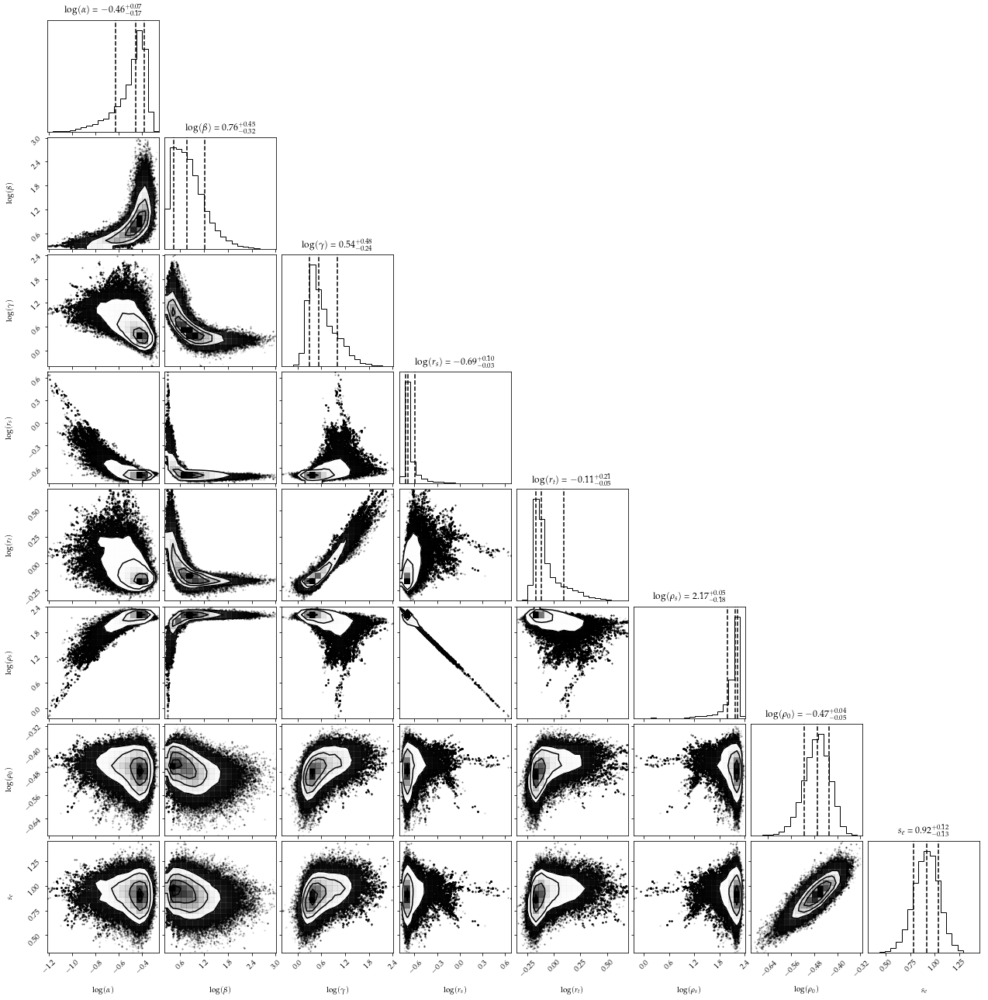

<Figure size 720x576 with 0 Axes>

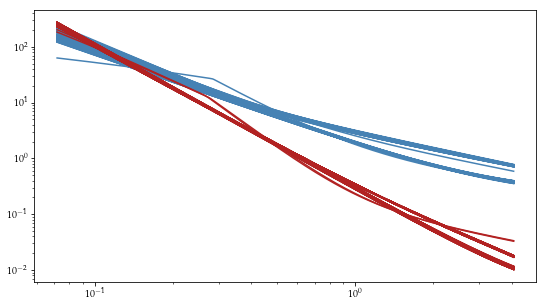

0 1.076237326967348 0.07128253122225249
1 0.6889456911503957 0.19740803762526424
2 0.762312181184511 0.1881302947687588
3 1.3263564409982476 0.08087165976144522


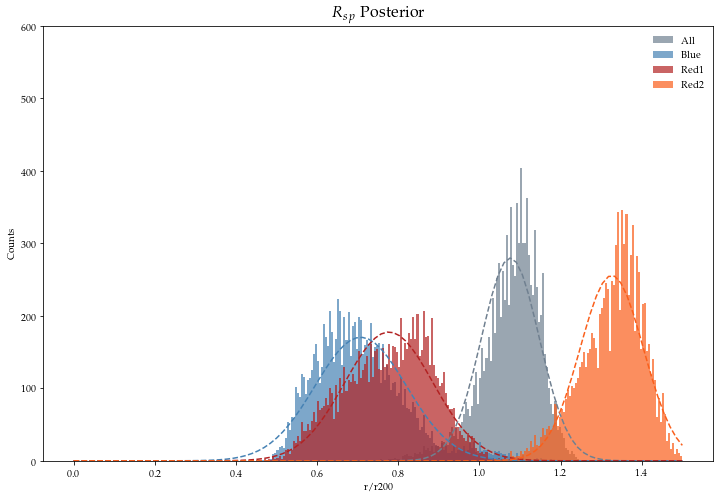

[1.076237326967348, 0.7074946531513692, 0.7768582607930702, 1.3261426611853713] [0.07128253122225249, 0.11265521541567303, 0.1088959198002183, 0.0779991112550787]
1 Means: [1.076237326967348, 0.7074946531513692, 0.7768582607930702, 1.3261426611853713] Sigs: [0.07128253122225249, 0.11265521541567303, 0.1088959198002183, 0.0779991112550787]


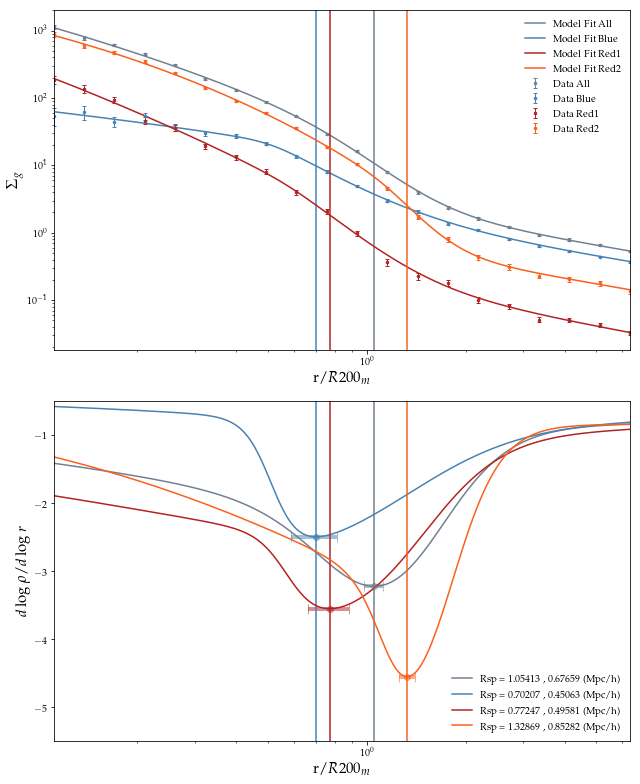

R_avg= 0.6418513603768973

Halo: 0
Halo Mass: 87453.625
N Subhalos from Illustris Algorithm: 5464 4131.85807466507
R500c, R200c, R200m: 0.7612624597816122 1.24644093717065 1.5473688588641492
Rscale 1.5473688588641492
before dev loop: 4131.867213010788
566208 566208 time 4131.885218858719
N Subhalos within 7*R200m: 4517 4131.934612989426
galaxies 0 [   8.   21.   28.   34.   31.   59.   71.   83.  122.  129.  103.   76.
   84.   53.  118.  236.  519.  628.  738. 1347.]
galaxies 1 [  0.   0.   1.   2.   2.  10.   9.   7.   6.  13.  13.  13.  35.  33.
  79. 113. 153. 260. 509. 810.]
galaxies 2 [ 2.  3.  5.  3.  8.  8.  5.  5. 14. 12. 10.  8.  5.  2.  4. 18. 54. 47.
 43. 97.]
galaxies 3 [  6.  18.  22.  29.  21.  41.  57.  71. 102. 104.  80.  55.  44.  18.
  35. 105. 312. 321. 186. 440.]

Halo: 1
Halo Mass: 57760.027
N Subhalos from Illustris Algorithm: 3959 4131.938047885895
R500c, R200c, R200m: 0.5860514830407864 0.916949635434108 1.1697442162737657
Rscale 1.1697442162737657
before dev l

galaxies 0 [  2.  13.  11.  13.  14.  21.  25.  38.  54.  43.  31.  27.  26.  26.
  64.  82. 114. 252. 464. 522.]
galaxies 1 [  0.   0.   0.   1.   1.   0.   3.   7.  10.   5.   5.  12.  21.  18.
  41.  57.  96. 144. 256. 370.]
galaxies 2 [ 0.  2.  2.  5.  2.  1.  3.  1.  7.  4.  1.  3.  0.  1.  6.  6.  5. 21.
 35. 27.]
galaxies 3 [  2.  11.   9.   7.  11.  20.  19.  30.  37.  34.  25.  12.   5.   7.
  17.  19.  13.  87. 173. 125.]

Halo: 12
Halo Mass: 29994.932
N Subhalos from Illustris Algorithm: 1923 4132.732693910599
R500c, R200c, R200m: 0.5770362450325272 0.8675239024200502 1.07320081643798
Rscale 1.07320081643798
before dev loop: 4132.73667383194
566208 566208 time 4132.754693746567
N Subhalos within 7*R200m: 976 4132.793004989624
galaxies 0 [  5.   1.   6.  10.  17.  21.  24.  30.  32.  34.  50.  26.  12.  21.
  18.  32.  93. 109. 168. 259.]
galaxies 1 [  0.   0.   0.   1.   0.   2.   1.   5.   5.   2.   9.   1.   6.  19.
  13.  21.  44.  84. 150. 194.]
galaxies 2 [ 1.  0.  2.  

N Subhalos within 7*R200m: 853 4133.5868101119995
galaxies 0 [  2.   4.   8.  13.  11.  13.  16.  26.  18.  22.   8.  18.  29.  65.
  81.  64.  51.  71. 153. 173.]
galaxies 1 [  0.   0.   1.   1.   0.   3.   3.   5.   5.  10.   4.  14.  14.  21.
  38.  34.  39.  50.  61. 108.]
galaxies 2 [ 1.  0.  2.  1.  0.  1.  0.  3.  0.  0.  1.  0.  2.  4.  5.  5.  3.  2.
 13. 11.]
galaxies 3 [ 1.  4.  5. 11. 11.  9. 13. 18. 13. 12.  3.  4. 13. 40. 38. 25.  9. 19.
 79. 54.]

Halo: 25
Halo Mass: 19065.426
N Subhalos from Illustris Algorithm: 1228 4133.5911338329315
R500c, R200c, R200m: 0.5023776780566084 0.7649002302428666 0.9437094634414113
Rscale 0.9437094634414113
before dev loop: 4133.595465898514
566208 566208 time 4133.613232135773
N Subhalos within 7*R200m: 939 4133.649046897888
galaxies 0 [  3.   2.   8.   8.  11.  14.  11.  12.  29.  18.  23.  25.  17.  20.
  49.  40.  50. 177. 187. 228.]
galaxies 1 [  0.   0.   0.   0.   2.   1.   1.   0.   5.   4.   4.   4.   5.   9.
  26.  25.  34.  62. 

N Subhalos within 7*R200m: 835 4134.435055971146
galaxies 0 [  3.   5.   3.   3.  14.   8.  16.   9.  17.  14.  21.  13.  17.  31.
  33.  21.  71.  92. 152. 285.]
galaxies 1 [  0.   0.   0.   0.   0.   1.   2.   3.   4.   2.   3.   8.  10.  17.
  25.  15.  41.  65. 123. 160.]
galaxies 2 [ 1.  0.  0.  1.  3.  1.  1.  1.  0.  2.  1.  0.  2.  4.  2.  1.  4.  6.
  8. 18.]
galaxies 3 [  2.   5.   3.   2.  11.   6.  13.   5.  13.  10.  17.   5.   5.  10.
   6.   5.  26.  21.  21. 107.]

Halo: 40
Halo Mass: 15832.792
N Subhalos from Illustris Algorithm: 1144 4134.438289880753
R500c, R200c, R200m: 0.4847836976637453 0.7167998777769817 0.8706583597582565
Rscale 0.8706583597582565
before dev loop: 4134.442217826843
566208 566208 time 4134.460188865662
N Subhalos within 7*R200m: 651 4134.497832775116
galaxies 0 [  0.   6.   8.   5.  18.  18.  19.  18.  22.  17.  15.  12.   8.  15.
  22.  39.  49.  61.  88. 208.]
galaxies 1 [  0.   2.   3.   0.   2.   4.   4.   3.   6.   4.   7.   5.   6.  12.
  1

566208 566208 time 4135.293922901154
N Subhalos within 7*R200m: 488 4135.331341981888
galaxies 0 [  1.   2.   6.   6.   9.   4.   5.  16.   9.  18.  19.  22.  15.  32.
  20.  14.  37.  58.  89. 103.]
galaxies 1 [ 0.  0.  0.  0.  0.  1.  2.  1.  2.  6.  3.  6.  7. 11. 13. 10. 27. 55.
 57. 91.]
galaxies 2 [0. 0. 1. 2. 3. 2. 0. 2. 1. 2. 1. 2. 2. 3. 1. 1. 4. 1. 8. 4.]
galaxies 3 [ 1.  2.  5.  4.  6.  1.  3. 13.  6. 10. 15. 14.  6. 18.  6.  3.  6.  2.
 24.  8.]

Halo: 54
Halo Mass: 13448.043
N Subhalos from Illustris Algorithm: 1050 4135.333488702774
R500c, R200c, R200m: 0.4276346383882278 0.6553686935448664 0.8081837976536561
Rscale 0.8081837976536561
before dev loop: 4135.3374218940735
566208 566208 time 4135.355010032654
N Subhalos within 7*R200m: 496 4135.389307022095
galaxies 0 [  0.   1.   5.   6.   7.  19.  12.  19.  22.  14.  20.  15.  12.  12.
  14.  28.  28.  44. 100. 111.]
galaxies 1 [ 0.  0.  0.  0.  0.  0.  3.  3.  4.  3.  5.  3.  6.  9. 11. 20. 21. 36.
 77. 78.]
galaxies 2 [0.

566208 566208 time 4136.163400888443
N Subhalos within 7*R200m: 531 4136.199704885483
galaxies 0 [  1.   3.   4.   1.   9.   6.  11.  10.  17.  14.  14.  10.  14.  13.
  15.  24.  39.  81. 123. 119.]
galaxies 1 [  0.   1.   2.   0.   1.   2.   5.   0.   1.   3.   6.   7.   3.  11.
  12.  22.  31.  52.  87. 102.]
galaxies 2 [ 1.  0.  1.  0.  0.  2.  2.  2.  0.  1.  0.  0.  2.  0.  0.  0.  1.  4.
 11.  8.]
galaxies 3 [ 0.  2.  1.  1.  8.  2.  4.  8. 16. 10.  8.  3.  9.  2.  3.  2.  7. 25.
 25.  9.]

Halo: 72
Halo Mass: 11179.371
N Subhalos from Illustris Algorithm: 744 4136.202594995499
R500c, R200c, R200m: 0.43359148451594787 0.6481700187690529 0.7958097092070726
Rscale 0.7958097092070726
before dev loop: 4136.206899881363
566208 566208 time 4136.2262098789215
N Subhalos within 7*R200m: 699 4136.263331890106
galaxies 0 [  3.   2.   6.   9.   5.   5.  11.  16.  17.  13.  19.  13.  16.   8.
   7.  17.  38.  74. 145. 269.]
galaxies 1 [  0.   0.   0.   1.   0.   0.   2.   5.   5.   2.   1. 

566208 566208 time 4137.048696041107
N Subhalos within 7*R200m: 483 4137.085187911987
galaxies 0 [ 0.  3.  6.  7.  3.  5. 15. 17.  9. 25. 11. 10.  8. 21. 20. 22. 25. 87.
 98. 88.]
galaxies 1 [ 0.  0.  0.  2.  1.  0.  2.  7.  2.  6.  3.  5.  4. 17. 15. 22. 21. 38.
 66. 79.]
galaxies 2 [ 0.  0.  1.  3.  0.  1.  1.  1.  1.  3.  0.  0.  1.  2.  1.  0.  0. 10.
  8.  3.]
galaxies 3 [ 0.  3.  5.  2.  2.  4. 12.  9.  6. 16.  8.  5.  3.  2.  4.  0.  4. 39.
 24.  6.]

Halo: 95
Halo Mass: 10305.533
N Subhalos from Illustris Algorithm: 818 4137.087219953537
R500c, R200c, R200m: 0.3879188612176387 0.6091632116983731 0.7620091823691952
Rscale 0.7620091823691952
before dev loop: 4137.091184139252
566208 566208 time 4137.108329772949
N Subhalos within 7*R200m: 392 4137.143279075623
galaxies 0 [ 3.  3.  9.  2.  7.  4. 13. 14. 13. 12. 20.  8.  6.  5. 11. 18. 26. 47.
 83. 78.]
galaxies 1 [ 1.  0.  1.  0.  2.  0.  2.  4.  0.  3.  5.  2.  3.  4. 11. 15. 18. 39.
 60. 69.]
galaxies 2 [0. 1. 0. 0. 2. 1. 2. 2.

/Users/TaraD/anaconda3/lib/python3.7/site-packages/scipy/signal/_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


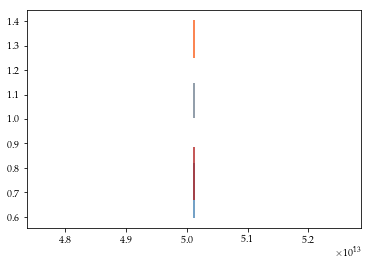

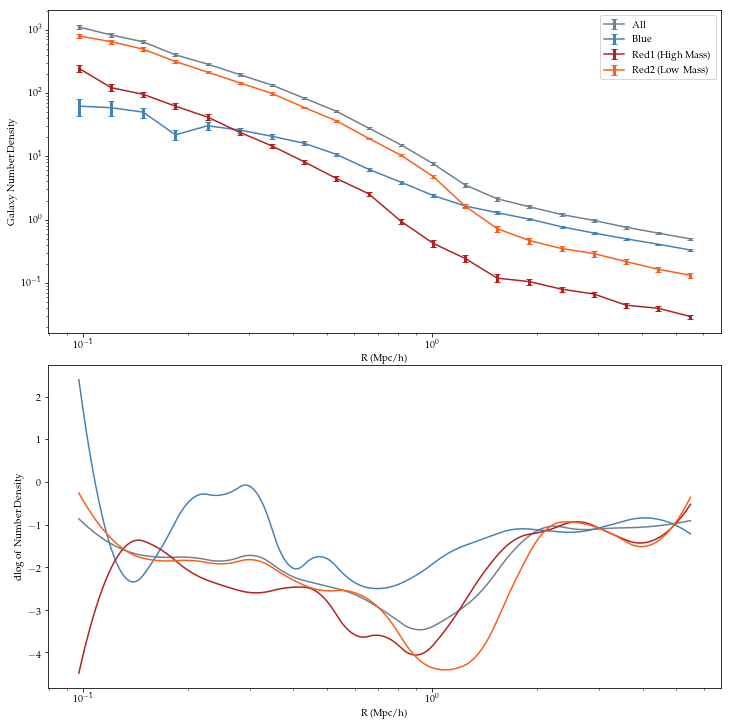

/Users/TaraD/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: overflow encountered in power
  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


/Users/TaraD/anaconda3/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 12/5000 [00:00<00:42, 117.79it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 15/5000 [00:00<00:35, 141.20it/s]

Running production...


  0%|          | 0/20000 [00:00<?, ?it/s]

Running burn-in...


  0%|          | 12/5000 [00:00<00:43, 115.58it/s]

Running production...


100%|██████████| 5000/5000 [00:44<00:00, 111.51it/s]


Running burn-in...


  0%|          | 11/5000 [00:00<00:47, 105.62it/s]

Running production...


100%|██████████| 5000/5000 [00:46<00:00, 107.72it/s]


done MCMC
Progress: [------------------->] 100%count 0 = 0, count total = 10000
Progress: [------------------->] 100%count 1 = 5758, count total = 10000
Progress: [------------------->] 100%count 2 = 541, count total = 10000
Progress: [------------------->] 100%count 3 = 0, count total = 10000


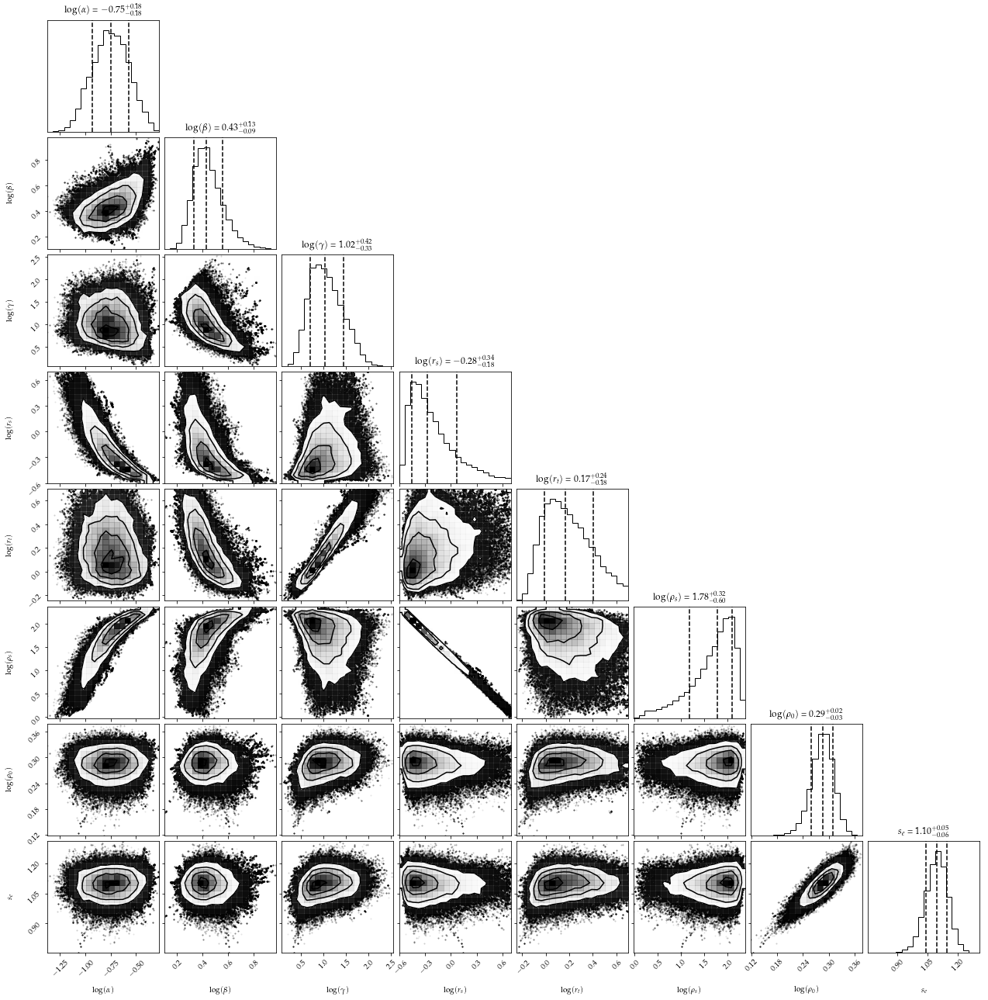

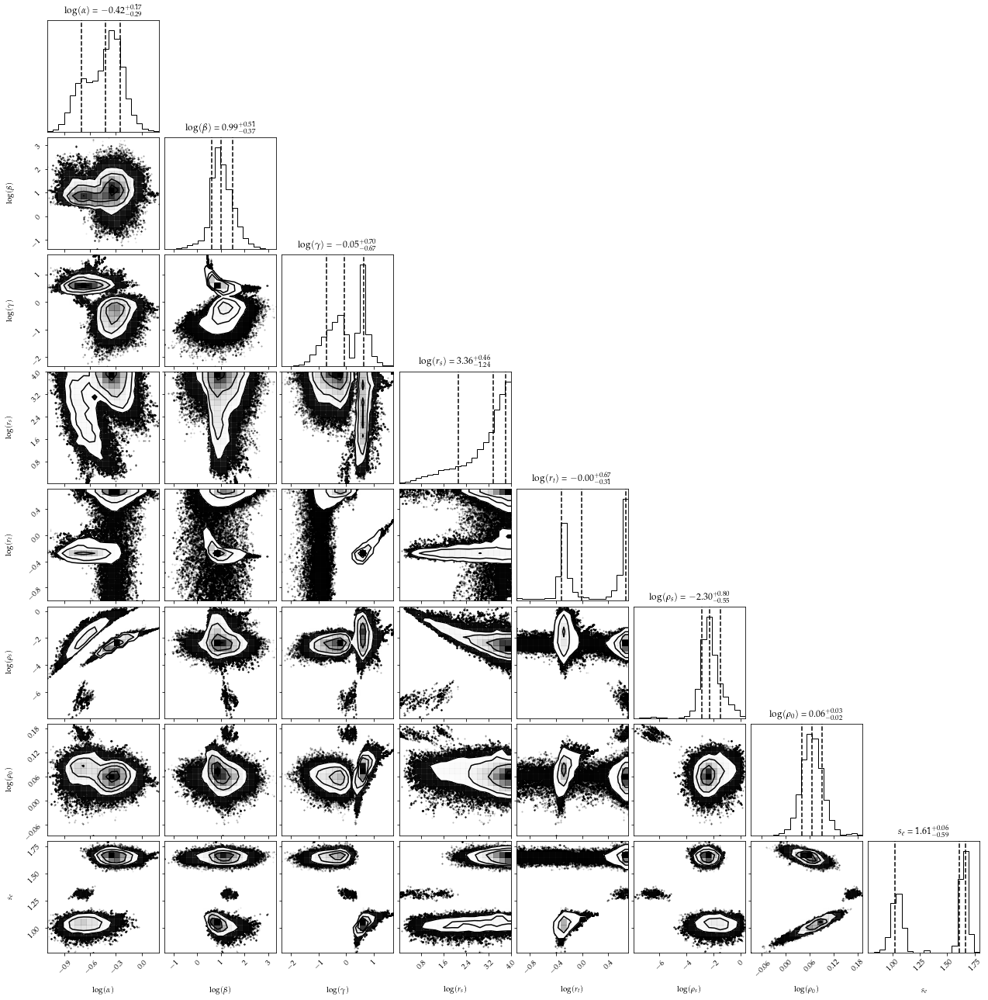

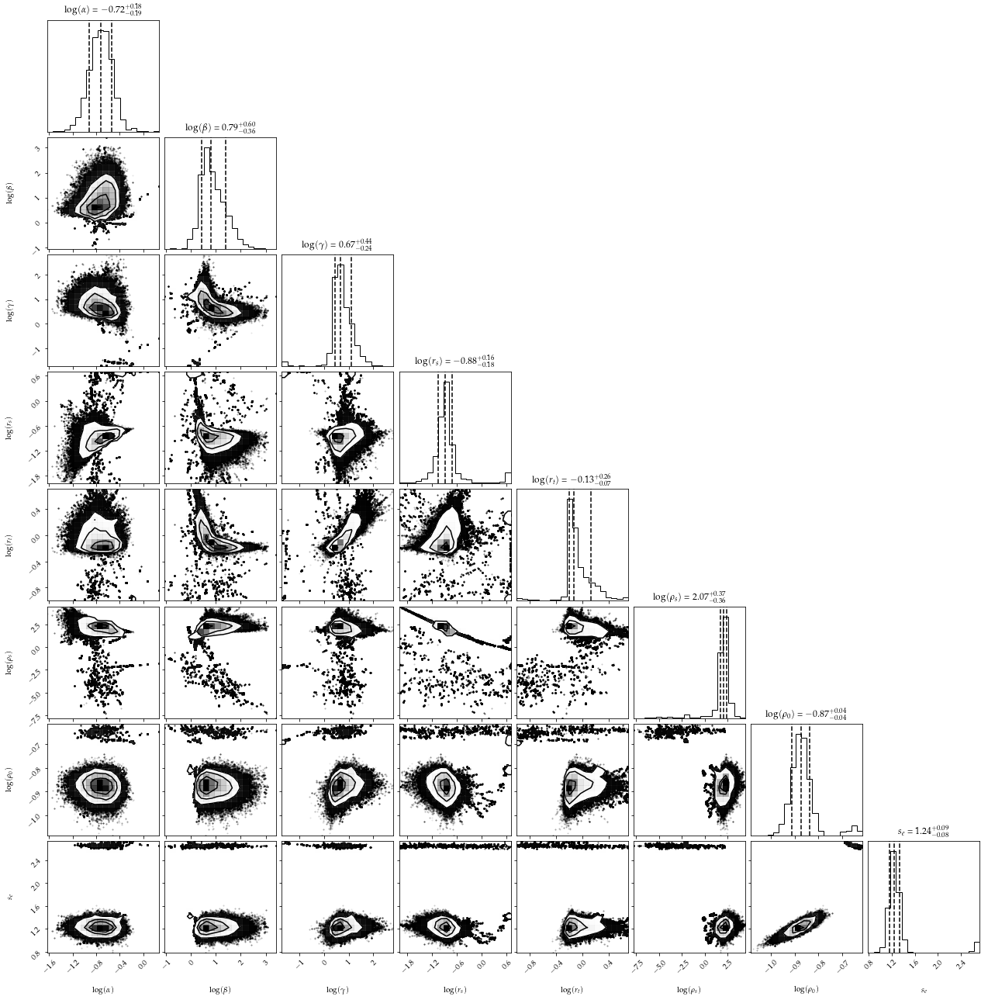

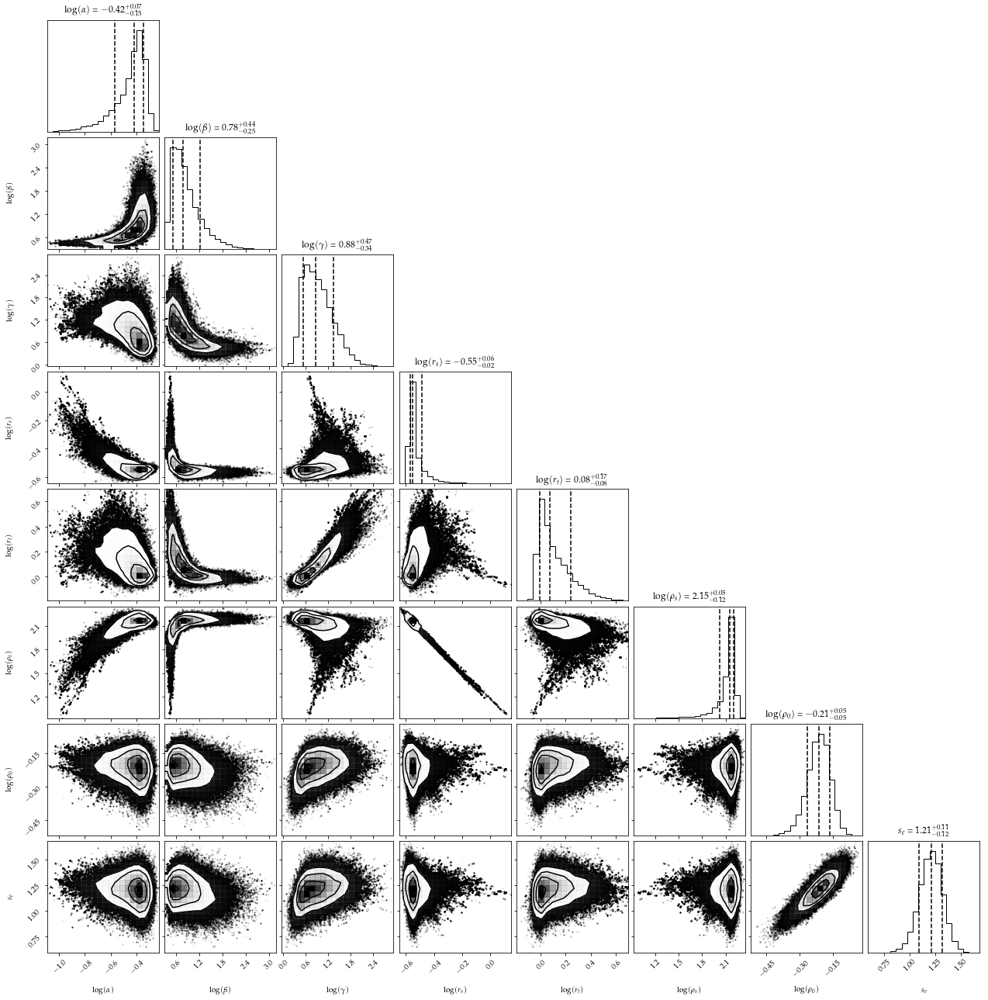

<Figure size 720x576 with 0 Axes>

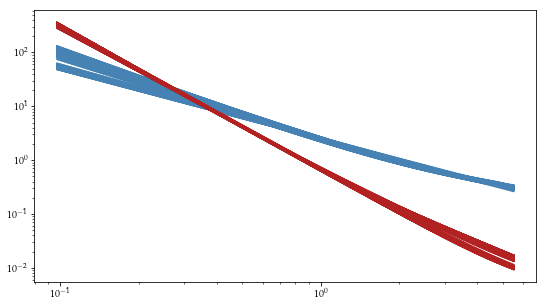

0 1.1147273674438654 0.049774250644683576
1 0.3870753725790139 0.3609453919338635
2 0.8771100022661192 0.19818186768370175
3 1.3151066209984368 0.067897550419293


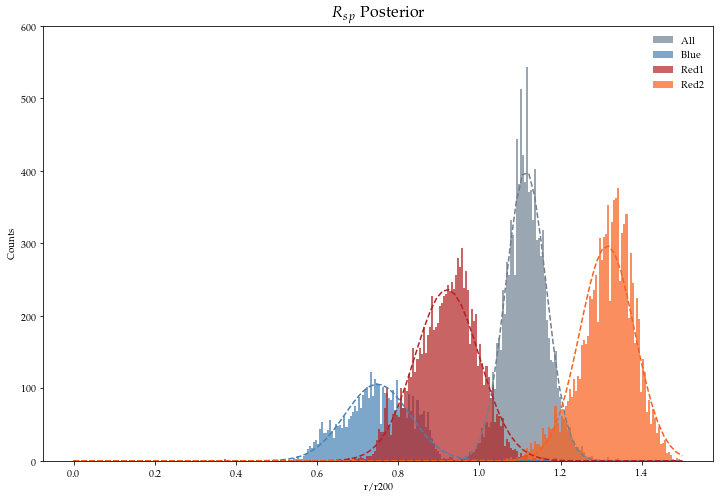

[1.1147273674438654, 0.7485101730109259, 0.9203855726186916, 1.315009579223814] [0.049774250644683576, 0.07983639324157935, 0.07983076265737214, 0.06720392359499232]
2 Means: [1.1147273674438654, 0.7485101730109259, 0.9203855726186916, 1.315009579223814] Sigs: [0.049774250644683576, 0.07983639324157935, 0.07983076265737214, 0.06720392359499232]


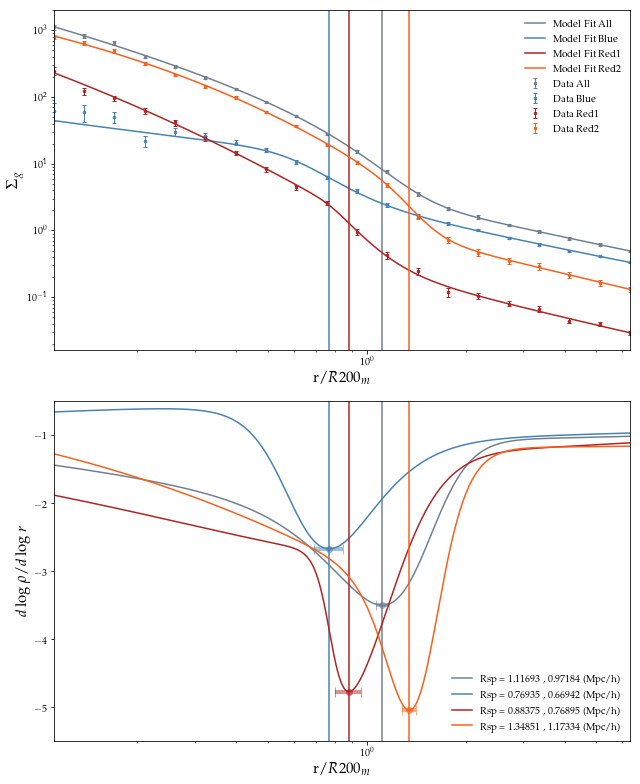

R_avg= 0.8701007239330811


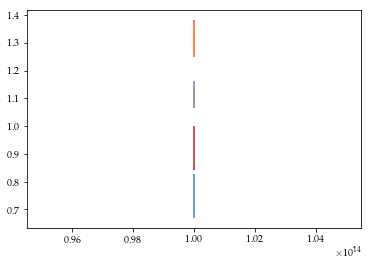

[[1.17881752 1.07623733 1.11472737]
 [0.92683155 0.70749465 0.74851017]
 [0.89692169 0.77685826 0.92038557]
 [1.40763434 1.32614266 1.31500958]]
[[0.0382046  0.07128253 0.04977425]
 [0.11696979 0.11265522 0.07983639]
 [0.06312199 0.10889592 0.07983076]
 [0.05377148 0.07799911 0.06720392]]


In [31]:
#RSP VS MASS for colors
halo_array_list = []
#M_list = [10**3,10**3.5,10**4,10**4.5]
M_list = [10**3.5,10**3.7,10**4,10**6]

for m in range(3):
    mcut = M_list[m]
    mup = M_list[m+1]
    mask_halomass = ((halo_grp[mass_param])>=((mcut)))&((halo_grp[mass_param])<((mup)))
    Number_of_halos = len(halo_grp[mass_param][mask_halomass])
    print("Number of halos with mass > %s:" %(mcut*1e10), Number_of_halos)

    halo_array = np.arange(0,len(halo_grp[mass_param]))
    halo_array_masked = halo_array[mask_halomass]#[R_list>5.]
    #print(halo_array_masked)
    halo_array_list.append(halo_array_masked)
    


init_theta_list = np.array([[-.92, 0.78, 0.60, -0.2, 0.02, 1.5, .2 , 1.66],[-.92, 0.78, 0.60, 100, -0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -.61, 0.34, 2, 3 , 1.66],[-.92, 0.78, 0.60, -1, -.34, 3, -0.5 , 1.66]]) # ps was 2, r_s was -0.61, p0 was 3, r_t was .34
bounds = ((-2, 2),(-1.4, 3), (-1.2,3), (-2, 0.7), (-2, 0.7), (-1, 30), (-1, 30), (.1, 10))
rho_g_list = [0.026943079757983778, 0.021698698509888134, 0.0029584016482639545, 0.0022859795998316913]
blue_list = [False, True, False, False]
colors = ['slategray','steelblue','firebrick','#fa5f1b']#,'dimgray','steelblue'
ls_list = ['-','-','-','-']
labels = ['All','Blue','Red1','Red2']
means_colors_array = np.zeros([4,3])
sigs_colors_array = np.zeros([4,3])


plt.figure(figsize = (10,8))
for m in range(len(halo_array_list)):
    harr = halo_array_list[m]
    bin_stack, Yi_avg_list, cov_list, boot_err_list, R_avg, title = MultiProfiles('color',4, subhalo_table_m, CM_coords,harr,'basic','stellarmass')
    
    profiles = Yi_avg_list
    covs = cov_list
    
    best_fit_mcmc_list, samples_list, sampler_list = MCMC(bin_stack, profiles, covs,rho_g_list,blue_list,init_theta_list, bounds, 20000, 128, 5000)    
    rsp_samps_list = rsp_samp(samples_list, sampler_list,bin_stack,colors,labels, rho_g_list)
    means_colors, sigs_colors = rsp_dist(rsp_samps_list, colors, R_avg)
    print(m,'Means:', means_colors, 'Sigs:',sigs_colors)
    averaged_r_tot = bin_stack
    r_sp_list, r_sp_r200_list = FittedPlots(best_fit_mcmc_list, profiles, averaged_r_tot,R_avg,covs,rho_g_list,sigs_colors,labels, colors, ls_list)
    
    for c in range(4):
        means_colors_array[c,m] = means_colors[c]
        sigs_colors_array[c,m] = sigs_colors[c]

        plt.errorbar(M_list[m]*1e10,means_colors[c], yerr = sigs_colors[c], c = colors[c])
plt.show()
print(means_colors_array)
print(sigs_colors_array)

Text(0.5, 0, 'Lower Mass Cut [Log(M/Msun)]')

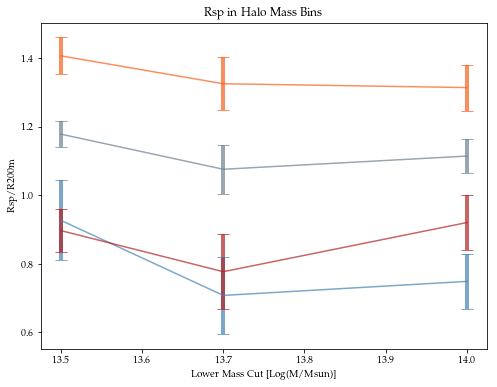

In [33]:
plt.rcParams['figure.facecolor'] = 'w'
colors = ['slategray','steelblue','firebrick','#fa5f1b']#,'dimgray','steelblue'
ls_list = ['-','-','-','-']
labels = ['All','Blue','Red1','Red2']
#means_colors_array = np.array([[1.1648047,1.13205179,1.12818336],[0.89105363,0.72463275,0.72154029],[0.90838467,0.88333069,0.90312887],[1.36897035,1.29864539,1.31711806]])
#sigs_colors_array = np.array([[0.02873531,0.03910641,0.05049493],[0.10050384,0.13606719,0.07219975],[0.05271554,0.07970078,0.08085913],[0.0496236,0.07267971,0.06956933]])

plt.figure(figsize = (8,6))
M_list = [10**3.5,10**3.7,10**4]
m_list = [13.5,13.7,14]
for c in range(4):
    plt.errorbar(m_list,means_colors_array[c,:], yerr = sigs_colors_array[c,:], c = colors[c], label = labels[c], capsize = 6, elinewidth = 4, alpha = .7)
plt.title('Rsp in Halo Mass Bins')
plt.ylabel('Rsp/R200m')
plt.xlabel('Lower Mass Cut [Log(M/Msun)]')

In [ ]:
print('hi')